In [ ]:
import numpy as np
import matplotlib as mpl
from google.colab import drive
import matplotlib.pyplot as plt
import os
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.layers import  Dense, Dropout, Conv2D, MaxPool2D,TimeDistributed, Conv1D, MaxPooling1D, Flatten, Bidirectional,Input, Flatten, Activation, Reshape, RepeatVector, Concatenate, ConvLSTM2D, LSTM, BatchNormalization
from tensorflow.keras.models import Model,Sequential
from tensorflow.keras.utils import to_categorical

In [ ]:
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
os.listdir('drive/MyDrive/dissertation')

['clipped_merged_2016.tiff', 'clipped_merged_2021.tiff']

In [ ]:
%pip install --quiet rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 75.6 MB/s eta 0:00:00


In [ ]:
import numpy as np
import rasterio

def load_and_preprocess(image_path):
    with rasterio.open(image_path) as src:
        image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"

image1 = load_and_preprocess(image1_path)
image2 = load_and_preprocess(image2_path)


In [ ]:
import numpy as np
import rasterio
from sklearn.model_selection import train_test_split


def extract_patches(image, patch_size=128, stride=128):
    patches = []
    for i in range(0, image.shape[1] - patch_size + 1, stride):
        for j in range(0, image.shape[2] - patch_size + 1, stride):
            patch = image[:, i:i + patch_size, j:j + patch_size]
            patches.append(patch)
    return np.array(patches)

patch_size = 128
X1 = extract_patches(image1, patch_size)
X2 = extract_patches(image2, patch_size)
y = np.zeros(X1.shape)  # Placeholder for the unsupervised setting

X1 = np.transpose(X1, (0, 2, 3, 1))
X2 = np.transpose(X2, (0, 2, 3, 1))
y = np.zeros((X1.shape[0], patch_size, patch_size, 1))

X1_train, X1_val, X2_train, X2_val, y_train, y_val = train_test_split(X1, X2, y, test_size=0.3, random_state=42)


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models

def build_ucdnet_model(input_shape):
    input1 = layers.Input(shape=input_shape)
    input2 = layers.Input(shape=input_shape)

    # Shared Encoder
    def encoder_block(input):
        x = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(input)
        x = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(x)
        c1 = x
        x = layers.MaxPooling2D((2, 2))(x)

        x = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(x)
        c2 = x
        x = layers.MaxPooling2D((2, 2))(x)

        x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)
        c3 = x
        x = layers.MaxPooling2D((2, 2))(x)

        x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
        c4 = x
        x = layers.MaxPooling2D((2, 2))(x)

        x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
        return x, [c1, c2, c3, c4]

    encoded1, skips1 = encoder_block(input1)
    encoded2, skips2 = encoder_block(input2)

    # Difference Module
    diff = layers.Subtract()([encoded1, encoded2])

    # Decoder
    def decoder_block(input, skips):
        x = layers.Conv2DTranspose(128, (2, 2), strides=2, activation='relu', padding='same')(input)
        x = layers.Concatenate()([x, skips[3]])
        x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)

        x = layers.Conv2DTranspose(64, (2, 2), strides=2, activation='relu', padding='same')(x)
        x = layers.Concatenate()([x, skips[2]])
        x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)

        x = layers.Conv2DTranspose(32, (2, 2), strides=2, activation='relu', padding='same')(x)
        x = layers.Concatenate()([x, skips[1]])
        x = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(x)

        x = layers.Conv2DTranspose(16, (2, 2), strides=2, activation='relu', padding='same')(x)
        x = layers.Concatenate()([x, skips[0]])
        x = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(x)
        x = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(x)

        x = layers.Conv2D(1, (1, 1), activation='sigmoid', padding='same')(x)
        return x

    output = decoder_block(diff, skips1)

    model = models.Model(inputs=[input1, input2], outputs=output)
    return model

input_shape = (128, 128, 11)  # Adjust based on patch size and channels
model = build_ucdnet_model(input_shape)

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
# model.summary()

history = model.fit([X1_train, X2_train], y_train, epochs=1, batch_size=32, validation_data=([X1_val, X2_val], y_val))

# import matplotlib.pyplot as plt

# # Plot training & validation accuracy values
# plt.figure(figsize=(14, 6))
# plt.subplot(1, 2, 1)
# plt.plot(history.history['accuracy'])
# plt.plot(history.history['val_accuracy'])
# plt.title('Model accuracy')
# plt.ylabel('Accuracy')
# plt.xlabel('Epoch')
# plt.legend(['Train', 'Validation'], loc='upper left')

# # Plot training & validation loss values
# plt.subplot(1, 2, 2)
# plt.plot(history.history['loss'])
# plt.plot(history.history['val_loss'])
# plt.title('Model loss')
# plt.ylabel('Loss')
# plt.xlabel('Epoch')
# plt.legend(['Train', 'Validation'], loc='upper left')

# plt.show()


39/39 [==============================] - 23s 161ms/step - loss: 0.1058 - accuracy: 0.9764 - val_loss: 0.0000e+00 - val_accuracy: 1.0000


55/55 [==============================] - 2s 37ms/step


<ipython-input-10-4160667043cc>:21: RuntimeWarning: invalid value encountered in divide
  reconstructed_image /= count


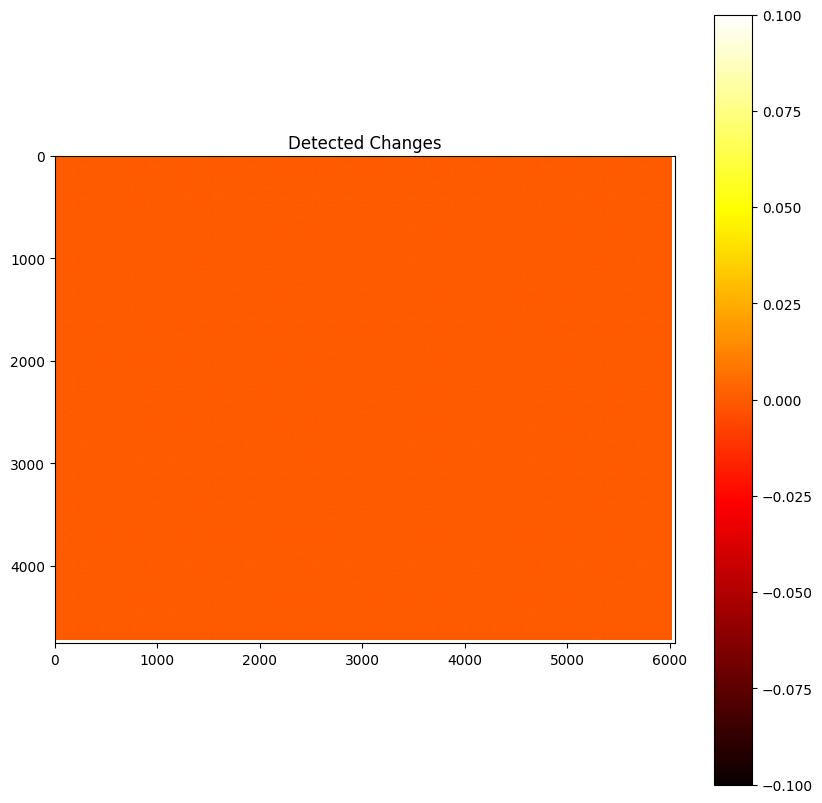

In [ ]:
def predict_changes(model, image1, image2, patch_size=128, stride=128):
    patches1 = extract_patches(image1, patch_size, stride)
    patches2 = extract_patches(image2, patch_size, stride)
    patches1 = np.transpose(patches1, (0, 2, 3, 1))
    patches2 = np.transpose(patches2, (0, 2, 3, 1))

    predicted_patches = model.predict([patches1, patches2])
    predicted_patches = np.squeeze(predicted_patches, axis=-1)

    # Reconstruct the image
    reconstructed_image = np.zeros((image1.shape[1], image1.shape[2]))
    count = np.zeros((image1.shape[1], image1.shape[2]))

    patch_index = 0
    for i in range(0, image1.shape[1] - patch_size + 1, stride):
        for j in range(0, image1.shape[2] - patch_size + 1, stride):
            reconstructed_image[i:i + patch_size, j:j + patch_size] += predicted_patches[patch_index]
            count[i:i + patch_size, j:j + patch_size] += 1
            patch_index += 1

    reconstructed_image /= count
    return reconstructed_image

predicted_changes = predict_changes(model, image1, image2)

plt.figure(figsize=(10, 10))
plt.imshow(predicted_changes, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()


# SiROC - Spatial Context Awareness for Unsupervised Change Detection in Optical Satellite Images

In [ ]:
%pip install --quiet rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 60.2 MB/s eta 0:00:00


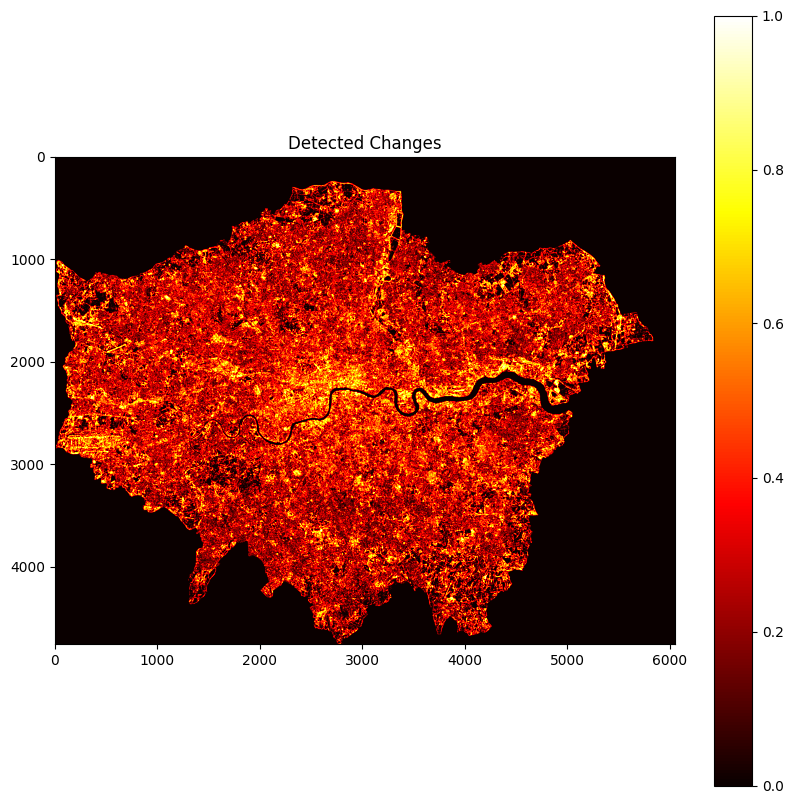

In [ ]:
import torch
import numpy as np
import cv2
import rasterio
import matplotlib.pyplot as plt

# Load images function
def load_image(image_path, bands=[4, 3, 2, 8]):
    with rasterio.open(image_path) as src:
        image = src.read(bands)
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

def obtain_change_map(pre, post, neighborhood, excluded=0):
    '''This function gets the change map for a pair of pre/post input images.'''
    B, C, H_pre, W_pre = pre.shape
    _, _, H_post, W_post = post.shape

    # Generate array to save predictions in
    padded_pre = torch.zeros((B, C, H_pre + 2 * neighborhood, W_pre + 2 * neighborhood))
    padded_pre[:, :, neighborhood:H_pre + neighborhood, neighborhood:W_pre + neighborhood] = pre
    padded_post = torch.zeros((B, C, H_pre + 2 * neighborhood, W_pre + 2 * neighborhood))
    padded_post[:, :, neighborhood:H_post + neighborhood, neighborhood:W_post + neighborhood] = post

    pre_response = padded_pre ** 2
    post_response = padded_pre * padded_post
    pre_sum = torch.zeros(post.shape)
    post_sum = torch.zeros(post.shape)

    # Iterate over patches
    for x_patch in range(-neighborhood, neighborhood + 1):
        for y_patch in range(-neighborhood, neighborhood + 1):
            if abs(x_patch) <= excluded or abs(y_patch) <= excluded:
                continue

            pre_sum += pre_response[:, :,
                                    y_patch + neighborhood:H_pre + y_patch + neighborhood,
                                    x_patch + neighborhood:W_pre + x_patch + neighborhood]

            post_sum += post_response[:, :,
                                      y_patch + neighborhood:H_post + y_patch + neighborhood,
                                      x_patch + neighborhood:W_post + x_patch + neighborhood]

    post_pred = pre * post_sum / pre_sum
    change_map = torch.abs(post_pred - post)
    return change_map

def apply_threshold(change_map, j, threshold, l, otsu_factor):
    if threshold == 'Otsu':
        img = np.int8(np.array(j * 255).ravel())
        assert not np.isnan(img).any()
        t = cv2.threshold(np.array(abs(j.numpy() * 255), dtype=np.uint8), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[0]
        change_map[l, :, :] = torch.where(abs(j) > (t * otsu_factor / 255), torch.tensor(1), torch.tensor(0))
    elif threshold == 'Triangle':
        t = cv2.threshold(np.array(abs(j.numpy() * 255), dtype=np.uint8), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_TRIANGLE)[0]
        change_map[l, :, :] = torch.where(abs(j) > (t * 0.5 * otsu_factor / 255), torch.tensor(1), torch.tensor(0))
    else:
        assert threshold in ['Otsu', 'Triangle', 'Gaussian'], "Thresholding not identified"
    return change_map

def SiROC(pre_image, post_image, neighborhood=3, excluded=0, threshold='Otsu', otsu_factor=1):
    pre_image = torch.Tensor(pre_image).unsqueeze(0)
    post_image = torch.Tensor(post_image).unsqueeze(0)

    change_map = obtain_change_map(pre_image, post_image, neighborhood, excluded)

    for l in range(change_map.shape[0]):
        j = change_map[l, 0, :, :]
        change_map = apply_threshold(change_map, j, threshold, l, otsu_factor)

    return change_map[0, 0, :, :]

# Load images
# bands = list(range(1,12))
bands = [4, 3, 2, 8]
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands)

# Apply SiROC
change_map = SiROC(im1, im2)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(change_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()


In [ ]:
np.unique(change_map)

array([0., 1.], dtype=float32)

In [ ]:
print("Min value:", np.nanmin(change_map))
print("Max value:", np.nanmax(change_map))

Min value: 0.0
Max value: 1.0


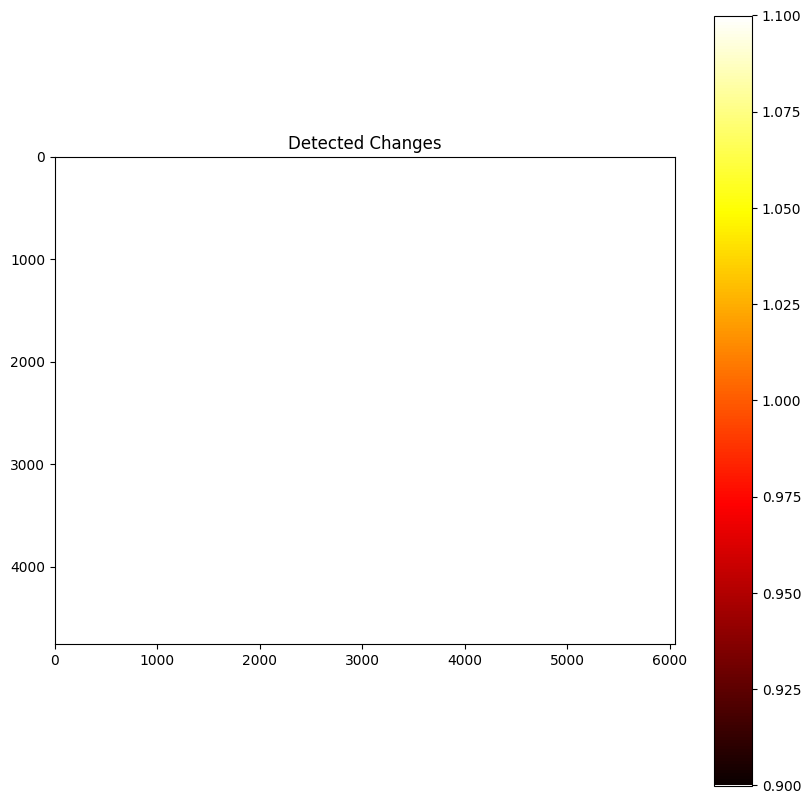

In [ ]:
filtered_change_map = np.copy(change_map)
filtered_change_map[filtered_change_map == 0] = float('nan')

plt.figure(figsize=(10, 10))
plt.imshow(filtered_change_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()

With Regression

In [ ]:
# import torch
# import numpy as np
# import cv2
# import rasterio
# import matplotlib.pyplot as plt
# from sklearn.linear_model import LinearRegression

# # Load images function
# def load_image(image_path, bands=[4, 3, 2, 8]):
#     with rasterio.open(image_path) as src:
#         image = src.read(bands)
#         image = np.nan_to_num(image, nan=np.nanmin(image))
#         image = (image - np.mean(image)) / np.std(image)
#     return image

# # Load dataset function
# def load_dataset(image1_path, image2_path):
#     im1 = load_image(image1_path)
#     im2 = load_image(image2_path)
#     return im1, im2

# def obtain_change_map(pre, post, neighborhood, excluded=0):
#     '''This function gets the change map for a pair of pre/post input images using regression.'''
#     B, C, H_pre, W_pre = pre.shape
#     _, _, H_post, W_post = post.shape

#     # Generate array to save predictions in
#     padded_pre = torch.zeros((B, C, H_pre + 2 * neighborhood, W_pre + 2 * neighborhood))
#     padded_pre[:, :, neighborhood:H_pre + neighborhood, neighborhood:W_pre + neighborhood] = pre
#     padded_post = torch.zeros((B, C, H_pre + 2 * neighborhood, W_pre + 2 * neighborhood))
#     padded_post[:, :, neighborhood:H_post + neighborhood, neighborhood:W_post + neighborhood] = post

#     pre_response = padded_pre ** 2
#     post_response = padded_pre * padded_post
#     pre_sum = torch.zeros(post.shape)
#     post_sum = torch.zeros(post.shape)

#     # Initialize regression model
#     reg_model = LinearRegression()

#     # Iterate over patches
#     for x_patch in range(-neighborhood, neighborhood + 1):
#         for y_patch in range(-neighborhood, neighborhood + 1):
#             if abs(x_patch) <= excluded or abs(y_patch) <= excluded:
#                 continue

#             for b in range(B):
#                 for c in range(C):
#                     for i in range(H_pre):
#                         for j in range(W_pre):
#                             X_train = []
#                             y_train = []
#                             for dx in range(-neighborhood, neighborhood + 1):
#                                 for dy in range(-neighborhood, neighborhood + 1):
#                                     if abs(dx) <= excluded or abs(dy) <= excluded:
#                                         continue
#                                     X_train.append(padded_pre[b, c, i + dx + neighborhood, j + dy + neighborhood])
#                                     y_train.append(padded_post[b, c, i + dx + neighborhood, j + dy + neighborhood])
#                             if len(X_train) > 0:
#                                 reg_model.fit(np.array(X_train).reshape(-1, 1), np.array(y_train))
#                                 pre_sum[b, c, i, j] = reg_model.coef_[0]
#                                 post_sum[b, c, i, j] = reg_model.intercept_

#     post_pred = pre * post_sum / pre_sum
#     change_map = torch.abs(post_pred - post)
#     return change_map

# def apply_threshold(change_map, j, threshold, l, otsu_factor):
#     if threshold == 'Otsu':
#         img = np.int8(np.array(j * 255).ravel())
#         assert not np.isnan(img).any()
#         t = cv2.threshold(np.array(abs(j.numpy() * 255), dtype=np.uint8), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[0]
#         change_map[l, :, :] = torch.where(abs(j) > (t * otsu_factor / 255), torch.tensor(1), torch.tensor(0))
#     elif threshold == 'Triangle':
#         t = cv2.threshold(np.array(abs(j.numpy() * 255), dtype=np.uint8), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_TRIANGLE)[0]
#         change_map[l, :, :] = torch.where(abs(j) > (t * 0.5 * otsu_factor / 255), torch.tensor(1), torch.tensor(0))
#     else:
#         assert threshold in ['Otsu', 'Triangle', 'Gaussian'], "Thresholding not identified"
#     return change_map

# def SiROC(pre_image, post_image, neighborhood=3, excluded=0, threshold='Otsu', otsu_factor=1):
#     pre_image = torch.Tensor(pre_image).unsqueeze(0)
#     post_image = torch.Tensor(post_image).unsqueeze(0)

#     change_map = obtain_change_map(pre_image, post_image, neighborhood, excluded)

#     for l in range(change_map.shape[0]):
#         j = change_map[l, 0, :, :]
#         change_map = apply_threshold(change_map, j, threshold, l, otsu_factor)

#     return change_map[0, 0, :, :]

# # Load images
# image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
# image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
# im1, im2 = load_dataset(image1_path, image2_path)

# # Apply SiROC
# change_map = SiROC(im1, im2)

# # Visualize the change map
# plt.figure(figsize=(10, 10))
# plt.imshow(change_map, cmap='hot')
# plt.colorbar()
# plt.title('Detected Changes')
# plt.show()


# Siamese Residual CNN

## Multiband

In [ ]:
%pip install --quiet rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 93.7 MB/s eta 0:00:00


In [ ]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
import matplotlib.pyplot as plt
import rasterio
from skimage import filters, morphology
from skimage.measure import label, regionprops


# Load images function
def load_image(image_path, bands=None): # e.g. bands=[4, 3, 2, 8]
    with rasterio.open(image_path) as src:
        if bands is not None:
          image = src.read(bands)
        else:
          image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Normalize using percentile saturation
def saturate_some_percentile_multispectral(input_map, percentile_to_saturate=5):
    input_map = input_map.astype(float)
    input_map_normalized = np.copy(input_map)
    for i in range(input_map.shape[2]):
        band = input_map[:, :, i]
        min_val = np.amin(band)
        max_val = np.percentile(band, 100 - percentile_to_saturate)
        band_normalized = (band - min_val) / (max_val - min_val)
        band_normalized[band_normalized > 1] = 1
        input_map_normalized[:, :, i] = band_normalized
    return input_map_normalized

# Resize image to match target size
def resize_image(image, target_shape):
    resized_image = np.zeros((image.shape[0], target_shape[0], target_shape[1]))
    for i in range(image.shape[0]):
        resized_image[i] = cv2.resize(image[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands = [9]
# bands = [4]
# bands = list(range(1,12))
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Normalize images
# im1_normalized = saturate_some_percentile_multispectral(im1, 5)
# im2_normalized = saturate_some_percentile_multispectral(im2, 5)

# Convert to tensors
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

print(
  f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}'
)

Using device: cuda
Images shape: torch.Size([1, 1, 4754, 6050]), torch.Size([1, 1, 4754, 6050])


In [ ]:
class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

class ResnetBlock(nn.Module):
    def __init__(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        super(ResnetBlock, self).__init__()
        self.conv_block = self.build_conv_block(dim, padding_type, norm_layer, use_dropout, use_bias)

    def build_conv_block(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        conv_block = []
        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError(f'padding [{padding_type}] is not implemented')

        conv_block += [
            nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias),
            norm_layer(dim),
            nn.ReLU(True)
        ]
        if use_dropout:
            conv_block += [nn.Dropout(0.5)]

        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError(f'padding [{padding_type}] is not implemented')

        conv_block += [
            nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias),
            norm_layer(dim)
        ]
        return nn.Sequential(*conv_block)

    def forward(self, x):
        out = x + self.conv_block(x)
        return out

class ResnetGenerator(nn.Module):
    def __init__(self, input_nc, output_nc, ngf=64, norm_layer=nn.BatchNorm2d, use_dropout=False, n_blocks=9, padding_type='reflect'):
        assert(n_blocks >= 0)
        super(ResnetGenerator, self).__init__()
        self.input_nc = input_nc
        self.output_nc = output_nc
        self.ngf = ngf
        use_bias = norm_layer == nn.InstanceNorm2d

        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0, bias=use_bias),
            norm_layer(ngf),
            nn.ReLU(True)
        ]

        n_downsampling = 2
        for i in range(n_downsampling):
            mult = 2 ** i
            model += [
                nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3, stride=2, padding=1, bias=use_bias),
                norm_layer(ngf * mult * 2),
                nn.ReLU(True)
            ]

        mult = 2 ** n_downsampling
        for i in range(n_blocks):
            model += [ResnetBlock(ngf * mult, padding_type=padding_type, norm_layer=norm_layer, use_dropout=use_dropout, use_bias=use_bias)]

        for i in range(n_downsampling):
            mult = 2 ** (n_downsampling - i)
            model += [
                nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2), kernel_size=3, stride=2, padding=1, output_padding=1, bias=use_bias),
                norm_layer(int(ngf * mult / 2)),
                nn.ReLU(True)
            ]

        self.model = nn.Sequential(*model)

    def forward(self, input):
        return self.model(input)

    def configure_optimizers(self, max_epochs, lr):
        def lambda_rule(epoch):
            lr_l = 1.0 - epoch / float(max_epochs + 1)
            return lr_l

        optimizer = optim.SGD(
            self.parameters(), lr=lr, momentum=0.9, weight_decay=5e-4
        )
        scheduler = LambdaLR(optimizer, lr_lambda=lambda_rule)
        return optimizer, scheduler


In [ ]:
# https://github.com/CoinCheung/pytorch-loss/blob/master/soft_dice_loss.py

class SoftDiceLossV1(nn.Module):
    '''
    soft-dice loss, useful in binary segmentation
    '''
    def __init__(self,
                 p=1,
                 smooth=1):
        super(SoftDiceLossV1, self).__init__()
        self.p = p
        self.smooth = smooth

    def forward(self, logits, labels):
        '''
        inputs:
            logits: tensor of shape (N, H, W, ...)
            label: tensor of shape(N, H, W, ...)
        output:
            loss: tensor of shape(1, )
        '''
        probs = torch.sigmoid(logits)
        numer = (probs * labels).sum()
        denor = (probs.pow(self.p) + labels.pow(self.p)).sum()
        loss = 1. - (2 * numer + self.smooth) / (denor + self.smooth)
        return loss


In [ ]:
# Instantiate model
model = None
model = ResnetGenerator(input_nc=1, output_nc=1, ngf=1, use_dropout=False, n_blocks=3).to(device)

# Define loss and optimizer
num_epochs = 100
criterion = nn.MSELoss() # SoftDiceLossV1()

# Optimizer and Scheduler
lr = 0.001
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(num_epochs + 1))

# Resize target to match output size
def resize_to_match(target, reference):
    return F.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)

# Training loop
for epoch in range(num_epochs):
    optimizer.zero_grad()
    with ClearCache():
        outputs = model(im1_tensor)
        target_resized = resize_to_match(im2_tensor, outputs)
        loss = criterion(outputs, target_resized)
    loss.backward()
    optimizer.step()
    # scheduler.step()  # Update learning rate
    print(f'Epoch {epoch+1}, Loss: {loss.item()}')


Epoch 1, Loss: 1.346649408340454
Epoch 2, Loss: 1.2920598983764648
Epoch 3, Loss: 1.240997552871704
Epoch 4, Loss: 1.2094277143478394
Epoch 5, Loss: 1.1835107803344727
Epoch 6, Loss: 1.1607064008712769
Epoch 7, Loss: 1.138560175895691
Epoch 8, Loss: 1.1152597665786743
Epoch 9, Loss: 1.0932788848876953
Epoch 10, Loss: 1.066243052482605
Epoch 11, Loss: 1.0454851388931274
Epoch 12, Loss: 1.0345168113708496
Epoch 13, Loss: 1.01921808719635
Epoch 14, Loss: 0.9952044486999512
Epoch 15, Loss: 0.9775998592376709
Epoch 16, Loss: 0.9651240706443787
Epoch 17, Loss: 0.9537497162818909
Epoch 18, Loss: 0.943468451499939
Epoch 19, Loss: 0.9298688173294067
Epoch 20, Loss: 0.915154218673706
Epoch 21, Loss: 0.9027822017669678
Epoch 22, Loss: 0.8914322257041931
Epoch 23, Loss: 0.880511999130249
Epoch 24, Loss: 0.8703106641769409
Epoch 25, Loss: 0.8611685633659363
Epoch 26, Loss: 0.8527054786682129
Epoch 27, Loss: 0.8442679643630981
Epoch 28, Loss: 0.8359124064445496
Epoch 29, Loss: 0.8272845149040222
Epo

In [ ]:
# %pip install --quiet torchsummary torchviz

In [ ]:
from torchsummary import summary

# # Instantiate your model
# model = FeatureExtractor(input_nc=4, output_nc=4, ngf=4, use_dropout=True, n_blocks=5).to(device)

# Print summary
summary(model, (1, 4754, 6050))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ReflectionPad2d-1        [-1, 1, 4760, 6056]               0
            Conv2d-2        [-1, 1, 4754, 6050]              49
       BatchNorm2d-3        [-1, 1, 4754, 6050]               2
              ReLU-4        [-1, 1, 4754, 6050]               0
            Conv2d-5        [-1, 2, 2377, 3025]              18
       BatchNorm2d-6        [-1, 2, 2377, 3025]               4
              ReLU-7        [-1, 2, 2377, 3025]               0
            Conv2d-8        [-1, 4, 1189, 1513]              72
       BatchNorm2d-9        [-1, 4, 1189, 1513]               8
             ReLU-10        [-1, 4, 1189, 1513]               0
  ReflectionPad2d-11        [-1, 4, 1191, 1515]               0
           Conv2d-12        [-1, 4, 1189, 1513]             144
      BatchNorm2d-13        [-1, 4, 1189, 1513]               8
             ReLU-14        [-1, 4, 118

In [ ]:
from torchviz import make_dot

# Create a dummy input tensor with the appropriate shape
dummy_input = torch.randn(1, 1, 4754, 6050).to(device)

# Perform a forward pass to get the computational graph
output = model(dummy_input)

# Generate the graph
dot = make_dot(output, params=dict(model.named_parameters()))

# Save the graph to a file or display it
dot.format = 'png'
dot.render('feature_extractor_model')


'feature_extractor_model.png'

In [ ]:
def segment_image(binary_image, min_size=10):
    """
    Segment the binary image and remove small regions.

    Parameters:
    - binary_image: Binary image to be segmented
    - min_size: Minimum size for small regions to be removed

    Returns:
    - labeled_image: Labeled image after removing small regions
    """
    labeled_image = label(binary_image)
    for region in regionprops(labeled_image):
        if region.area < min_size:  # Remove small regions
            for coordinates in region.coords:
                labeled_image[coordinates[0], coordinates[1]] = 0
    return labeled_image


def apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='otsu',
    min_size=128,
    otsu_scaling_factor=1.0,
    segment=False,
    segment_min_size=10
    ):
    """
    Apply thresholding strategies to the detected change map.

    Parameters:
    - detected_change_map_normalized: Normalized change map
    - strategy: Thresholding strategy ('adaptive', 'otsu', 'multiotsu', 'scaledOtsu')
    - min_size: Minimum size for removing small objects
    - otsu_scaling_factor: Scaling factor for Otsu threshold (used only for 'scaledOtsu' strategy)

    Returns:
    - cd_map: Binary change detection map after applying the selected thresholding strategy
    """
    cd_map = np.zeros(detected_change_map_normalized.shape, dtype=bool)

    if strategy == 'adaptive':
        for sigma in range(101, 202, 50):
            adaptive_threshold = 2 * filters.gaussian(detected_change_map_normalized, sigma)
            cd_map_temp = detected_change_map_normalized > adaptive_threshold
            cd_map_temp = morphology.remove_small_objects(cd_map_temp, min_size=min_size)
            cd_map = cd_map | cd_map_temp

    elif strategy == 'otsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'multiotsu':
        otsu_threshold = filters.threshold_multiotsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold[1] # np.mean(otsu_threshold)
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'scaledOtsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > (otsu_scaling_factor * otsu_threshold)
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    else:
        raise ValueError('Unknown thresholding strategy')

    # cd_map = morphology.binary_closing(cd_map, morphology.disk(3))

    if segment:
      cd_map = segment_image(cd_map, segment_min_size)

    return cd_map


In [ ]:
# Extract features for both images
features1 = model(im1_tensor).detach().cpu().numpy()[0]
features2 = model(im2_tensor).detach().cpu().numpy()[0]

# Resize features to match the no-data mask
def resize_features(features, target_shape):
    resized_features = np.zeros((features.shape[0], target_shape[0], target_shape[1]))
    for i in range(features.shape[0]):
        resized_features[i] = cv2.resize(features[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_features

features1 = resize_features(features1, no_data_mask.shape)
features2 = resize_features(features2, no_data_mask.shape)

# Apply no-data mask to features
features1[:, no_data_mask] = 0
features2[:, no_data_mask] = 0

# Normalize features
normalized_features1 = (features1 - np.mean(features1)) / np.std(features1)
normalized_features2 = (features2 - np.mean(features2)) / np.std(features2)

# Aggregate features across channels
aggregated_features1 = np.mean(normalized_features1, axis=0, keepdims=True)
aggregated_features2 = np.mean(normalized_features2, axis=0, keepdims=True)

# Compute absolute difference
absolute_difference = np.abs(aggregated_features1 - aggregated_features2)

# Calculate the change map using the norm of the differences
detected_change_map = np.linalg.norm(absolute_difference, axis=0)

# Normalize the change map
detected_change_map_normalized = (detected_change_map - np.amin(detected_change_map)) / (np.amax(detected_change_map) - np.amin(detected_change_map))



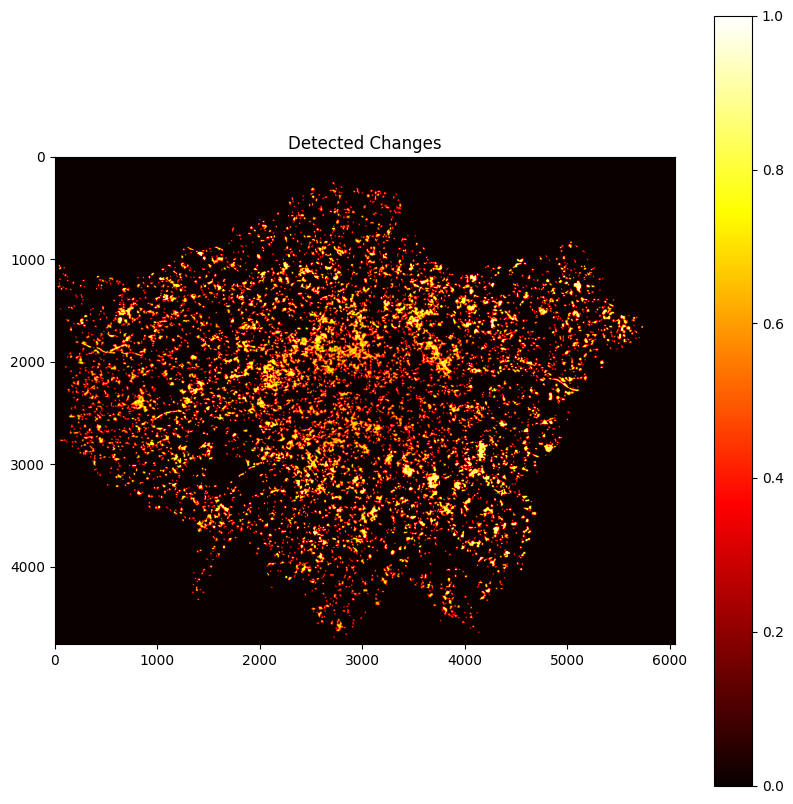

In [ ]:
# Apply thresholding strategy
cd_map = apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='otsu',
    min_size=64
    )

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()

In [ ]:
# cd_map = apply_thresholding_strategy(detected_change_map_normalized, strategy='adaptive', min_size=128)

# # Visualize the change map
# plt.figure(figsize=(10, 10))
# plt.imshow(cd_map, cmap='hot')
# plt.colorbar()
# plt.title('Detected Changes')
# plt.show()

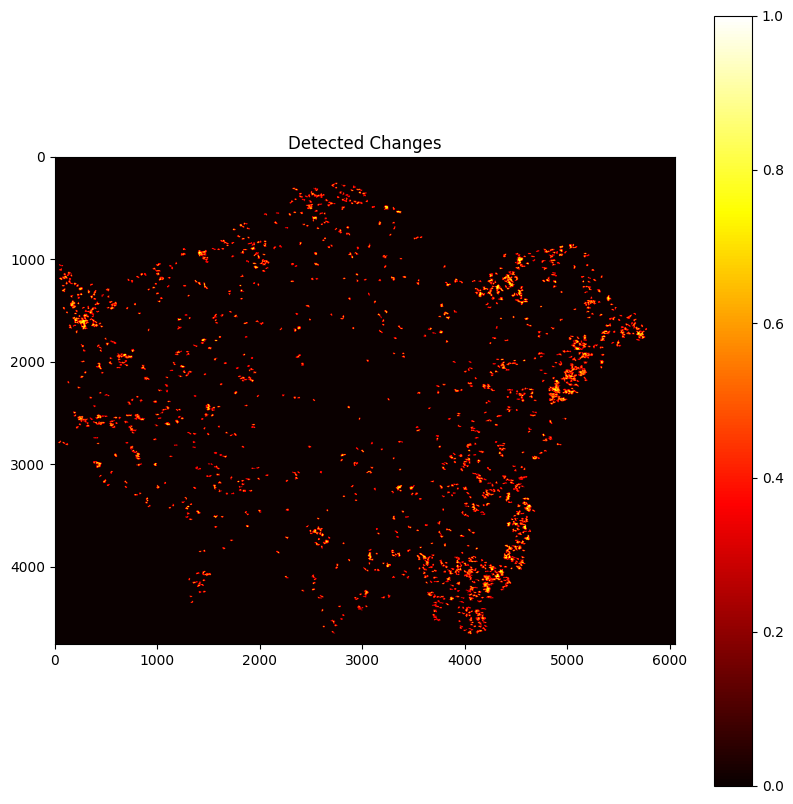

In [ ]:
cd_map = apply_thresholding_strategy(detected_change_map_normalized, strategy='scaledOtsu', min_size=128)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()

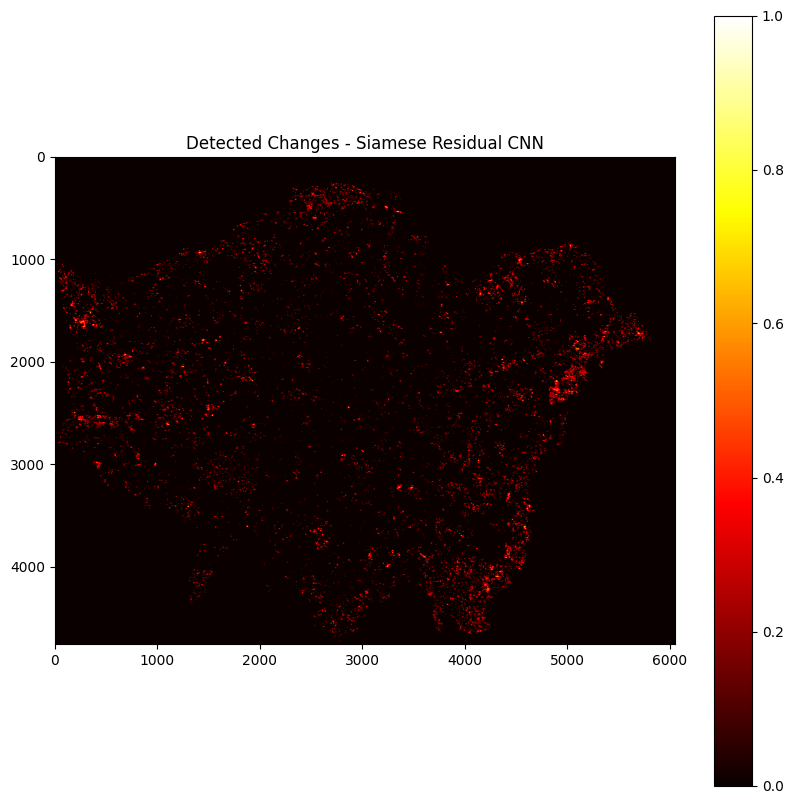

In [ ]:
cd_map = apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='multiotsu',
    min_size=8,
    segment=False,
    segment_min_size=10
    )

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - Siamese Residual CNN')
plt.show()

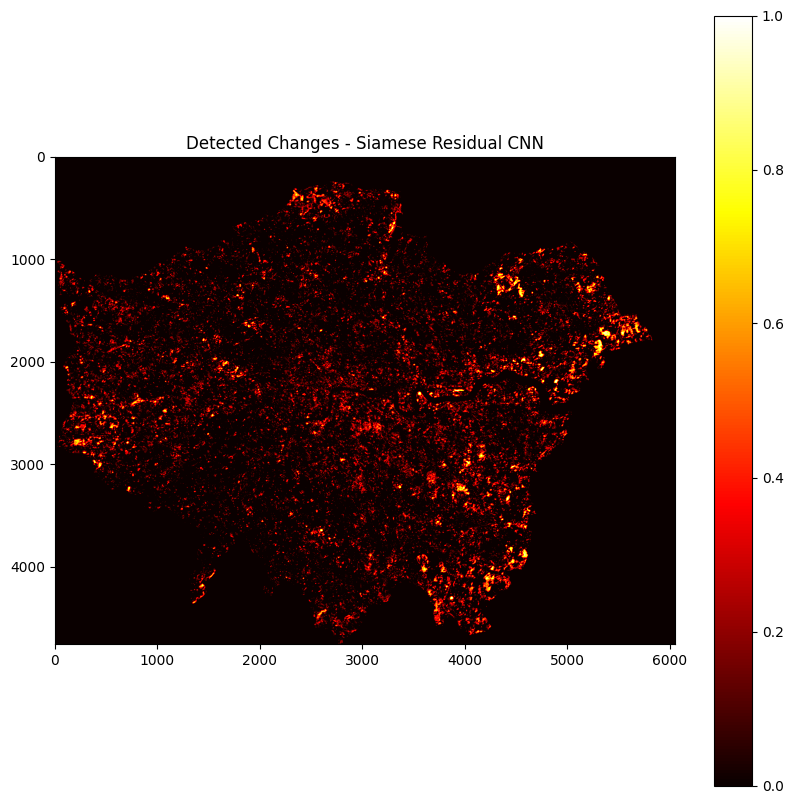

In [ ]:
cd_map = apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='multiotsu',
    min_size=2
    )

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - Siamese Residual CNN')
plt.show()

In [ ]:
import pandas as pd
pd.DataFrame(cd_map.flatten()).describe().round(2)

,0
count,28761700
unique,2
top,False
freq,28577418


In [ ]:
import os
import numpy as np
import rasterio

# Define the paths
data_path = "drive/MyDrive/dissertation/"
image2_path = os.path.join(data_path, "clipped_merged_2021.tiff")

# Read the metadata from one of the input images
with rasterio.open(image2_path) as src2:
    transform2 = src2.transform
    crs2 = src2.crs

# Get the change map from the model
# change_map = model(im1_tensor).detach().cpu().numpy()
change_map = cd_map.astype(np.uint8)

# Assuming the change map is in the first channel, reshape it to 2D
# change_map = change_map[0, 0, :, :]  # Adjust this indexing if necessary

# Create the raster metadata
raster_meta = {
    "driver": "GTiff",
    "height": change_map.shape[0],
    "width": change_map.shape[1],
    "count": 1,
    "dtype": change_map.dtype,
    "crs": crs2,
    "transform": transform2,
}

# Define the output path
output_path = os.path.join(data_path, "change_map_srcnn.tiff")

# Write the change map to the raster file
with rasterio.open(
    output_path,
    'w',
    **raster_meta
) as dst:
    dst.write(change_map, 1)

print(f"Change map saved to {output_path}")


Change map saved to drive/MyDrive/dissertation/change_map_srcnn.tiff


## Validation

In [ ]:
%pip install --quiet earthpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 56.9 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


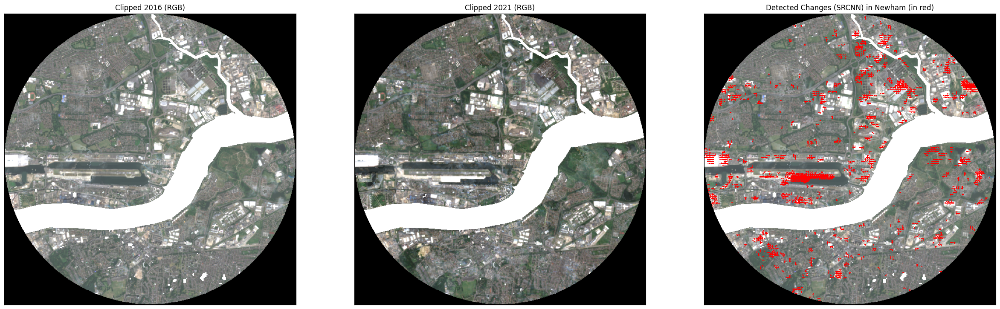

/usr/local/lib/python3.10/dist-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


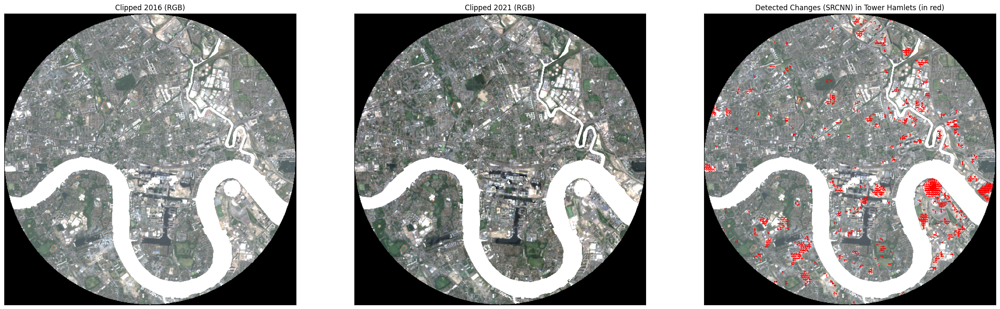

/usr/local/lib/python3.10/dist-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


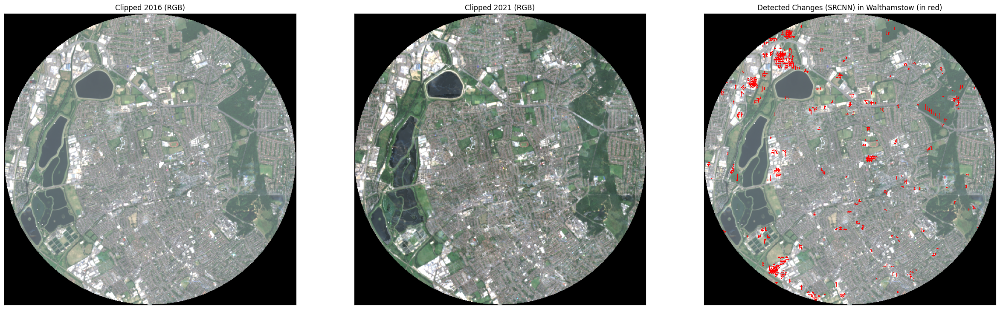

In [ ]:
import os
import numpy as np
import geopandas as gpd
from shapely.geometry import Point
import rasterio
from rasterio.mask import mask
import matplotlib.pyplot as plt
import earthpy.plot as ep


def create_buffer(latitude, longitude, buffer_radius_meters, raster_crs):
    point = Point(longitude, latitude)
    gdf = gpd.GeoDataFrame(geometry=[point], crs="EPSG:4326")
    gdf = gdf.to_crs(raster_crs)
    buffer = gdf.buffer(buffer_radius_meters)
    return buffer.geometry[0]

def clip_raster_by_geometry(raster_path, geometry, output_path):
    with rasterio.open(raster_path) as src:
        out_image, out_transform = mask(src, [geometry], crop=True)
        out_meta = src.meta.copy()
        out_meta.update(
            {
                "driver": "GTiff",
                "height": out_image.shape[1],
                "width": out_image.shape[2],
                "transform": out_transform,
                "nodata": 0
            }
        )
        with rasterio.open(output_path, "w", **out_meta) as dest:
            dest.write(out_image)
            dest.nodata = 0
    return output_path

def visualize_clipped_rasters_with_changes(
    image1_path, image2_path, changes_path, title, output_image_path, save=False
    ):
    with rasterio.open(image1_path) as src1:
        image1 = src1.read()
    with rasterio.open(image2_path) as src2:
        image2 = src2.read()
    with rasterio.open(changes_path) as src_changes:
        changes = src_changes.read(1)

    height, width = changes.shape
    rgba_image = np.zeros((height, width, 4), dtype=np.float32)
    mask = changes > 0
    rgba_image[mask] = [1, 0, 0, 1]

    fig, axes = plt.subplots(1, 3, figsize=(30, 10))
    ep.plot_rgb(image1, rgb=(3, 2, 1), ax=axes[0], title="Clipped 2016 (RGB)", stretch=True, str_clip=2)
    ep.plot_rgb(image2, rgb=(3, 2, 1), ax=axes[1], title="Clipped 2021 (RGB)", stretch=True, str_clip=2)
    ep.plot_rgb(image1, rgb=(3, 2, 1), ax=axes[2], title=title, stretch=True, str_clip=2)
    axes[2].imshow(rgba_image, interpolation="none")

    if save:
        plt.savefig(output_image_path, bbox_inches="tight", transparent=True, dpi=1000)
    plt.show()

locations = {
    "Newham": (51.5074, 0.0708),
    "Tower Hamlets": (51.509, -0.0208),
    "Walthamstow": (51.5908, -0.0195)
}

buffer_radius_meters = 3000
data_path = "drive/MyDrive/dissertation/"
output_path = "drive/MyDrive/dissertation/"
image1_path = os.path.join(data_path, "clipped_merged_2016.tiff")
image2_path = os.path.join(data_path, "clipped_merged_2021.tiff")
output_change_path = os.path.join(data_path, "change_map_srcnn.tiff")

with rasterio.open(image1_path) as src:
    raster_crs = src.crs

for location_name, (latitude, longitude) in locations.items():
    buffer = create_buffer(latitude, longitude, buffer_radius_meters, raster_crs)

    output_image1_path = os.path.join(output_path, f"clipped_buffer_2016_{location_name}.tiff")
    output_image2_path = os.path.join(output_path, f"clipped_buffer_2021_{location_name}.tiff")
    output_changes_path = os.path.join(output_path, f"clipped_buffer_changes_2016_2021_{location_name}.tiff")
    output_image_path = os.path.join(output_path, f"changes_visualization_{location_name}.png")

    clipped_image1_path = clip_raster_by_geometry(image1_path, buffer, output_image1_path)
    clipped_image2_path = clip_raster_by_geometry(image2_path, buffer, output_image2_path)
    clipped_changes_path = clip_raster_by_geometry(output_change_path, buffer, output_changes_path)

    visualize_clipped_rasters_with_changes(
        clipped_image1_path,
        clipped_image2_path,
        clipped_changes_path,
        f"Detected Changes (SRCNN) in {location_name} (in red)",
        output_image_path,
        save=False
    )


## Single Band

In [ ]:
%pip install --quiet rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 52.1 MB/s eta 0:00:00


In [ ]:
# Normalize using percentile saturation
def saturate_some_percentile_multispectral(input_map, percentile_to_saturate=5):
    input_map = input_map.astype(float)
    input_map_normalized = np.copy(input_map)
    for i in range(input_map.shape[2]):
        band = input_map[:, :, i]
        min_val = np.amin(band)
        max_val = np.percentile(band, 100 - percentile_to_saturate)
        band_normalized = (band - min_val) / (max_val - min_val)
        band_normalized[band_normalized > 1] = 1
        input_map_normalized[:, :, i] = band_normalized
    return input_map_normalized

In [ ]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import rasterio
from skimage import filters, morphology
from skimage.measure import label, regionprops


# Load images function
def load_image(image_path, bands=None): # e.g. bands=[4, 3, 2, 8]
    with rasterio.open(image_path) as src:
        if bands is not None:
          image = src.read(bands)
        else:
          image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Resize image to match target size
def resize_image(image, target_shape):
    resized_image = np.zeros((image.shape[0], target_shape[0], target_shape[1]))
    for i in range(image.shape[0]):
        resized_image[i] = cv2.resize(image[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands=[4]
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Normalize images
# im1_normalized = saturate_some_percentile_multispectral(im1, 5)
# im2_normalized = saturate_some_percentile_multispectral(im2, 5)

# Convert to tensors
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

print(
  f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}'
)

Using device: cuda
Images shape: torch.Size([1, 1, 4754, 6050]), torch.Size([1, 1, 4754, 6050])


In [ ]:
class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

class NetBlock(nn.Module):
    def __init__(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        super(NetBlock, self).__init__()
        self.conv_block = self.build_conv_block(dim, padding_type, norm_layer, use_dropout, use_bias)

    def build_conv_block(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        conv_block = []
        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError(f'padding [{padding_type}] is not implemented')

        conv_block += [
            nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias),
            norm_layer(dim),
            nn.ReLU(True)
        ]
        if use_dropout:
            conv_block += [nn.Dropout(0.5)]

        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError(f'padding [{padding_type}] is not implemented')

        conv_block += [
            nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias),
            norm_layer(dim)
        ]
        return nn.Sequential(*conv_block)

    def forward(self, x):
        out = x + self.conv_block(x)
        return out

class FeatureExtractor(nn.Module):
    def __init__(self, input_nc, output_nc, ngf=64, norm_layer=nn.BatchNorm2d, use_dropout=False, n_blocks=9, padding_type='reflect'):
        assert(n_blocks >= 0)
        super(FeatureExtractor, self).__init__()
        self.input_nc = input_nc
        self.output_nc = output_nc
        self.ngf = ngf
        use_bias = norm_layer == nn.InstanceNorm2d

        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0, bias=use_bias),
            norm_layer(ngf),
            nn.ReLU(True)
        ]

        n_downsampling = 2
        for i in range(n_downsampling):
            mult = 2 ** i
            model += [
                nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3, stride=2, padding=1, bias=use_bias),
                norm_layer(ngf * mult * 2),
                nn.ReLU(True)
            ]

        mult = 2 ** n_downsampling
        for i in range(n_blocks):
            model += [NetBlock(ngf * mult, padding_type=padding_type, norm_layer=norm_layer, use_dropout=use_dropout, use_bias=use_bias)]

        for i in range(n_downsampling):
            mult = 2 ** (n_downsampling - i)
            model += [
                nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2), kernel_size=3, stride=2, padding=1, output_padding=1, bias=use_bias),
                norm_layer(int(ngf * mult / 2)),
                nn.ReLU(True)
            ]

        self.model = nn.Sequential(*model)

    def forward(self, input):
        return self.model(input)

    def configure_optimizers(self, max_epochs, lr):
        def lambda_rule(epoch):
            lr_l = 1.0 - epoch / float(max_epochs + 1)
            return lr_l

        optimizer = optim.SGD(
            self.parameters(), lr=lr, momentum=0.9, weight_decay=5e-4
        )
        scheduler = LambdaLR(optimizer, lr_lambda=lambda_rule)
        return optimizer, scheduler

In [ ]:
def segment_image(binary_image, min_size=10):
    """
    Segment the binary image and remove small regions.

    Parameters:
    - binary_image: Binary image to be segmented
    - min_size: Minimum size for small regions to be removed

    Returns:
    - labeled_image: Labeled image after removing small regions
    """
    labeled_image = label(binary_image)
    for region in regionprops(labeled_image):
        if region.area < min_size:  # Remove small regions
            for coordinates in region.coords:
                labeled_image[coordinates[0], coordinates[1]] = 0
    return labeled_image


def apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='otsu',
    min_size=128,
    otsu_scaling_factor=1.0,
    segment=False,
    segment_min_size=10
    ):
    """
    Apply thresholding strategies to the detected change map.

    Parameters:
    - detected_change_map_normalized: Normalized change map
    - strategy: Thresholding strategy ('adaptive', 'otsu', 'multiotsu', 'scaledOtsu')
    - min_size: Minimum size for removing small objects
    - otsu_scaling_factor: Scaling factor for Otsu threshold (used only for 'scaledOtsu' strategy)

    Returns:
    - cd_map: Binary change detection map after applying the selected thresholding strategy
    """
    cd_map = np.zeros(detected_change_map_normalized.shape, dtype=bool)

    if strategy == 'adaptive':
        for sigma in range(101, 202, 50):
            adaptive_threshold = 2 * filters.gaussian(detected_change_map_normalized, sigma)
            cd_map_temp = detected_change_map_normalized > adaptive_threshold
            cd_map_temp = morphology.remove_small_objects(cd_map_temp, min_size=min_size)
            cd_map = cd_map | cd_map_temp

    elif strategy == 'otsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'multiotsu':
        otsu_threshold = filters.threshold_multiotsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold[1] # np.mean(otsu_threshold)
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'scaledOtsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > (otsu_scaling_factor * otsu_threshold)
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    else:
        raise ValueError('Unknown thresholding strategy')

    # cd_map = morphology.binary_closing(cd_map, morphology.disk(3))

    if segment:
      cd_map = segment_image(cd_map, segment_min_size)

    return cd_map


In [ ]:
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f'Using device: {device}')

In [ ]:
def train_and_save_features(
    band, image1_path, image2_path, output_dir, model_path,
    train_model=False, n_epochs=1, ngf=1, n_blocks=3
    ):

    # Load images for the current band
    im1, im2 = load_dataset(image1_path, image2_path, band)

    no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

    # Convert to tensors
    im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
    im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

    # Instantiate model
    model = FeatureExtractor(input_nc=1, output_nc=1, ngf=ngf, use_dropout=False, n_blocks=n_blocks).to(device)

    # Define loss and optimizer
    criterion = nn.MSELoss()
    # optimizer = optim.Adam(model.parameters(), lr=0.001)

    lr = 0.001
    optimizer = optim.Adam(model.parameters(), lr=lr)
    scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(n_epochs + 1))

    # Load pre-trained model if it exists
    if not train_model and os.path.exists(model_path):
        model.load_state_dict(torch.load(model_path))
        train_model = False
    else:
        train_model = True

    # Resize target to match output size
    def resize_to_match(target, reference):
        return F.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)

    # Training loop
    if train_model:
      for epoch in range(n_epochs):
          optimizer.zero_grad()
          outputs = model(im1_tensor)
          target_resized = resize_to_match(im2_tensor, outputs)
          loss = criterion(outputs, target_resized)
          loss.backward()
          optimizer.step()
          scheduler.step()
          print(f'Band {band}, Epoch {epoch+1}, Loss: {loss.item()}')

      # Save model
      torch.save(model.state_dict(), model_path)
      print(f'Model saved to {model_path}')

    # Extract features for both images
    features1 = model(im1_tensor).detach().cpu().numpy()[0]
    features2 = model(im2_tensor).detach().cpu().numpy()[0]

    # Resize features to match the no-data mask
    def resize_features(features, target_shape):
        resized_features = np.zeros((features.shape[0], target_shape[0], target_shape[1]))
        for i in range(features.shape[0]):
            resized_features[i] = cv2.resize(features[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
        return resized_features

    features1 = resize_features(features1, no_data_mask.shape)
    features2 = resize_features(features2, no_data_mask.shape)

    # Apply no-data mask to features
    features1[:, no_data_mask] = 0
    features2[:, no_data_mask] = 0

    # Normalize features
    normalized_features1 = (features1 - np.mean(features1)) / np.std(features1)
    normalized_features2 = (features2 - np.mean(features2)) / np.std(features2)

    # Aggregate features across channels
    aggregated_features1 = np.mean(normalized_features1, axis=0, keepdims=True)
    aggregated_features2 = np.mean(normalized_features2, axis=0, keepdims=True)

    # Compute absolute difference
    absolute_difference = np.abs(aggregated_features1 - aggregated_features2)

    # Calculate the change map using the norm of the differences
    detected_change_map = np.linalg.norm(absolute_difference, axis=0)

    # Normalize the change map
    numerator = (detected_change_map - np.amin(detected_change_map))
    denominator = (np.amax(detected_change_map) - np.amin(detected_change_map))
    detected_change_map_normalized = numerator / denominator

    change_map = apply_thresholding_strategy(
        detected_change_map_normalized,
        strategy='multiotsu',
        min_size=4,
        segment=False,
        segment_min_size=10
        )

    change_map = change_map.astype(np.uint8)

    # Define raster metadata
    with rasterio.open(image2_path) as src2:
        transform2 = src2.transform
        crs2 = src2.crs

    raster_meta = {
        "driver": "GTiff",
        "height": change_map.shape[0],
        "width": change_map.shape[1],
        "count": 1,
        "dtype": change_map.dtype,
        "crs": crs2,
        "transform": transform2,
    }

    output_path = os.path.join(output_dir, f"features_band_{band[0]}_srcnn.tiff")
    with rasterio.open(output_path, 'w', **raster_meta) as dst:
        dst.write(change_map, 1)

    print(f"Change map features for band {band[0]} saved to {output_path}")


# Define paths and bands to process
model_name = "srcnn"
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
output_dir = f"drive/MyDrive/dissertation/features_{model_name}/"
model_dir = "drive/MyDrive/dissertation/models/"
bands = list(range(1, 12))

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

# Loop through each band and train the model
# first run used lr 0.001, no weight decay, 100 epochs
# above setup achieves 0.77 in gentrification model
for band in bands:
  model_path = os.path.join(model_dir, f"model_band_{band}.pth")
  train_and_save_features(
      [band], image1_path, image2_path,
      output_dir, model_path, train_model=True,
      n_epochs=100, n_blocks=4
      )

Band [1], Epoch 1, Loss: 1.1055188179016113
Band [1], Epoch 2, Loss: 1.086559534072876
Band [1], Epoch 3, Loss: 1.0683091878890991
Band [1], Epoch 4, Loss: 1.0503288507461548
Band [1], Epoch 5, Loss: 1.0371166467666626
Band [1], Epoch 6, Loss: 1.0272178649902344
Band [1], Epoch 7, Loss: 1.0165284872055054
Band [1], Epoch 8, Loss: 1.006880521774292
Band [1], Epoch 9, Loss: 0.9973698258399963
Band [1], Epoch 10, Loss: 0.988706648349762
Band [1], Epoch 11, Loss: 0.9760204553604126
Band [1], Epoch 12, Loss: 0.9568412899971008
Band [1], Epoch 13, Loss: 0.9466041922569275
Band [1], Epoch 14, Loss: 0.942557692527771
Band [1], Epoch 15, Loss: 0.935480535030365
Band [1], Epoch 16, Loss: 0.9223079085350037
Band [1], Epoch 17, Loss: 0.9094404578208923
Band [1], Epoch 18, Loss: 0.8993542194366455
Band [1], Epoch 19, Loss: 0.889884352684021
Band [1], Epoch 20, Loss: 0.8834702372550964
Band [1], Epoch 21, Loss: 0.8779839277267456
Band [1], Epoch 22, Loss: 0.8692075610160828
Band [1], Epoch 23, Loss:

In [ ]:
list(range(1, 12))

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]

In [ ]:
# # %pip install numba

# from numba import cuda

# current_device = cuda.get_current_device()
# current_device.reset()

Features1 Resized and Masked Shape: (1, 1, 4754, 6050)
Features2 Resized and Masked Shape: (1, 1, 4754, 6050)


In [ ]:


import pandas as pd

pd.DataFrame(change_map.flatten()).describe().round(2)

,0
count,28783312.00
mean,0.20
std,0.27
min,0.00
25%,0.00
50%,0.01
75%,0.44
max,4.91


In [ ]:
threshold = np.percentile(change_map.flatten(), 50)
print(f"Using {threshold} as threshold")

NameError: name 'change_map' is not defined

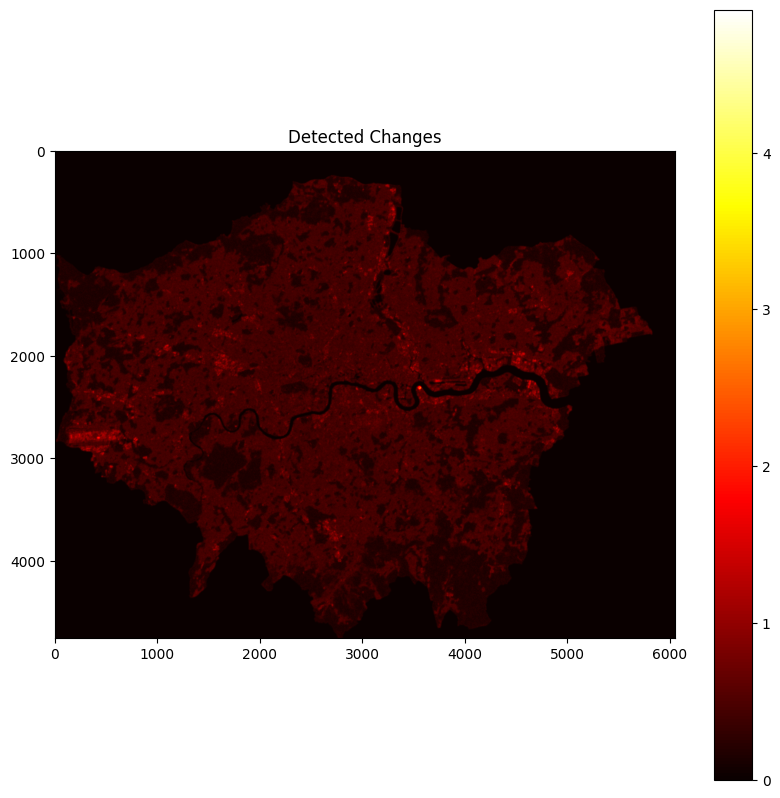

In [ ]:
plt.figure(figsize=(10, 10))
plt.imshow(change_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()


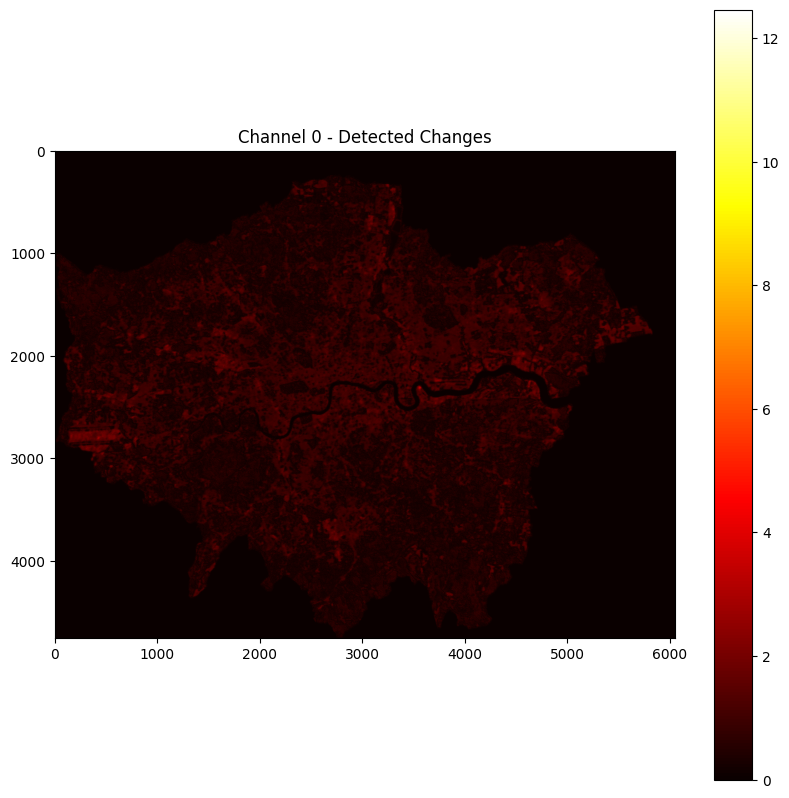

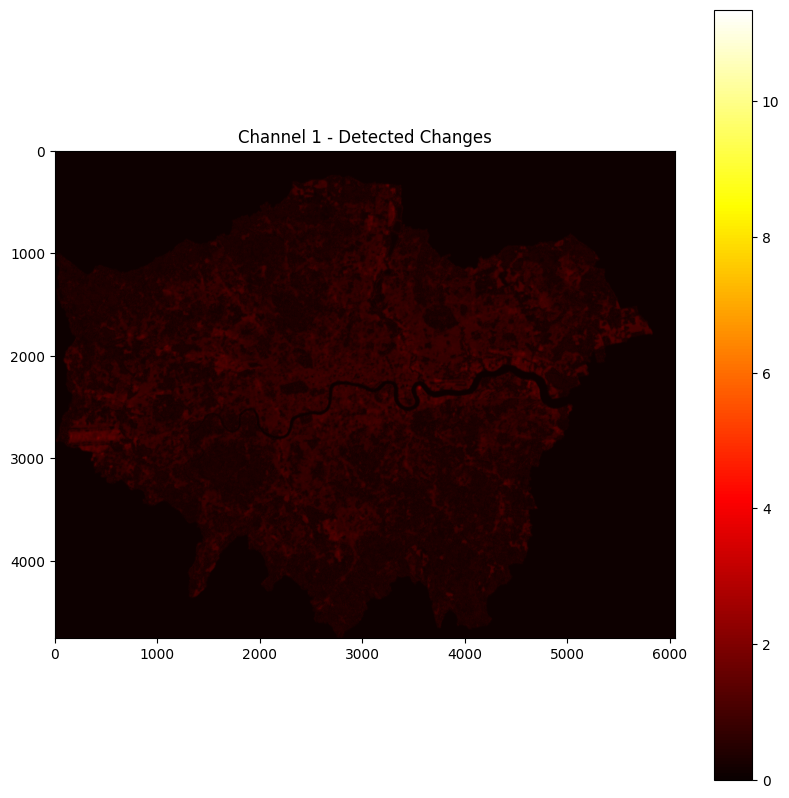

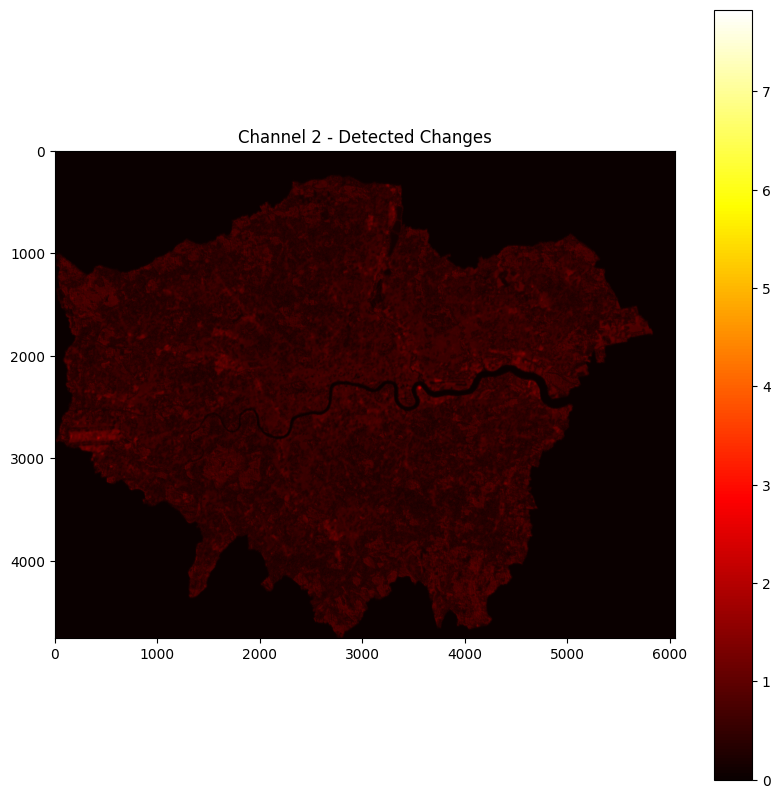

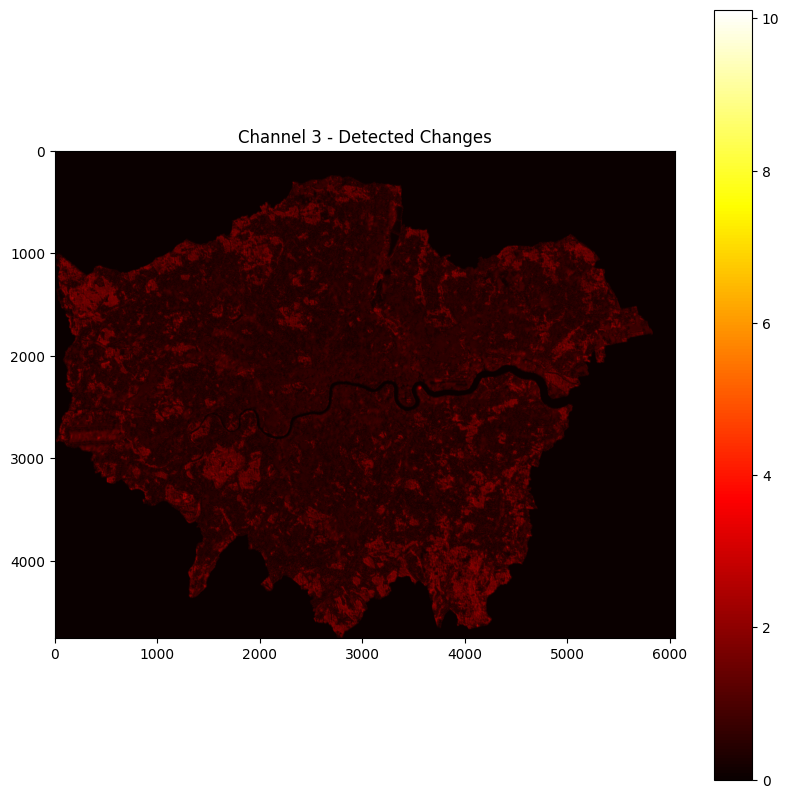

In [ ]:
# Visualize each channel to identify the change map
for i in range(outputs.shape[1]):
    plt.figure(figsize=(10, 10))
    plt.imshow(outputs[0, i, :, :].detach().numpy(), cmap='hot')
    plt.colorbar()
    plt.title(f'Channel {i} - Detected Changes')
    plt.show()

#  LightSiamese Network (LSNet)

In [ ]:
import numpy as np
import torch
import rasterio

def load_image(image_path, bands=[4, 3, 2, 8]):
    with rasterio.open(image_path) as src:
        image = src.read(bands)
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

def load_dataset(image1_path, image2_path):
    im1 = load_image(image1_path)
    im2 = load_image(image2_path)
    return im1, im2

# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path)

# Convert to tensors
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

print(im1_tensor.shape)  # Output: torch.Size([1, 4, 4754, 6050])


Using device: cuda
torch.Size([1, 4, 4754, 6050])


In [ ]:
class ContextGuidedBlock(nn.Module):
    def __init__(self, in_channels, out_channels, dilation, reduction, skip_connect=True):
        super(ContextGuidedBlock, self).__init__()
        self.conv1x1 = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1, padding=0)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.f_loc = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, groups=out_channels, bias=False)
        self.f_sur = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=dilation, dilation=dilation, groups=out_channels, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.skip_connect = skip_connect
        self.global_pool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Sequential(
            nn.Linear(out_channels, out_channels // reduction),
            nn.ReLU(inplace=True),
            nn.Linear(out_channels // reduction, out_channels),
            nn.Sigmoid()
        )

    def forward(self, x):
        residual = x
        x = self.conv1x1(x)
        x = self.bn1(x)
        x = self.relu(x)
        loc = self.f_loc(x)
        sur = self.f_sur(x)
        joi_feat = loc + sur
        joi_feat = self.bn2(joi_feat)
        num_batch, num_channel = joi_feat.size()[:2]
        y = self.global_pool(joi_feat).view(num_batch, num_channel)
        y = self.fc(y).view(num_batch, num_channel, 1, 1)
        y = joi_feat * y
        if self.skip_connect:
            return residual + y
        else:
            return y


In [ ]:
class Up(nn.Module):
    def __init__(self, in_ch, bilinear=True):
        super(Up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch, in_ch, 2, stride=2)

    def forward(self, x):
        return self.up(x)



class DiffFPN(nn.Module):
    def __init__(self, cur_channels, mid_ch, dilations, reductions, bilinear=True):
        super(DiffFPN, self).__init__()
        self.lateral_convs = nn.ModuleList([
            ContextGuidedBlock(cur_channels[i] * 2, mid_ch * 2 ** i, dilations[i], reductions[i])
            for i in range(4)
        ])

        self.top_down_convs = nn.ModuleList([
            ContextGuidedBlock(mid_ch * 2 ** i, mid_ch * 2 ** (i - 1), dilations[i], reductions[i])
            for i in range(3, 0, -1)
        ])

        self.diff_convs = nn.ModuleList([
            ContextGuidedBlock(mid_ch * (3 * 2 ** i), mid_ch * 2 ** i, dilations[i], reductions[i])
            for i in range(3)
        ] + [
            ContextGuidedBlock(mid_ch * (3 * 2 ** i), mid_ch * 2 ** i, dilations[i], reductions[i])
            for i in range(2)
        ] + [
            ContextGuidedBlock(mid_ch * 3, mid_ch * 2, dilations[0], reductions[0])
        ])

        self.up2x = Up(32, bilinear)

    def forward(self, output):
        tmp = [self.lateral_convs[i](torch.cat([output[i * 2], output[i * 2 + 1]], dim=1)) for i in range(4)]

        for i in range(3, 0, -1):
            tmp[i - 1] += self.up2x(self.top_down_convs[3 - i](tmp[i]))

        tmp = [self.diff_convs[i](torch.cat([tmp[i], self.up2x(tmp[i + 1])], dim=1)) for i in [0, 1, 2]]
        x0_1 = tmp[0]

        tmp = [self.diff_convs[i](torch.cat([tmp[i - 3], self.up2x(tmp[i - 2])], dim=1)) for i in [3, 4]]
        x0_2 = tmp[0]

        x0_3 = self.diff_convs[5](torch.cat([tmp[0], self.up2x(tmp[1])], dim=1))

        return x0_1, x0_2, x0_3


In [ ]:
# Define the backbone network, which should be implemented similarly to light_siamese_backbone
class SimpleBackbone(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(SimpleBackbone, self).__init__()
        self.conv1 = nn.Conv2d(in_ch, out_ch, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(out_ch, out_ch, kernel_size=3, stride=1, padding=1)
        self.conv4 = nn.Conv2d(out_ch, out_ch, kernel_size=3, stride=1, padding=1)

    def forward(self, x):
        x1 = self.conv1(x)
        x2 = self.conv2(x1)
        x3 = self.conv3(x2)
        x4 = self.conv4(x3)
        return [x1, x2, x3, x4]

# Instantiate and run the model
backbone = SimpleBackbone(in_ch=4, out_ch=2).to(device)
diff_fpn = DiffFPN(
    cur_channels=[1, 1, 1, 1],
    mid_ch=32,
    dilations=[1, 2, 2, 4],
    reductions=[2, 4, 8, 26]
).to(device)

# Forward pass
backbone_output = backbone(im1_tensor)
fpn_output = diff_fpn(backbone_output)

for i, output in enumerate(fpn_output):
    print(f'Output {i} shape: {output.shape}')


OutOfMemoryError: CUDA out of memory. Tried to allocate 220.00 MiB. GPU 

In [ ]:
im1_tensor.shape

torch.Size([1, 4, 4754, 6050])

# PCA + KMeans

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


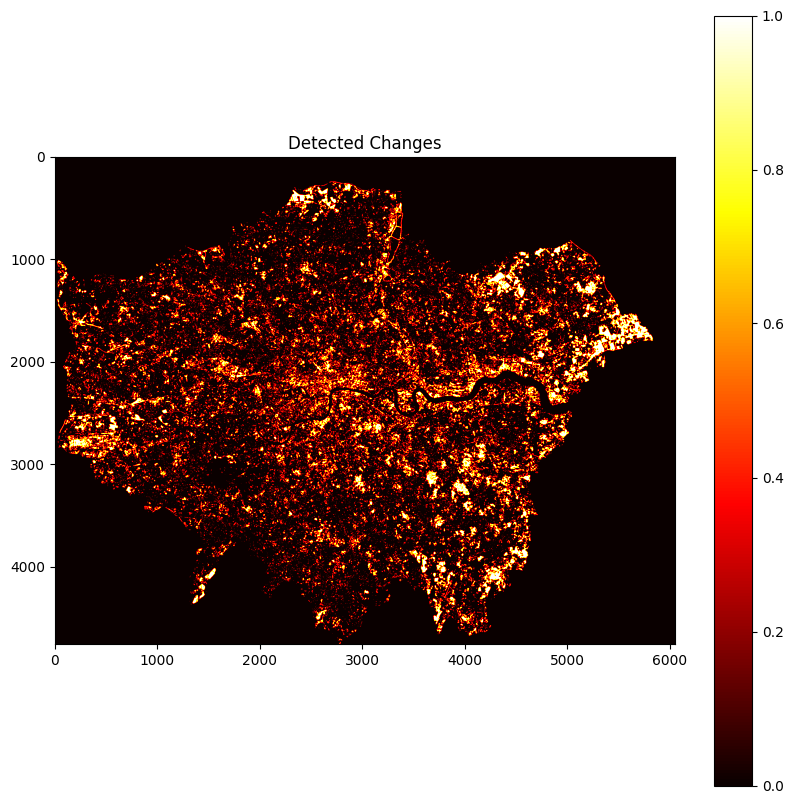

In [ ]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import rasterio

def load_image(image_path, bands=[4, 3, 2]):
    with rasterio.open(image_path) as src:
        image = src.read(bands)
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

def pca_kmeans(im1, im2, block_size=3, rate=0.9):
    image_size = im1.shape
    padding_size = (image_size[0], image_size[1] + block_size - 1, image_size[2] + block_size - 1)

    # Calculate the difference image
    delta = np.abs(im1 - im2)

    # Padding
    padding_img = np.zeros(padding_size)
    lb = block_size // 2
    ub_col = lb + image_size[1] - 1
    ub_row = lb + image_size[2] - 1
    padding_img[:, lb:ub_col + 1, lb:ub_row + 1] = delta

    # Generate feature vector for blocks
    vk = []
    for i in range(image_size[1]):
        for j in range(image_size[2]):
            vk_temp = padding_img[:, i:i + block_size, j:j + block_size]
            vk.append(vk_temp.flatten())
    vk = np.array(vk)

    # Normalization
    mean_val = np.mean(vk, axis=0)
    std_val = np.std(vk, axis=0) + 1e-12
    vk = (vk - mean_val) / std_val

    # PCA
    pca = PCA(n_components=rate)
    feature = pca.fit_transform(vk)

    # K-means clustering
    kmeans = KMeans(n_clusters=2, random_state=0).fit(feature)
    labels = kmeans.labels_

    # Reshape labels to create the change map
    change_map = labels.reshape(image_size[1], image_size[2])

    return change_map

# Load images
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1 = load_image(image1_path)
im2 = load_image(image2_path)

# Apply PCA-KMeans change detection
change_map = pca_kmeans(im1, im2, block_size=3, rate=0.9)

# Visualize change map
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 10))
plt.imshow(change_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - PCA + KMeans')
plt.show()


In [ ]:

data_path = "drive/MyDrive/dissertation/"
output_image_path = os.path.join(data_path, "cd_pca_kmeans.png")

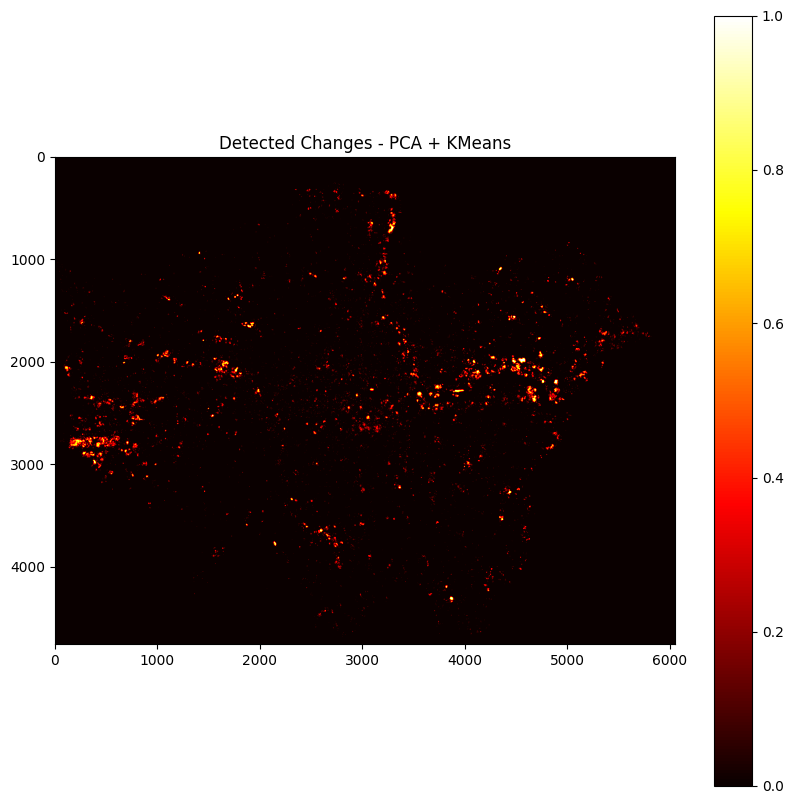

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 10))
plt.imshow(change_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - PCA + KMeans')
# plt.savefig(output_image_path, bbox_inches="tight", transparent=True, dpi=500)
plt.show()


# TinyCD

In [ ]:
%pip install --quiet rasterio

In [ ]:
# %pip install numba

In [ ]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import rasterio
from skimage import filters, morphology
from skimage.measure import label, regionprops


# Load images function
def load_image(image_path, bands=None): # e.g. bands=[4, 3, 2, 8]
    with rasterio.open(image_path) as src:
        if bands is not None:
          image = src.read(bands)
        else:
          image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Resize image to match target size
def resize_image(image, target_shape):
    resized_image = np.zeros((image.shape[0], target_shape[0], target_shape[1]))
    for i in range(image.shape[0]):
        resized_image[i] = cv2.resize(image[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands = [4]
# bands = list(range(1,12))
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Normalize images
# im1_normalized = saturate_some_percentile_multispectral(im1, 5)
# im2_normalized = saturate_some_percentile_multispectral(im2, 5)

# Convert to tensors
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

print(
  f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}'
)

Using device: cuda
Images shape: torch.Size([1, 1, 4754, 6050]), torch.Size([1, 1, 4754, 6050])


In [ ]:
# Function to extract patches from the image
def extract_patches(image, patch_size, stride):
    patches = []
    _, height, width = image.shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            patches.append(patch)
    return patches

# Function to reconstruct image from patches
def reconstruct_image(patches, image_size, patch_size, stride):
    reconstructed_image = np.zeros((image_size[0], image_size[1], image_size[2], image_size[3]))
    count_matrix = np.zeros((image_size[1], image_size[2], image_size[3]))
    patch_idx = 0
    for i in range(0, image_size[2] - patch_size + 1, stride):
        for j in range(0, image_size[3] - patch_size + 1, stride):
            reconstructed_image[:, :, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[:, i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    reconstructed_image /= count_matrix
    return reconstructed_image

In [ ]:
def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

## Model

In [ ]:
from typing import List, Optional
from torch import Tensor, reshape, stack
from torch.nn import (Conv2d, InstanceNorm2d, Module, PReLU, Sequential, Upsample)


class PixelwiseLinear(Module):
    def __init__(
        self,
        fin: List[int],
        fout: List[int],
        last_activation: Module = None,
    ) -> None:
        assert len(fout) == len(fin)
        super().__init__()

        n = len(fin)
        self._linears = Sequential(
            *[
                Sequential(
                    Conv2d(fin[i], fout[i], kernel_size=1, bias=True),
                    PReLU()
                    if i < n - 1 or last_activation is None
                    else last_activation,
                )
                for i in range(n)
            ]
        )

    def forward(self, x: Tensor) -> Tensor:
        # Processing the tensor:
        return self._linears(x)


class MixingBlock(Module):
    def __init__(self, ch_in: int, ch_out: int):
        super(MixingBlock, self).__init__()
        self.convmix = nn.Sequential(
            nn.Conv2d(ch_in, ch_out, kernel_size=3, padding=1),
            nn.PReLU(),
            nn.InstanceNorm2d(ch_out),
        )

    def forward(self, x: Tensor, y: Tensor) -> Tensor:
        mixed = torch.cat((x, y), dim=1)
        # mixed = torch.reshape(mixed, (x.shape[0], -1, x.shape[2], x.shape[3]))
        return self.convmix(mixed)


class MixingMaskAttentionBlock(Module):
    """use the grouped convolution to make a sort of attention"""

    def __init__(
        self,
        ch_in: int,
        ch_out: int,
        fin: List[int],
        fout: List[int],
        generate_masked: bool = False,
    ):
        super().__init__()
        self._mixing = MixingBlock(ch_in, ch_out)
        self._linear = PixelwiseLinear(fin, fout)
        self._final_normalization = InstanceNorm2d(ch_out) if generate_masked else None
        self._mixing_out = MixingBlock(ch_in, ch_out) if generate_masked else None

    def forward(self, x: Tensor, y: Tensor) -> Tensor:
        z_mix = self._mixing(x, y)
        z = self._linear(z_mix)
        z_mix_out = 0 if self._mixing_out is None else self._mixing_out(x, y)

        return (
            z
            if self._final_normalization is None
            else self._final_normalization(z_mix_out * z)
        )


class UpMask(Module):
    def __init__(
        self,
        scale_factor: float,
        nin: int,
        nout: int,
    ):
        super().__init__()
        self._upsample = Upsample(
            scale_factor=scale_factor, mode="bilinear", align_corners=True
        )
        self._convolution = Sequential(
            Conv2d(nin, nin, kernel_size=3, padding=1, groups=nin, bias=False),
            PReLU(),
            InstanceNorm2d(nin),
            Conv2d(nin, nout, kernel_size=1, stride=1),
            PReLU(),
            InstanceNorm2d(nout),
        )

    def forward(self, x: Tensor, y: Optional[Tensor] = None) -> Tensor:
        x = self._upsample(x)
        if y is not None:
            y = F.interpolate(y, size=x.shape[2:], mode='bilinear', align_corners=False)
            x = x * y
        return self._convolution(x)

In [ ]:
# %pip install torchvision

In [ ]:
import torchvision.models as tv_models


def modify_efficientnet_for_single_channel(model):
    # Locate and replace the first convolutional layer
    for name, module in model.named_children():
        if isinstance(module, nn.Conv2d) and module.in_channels == 3:
            new_conv = nn.Conv2d(
                1,
                module.out_channels,
                kernel_size=module.kernel_size,
                stride=module.stride,
                padding=module.padding,
                bias=module.bias
                )
            model._modules[name] = new_conv
            break
        elif isinstance(module, nn.Sequential):
            for seq_name, seq_module in module.named_children():
                if isinstance(seq_module, nn.Conv2d) and seq_module.in_channels == 3:
                    new_conv = nn.Conv2d(
                        1,
                        seq_module.out_channels,
                        kernel_size=seq_module.kernel_size,
                        stride=seq_module.stride,
                        padding=seq_module.padding,
                        bias=seq_module.bias
                        )
                    module._modules[seq_name] = new_conv
                    break
    return model


def _get_backbone(
    bkbn_name, weights, output_layer_bkbn, freeze_backbone
) -> nn.ModuleList:
    # The whole model:
    entire_model = getattr(tv_models, bkbn_name)(
        weights=weights
    ).features

    # Modify the first layer to accept single-channel input
    entire_model = modify_efficientnet_for_single_channel(entire_model)

    # Slicing it:
    derived_model = nn.ModuleList([])
    for name, layer in entire_model.named_children():
        derived_model.append(layer)
        if name == output_layer_bkbn:
            break

    # Freezing the backbone weights:
    if freeze_backbone:
        for param in derived_model.parameters():
            param.requires_grad = False
    return derived_model

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch import Tensor
from torch.nn import Module
from typing import List, Optional


class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

class TinyCD(Module):
    def __init__(
        self,
        bkbn_name="efficientnet_b0",
        weights='DEFAULT',
        output_layer_bkbn="3",
        freeze_backbone=False,
        bkbn_out_channels=None
    ):
        super().__init__()

        # Load the pretrained backbone according to parameters:
        self._backbone = _get_backbone(
            bkbn_name, weights, output_layer_bkbn, freeze_backbone
        )

        # Initialize mixing blocks:
        backbone_out_channels = {
            "efficientnet_b0": bkbn_out_channels, # [32, 32, 32, 64]
            "efficientnet_b4": [48, 64, 112, 1792],
            # Add more backbones and their corresponding output channels if needed
        }[bkbn_name]

        self._first_mix = MixingMaskAttentionBlock(2, backbone_out_channels[0], [backbone_out_channels[0]], [backbone_out_channels[0]])
        self._mixing_mask = nn.ModuleList(
            [
                MixingMaskAttentionBlock(
                    backbone_out_channels[0],
                    backbone_out_channels[1],
                     [backbone_out_channels[1]],
                      [backbone_out_channels[1]]
                    ),
                MixingMaskAttentionBlock(
                    backbone_out_channels[1],
                    backbone_out_channels[2],
                     [backbone_out_channels[2]],
                      [backbone_out_channels[2]]
                    ),
                MixingBlock(backbone_out_channels[2] * 2, backbone_out_channels[3]),
            ]
        )

        # Initialize Upsampling blocks:
        self._up = nn.ModuleList(
            [
                UpMask(2, backbone_out_channels[3], backbone_out_channels[2]),
                UpMask(2, backbone_out_channels[2], backbone_out_channels[1]),
                UpMask(2, backbone_out_channels[1], backbone_out_channels[0]),
            ]
        )

        # Final classification layer:
        self._classify = PixelwiseLinear(
            [backbone_out_channels[0],
             int(backbone_out_channels[0] / 2),
             int(backbone_out_channels[0] / 4)],
              [int(backbone_out_channels[0] / 2),
               int(backbone_out_channels[0] / 4), 1],
            nn.Identity()
            )

    def forward(self, ref: Tensor, test: Tensor) -> Tensor:
        features = self._encode(ref, test)
        latents = self._decode(features)
        return self._classify(latents)

    def _encode(self, ref, test) -> List[Tensor]:
        features = [self._first_mix(ref, test)]
        for num, layer in enumerate(self._backbone):
            ref, test = layer(ref), layer(test)
            if num != 0:
                features.append(self._mixing_mask[num - 1](ref, test))
        return features

    def _decode(self, features):
        # Add a check to handle cases where 'features' might be shorter than expected
        num_up_layers = len(self._up)
        num_features = len(features)

        upping = self._up[-1](features[-1])  # Start with the last feature map

        for i in range(1, min(num_up_layers, num_features)):
            upping = self._up[-i-1](upping, features[-i-1])  # Iterate backwards, matching layers to features
        return upping

    def configure_optimizers(self, max_epochs, lr):
        def lambda_rule(epoch):
            lr_l = 1.0 - epoch / float(max_epochs + 1)
            return lr_l

        optimizer = optim.SGD(
            self.parameters(), lr=lr, momentum=0.9, weight_decay=5e-4
        )
        scheduler = LambdaLR(optimizer, lr_lambda=lambda_rule)
        return optimizer, scheduler

def resize_to_match(target: Tensor, reference: Tensor) -> Tensor:
    return F.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)


In [ ]:
# %pip install --quiet torchsummary torchviz

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.7/19.7 MB 7.6 MB/s eta 0:00:00


In [ ]:
class DiceLoss(nn.Module):
    def __init__(self):
        super(DiceLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        # Flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        dice = (2.*intersection + smooth) / (inputs.sum() + targets.sum() + smooth)

        return 1 - dice

# criterion = DiceLoss()


In [ ]:
class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

# Function to extract patches from the image
def extract_patches(image, patch_size, stride):
    patches = []
    _, height, width = image.shape[-3:]  # Update to handle correct shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            patches.append(patch)
    return patches

# Function to reconstruct image from patches
def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

In [ ]:
import torch
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
# from utils import extract_patches, reconstruct_image, ClearCache  # Assume these utilities are available

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define the model
num_channels = im1_tensor.shape[1] # bands
bkbn_out_channels = [32, 32, 32, 1]
model = None
model = TinyCD(
    bkbn_name="efficientnet_b0",
    weights='DEFAULT',
    output_layer_bkbn="1",
    freeze_backbone=False,
    bkbn_out_channels=bkbn_out_channels
    ).to(device)
# model = CGNet(weights='DEFAULT').to(device)
# model = SiamUnet_diff(input_nbr=1, label_nbr=1).to(device)
# model = BiDateNet(n_channels=1, n_classes=1).to(device)

# Define loss and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(50 + 1))

# Patch size and stride
patch_size = 256
stride = patch_size // 2
batch_size = 8

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)

# Ensure the tensors are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.squeeze(1)
im2_patches = im2_patches.squeeze(1)

dataset = TensorDataset(im1_patches, im2_patches)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)

# Training loop
num_epochs = 1
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    with ClearCache():
      for im1_patch_batch, im2_patch_batch in dataloader:
          im1_patch_batch, im2_patch_batch = im1_patch_batch.to(device), im2_patch_batch.to(device)
          output = model(im1_patch_batch, im2_patch_batch)
          resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
          loss = criterion(resized_output, im1_patch_batch)
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
    scheduler.step()
    print(f'Epoch {epoch + 1}, Loss: {loss.item():.4f}')

# Save the trained model
torch.save(model.state_dict(), 'tinycd.pth')


Epoch 1, Loss: 0.0697


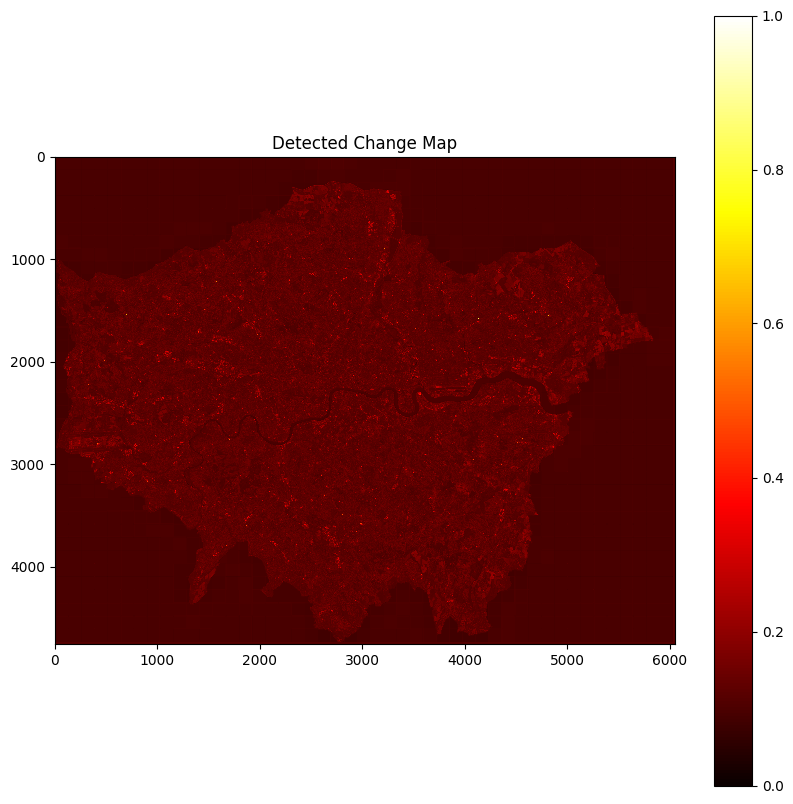

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Model initialization
# model = SiamUnet_diff(input_nbr=1, label_nbr=1).to(device)
# model.load_state_dict(torch.load('siam_unet_diff.pth'))
model.eval()

# Function to generate change map
def generate_change_map(model, im1_patches, im2_patches, patch_size, stride, image_shape):
    model.eval()
    change_patches = []

    with torch.no_grad():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = im1_patch.unsqueeze(0).to(device)  # Add batch dimension
            im2_patch = im2_patch.unsqueeze(0).to(device)  # Add batch dimension
            output = model(im1_patch, im2_patch)
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy().squeeze())

    change_patches = np.array(change_patches)
    change_map = reconstruct_image(change_patches, image_shape, patch_size, stride)

    # Normalize the change map to the range [0, 1]
    change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

    return change_map

def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

def visualize_change_map(change_map):
    plt.figure(figsize=(10, 10))
    plt.imshow(change_map, cmap='hot', interpolation='nearest')
    plt.colorbar()
    plt.title('Detected Change Map')
    plt.show()

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches])
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches])

# Ensure patches are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.view(-1, 1, patch_size, patch_size)
im2_patches = im2_patches.view(-1, 1, patch_size, patch_size)

# Generate and visualize the change map
change_map = generate_change_map(model, im1_patches, im2_patches, patch_size, stride, im1_tensor.shape)

if change_map.ndim == 3:
    change_map = np.squeeze(change_map)

visualize_change_map(change_map)


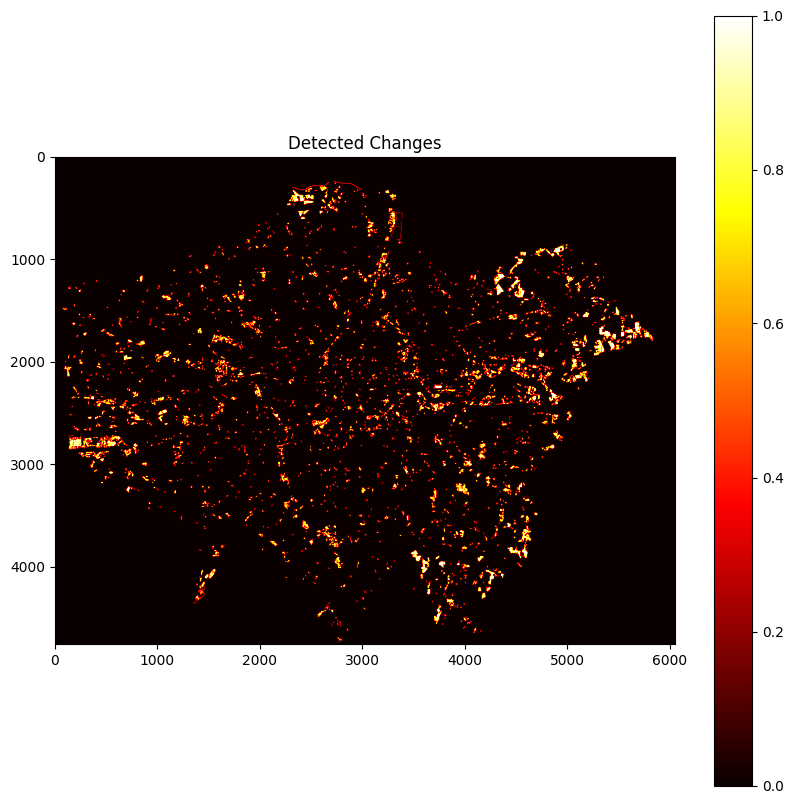

In [ ]:
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=64
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title(f'Detected Changes')
plt.show()

In [ ]:
import torch
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
# from torch.nn import MSELoss
import matplotlib.pyplot as plt
from torch.cuda.amp import autocast, GradScaler


# Model initialization
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_channels = im1_tensor.shape[1] # bands
bkbn_out_channels = [32, 32, 32, 1]
model = None
model = TinyCD(
    bkbn_name="efficientnet_b0",
    weights='DEFAULT',
    output_layer_bkbn="1",
    freeze_backbone=False,
    bkbn_out_channels=bkbn_out_channels
    ).to(device)

lr = 0.01
num_epochs = 1

# Loss function
# criterion = nn.MSELoss()
criterion = DiceLoss()
# criterion = nn.BCEWithLogitsLoss()

# Optimizer and Scheduler
# optimizer, scheduler = model.configure_optimizers(num_epochs, lr)
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(num_epochs + 1))

# Using im1_tensor for training
ground_truth = (im1_tensor != im2_tensor).float().mean(dim=1, keepdim=True).to(device)
# ground_truth = torch.abs(im1_tensor - im2_tensor).float().mean(dim=1, keepdim=True).to(device)

# Verify tensor shapes before training
print(f"im1_tensor shape: {im1_tensor.shape}")
print(f"ground_truth shape: {ground_truth.shape}")

# Patch size and stride
patch_size = 256
stride = patch_size // 2

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)
gt_patches = extract_patches(ground_truth.squeeze(0), patch_size, stride)

# Convert patches to tensor
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)
gt_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in gt_patches]).to(device)

# Training the model
scaler = GradScaler()
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    with ClearCache():
        for i in range(im1_patches.size(0)):
            with autocast():
                output = model(im1_patches[i], im2_patches[i])
                resized_output = F.interpolate(output, size=gt_patches[i].shape[2:], mode='bilinear', align_corners=False)
                loss = criterion(resized_output, gt_patches[i])
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
        scheduler.step()
    print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')


# Save the model
torch.save(model.state_dict(), "tinycd_model.pth")


im1_tensor shape: torch.Size([1, 1, 4754, 6050])
ground_truth shape: torch.Size([1, 1, 4754, 6050])
Epoch [1/1], Loss: 0.4773


## Thresholding

In [ ]:
def segment_image(binary_image, min_size=10):
    """
    Segment the binary image and remove small regions.

    Parameters:
    - binary_image: Binary image to be segmented
    - min_size: Minimum size for small regions to be removed

    Returns:
    - labeled_image: Labeled image after removing small regions
    """
    labeled_image = label(binary_image)
    for region in regionprops(labeled_image):
        if region.area < min_size:  # Remove small regions
            for coordinates in region.coords:
                labeled_image[coordinates[0], coordinates[1]] = 0
    return labeled_image


def apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='otsu',
    min_size=128,
    otsu_scaling_factor=1.0,
    segment=False,
    segment_min_size=10
    ):
    """
    Apply thresholding strategies to the detected change map.

    Parameters:
    - detected_change_map_normalized: Normalized change map
    - strategy: Thresholding strategy ('adaptive', 'otsu', 'multiotsu', 'scaledOtsu')
    - min_size: Minimum size for removing small objects
    - otsu_scaling_factor: Scaling factor for Otsu threshold (used only for 'scaledOtsu' strategy)

    Returns:
    - cd_map: Binary change detection map after applying the selected thresholding strategy
    """
    cd_map = np.zeros(detected_change_map_normalized.shape, dtype=bool)

    if strategy == 'adaptive':
        for sigma in range(101, 202, 50):
            adaptive_threshold = 2 * filters.gaussian(detected_change_map_normalized, sigma)
            cd_map_temp = detected_change_map_normalized > adaptive_threshold
            cd_map_temp = morphology.remove_small_objects(cd_map_temp, min_size=min_size)
            cd_map = cd_map | cd_map_temp

    elif strategy == 'otsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'multiotsu':
        otsu_threshold = filters.threshold_multiotsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold[1] # np.mean(otsu_threshold)
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'scaledOtsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > (otsu_scaling_factor * otsu_threshold)
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    else:
        raise ValueError('Unknown thresholding strategy')

    # cd_map = morphology.binary_closing(cd_map, morphology.disk(3))

    if segment:
      cd_map = segment_image(cd_map, segment_min_size)

    return cd_map


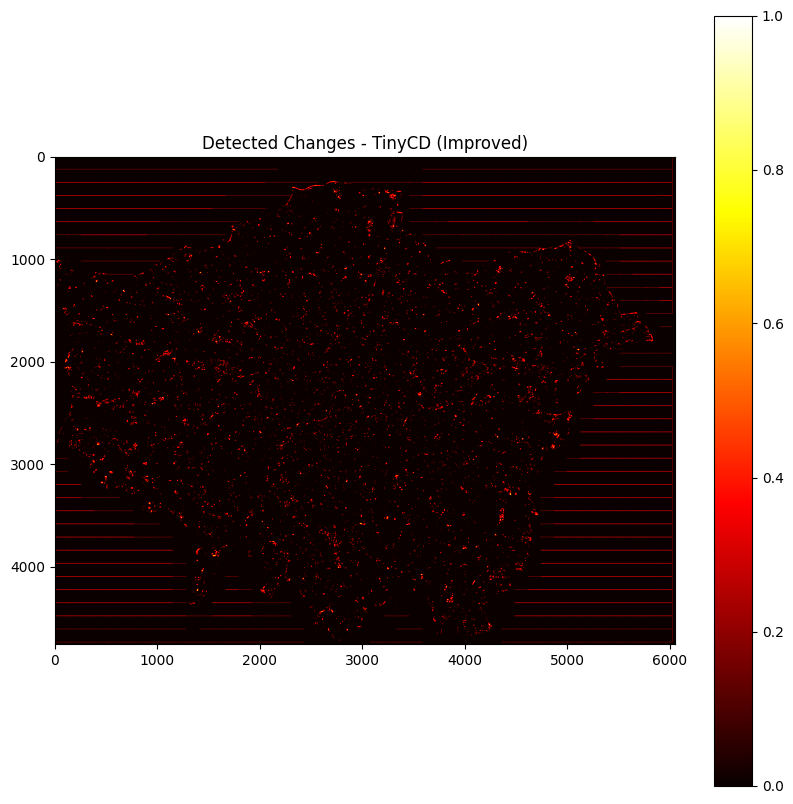

In [ ]:
import numpy as np
import torch
import torch.nn.functional as F

# Function to reconstruct image from patches
def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

# Process each patch through the model
change_patches = []
model.eval()
with torch.no_grad():
    for i in range(im1_patches.size(0)):
        output = model(im1_patches[i], im2_patches[i])
        resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
        change_patches.append(resized_output.cpu().numpy().squeeze())

# Convert list to numpy array
change_patches = np.array(change_patches)

# Reconstruct the change map from patches
change_map = reconstruct_image(change_patches, im1_tensor.shape, patch_size, stride)

# Normalize the change map to the range [0, 1]
change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

# Apply thresholding strategy (if necessary)
cd_map = apply_thresholding_strategy(
    change_map.squeeze(),
    strategy='multiotsu',
    min_size=4
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - TinyCD (Improved)')
plt.show()


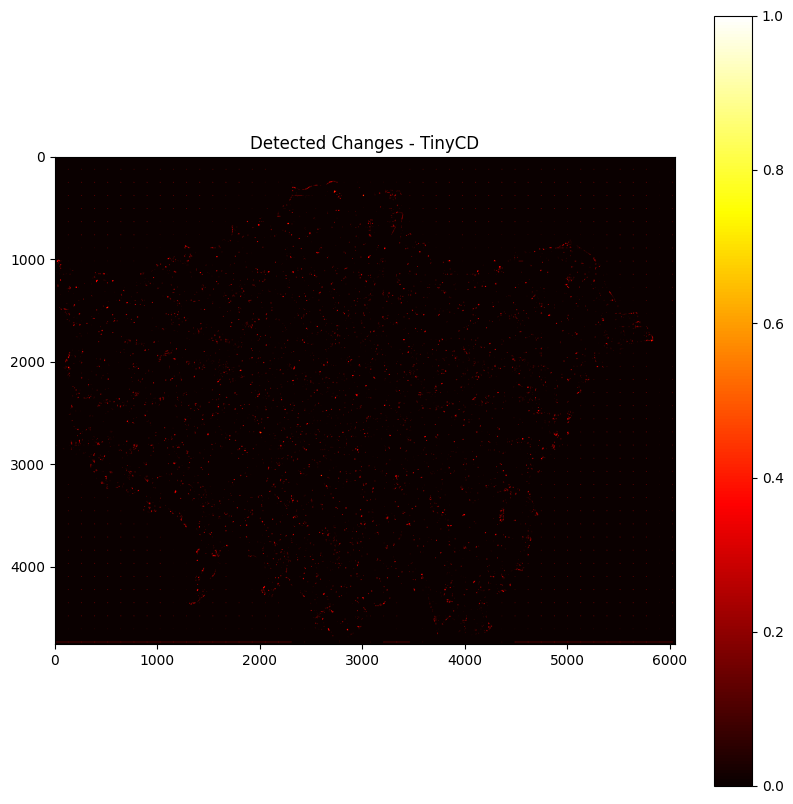

In [ ]:
# Function to reconstruct image from patches
def reconstruct_image(patches, image_shape, patch_size, stride):
    reconstructed_image = np.zeros((image_shape[1], image_shape[2], image_shape[3]))
    count_matrix = np.zeros((image_shape[2], image_shape[3]))
    patch_idx = 0
    for i in range(0, image_shape[2] - patch_size + 1, stride):
        for j in range(0, image_shape[3] - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

# Process each patch through the model
change_patches = []
model.eval()
with torch.no_grad():
    for i in range(im1_patches.size(0)):
        output = model(im1_patches[i], im2_patches[i])
        # resized_output = F.interpolate(output, size=gt_patches[i].shape[2:], mode='bilinear', align_corners=False)
        resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
        change_patches.append(resized_output.cpu().numpy().squeeze())

# Convert list to numpy array
change_patches = np.array(change_patches)

# Reconstruct the change map from patches
change_map = reconstruct_image(change_patches, im1_tensor.shape, patch_size, stride)

# Normalize the change map to the range [0, 1]
change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

# Apply thresholding strategy (if necessary)
cd_map = apply_thresholding_strategy(
    change_map.squeeze(),
    strategy='multiotsu',
    min_size=2,
    segment=False,
    segment_min_size=128
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - TinyCD')
plt.show()

In [ ]:
import torch
import torch.nn.functional as F
import torchvision.models as tv_models
import matplotlib.pyplot as plt
import rasterio
from rasterio.transform import from_origin

# Assuming necessary model definitions (TinyCD, etc.) and helper functions are already available.

# Define the backbone modification function
def modify_efficientnet_for_single_channel(model):
    for name, module in model.named_children():
        if isinstance(module, nn.Conv2d) and module.in_channels == 3:
            new_conv = nn.Conv2d(1, module.out_channels, kernel_size=module.kernel_size, stride=module.stride, padding=module.padding, bias=module.bias)
            model._modules[name] = new_conv
            break
        elif isinstance(module, nn.Sequential):
            for seq_name, seq_module in module.named_children():
                if isinstance(seq_module, nn.Conv2d) and seq_module.in_channels == 3:
                    new_conv = nn.Conv2d(1, seq_module.out_channels, kernel_size=seq_module.kernel_size, stride=seq_module.stride, padding=seq_module.padding, bias=seq_module.bias)
                    module._modules[seq_name] = new_conv
                    break
    return model

def _get_backbone(bkbn_name, pretrained, output_layer_bkbn, freeze_backbone) -> nn.ModuleList:
    entire_model = getattr(tv_models, bkbn_name)(pretrained=pretrained).features
    entire_model = modify_efficientnet_for_single_channel(entire_model)
    derived_model = nn.ModuleList([])
    for name, layer in entire_model.named_children():
        derived_model.append(layer)
        if name == output_layer_bkbn:
            break
    if freeze_backbone:
        for param in derived_model.parameters():
            param.requires_grad = False
    return derived_model

# Load the model
model = None
model = TinyCD(
    bkbn_name="efficientnet_b0",
    weights='DEFAULT',
    output_layer_bkbn="1",
    freeze_backbone=False
).to(device)

# Set the model to evaluation mode
model.eval()


# Patch size and stride
patch_size = 256
stride = patch_size // 2

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)

# Process each patch through the model
change_patches = []
batch_size = 4  # Adjust based on your GPU memory
with torch.no_grad():
    for i in range(0, im1_patches.size(0), batch_size):
        batch_im1 = im1_patches[i:i+batch_size]
        batch_im2 = im2_patches[i:i+batch_size]
        output = model(batch_im1, batch_im2)
        resized_output = F.interpolate(output, size=batch_im1.shape[2:], mode='bilinear', align_corners=False)
        for j in range(resized_output.size(0)):
            change_patches.append(resized_output[j].cpu().numpy().squeeze())

# Reconstruct the change map from patches
change_map = reconstruct_image(change_patches, im1_tensor.shape, patch_size, stride)

# Normalize the change map to the range [0, 1]
change_map = (change_map - np.nanmin(change_map)) / (np.nanmax(change_map) - np.nanmin(change_map))

# Apply thresholding strategy
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=4,
    segment=False,
    segment_min_size=128
)

# # Save the change map as a tiff file
# transform = from_origin(0, 0, 1, 1)  # Example transform, adjust to your data
# with rasterio.open(
#     "change_map.tiff", "w", driver="GTiff",
#     height=change_map.shape[0], width=change_map.shape[1],
#     count=1, dtype=change_map.dtype,
#     crs='+proj=latlong',
#     transform=transform,
# ) as dst:
#     dst.write(change_map, 1)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - TinyCD')
plt.show()



/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


RuntimeError: Given groups=1, weight of size [32, 2, 3, 3], expected input[4, 512, 1, 256] to have 2 channels, but got 512 channels instead

In [ ]:
vars(TinyCD)

mappingproxy({'__module__': '__main__',
              '__init__': <function __main__.TinyCD.__init__(self, bkbn_name='efficientnet_b0', weights='DEFAULT', output_layer_bkbn='3', freeze_backbone=False)>,
              'forward': <function __main__.TinyCD.forward(self, ref: torch.Tensor, test: torch.Tensor) -> torch.Tensor>,
              '_encode': <function __main__.TinyCD._encode(self, ref, test) -> List[torch.Tensor]>,
              '_decode': <function __main__.TinyCD._decode(self, features)>,
              'configure_optimizers': <function __main__.TinyCD.configure_optimizers(self, max_epochs, lr)>,
              '__doc__': None})

In [ ]:
import matplotlib.pyplot as plt
import torch
import cv2

def resize_mask(mask, target_shape):
    return cv2.resize(mask.astype(np.float32), (target_shape[1], target_shape[0]), interpolation=cv2.INTER_NEAREST).astype(bool)

# Load the model
model.load_state_dict(torch.load("tinycd_model.pth"))

# Set the model to evaluation mode
model.eval()

# Extract features
with torch.no_grad():
    with ClearCache():
        features1 = model._encode(im1_tensor, im2_tensor)
        features2 = model._encode(im2_tensor, im1_tensor)

# Get the shape of the feature maps
feature_map_shape = features1.shape[2:]

# Resize the no_data_mask to match the feature map shape
resized_no_data_mask = resize_mask(no_data_mask, feature_map_shape)

# Convert mask to tensor and move to device
resized_no_data_mask_tensor = torch.tensor(resized_no_data_mask, device=device).unsqueeze(0).unsqueeze(0)

# Apply no-data mask to features
features1 = features1 * (~resized_no_data_mask_tensor)
features2 = features2 * (~resized_no_data_mask_tensor)

# Create change map
change_map = torch.abs(features1 - features2).mean(dim=1, keepdim=True)
change_map_resized = resize_to_match(change_map, im1_tensor)

# Change Map visualization
change_map = change_map_resized.squeeze().cpu().numpy()

# Apply thresholding strategy
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=2,
    segment=False,
    segment_min_size=128
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()


OutOfMemoryError: CUDA out of memory. Tried to allocate 3.43 GiB. GPU 

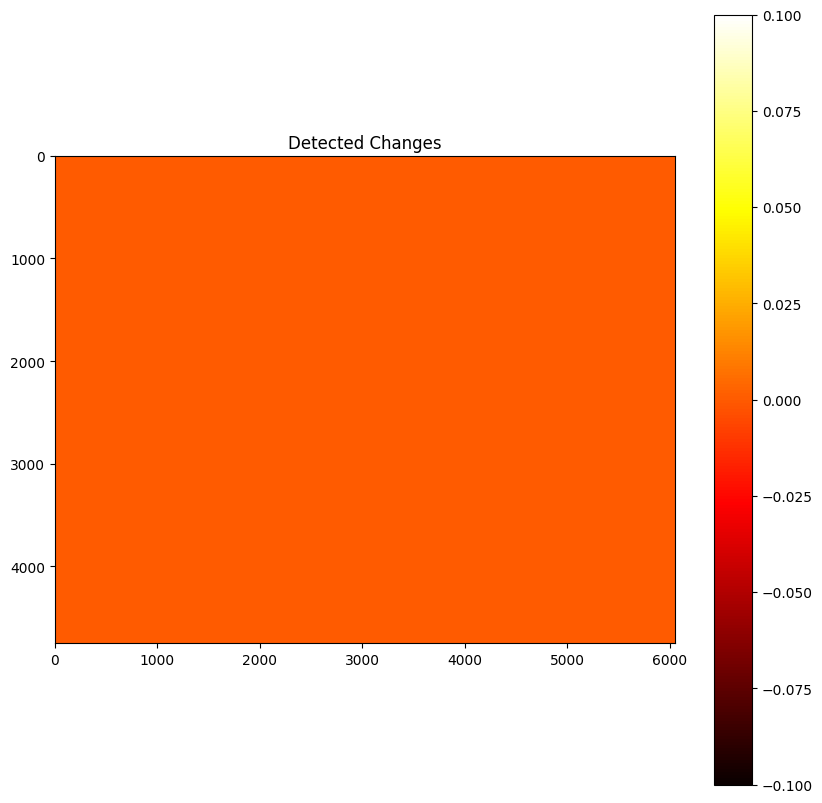

In [ ]:

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(change_map>0.5, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()


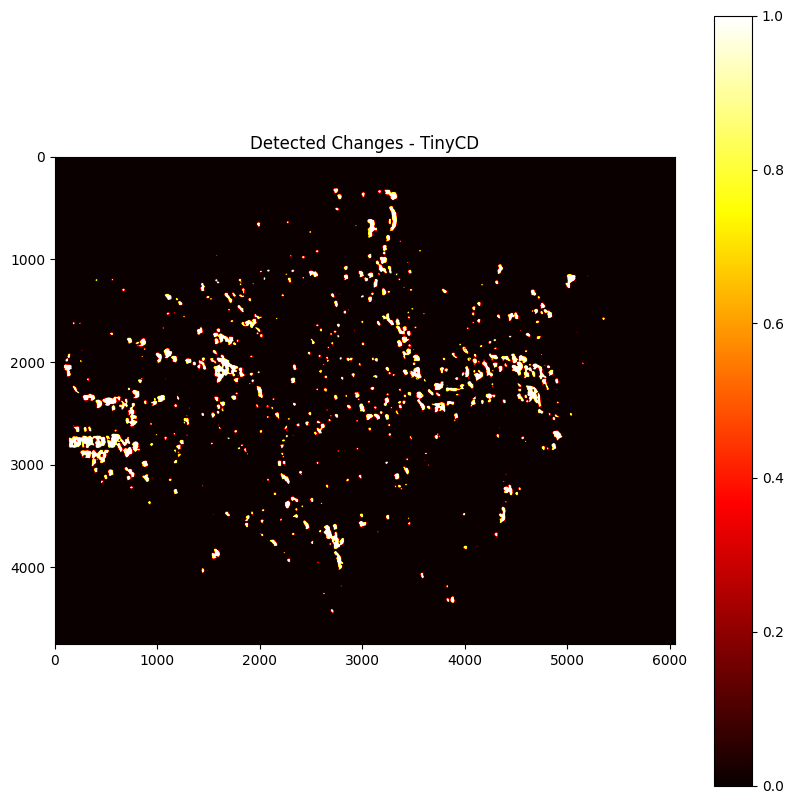

In [ ]:
# Feature extraction and visualization
import torch
import matplotlib.pyplot as plt
import cv2
import numpy as np

def resize_mask(mask, target):
    return cv2.resize(mask.astype(np.float32), (target.shape[1], target.shape[0]), interpolation=cv2.INTER_NEAREST).astype(bool)

def resize_to_match(target, reference):
    return torch.nn.functional.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)

# Extract features
with torch.no_grad():
    with ClearCache():
        output = model(im1_tensor, im2_tensor)

# Use the output directly from the decoder
change_map = output.squeeze().cpu().numpy()

# Normalize the change map if needed (though sigmoid output should already be between 0 and 1)
detected_change_map_normalized = (change_map - np.nanmin(change_map)) / (np.nanmax(change_map) - np.nanmin(change_map))

# Ensure the no-data mask is the correct shape
no_data_mask_resized = resize_mask(no_data_mask, change_map)

# Apply the no-data mask correctly
detected_change_map_normalized[no_data_mask_resized] = np.nan

# Replace NaN values with 0 for thresholding
change_map_for_thresholding = np.nan_to_num(detected_change_map_normalized, nan=0.0)

# Apply thresholding strategy
try:
    cd_map = apply_thresholding_strategy(
        change_map_for_thresholding,
        strategy='multiotsu',
        min_size=16,
        segment=False,
        segment_min_size=10
    )
except ValueError as e:
    print(f"Thresholding error: {e}")
    cd_map = change_map_for_thresholding

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - TinyCD')
plt.show()


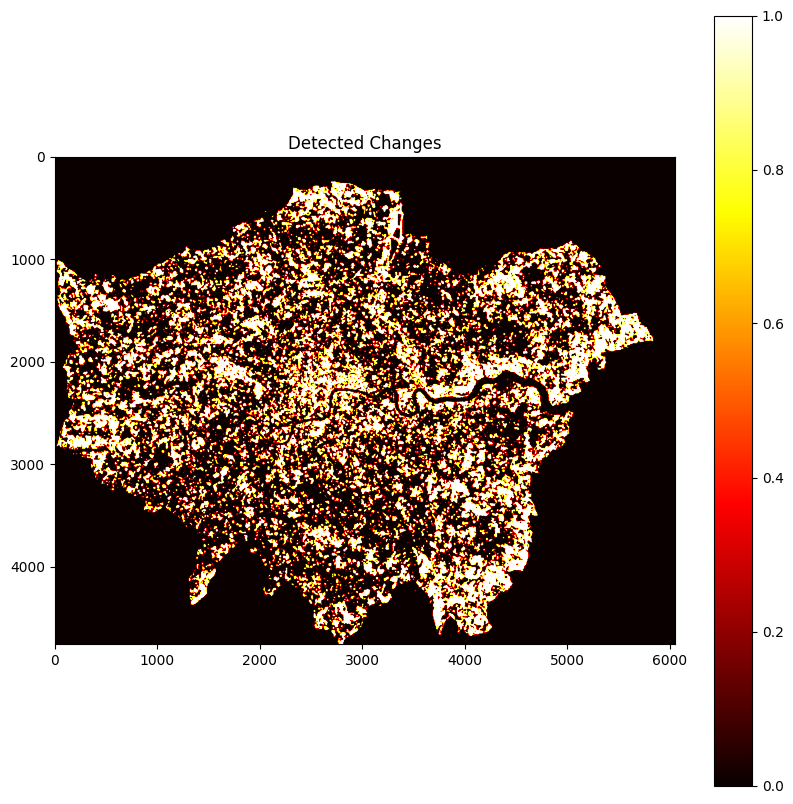

In [ ]:
change_map = change_map_resized.squeeze().cpu().numpy()

# Apply thresholding strategy
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='otsu',
    min_size=2,
    segment=False,
    segment_min_size=128
    )

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()

In [ ]:
import os
import numpy as np
import rasterio

# Define the paths
data_path = "drive/MyDrive/dissertation/"
image2_path = os.path.join(data_path, "clipped_merged_2021.tiff")

# Read the metadata from one of the input images
with rasterio.open(image2_path) as src2:
    transform2 = src2.transform
    crs2 = src2.crs

# Get the change map from the model
# change_map = model(im1_tensor).detach().cpu().numpy()
change_map = cd_map.astype(np.uint8)

# Assuming the change map is in the first channel, reshape it to 2D
# change_map = change_map[0, 0, :, :]  # Adjust this indexing if necessary

# Create the raster metadata
raster_meta = {
    "driver": "GTiff",
    "height": change_map.shape[0],
    "width": change_map.shape[1],
    "count": 1,
    "dtype": change_map.dtype,
    "crs": crs2,
    "transform": transform2,
}

# Define the output path
output_path = os.path.join(data_path, "change_map_tinycd.tiff")

# Write the change map to the raster file
with rasterio.open(
    output_path,
    'w',
    **raster_meta
) as dst:
    dst.write(change_map, 1)

print(f"Change map saved to {output_path}")


Change map saved to drive/MyDrive/dissertation/change_map_tinycd.tiff


## Validation

In [ ]:
%pip install --quiet earthpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 57.2 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


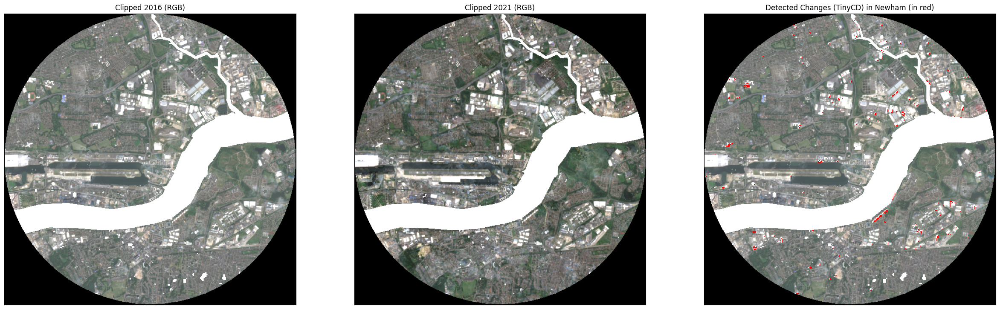

/usr/local/lib/python3.10/dist-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


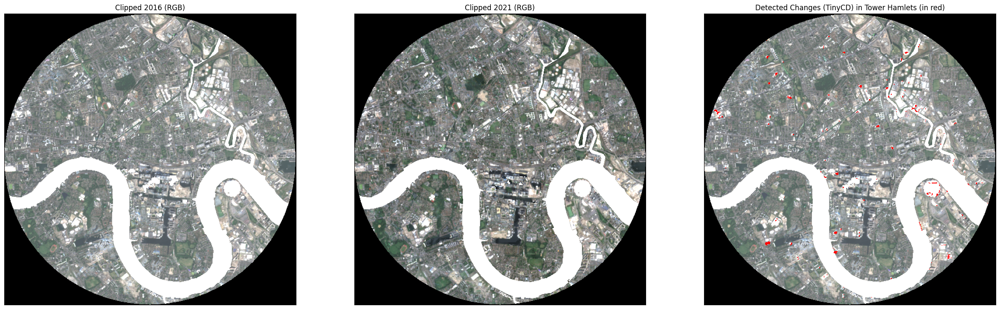

/usr/local/lib/python3.10/dist-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


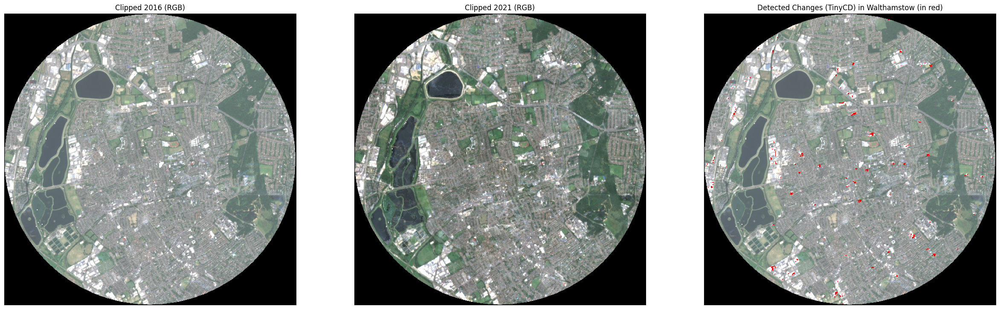

In [ ]:
import os
import numpy as np
import geopandas as gpd
from shapely.geometry import Point
import rasterio
from rasterio.mask import mask
import matplotlib.pyplot as plt
import earthpy.plot as ep


def create_buffer(latitude, longitude, buffer_radius_meters, raster_crs):
    point = Point(longitude, latitude)
    gdf = gpd.GeoDataFrame(geometry=[point], crs="EPSG:4326")
    gdf = gdf.to_crs(raster_crs)
    buffer = gdf.buffer(buffer_radius_meters)
    return buffer.geometry[0]

def clip_raster_by_geometry(raster_path, geometry, output_path):
    with rasterio.open(raster_path) as src:
        out_image, out_transform = mask(src, [geometry], crop=True)
        out_meta = src.meta.copy()
        out_meta.update(
            {
                "driver": "GTiff",
                "height": out_image.shape[1],
                "width": out_image.shape[2],
                "transform": out_transform,
                "nodata": 0
            }
        )
        with rasterio.open(output_path, "w", **out_meta) as dest:
            dest.write(out_image)
            dest.nodata = 0
    return output_path

def visualize_clipped_rasters_with_changes(image1_path, image2_path, changes_path, title, output_image_path, save=False):
    with rasterio.open(image1_path) as src1:
        image1 = src1.read()
    with rasterio.open(image2_path) as src2:
        image2 = src2.read()
    with rasterio.open(changes_path) as src_changes:
        changes = src_changes.read(1)

    height, width = changes.shape
    rgba_image = np.zeros((height, width, 4), dtype=np.float32)
    mask = changes > 0
    rgba_image[mask] = [1, 0, 0, 1]

    fig, axes = plt.subplots(1, 3, figsize=(30, 10))
    ep.plot_rgb(image1, rgb=(3, 2, 1), ax=axes[0], title="Clipped 2016 (RGB)", stretch=True, str_clip=2)
    ep.plot_rgb(image2, rgb=(3, 2, 1), ax=axes[1], title="Clipped 2021 (RGB)", stretch=True, str_clip=2)
    ep.plot_rgb(image1, rgb=(3, 2, 1), ax=axes[2], title=title, stretch=True, str_clip=2)
    axes[2].imshow(rgba_image, interpolation="none")

    if save:
        plt.savefig(output_image_path, bbox_inches="tight", transparent=True, dpi=1000)
    plt.show()

locations = {
    "Newham": (51.5074, 0.0708),
    "Tower Hamlets": (51.509, -0.0208),
    "Walthamstow": (51.5908, -0.0195)
}

buffer_radius_meters = 3000
data_path = "drive/MyDrive/dissertation/"
output_path = "drive/MyDrive/dissertation/"
image1_path = os.path.join(data_path, "clipped_merged_2016.tiff")
image2_path = os.path.join(data_path, "clipped_merged_2021.tiff")
output_change_path = os.path.join(data_path, "change_map_tinycd.tiff")

with rasterio.open(image1_path) as src:
    raster_crs = src.crs

for location_name, (latitude, longitude) in locations.items():
    buffer = create_buffer(latitude, longitude, buffer_radius_meters, raster_crs)

    output_image1_path = os.path.join(output_path, f"clipped_buffer_2016_{location_name}.tiff")
    output_image2_path = os.path.join(output_path, f"clipped_buffer_2021_{location_name}.tiff")
    output_changes_path = os.path.join(output_path, f"clipped_buffer_changes_2016_2021_{location_name}.tiff")
    output_image_path = os.path.join(output_path, f"changes_visualization_{location_name}.png")

    clipped_image1_path = clip_raster_by_geometry(image1_path, buffer, output_image1_path)
    clipped_image2_path = clip_raster_by_geometry(image2_path, buffer, output_image2_path)
    clipped_changes_path = clip_raster_by_geometry(output_change_path, buffer, output_changes_path)

    visualize_clipped_rasters_with_changes(
        clipped_image1_path,
        clipped_image2_path,
        clipped_changes_path,
        f"Detected Changes (TinyCD) in {location_name} (in red)",
        output_image_path,
        save=False
    )


## Single Band (Feature Extraction)

In [ ]:
import torch
import numpy as np
import torch.nn.functional as F
import rasterio
import cv2

# Function to extract patches from the image
def extract_patches(image, patch_size, stride):
    patches = []
    _, height, width = image.shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            patches.append(patch)
    return patches

# Function to reconstruct image from patches
def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

# Function to extract features for a specific band
def extract_features_for_band(band, im1, im2, no_data_mask, model):
    print(f"Extracting features for band {band}")
    # Convert to tensors and select the specific band
    im1_band = torch.tensor(im1[band-1, :, :], dtype=torch.float32).unsqueeze(0).unsqueeze(0).to(device)
    im2_band = torch.tensor(im2[band-1, :, :], dtype=torch.float32).unsqueeze(0).unsqueeze(0).to(device)

    # Patch size and stride
    patch_size = 256
    stride = patch_size // 2

    # Extract patches from input images
    im1_patches = extract_patches(im1_band.squeeze(0), patch_size, stride)
    im2_patches = extract_patches(im2_band.squeeze(0), patch_size, stride)

    # Convert patches to tensor
    im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
    im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)

    # Process each patch through the model
    change_patches = []
    model.eval()
    with torch.no_grad():
        for i in range(im1_patches.size(0)):
            output = model(im1_patches[i], im2_patches[i])
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy().squeeze())

    # Convert list to numpy array
    change_patches = np.array(change_patches)

    # Reconstruct the change map from patches
    change_map = reconstruct_image(change_patches, im1_band.shape, patch_size, stride)

    # Normalize the change map to the range [0, 1]
    change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

    return change_map

# Load images function
def load_image(image_path, bands=None):
    with rasterio.open(image_path) as src:
        if bands is not None:
            image = src.read(bands)
        else:
            image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Resize image to match target size
def resize_image(image, target_shape):
    resized_image = np.zeros((image.shape[0], target_shape[0], target_shape[1]))
    for i in range(image.shape[0]):
        resized_image[i] = cv2.resize(image[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands = list(range(1, 12))  # Adjust as necessary here
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Define the TinyCD model
model = None
model = TinyCD(
    bkbn_name="efficientnet_b0",
    weights='DEFAULT',
    output_layer_bkbn="1",
    freeze_backbone=False
).to(device)

# Set the model to evaluation mode
model.eval()

# Loop through each band and extract features
all_features = []
for band in bands:
    features = extract_features_for_band(band, im1, im2, no_data_mask, model)
    all_features.append(features)


Using device: cuda
Extracting features for band 1
Extracting features for band 2
Extracting features for band 3
Extracting features for band 4
Extracting features for band 5
Extracting features for band 6
Extracting features for band 7
Extracting features for band 8
Extracting features for band 9
Extracting features for band 10
Extracting features for band 11


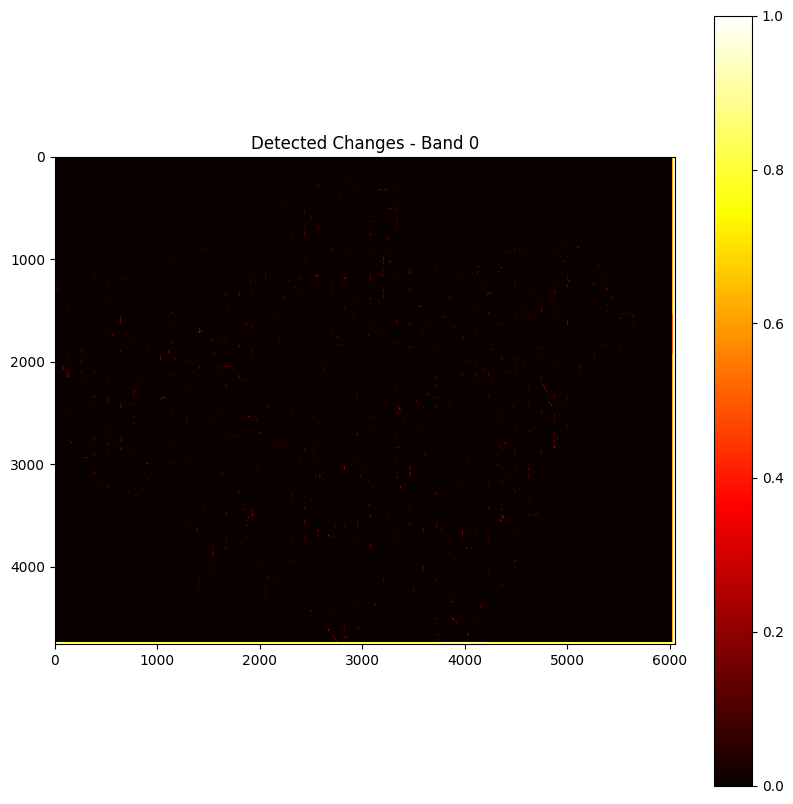

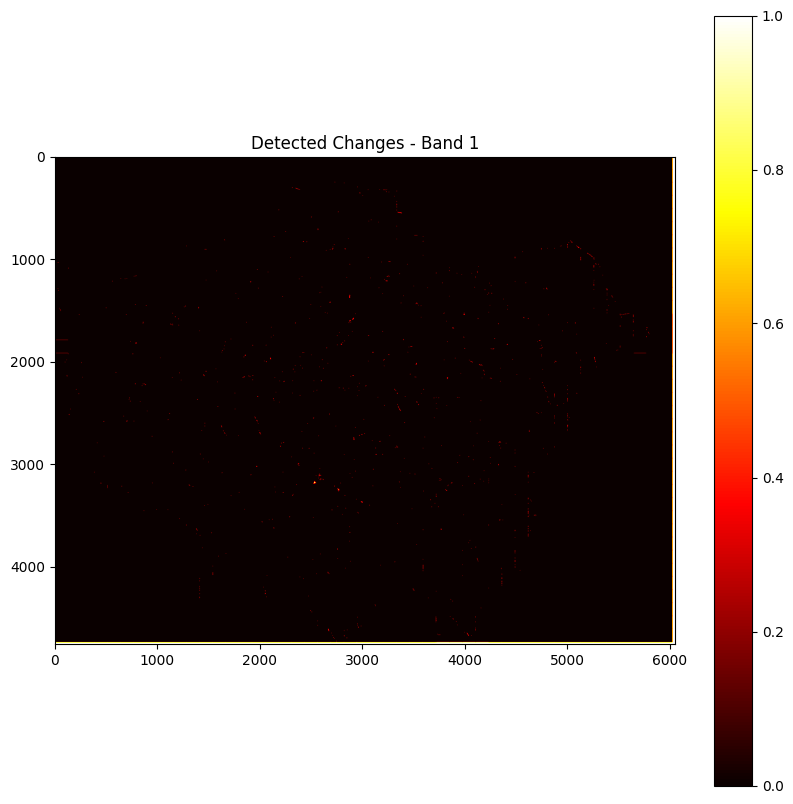

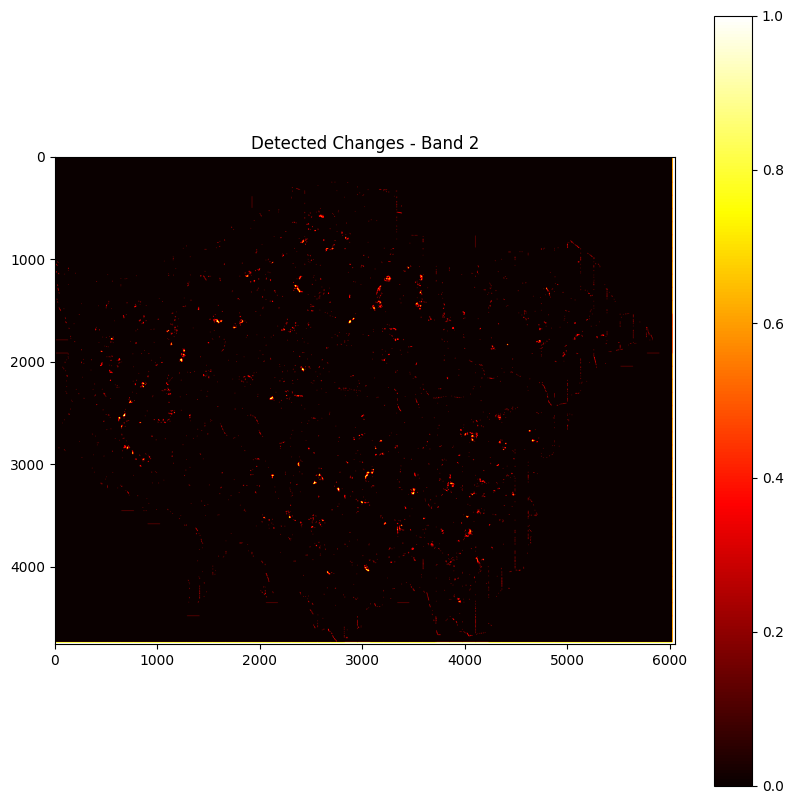

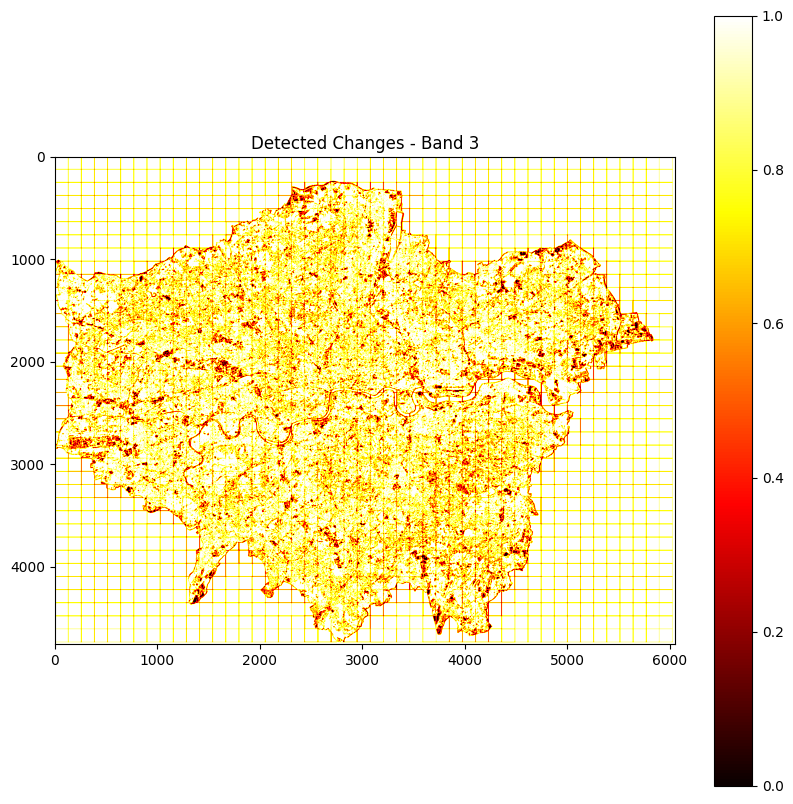

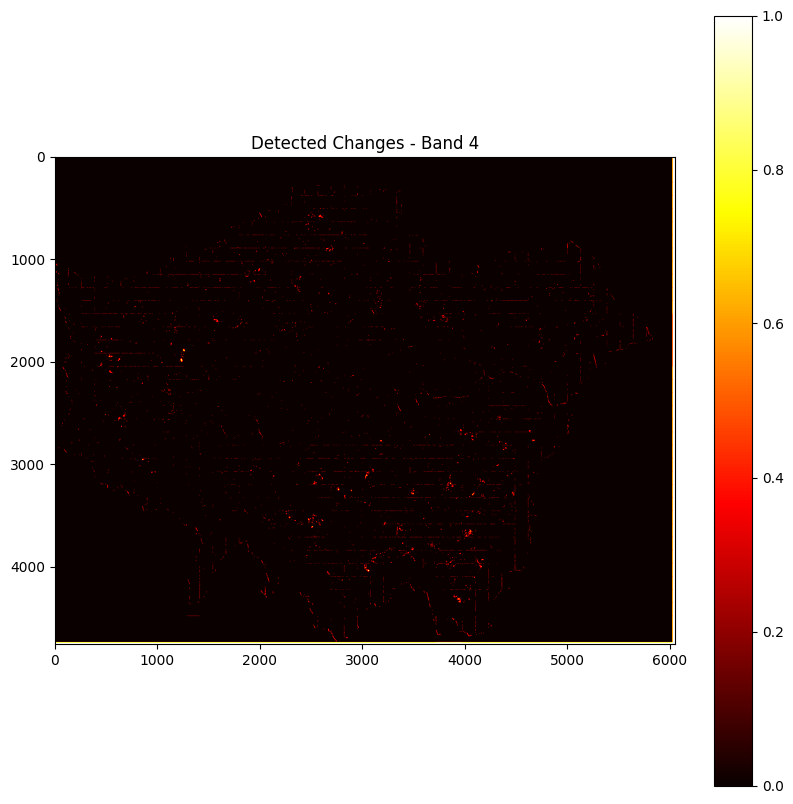

...

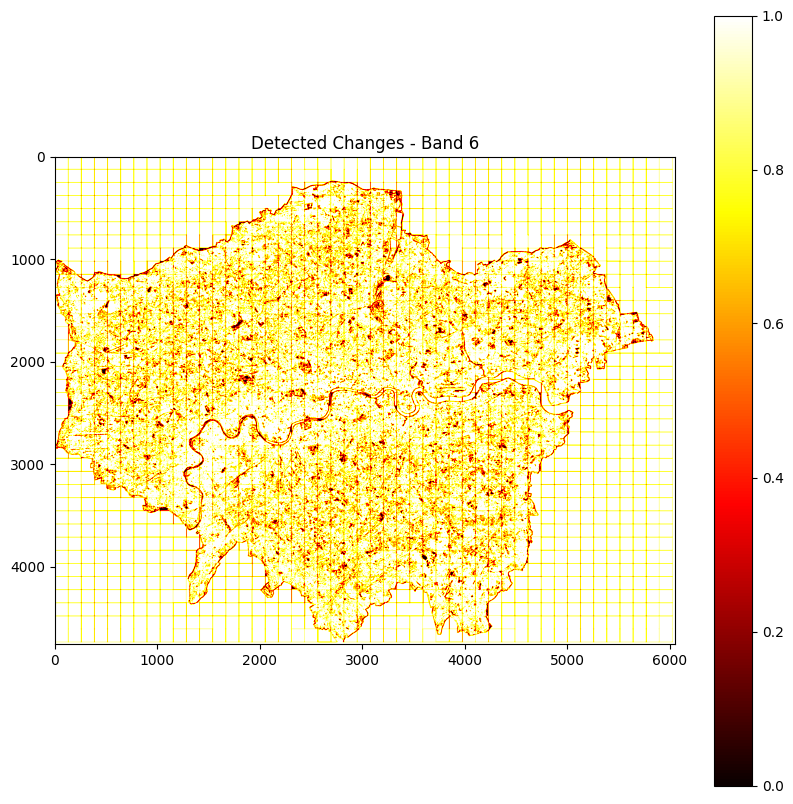

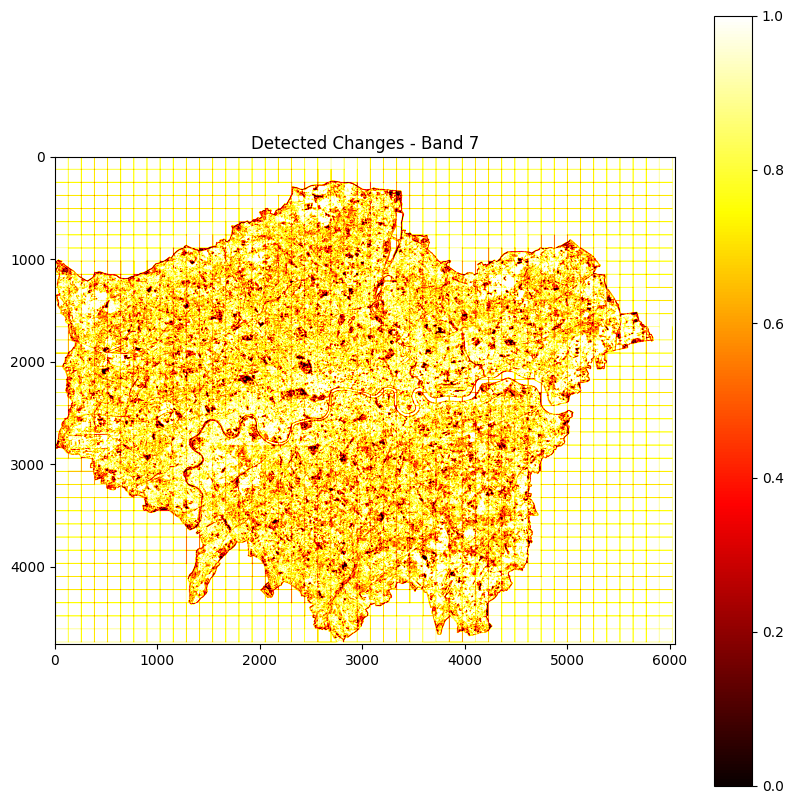

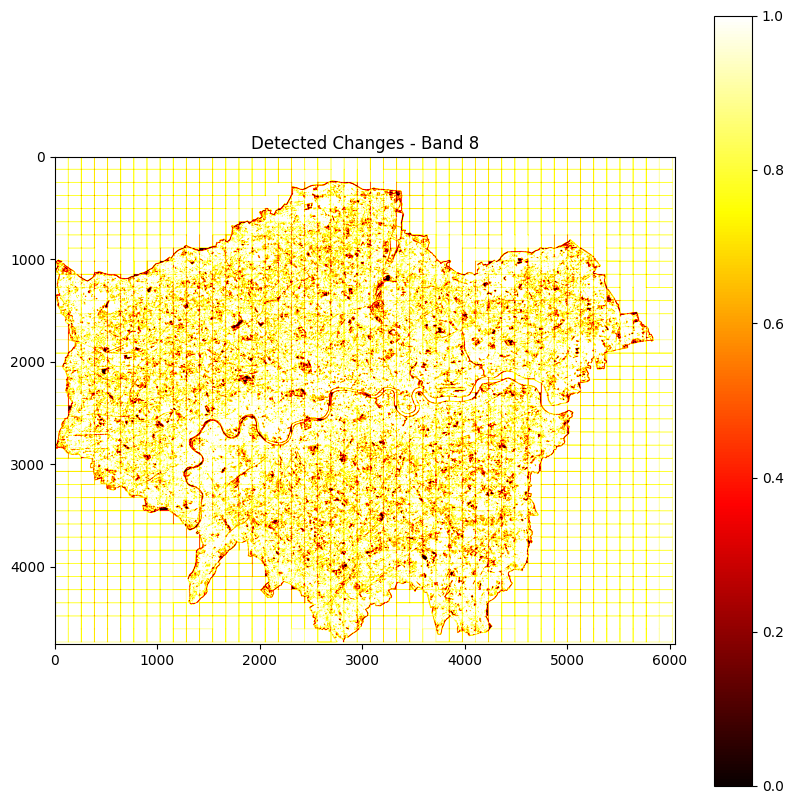

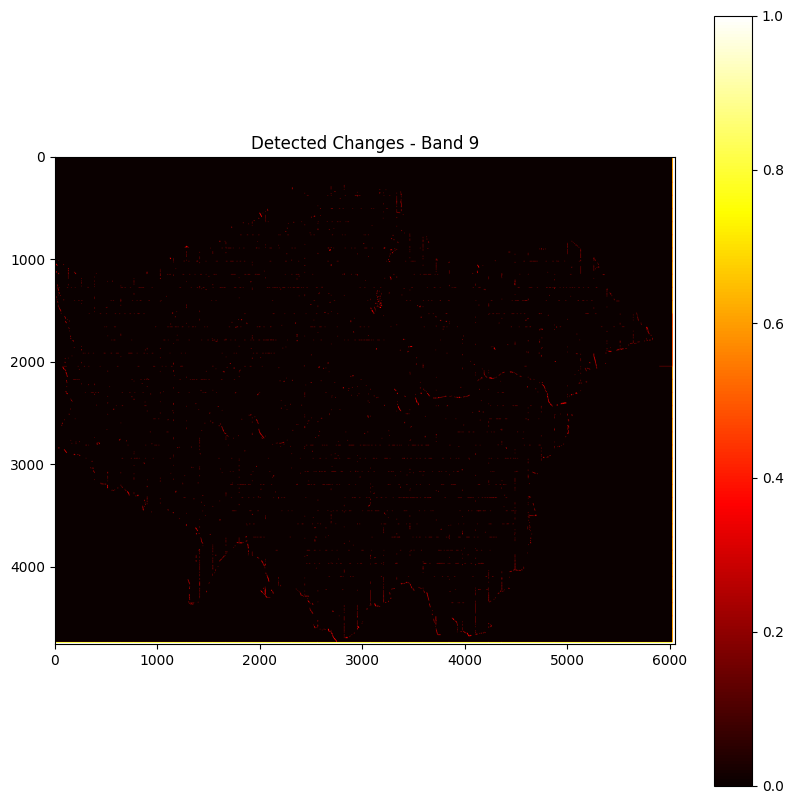

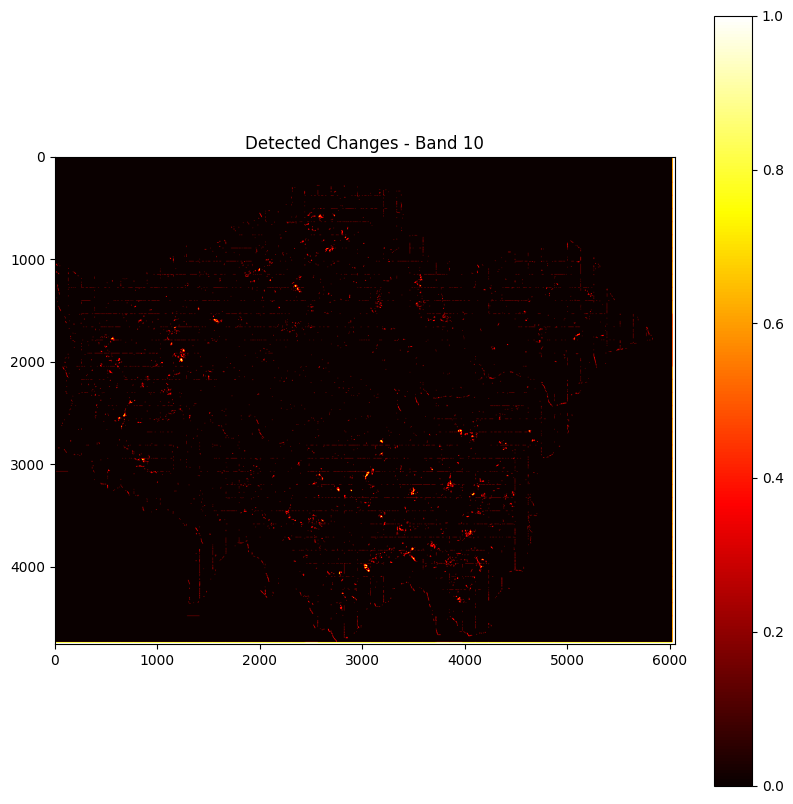

In [ ]:
for band in range(len(all_features)):
  # Apply thresholding strategy
  cd_map = apply_thresholding_strategy(
      all_features[band].squeeze(),
      strategy='multiotsu',
      min_size=8
  )

  # Visualize the change map
  plt.figure(figsize=(10, 10))
  plt.imshow(cd_map, cmap='hot')
  plt.colorbar()
  plt.title(f'Detected Changes - Band {band}')
  plt.show()


In [ ]:
import os


def save_features(change_maps, model_name, image_path, output_dir):
  for band, change_map in enumerate(change_maps, start=1):
    change_map = apply_thresholding_strategy(
        change_map,
        strategy='multiotsu',
        min_size=4
    )

    change_map = change_map.astype(np.uint8).squeeze()

    # Define raster metadata
    with rasterio.open(image_path) as src2:
        transform2 = src2.transform
        crs2 = src2.crs

    raster_meta = {
        "driver": "GTiff",
        "height": change_map.shape[0],
        "width": change_map.shape[1],
        "count": 1,
        "dtype": change_map.dtype,
        "crs": crs2,
        "transform": transform2,
    }

    output_path = os.path.join(output_dir, f"features_band_{band}_{model_name}.tiff")
    with rasterio.open(output_path, 'w', **raster_meta) as dst:
        dst.write(change_map, 1)

    print(f"Change map features for band {band} saved to {output_path}")


# Define paths and bands to process
model_name = "tinycd"
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
output_dir = f"drive/MyDrive/dissertation/features_{model_name}/"
model_dir = "drive/MyDrive/dissertation/models/"
bands = list(range(1, 12))

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

# Loop through each band and train the model
save_features(all_features, model_name, image2_path, output_dir)

Change map features for band 1 saved to drive/MyDrive/dissertation/features_tinycd/features_band_1_tinycd.tiff
Change map features for band 2 saved to drive/MyDrive/dissertation/features_tinycd/features_band_2_tinycd.tiff
Change map features for band 3 saved to drive/MyDrive/dissertation/features_tinycd/features_band_3_tinycd.tiff
Change map features for band 4 saved to drive/MyDrive/dissertation/features_tinycd/features_band_4_tinycd.tiff
Change map features for band 5 saved to drive/MyDrive/dissertation/features_tinycd/features_band_5_tinycd.tiff
Change map features for band 6 saved to drive/MyDrive/dissertation/features_tinycd/features_band_6_tinycd.tiff
Change map features for band 7 saved to drive/MyDrive/dissertation/features_tinycd/features_band_7_tinycd.tiff
Change map features for band 8 saved to drive/MyDrive/dissertation/features_tinycd/features_band_8_tinycd.tiff
Change map features for band 9 saved to drive/MyDrive/dissertation/features_tinycd/features_band_9_tinycd.tiff
C

In [ ]:
import cv2
import rasterio
import matplotlib.pyplot as plt

# Define the ClearCache utility
class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

# Define the TinyCD model
class TinyCD(nn.Module):
    def __init__(self, in_channels):
        super(TinyCD, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 8, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(8, 16, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )
        self.mixing_attention = nn.Sequential(
            nn.Conv2d(64, 16, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(16, 1, kernel_size=3, padding=1),
            nn.Sigmoid()  # Sigmoid activation for binary classification
        )

In [ ]:
# Training and feature extraction function
def train_and_save_features(
    band, image1_path, image2_path, output_dir, model_path,
    train_model=False, n_epochs=1, ngf=1, n_blocks=3
):
    # Load images for the current band
    im1, im2 = load_dataset(image1_path, image2_path, band)

    no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

    # Convert to tensors
    im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
    im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

    # Instantiate model
    model = TinyCD(in_channels=1).to(device)

    # Define loss and optimizer
    criterion = nn.BCELoss()
    lr = 0.01
    optimizer, scheduler = model.configure_optimizers(n_epochs, lr)

    # Load pre-trained model if it exists
    if not train_model and os.path.exists(model_path):
        model.load_state_dict(torch.load(model_path))
        train_model = False
    else:
        train_model = True

    # Resize target to match output size
    def resize_to_match(target, reference):
        return F.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)

    # Training loop
    if train_model:
        for epoch in range(n_epochs):
            optimizer.zero_grad()
            output = model(im1_tensor, im2_tensor)
            resized_output = resize_to_match(output, im2_tensor)
            loss = criterion(resized_output, im2_tensor)
            loss.backward()
            optimizer.step()
            scheduler.step()
            print(f'Band {band}, Epoch {epoch+1}, Loss: {loss.item()}')

        # Save model
        torch.save(model.state_dict(), model_path)
        print(f'Model saved to {model_path}')

    # Extract features for both images
    with torch.no_grad():
        features1 = model.encoder(im1_tensor).detach().cpu().numpy()[0]
        features2 = model.encoder(im2_tensor).detach().cpu().numpy()[0]

    # Resize features to match the no-data mask
    def resize_features(features, target_shape):
        resized_features = np.zeros((features.shape[0], target_shape[0], target_shape[1]))
        for i in range(features.shape[0]):
            resized_features[i] = cv2.resize(features[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
        return resized_features

    features1 = resize_features(features1, no_data_mask.shape)
    features2 = resize_features(features2, no_data_mask.shape)

    # Apply no-data mask to features
    features1[:, no_data_mask] = 0
    features2[:, no_data_mask] = 0

    # Normalize features
    normalized_features1 = (features1 - np.mean(features1)) / np.std(features1)
    normalized_features2 = (features2 - np.mean(features2)) / np.std(features2)

    # Aggregate features across channels
    aggregated_features1 = np.mean(normalized_features1, axis=0, keepdims=True)
    aggregated_features2 = np.mean(normalized_features2, axis=0, keepdims=True)

    # Compute absolute difference
    absolute_difference = np.abs(aggregated_features1 - aggregated_features2)

    # Calculate the change map using the norm of the differences
    detected_change_map = np.linalg.norm(absolute_difference, axis=0)

    # Normalize the change map
    numerator = (detected_change_map - np.amin(detected_change_map))
    denominator = (np.amax(detected_change_map) - np.amin(detected_change_map))
    detected_change_map_normalized = numerator / denominator

    change_map = apply_thresholding_strategy(
        detected_change_map_normalized,
        strategy='multiotsu',
        min_size=8,
        segment=False,
        segment_min_size=10
    )

    change_map = change_map.astype(np.uint8)

    # Define raster metadata
    with rasterio.open(image2_path) as src2:
        transform2 = src2.transform
        crs2 = src2.crs

    raster_meta = {
        "driver": "GTiff",
        "height": change_map.shape[0],
        "width": change_map.shape[1],
        "count": 1,
        "dtype": change_map.dtype,
        "crs": crs2,
        "transform": transform2,
    }

    output_path = os.path.join(output_dir, f"features_band_{band[0]}_tinycd.tiff")
    with rasterio.open(output_path, 'w', **raster_meta) as dst:
        dst.write(change_map, 1)

    print(f"Change map features for band {band[0]} saved to {output_path}")


# Define paths and bands to process
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
output_dir = "drive/MyDrive/dissertation/features/"
model_dir = "drive/MyDrive/dissertation/models/"
bands = list(range(1, 12))

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

# Loop through each band and train the model
for band in bands:
    model_path = os.path.join(model_dir, f"model_band_{band}_tinycd.pth")
    train_and_save_features(
        [band], image1_path, image2_path,
        output_dir, model_path, train_model=True,
        n_epochs=50, n_blocks=4
    )

In [ ]:
features1.shape

torch.Size([1, 32, 594, 756])

In [ ]:
change_map_resized.shape

torch.Size([1, 1, 4754, 6050])

In [ ]:
change_map.shape

torch.Size([1, 1, 594, 756])

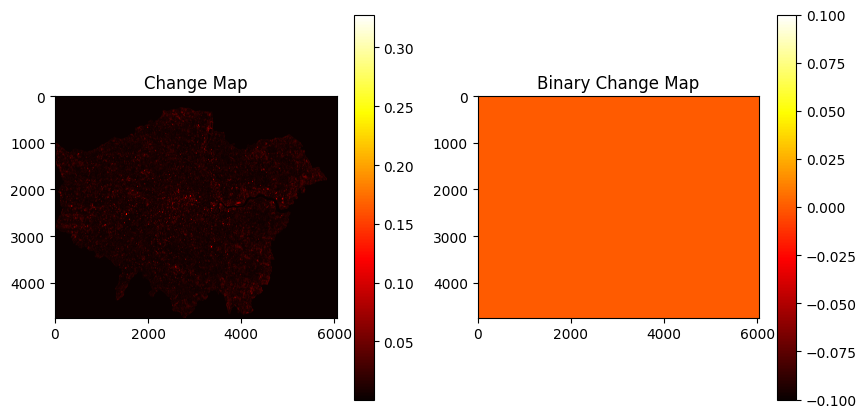

In [ ]:
import matplotlib.pyplot as plt

# Load the model
model.load_state_dict(torch.load("tinycd_model.pth"))

# Set the model to evaluation mode
model.eval()

# Extract features
with torch.no_grad():
    with ClearCache():
        features1 = model.encoder(im1_tensor)
        features2 = model.encoder(im2_tensor)

# Create change map
change_map = torch.abs(features1 - features2).mean(dim=1, keepdim=True)
change_map_resized = resize_to_match(change_map, im1_tensor)

# Thresholding to create a binary change map
threshold = 0.5
binary_change_map = change_map_resized > threshold

# Plot the change map and binary change map
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title('Change Map')
plt.imshow(change_map_resized.squeeze().cpu().numpy(), cmap='hot')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.title('Binary Change Map')
plt.imshow(binary_change_map.squeeze().cpu().numpy(), cmap='hot')
plt.colorbar()

plt.show()


In [ ]:
import gc

del model
gc.collect()
torch.cuda.empty_cache()

# UNet

[A Change Detection Reality Check](https://arxiv.org/pdf/2402.06994)

In [ ]:
%pip install --quiet segmentation-models-pytorch

In [ ]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import rasterio
from skimage import filters, morphology
from skimage.measure import label, regionprops


# Load images function
def load_image(image_path, bands=None): # e.g. bands=[4, 3, 2, 8]
    with rasterio.open(image_path) as src:
        if bands is not None:
          image = src.read(bands)
        else:
          image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Resize image to match target size
def resize_image(image, target_shape):
    resized_image = np.zeros((image.shape[0], target_shape[0], target_shape[1]))
    for i in range(image.shape[0]):
        resized_image[i] = cv2.resize(image[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands = [4, 3, 2]
# bands = list(range(1,12))
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Convert to tensors
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

print(
  f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}'
)

Using device: cuda
Images shape: torch.Size([1, 3, 4754, 6050]), torch.Size([1, 3, 4754, 6050])


In [ ]:
# Function to resize images to smaller dimensions
def resize_image(image, scale_factor):
    _, _, height, width = image.size()
    new_height, new_width = int(height * scale_factor), int(width * scale_factor)
    return F.interpolate(image, size=(new_height, new_width), mode='bilinear', align_corners=False)

# Resize the images to 25% of their original dimensions
scale_factor = 0.75
im1_tensor = resize_image(im1_tensor, scale_factor)
im2_tensor = resize_image(im2_tensor, scale_factor)

# Verify the new shapes
print(f"Resized im1_tensor shape: {im1_tensor.shape}")
print(f"Resized im2_tensor shape: {im2_tensor.shape}")

Resized im1_tensor shape: torch.Size([1, 3, 3565, 4537])
Resized im2_tensor shape: torch.Size([1, 3, 3565, 4537])


In [ ]:
import torch
import torch.nn.functional as F

def pad_to_multiple(tensor, multiple):
    height, width = tensor.shape[2], tensor.shape[3]
    pad_height = (multiple - height % multiple) % multiple
    pad_width = (multiple - width % multiple) % multiple
    padding = (0, pad_width, 0, pad_height)
    return F.pad(tensor, padding, mode='reflect')

# Pad the images to be divisible by 32
im1_tensor = pad_to_multiple(im1_tensor, 32)
im2_tensor = pad_to_multiple(im2_tensor, 32)

# Verify the new shapes
print(f"Padded im1_tensor shape: {im1_tensor.shape}")
print(f"Padded im2_tensor shape: {im2_tensor.shape}")


Padded im1_tensor shape: torch.Size([1, 3, 3584, 4544])
Padded im2_tensor shape: torch.Size([1, 3, 3584, 4544])


In [ ]:
import torch
import torch.optim as optim
import segmentation_models_pytorch as smp
# from torch.nn import CrossEntropyLoss
from torch.optim.lr_scheduler import LambdaLR
import matplotlib.pyplot as plt



class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()


class UNetChangeDetection(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UNetChangeDetection, self).__init__()
        self.model = smp.Unet(
            encoder_name='efficientnet-b0',
            encoder_weights=None,
            in_channels=in_channels,
            classes=out_channels,
            activation=None
        )

    def forward(self, x):
        return self.model(x)

    def extract_features(self, x):
        encoder_features = self.model.encoder(x)
        return encoder_features

    def configure_optimizers(self, max_epochs, lr):
        def lambda_rule(epoch):
            lr_l = 1.0 - epoch / float(max_epochs + 1)
            return lr_l

        optimizer = optim.SGD(
            self.parameters(), lr=lr, momentum=0.9, weight_decay=5e-4
        )
        scheduler = LambdaLR(optimizer, lr_lambda=lambda_rule)
        return optimizer, scheduler

# Model initialization
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_channels = im1_tensor.shape[1] * 2  # Two images concatenated along the channel dimension
model = UNetChangeDetection(num_channels, 2).to(device)

# Loss function
criterion = nn.CrossEntropyLoss()

# Optimizer and Scheduler
lr = 0.01
num_epochs = 10
optimizer, scheduler = model.configure_optimizers(num_epochs, lr)

# Create ground truth change map and input tensor
ground_truth = (im1_tensor != im2_tensor).float().mean(dim=1, keepdim=True).to(device)
ground_truth = ground_truth.long().squeeze(1).to(device)  # Ensure the shape matches the expected shape for CrossEntropyLoss

# Concatenate input tensors along the channel dimension
input_tensor = torch.cat([im1_tensor, im2_tensor], dim=1)

# Training the model without DataLoader
scaler = torch.cuda.amp.GradScaler()  # Initialize the gradient scaler for mixed precision

# Training the model
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    with ClearCache():
      with torch.cuda.amp.autocast():  # Enable mixed precision
          outputs = model(input_tensor.to(device))
          loss = criterion(outputs, ground_truth.to(device))
      scaler.scale(loss).backward()
      scaler.step(optimizer)
      scaler.update()
      scheduler.step()  # Update learning rate
      print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

# Save the model
model_save_path = "drive/MyDrive/dissertation/unet_change_detection_model.pth"
torch.save(model.state_dict(), model_save_path)
print(f"Model saved to {model_save_path}")


Epoch [1/10], Loss: 0.3380
Epoch [2/10], Loss: 0.3086
Epoch [3/10], Loss: 0.2724
Epoch [4/10], Loss: 0.2358
Epoch [5/10], Loss: 0.1999
Epoch [6/10], Loss: 0.1688
Epoch [7/10], Loss: 0.1432
Epoch [8/10], Loss: 0.1236
Epoch [9/10], Loss: 0.1098
Epoch [10/10], Loss: 0.1003
Model saved to drive/MyDrive/dissertation/unet_change_detection_model.pth


In [ ]:
# Save the model
model_save_path = "drive/MyDrive/dissertation/models/unet_change_detection_model.pth"
torch.save(model.state_dict(), model_save_path)
print(f"Model saved to {model_save_path}")

Model saved to drive/MyDrive/dissertation/unet_change_detection_model.pth


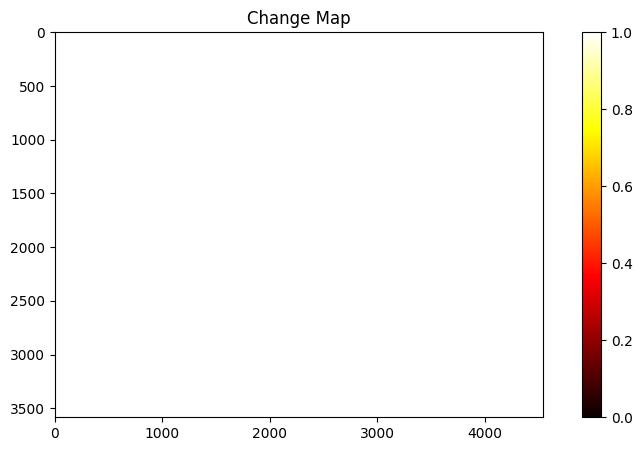

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch import Tensor
from torch.nn import Module
from typing import List, Optional
import matplotlib.pyplot as plt


def resize_to_match(target: Tensor, reference: Tensor) -> Tensor:
    return F.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)

# Load the model
model_save_path = "drive/MyDrive/dissertation/models/unet_change_detection_model.pth"
model.load_state_dict(torch.load(model_save_path))
model.eval()

# Concatenate input tensors along the channel dimension for inference
input_tensor = torch.cat([im1_tensor, im2_tensor], dim=1)

# Extract features and generate change map
with torch.no_grad():
    with torch.cuda.amp.autocast():
        output = model(input_tensor.to(device))
        change_map_resized = resize_to_match(output, im1_tensor)
        change_map_resized = torch.argmax(change_map_resized, dim=1, keepdim=True)  # Get the predicted class

# Plot the change map
plt.figure(figsize=(10, 5))
plt.title('Change Map')
plt.imshow(change_map_resized.squeeze().cpu().numpy(), cmap='hot')
plt.colorbar()
plt.show()


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch import Tensor
from torch.nn import Module
from typing import List, Optional

import torch.optim as optim
import segmentation_models_pytorch as smp
from torch.nn import CrossEntropyLoss
from torch.optim.lr_scheduler import LambdaLR
import matplotlib.pyplot as plt


class UNetChangeDetection(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UNetChangeDetection, self).__init__()
        self.model = smp.Unet(
            encoder_name='efficientnet-b0',
            encoder_weights=None,
            in_channels=in_channels,
            classes=out_channels,
            activation=None
        )

    def forward(self, x):
        return self.model(x)

    def extract_features(self, x):
        encoder_features = self.model.encoder(x)
        return encoder_features

    def configure_optimizers(self, max_epochs, lr):
        def lambda_rule(epoch):
            lr_l = 1.0 - epoch / float(max_epochs + 1)
            return lr_l

        optimizer = optim.SGD(
            self.parameters(), lr=lr, momentum=0.9, weight_decay=5e-4
        )
        scheduler = LambdaLR(optimizer, lr_lambda=lambda_rule)
        return optimizer, scheduler

# Model initialization
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# num_channels = im1_tensor.shape[1] * 2  # Two images concatenated along the channel dimension
model = UNetChangeDetection(6, 2).to(device)

In [ ]:

# Inference and Change Map Generation

# Set the model to evaluation mode
model_save_path = "drive/MyDrive/dissertation/unet_change_detection_model.pth"
model.load_state_dict(torch.load(model_save_path))
model.eval()

# Concatenate input tensors along the channel dimension for inference
input_tensor = torch.cat([im1_tensor, im2_tensor], dim=1)

# Extract features
with torch.no_grad():
    with torch.cuda.amp.autocast():
        features = model.extract_features(input_tensor.to(device))

# Manually separate the features into two sets corresponding to the two input images
features1 = [f[:, :f.shape[1] // 2, :, :] for f in features]
features2 = [f[:, f.shape[1] // 2:, :, :] for f in features]

# Calculate the absolute difference between features
change_map = [torch.abs(f1 - f2) for f1, f2 in zip(features1, features2)]
# change_map = torch.cat(change_map, dim=1)  # Concatenate along the channel dimension
# change_map = torch.mean(change_map, dim=1, keepdim=True)  # Aggregate features

# # Resize change map to match input image size
# change_map_resized = resize_to_match(change_map, im1_tensor)

# # Plot the change map
# plt.figure(figsize=(10, 5))
# plt.title('Change Map')
# plt.imshow(change_map_resized.squeeze().cpu().numpy(), cmap='hot')
# plt.colorbar()
# plt.show()

RuntimeError: Sizes of tensors must match except in dimension 1. Expected size 3584 but got size 1792 for tensor number 1 in the list.

TypeError: Invalid shape (3, 3584, 4544) for image data

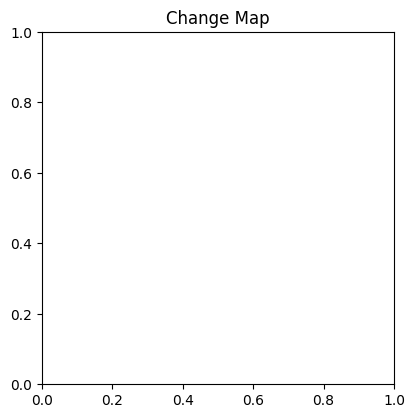

In [ ]:
# Convert change_map to CPU and numpy arrays
change_map_np = [cm.cpu().numpy() for cm in change_map]

# Aggregate the change maps
aggregated_change_map = np.mean(change_map_np[0], axis=0)

# Apply thresholding to create a binary change map
threshold = 0.5
binary_change_map = (aggregated_change_map > threshold).astype(np.uint8)

# Plot the change map and binary change map
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title('Change Map')
plt.imshow(aggregated_change_map.squeeze(), cmap='hot')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.title('Binary Change Map')
plt.imshow(binary_change_map.squeeze(), cmap='hot')
plt.colorbar()

plt.show()

# Siam-Nested UNet




In [ ]:
%pip install --quiet rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 83.1 MB/s eta 0:00:00


In [ ]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import rasterio
from skimage import filters, morphology
from skimage.measure import label, regionprops


# Load images function
def load_image(image_path, bands=None): # e.g. bands=[4, 3, 2, 8]
    with rasterio.open(image_path) as src:
        if bands is not None:
          image = src.read(bands)
        else:
          image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Resize image to match target size
def resize_image(image, target_shape):
    resized_image = np.zeros((image.shape[0], target_shape[0], target_shape[1]))
    for i in range(image.shape[0]):
        resized_image[i] = cv2.resize(image[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands = [4, 3, 2, 8]
# bands = list(range(1,12))
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Convert to tensors
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

print(
  f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}'
)

Using device: cuda
Images shape: torch.Size([1, 4, 4754, 6050]), torch.Size([1, 4, 4754, 6050])


In [ ]:
import torch
import torch.nn.functional as F

def crop_and_pad_image(image, crop_size, pad_multiple):
    _, _, height, width = image.size()
    patches = []
    for i in range(0, height, crop_size):
        for j in range(0, width, crop_size):
            patch = image[:, :, i:i+crop_size, j:j+crop_size]
            if patch.size(2) != crop_size or patch.size(3) != crop_size:
                pad_h = crop_size - patch.size(2)
                pad_w = crop_size - patch.size(3)
                patch = F.pad(patch, (0, pad_w, 0, pad_h), mode='reflect')
            patches.append(patch)
    return patches

# Function to pad the patches to be divisible by a specific multiple
def pad_to_multiple(tensor, multiple):
    height, width = tensor.shape[2], tensor.shape[3]
    pad_height = (multiple - height % multiple) % multiple
    pad_width = (multiple - width % multiple) % multiple
    padding = (0, pad_width, 0, pad_height)
    return F.pad(tensor, padding, mode='reflect')

crop_size = 256
pad_multiple = 32  # Ensure patches are padded to be multiples of 32
im1_patches = [pad_to_multiple(patch, pad_multiple) for patch in crop_and_pad_image(im1_tensor, crop_size, pad_multiple)]
im2_patches = [pad_to_multiple(patch, pad_multiple) for patch in crop_and_pad_image(im2_tensor, crop_size, pad_multiple)]

print(f"Number of patches: {len(im1_patches)}")


Number of patches: 456


In [ ]:

im1_patches[0].shape

torch.Size([1, 4, 288, 288])

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt

class conv_block_nested(nn.Module):
    def __init__(self, in_ch, mid_ch, out_ch):
        super(conv_block_nested, self).__init__()
        self.activation = nn.ReLU(inplace=True)
        self.conv1 = nn.Conv2d(in_ch, mid_ch, kernel_size=3, padding=1, bias=True)
        self.bn1 = nn.BatchNorm2d(mid_ch)
        self.conv2 = nn.Conv2d(mid_ch, out_ch, kernel_size=3, padding=1, bias=True)
        self.bn2 = nn.BatchNorm2d(out_ch)

    def forward(self, x):
        x = self.conv1(x)
        identity = x
        x = self.bn1(x)
        x = self.activation(x)

        x = self.conv2(x)
        x = self.bn2(x)
        output = self.activation(x + identity)
        return output

class up(nn.Module):
    def __init__(self, in_ch, bilinear=False):
        super(up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch, in_ch, 2, stride=2)

    def forward(self, x):
        x = self.up(x)
        return x

class Siam_NestedUNet_Conc(nn.Module):
    def __init__(self, in_ch=4, out_ch=2):
        super(Siam_NestedUNet_Conc, self).__init__()
        torch.nn.Module.dump_patches = True
        n1 = 32  # Reduced number of initial channels
        filters = [n1, n1 * 2, n1 * 4, n1 * 8]

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv0_0 = conv_block_nested(in_ch, filters[0], filters[0])
        self.conv1_0 = conv_block_nested(filters[0], filters[1], filters[1])
        self.Up1_0 = up(filters[1])
        self.conv2_0 = conv_block_nested(filters[1], filters[2], filters[2])
        self.Up2_0 = up(filters[2])
        self.conv3_0 = conv_block_nested(filters[2], filters[3], filters[3])
        self.Up3_0 = up(filters[3])

        self.conv0_1 = conv_block_nested(filters[0] * 2 + filters[1], filters[0], filters[0])
        self.conv1_1 = conv_block_nested(filters[1] * 2 + filters[2], filters[1], filters[1])
        self.Up1_1 = up(filters[1])
        self.conv2_1 = conv_block_nested(filters[2] * 2 + filters[3], filters[2], filters[2])
        self.Up2_1 = up(filters[2])

        self.conv0_2 = conv_block_nested(filters[0] * 3 + filters[1], filters[0], filters[0])
        self.conv1_2 = conv_block_nested(filters[1] * 3 + filters[2], filters[1], filters[1])
        self.Up1_2 = up(filters[1])

        self.conv0_3 = conv_block_nested(filters[0] * 4 + filters[1], filters[0], filters[0])

        self.final1 = nn.Conv2d(filters[0], out_ch, kernel_size=1)
        self.final2 = nn.Conv2d(filters[0], out_ch, kernel_size=1)
        self.final3 = nn.Conv2d(filters[0], out_ch, kernel_size=1)
        self.conv_final = nn.Conv2d(out_ch * 3, out_ch, kernel_size=1)

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, xA, xB):
        '''xA'''
        x0_0A = self.conv0_0(xA)
        x1_0A = self.conv1_0(self.pool(x0_0A))
        x2_0A = self.conv2_0(self.pool(x1_0A))
        # x3_0A = self.conv3_0(self.pool(x2_0A))
        '''xB'''
        x0_0B = self.conv0_0(xB)
        x1_0B = self.conv1_0(self.pool(x0_0B))
        x2_0B = self.conv2_0(self.pool(x1_0B))
        # x3_0B = self.conv3_0(self.pool(x2_0B))

        x0_1 = self.conv0_1(torch.cat([x0_0A, x0_0B, self.pad_to_size(self.Up1_0(x1_0B), x0_0A)], 1))
        x1_1 = self.conv1_1(torch.cat([x1_0A, x1_0B, self.pad_to_size(self.Up2_0(x2_0B), x1_0A)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0A, x0_0B, x0_1, self.pad_to_size(self.Up1_1(x1_1), x0_0A)], 1))

        x2_1 = self.conv2_1(torch.cat([x2_0A, x2_0B, self.pad_to_size(self.Up3_0(x2_0B), x2_0A)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0A, x1_0B, x1_1, self.pad_to_size(self.Up2_1(x2_1), x1_0A)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0A, x0_0B, x0_1, x0_2, self.pad_to_size(self.Up1_2(x1_2), x0_0A)], 1))

        output1 = self.final1(x0_1)
        output2 = self.final2(x0_2)
        output3 = self.final3(x0_3)
        output = self.conv_final(torch.cat([output1, output2, output3], 1))

        return (output1, output2, output3, output)

    def pad_to_size(self, tensor, ref_tensor):
        """Pad the tensor to match the size of ref_tensor."""
        diff_y = ref_tensor.size()[2] - tensor.size()[2]
        diff_x = ref_tensor.size()[3] - tensor.size()[3]
        tensor = F.pad(tensor, (0, diff_x, 0, diff_y))
        return tensor

# Function to resize tensor to match reference tensor's dimensions
def resize_to_match(target: torch.Tensor, reference: torch.Tensor) -> torch.Tensor:
    return F.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)



In [ ]:
import torch
import torch.nn as nn

class conv_block_nested(nn.Module):
    def __init__(self, in_ch, mid_ch, out_ch):
        super(conv_block_nested, self).__init__()
        self.activation = nn.ReLU(inplace=True)
        self.conv1 = nn.Conv2d(in_ch, mid_ch, kernel_size=3, padding=1, bias=True)
        self.bn1 = nn.BatchNorm2d(mid_ch)
        self.conv2 = nn.Conv2d(mid_ch, out_ch, kernel_size=3, padding=1, bias=True)
        self.bn2 = nn.BatchNorm2d(out_ch)

    def forward(self, x):
        x = self.conv1(x)
        identity = x
        x = self.bn1(x)
        x = self.activation(x)

        x = self.conv2(x)
        x = self.bn2(x)
        output = self.activation(x + identity)
        return output


class up(nn.Module):
    def __init__(self, in_ch, bilinear=False):
        super(up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2,
                                  mode='bilinear',
                                  align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch, in_ch, 2, stride=2)

    def forward(self, x):

        x = self.up(x)
        return x


class Siam_NestedUNet_Conc(nn.Module):
    # SNUNet-CD without Attention
    def __init__(self, in_ch=3, out_ch=2):
        super(Siam_NestedUNet_Conc, self).__init__()
        torch.nn.Module.dump_patches = True
        n1 = 32     # the initial number of channels of feature map
        filters = [n1, n1 * 2, n1 * 4, n1 * 8, n1 * 16]

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv0_0 = conv_block_nested(in_ch, filters[0], filters[0])
        self.conv1_0 = conv_block_nested(filters[0], filters[1], filters[1])
        self.Up1_0 = up(filters[1])
        self.conv2_0 = conv_block_nested(filters[1], filters[2], filters[2])
        self.Up2_0 = up(filters[2])
        self.conv3_0 = conv_block_nested(filters[2], filters[3], filters[3])
        self.Up3_0 = up(filters[3])
        self.conv4_0 = conv_block_nested(filters[3], filters[4], filters[4])
        self.Up4_0 = up(filters[4])

        self.conv0_1 = conv_block_nested(filters[0] * 2 + filters[1], filters[0], filters[0])
        self.conv1_1 = conv_block_nested(filters[1] * 2 + filters[2], filters[1], filters[1])
        self.Up1_1 = up(filters[1])
        self.conv2_1 = conv_block_nested(filters[2] * 2 + filters[3], filters[2], filters[2])
        self.Up2_1 = up(filters[2])
        self.conv3_1 = conv_block_nested(filters[3] * 2 + filters[4], filters[3], filters[3])
        self.Up3_1 = up(filters[3])

        self.conv0_2 = conv_block_nested(filters[0] * 3 + filters[1], filters[0], filters[0])
        self.conv1_2 = conv_block_nested(filters[1] * 3 + filters[2], filters[1], filters[1])
        self.Up1_2 = up(filters[1])
        self.conv2_2 = conv_block_nested(filters[2] * 3 + filters[3], filters[2], filters[2])
        self.Up2_2 = up(filters[2])

        self.conv0_3 = conv_block_nested(filters[0] * 4 + filters[1], filters[0], filters[0])
        self.conv1_3 = conv_block_nested(filters[1] * 4 + filters[2], filters[1], filters[1])
        self.Up1_3 = up(filters[1])

        self.conv0_4 = conv_block_nested(filters[0] * 5 + filters[1], filters[0], filters[0])

        self.final1 = nn.Conv2d(filters[0], out_ch, kernel_size=1)
        self.final2 = nn.Conv2d(filters[0], out_ch, kernel_size=1)
        self.final3 = nn.Conv2d(filters[0], out_ch, kernel_size=1)
        self.final4 = nn.Conv2d(filters[0], out_ch, kernel_size=1)
        self.conv_final = nn.Conv2d(out_ch * 4, out_ch, kernel_size=1)

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)


    def forward(self, xA, xB):
        '''xA'''
        x0_0A = self.conv0_0(xA)
        x1_0A = self.conv1_0(self.pool(x0_0A))
        x2_0A = self.conv2_0(self.pool(x1_0A))
        x3_0A = self.conv3_0(self.pool(x2_0A))
        x4_0A = self.conv4_0(self.pool(x3_0A))
        '''xB'''
        x0_0B = self.conv0_0(xB)
        x1_0B = self.conv1_0(self.pool(x0_0B))
        x2_0B = self.conv2_0(self.pool(x1_0B))
        x3_0B = self.conv3_0(self.pool(x2_0B))
        x4_0B = self.conv4_0(self.pool(x3_0B))

        x0_1 = self.conv0_1(torch.cat([x0_0A, x0_0B, self.Up1_0(x1_0B)], 1))
        x1_1 = self.conv1_1(torch.cat([x1_0A, x1_0B, self.Up2_0(x2_0B)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0A, x0_0B, x0_1, self.Up1_1(x1_1)], 1))


        x2_1 = self.conv2_1(torch.cat([x2_0A, x2_0B, self.Up3_0(x3_0B)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0A, x1_0B, x1_1, self.Up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0A, x0_0B, x0_1, x0_2, self.Up1_2(x1_2)], 1))

        x3_1 = self.conv3_1(torch.cat([x3_0A, x3_0B, self.Up4_0(x4_0B)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0A, x2_0B, x2_1, self.Up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0A, x1_0B, x1_1, x1_2, self.Up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0A, x0_0B, x0_1, x0_2, x0_3, self.Up1_3(x1_3)], 1))


        output1 = self.final1(x0_1)
        output2 = self.final2(x0_2)
        output3 = self.final3(x0_3)
        output4 = self.final4(x0_4)
        output = self.conv_final(torch.cat([output1, output2, output3, output4], 1))
        return (output1, output2, output3, output4, output)



In [ ]:
import torch
import matplotlib.pyplot as plt

# Initialize the model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_channels = 4  # Assuming 4 channels as in your provided example
model = Siam_NestedUNet_Conc(in_ch=num_channels, out_ch=2).to(device)

# Load the model
# model_save_path = "drive/MyDrive/dissertation/siam_unet_model.pth"
# model.load_state_dict(torch.load(model_save_path))
model.eval()

# Process image patches
change_maps = []

with torch.no_grad():
    with torch.cuda.amp.autocast():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = im1_patch.to(device)
            im2_patch = im2_patch.to(device)
            output1, output2, output3, output4, output = model(im1_patch, im2_patch)

            # Extracting the final output as the change map
            change_map = torch.abs(output)

            change_maps.append(change_map.cpu())

# Reconstruct the change map
def reconstruct_image(patches, image_size, crop_size):
    reconstructed_image = torch.zeros((image_size[0], 2, image_size[2], image_size[3]))
    _, _, height, width = image_size
    patch_idx = 0
    for i in range(0, height, crop_size):
        for j in range(0, width, crop_size):
            # Calculate the actual size of the patch
            patch_height = min(crop_size, height - i)
            patch_width = min(crop_size, width - j)

            # Assign the patch to the corresponding region in the reconstructed image
            reconstructed_image[:, :, i:i+patch_height, j:j+patch_width] = patches[patch_idx][:, :, :patch_height, :patch_width]
            patch_idx += 1
    return reconstructed_image

change_map_resized = reconstruct_image(change_maps, im1_tensor.size(), crop_size)


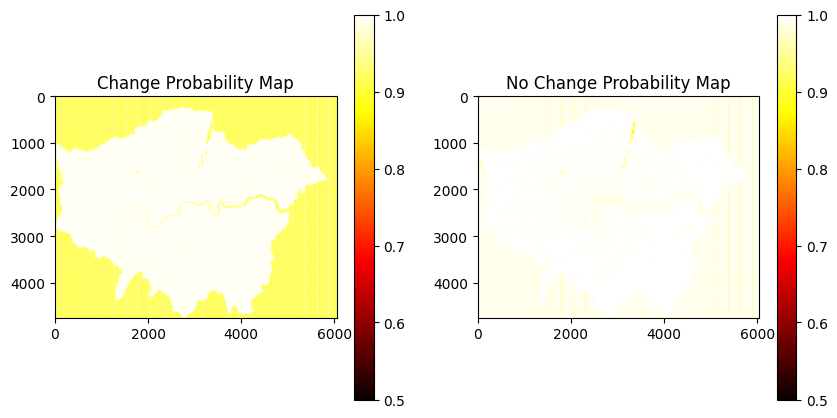

In [ ]:
import torch.nn.functional as F

# Apply softmax to the change map logits to get probabilities
change_map_probs = F.softmax(change_map_resized, dim=1)

# For binary classification, you might prefer to use sigmoid instead
# change_map_probs = torch.sigmoid(change_map_resized)

# Extract the "change" probability map (second channel)
change_map_vis_change_prob = change_map_probs[0, 1, :, :].detach().cpu().numpy()

# Optional: Extract the "no change" probability map for comparison (first channel)
change_map_vis_no_change_prob = change_map_probs[0, 0, :, :].detach().cpu().numpy()

# Plot the "change" probability map
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title('Change Probability Map')
plt.imshow(change_map_vis_change_prob, cmap='hot')
plt.colorbar()

# Plot the "no change" probability map
plt.subplot(1, 2, 2)
plt.title('No Change Probability Map')
plt.imshow(change_map_vis_no_change_prob, cmap='hot')
plt.colorbar()

plt.show()


In [ ]:
import pandas as pd


pd.DataFrame(change_map_vis_change).describe()

,0,1,2,3,4,5,6,7,8,9,...,6040,6041,6042,6043,6044,6045,6046,6047,6048,6049
count,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,...,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000,4754.000000
mean,11.106155,11.181751,17.545553,2.491265,8.404038,3.053236,7.758752,4.705747,10.382714,2.548830,...,9.388141,1.838715,9.897610,3.728885,9.610076,1.817098,9.608574,4.138402,9.401272,1.805170
std,5.749876,6.009900,7.942324,2.528806,3.741477,3.600691,5.749495,5.546005,5.662109,4.125286,...,5.104001,1.549776,3.687217,1.642079,5.233501,1.708053,3.609488,2.361258,5.075926,1.613746
min,0.423340,0.055084,0.315918,0.001648,0.318604,0.001785,0.000931,0.001312,0.143677,0.000076,...,0.008057,0.018845,0.497314,0.714844,0.693359,0.023071,0.005066,0.455322,0.020737,0.023743
25%,4.531250,5.281250,10.929688,1.132812,6.589844,1.051758,3.660156,1.002930,4.906250,0.839355,...,5.007812,1.151367,6.531250,2.927734,3.808594,0.568848,7.136719,2.518555,4.980469,0.873047
50%,9.812500,13.160156,15.937500,1.987305,7.101562,2.962891,7.433594,2.651367,9.312500,1.865234,...,10.273438,1.500977,9.054688,3.074219,9.789062,1.500000,8.125000,3.439453,10.156250,1.293945
75%,15.289062,16.253906,23.496094,4.187500,10.878906,4.303711,12.609375,9.005859,13.898438,2.425781,...,12.566406,2.500000,11.408203,4.726562,13.677734,2.449219,12.820312,5.781250,12.654297,2.453125
max,34.062500,44.500000,61.062500,67.125000,88.937500,88.750000,73.750000,77.250000,80.875000,80.125000,...,16.281250,17.578125,21.562500,15.304688,15.328125,16.468750,21.609375,15.882812,16.234375,17.625000


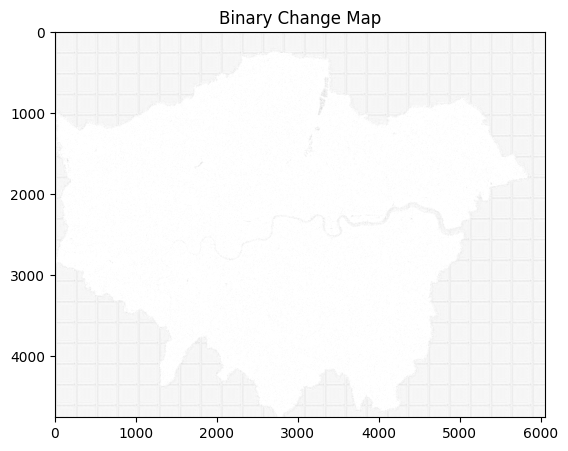

In [ ]:
# Apply threshold to the "change" class map to create a binary map
threshold = 0.5  # Adjust threshold as needed
binary_change_map = change_map_vis_change > threshold

# Plot the binary change map
plt.figure(figsize=(10, 5))
plt.title('Binary Change Map')
plt.imshow(binary_change_map, cmap='gray')
plt.show()


In [ ]:
# %pip install --quiet torchsummary torchviz

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 60.9 MB/s eta 0:00:00


In [ ]:
# from torchviz import make_dot

# # Create a dummy input tensor with the appropriate shape
# dummy_input1 = torch.randn(1, 4, 4754, 6050).to(device)
# dummy_input2 = torch.randn(1, 4, 4754, 6050).to(device)

# # Perform a forward pass to get the computational graph
# output = model(dummy_input1, dummy_input2)

# # Generate the graph
# dot = make_dot(output, params=dict(model.named_parameters()))

# # Save the graph to a file or display it
# dot.format = 'png'
# dot.render('snunet_model')


In [ ]:
features.shape

torch.Size([1, 2, 256, 256])

In [ ]:
change_map_resized.shape

torch.Size([1, 2, 4754, 6050])

# RCF Extractor

In [ ]:
%pip install --quiet rasterio

In [ ]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import rasterio
from skimage import filters, morphology
from skimage.measure import label, regionprops


# Load images function
def load_image(image_path, bands=None): # e.g. bands=[4, 3, 2, 8]
    with rasterio.open(image_path) as src:
        if bands is not None:
          image = src.read(bands)
        else:
          image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Resize image to match target size
def resize_image(image, target_shape):
    resized_image = np.zeros((image.shape[0], target_shape[0], target_shape[1]))
    for i in range(image.shape[0]):
        resized_image[i] = cv2.resize(image[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

# Extract patches from the image
def extract_patches(image, patch_size, stride):
    patches = []
    _, height, width = image.shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            patches.append(patch)
    return patches

# Reconstruct image from patches
def reconstruct_image(patches, image_size, patch_size, stride):
    reconstructed_image = np.zeros((image_size[0], image_size[2], image_size[3]))
    _, _, height, width = image_size
    patch_idx = 0
    patch_count = np.zeros((height, width))
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            patch_count[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    return reconstructed_image / patch_count


# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands = [4]
# bands = [4,3,2,8]
# bands = list(range(1,12))
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Convert to tensors
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

print(
  f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}'
)

Using device: cuda
Images shape: torch.Size([1, 1, 4754, 6050]), torch.Size([1, 1, 4754, 6050])


In [ ]:
# %pip install torchgeo

In [ ]:
im1_tensor.shape

torch.Size([1, 1, 4754, 6050])

<ipython-input-2-ceb35bc2ce58>:59: RuntimeWarning: invalid value encountered in divide
  return reconstructed_image / patch_count


Change map shape: (1, 4754, 6050)
Aggregated change map shape: (1, 4754, 6050)


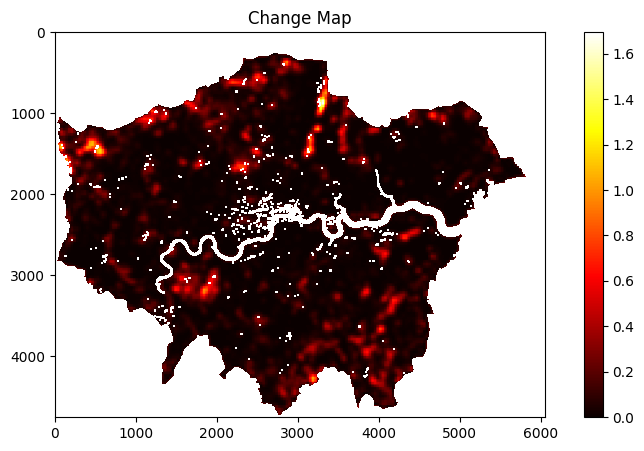

In [ ]:
import numpy as np
from torchgeo.models import RCF

rcf = RCF(in_channels=im1_tensor.shape[1], features=512, kernel_size=3, mode='gaussian').to(device)

# Parameters for patch extraction
patch_size = 64
stride = patch_size // 2

# Extract patches
im1_patches = extract_patches(im1, patch_size, stride)
im2_patches = extract_patches(im2, patch_size, stride)

# Extract features and reconstruct feature maps
features1_patches = []
features2_patches = []

with torch.no_grad():
    for im1_patch, im2_patch in zip(im1_patches, im2_patches):
        im1_patch = torch.tensor(im1_patch, dtype=torch.float32).unsqueeze(0).to(device)
        im2_patch = torch.tensor(im2_patch, dtype=torch.float32).unsqueeze(0).to(device)
        features1_patch = rcf(im1_patch)
        features2_patch = rcf(im2_patch)
        features1_patches.append(features1_patch.cpu().numpy()[0])
        features2_patches.append(features2_patch.cpu().numpy()[0])

# Reconstruct feature maps from patches
features1 = reconstruct_image(features1_patches, im1_tensor.size(), patch_size, stride)
features2 = reconstruct_image(features2_patches, im1_tensor.size(), patch_size, stride)

# Compute absolute difference between features
change_map = np.abs(features1 - features2)
print(f'Change map shape: {change_map.shape}')

# Aggregate features
change_map = np.mean(change_map, axis=0, keepdims=True)
print(f'Aggregated change map shape: {change_map.shape}')

# Convert change map to numpy array and visualize
# change_map_vis = change_map.squeeze() ### old without filtering

# Apply threshold to highlight significant changes
threshold = np.nanpercentile(change_map, 0)  # Adjust threshold as needed
change_map[change_map < threshold] = np.nan

# Mask out no-data regions
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))
change_map = change_map.squeeze()
change_map[no_data_mask] = np.nan

# Convert change map to numpy array and visualize
change_map_vis = change_map

plt.figure(figsize=(10, 5))
plt.title('Change Map')
plt.imshow(change_map_vis, cmap='hot')
plt.colorbar()
plt.show()

In [ ]:
features1.shape

(1, 4754, 6050)

Change map shape: (1, 4754, 6050)
Aggregated change map shape: (1, 4754, 6050)


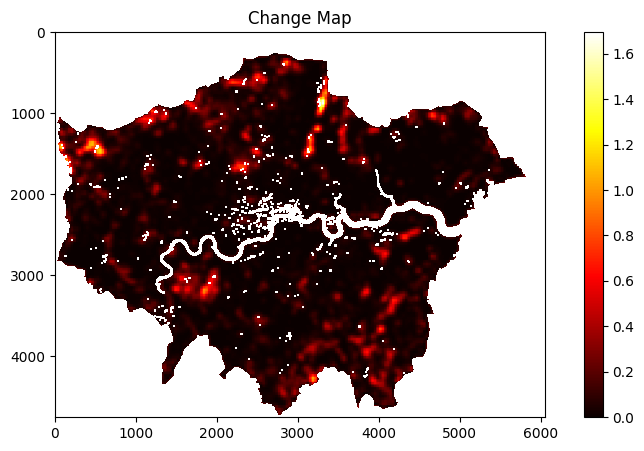

In [ ]:
# Compute absolute difference between features
change_map = np.abs(features1 - features2)
print(f'Change map shape: {change_map.shape}')

# Aggregate features
change_map = np.mean(change_map, axis=0, keepdims=True)
print(f'Aggregated change map shape: {change_map.shape}')

# Apply threshold to highlight significant changes
threshold = np.nanpercentile(change_map, 0)  # Adjust threshold as needed
change_map[change_map < threshold] = np.nan

# Mask out no-data regions
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))
change_map = change_map.squeeze()
change_map[no_data_mask] = np.nan

# Convert change map to numpy array and visualize
change_map_vis = change_map

plt.figure(figsize=(10, 5))
plt.title('Change Map')
plt.imshow(change_map_vis, cmap='hot')
plt.colorbar()
plt.show()

## Single Band

In [ ]:
im1[0, :, :].shape

(4754, 6050)

In [ ]:
from pickle import NONE
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchgeo.models import RCF

def extract_patches(image, patch_size, stride):
    patches = []
    _, height, width = image.shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            patches.append(patch)
    return patches

# Reconstruct image from patches
def reconstruct_image(patches, image_size, patch_size, stride):
    reconstructed_image = np.zeros((image_size[0], image_size[2], image_size[3]))
    _, _, height, width = image_size
    patch_idx = 0
    patch_count = np.zeros((height, width))
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            patch_count[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    return reconstructed_image / patch_count

# Function to extract features for a specific band
def extract_features_for_band_rcf(band, im1, im2, no_data_mask, model):
    print(f"Extracting features for band {band}")
    # Convert to tensors and select the specific band
    im1_band = torch.tensor(im1[band-1, :, :], dtype=torch.float32).unsqueeze(0).to(device)
    im2_band = torch.tensor(im2[band-1, :, :], dtype=torch.float32).unsqueeze(0).to(device)

    # Patch size and stride
    patch_size = 64
    stride = patch_size // 2

    # Extract patches
    im1_patches = extract_patches(im1_band, patch_size, stride)
    im2_patches = extract_patches(im2_band, patch_size, stride)

    # Extract features and reconstruct feature maps
    features1_patches = []
    features2_patches = []

    with torch.no_grad():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = torch.tensor(im1_patch, dtype=torch.float32).unsqueeze(0).to(device)
            im2_patch = torch.tensor(im2_patch, dtype=torch.float32).unsqueeze(0).to(device)
            features1_patch = rcf(im1_patch)
            features2_patch = rcf(im2_patch)
            features1_patches.append(features1_patch.cpu().numpy()[0])
            features2_patches.append(features2_patch.cpu().numpy()[0])

    # Reconstruct feature maps from patches
    features1 = reconstruct_image(features1_patches, im1_tensor.size(), patch_size, stride)
    features2 = reconstruct_image(features2_patches, im1_tensor.size(), patch_size, stride)

    # Compute absolute difference between features
    change_map = np.abs(features1 - features2)

    # Aggregate features
    change_map = np.mean(change_map, axis=0, keepdims=True)

    # Apply threshold to highlight significant changes
    threshold = np.nanpercentile(change_map, 0)  # Adjust threshold as needed
    change_map[change_map < threshold] = np.nan

    # Mask out no-data regions
    change_map = change_map.squeeze()
    change_map[no_data_mask] = np.nan

    return change_map

# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands = list(range(1, 12))  # Adjust as necessary here
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Define the RCF model
model = NONE
model = RCF(in_channels=im1.shape[0], features=512, kernel_size=3, mode='gaussian').to(device)

# Set the model to evaluation mode
# model.eval()

# Loop through each band and extract features
all_features = []
for band in bands:
    features = extract_features_for_band_rcf(band, im1, im2, no_data_mask, model)
    all_features.append(features)



Using device: cuda
Extracting features for band 1


<ipython-input-65-8c8de9276926>:50: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  im1_patch = torch.tensor(im1_patch, dtype=torch.float32).unsqueeze(0).to(device)
<ipython-input-65-8c8de9276926>:51: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  im2_patch = torch.tensor(im2_patch, dtype=torch.float32).unsqueeze(0).to(device)
<ipython-input-65-8c8de9276926>:27: RuntimeWarning: invalid value encountered in divide
  return reconstructed_image / patch_count


Extracting features for band 2
Extracting features for band 3
Extracting features for band 4
Extracting features for band 5
Extracting features for band 6
Extracting features for band 7
Extracting features for band 8
Extracting features for band 9
Extracting features for band 10
Extracting features for band 11


In [ ]:
# Apply thresholding strategy
def segment_image(binary_image, min_size=10):
    labeled_image = label(binary_image)
    for region in regionprops(labeled_image):
        if region.area < min_size:  # Remove small regions
            for coordinates in region.coords:
                labeled_image[coordinates[0], coordinates[1]] = 0
    return labeled_image

def apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='otsu',
    min_size=128,
    otsu_scaling_factor=1.0,
    segment=False,
    segment_min_size=10
    ):
    cd_map = np.zeros(detected_change_map_normalized.shape, dtype=bool)

    if strategy == 'adaptive':
        for sigma in range(101, 202, 50):
            adaptive_threshold = 2 * filters.gaussian(detected_change_map_normalized, sigma)
            cd_map_temp = detected_change_map_normalized > adaptive_threshold
            cd_map_temp = morphology.remove_small_objects(cd_map_temp, min_size=min_size)
            cd_map = cd_map | cd_map_temp

    elif strategy == 'otsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'multiotsu':
        otsu_threshold = filters.threshold_multiotsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold[1]
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'scaledOtsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > (otsu_scaling_factor * otsu_threshold)
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    else:
        raise ValueError('Unknown thresholding strategy')

    if segment:
        cd_map = segment_image(cd_map, segment_min_size)

    return cd_map

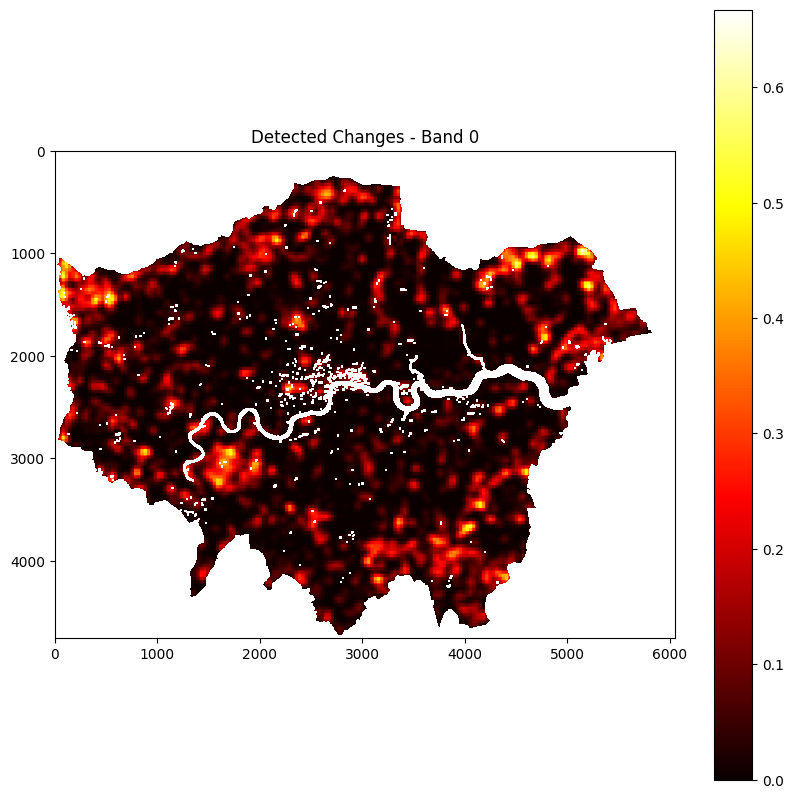

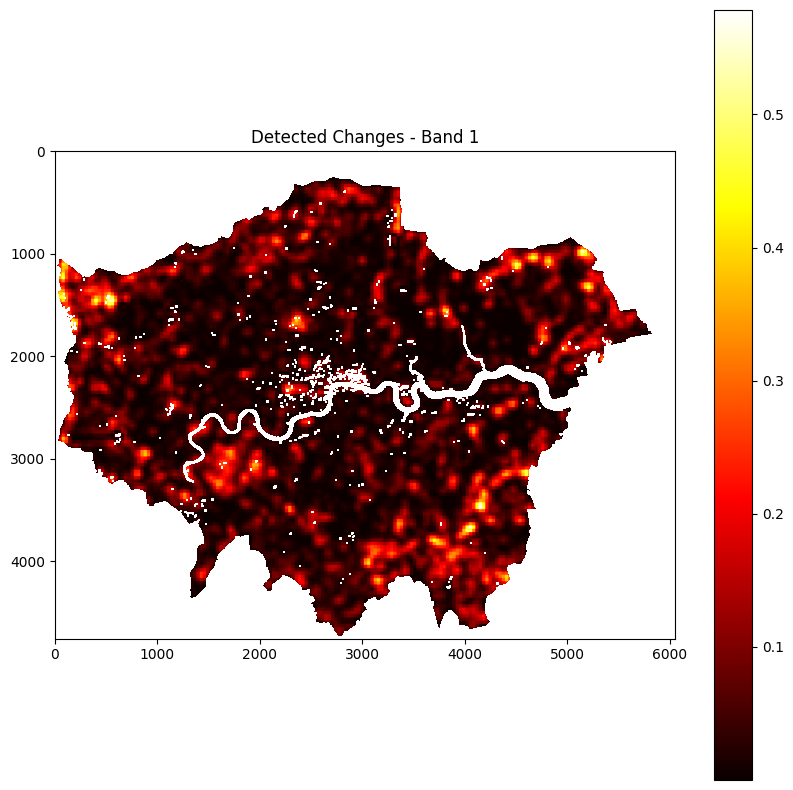

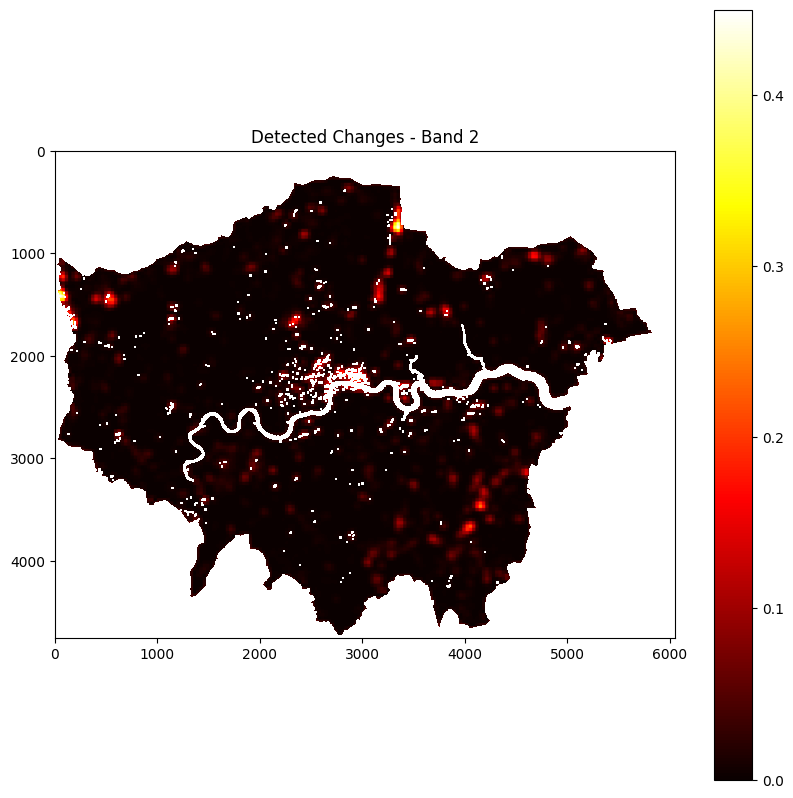

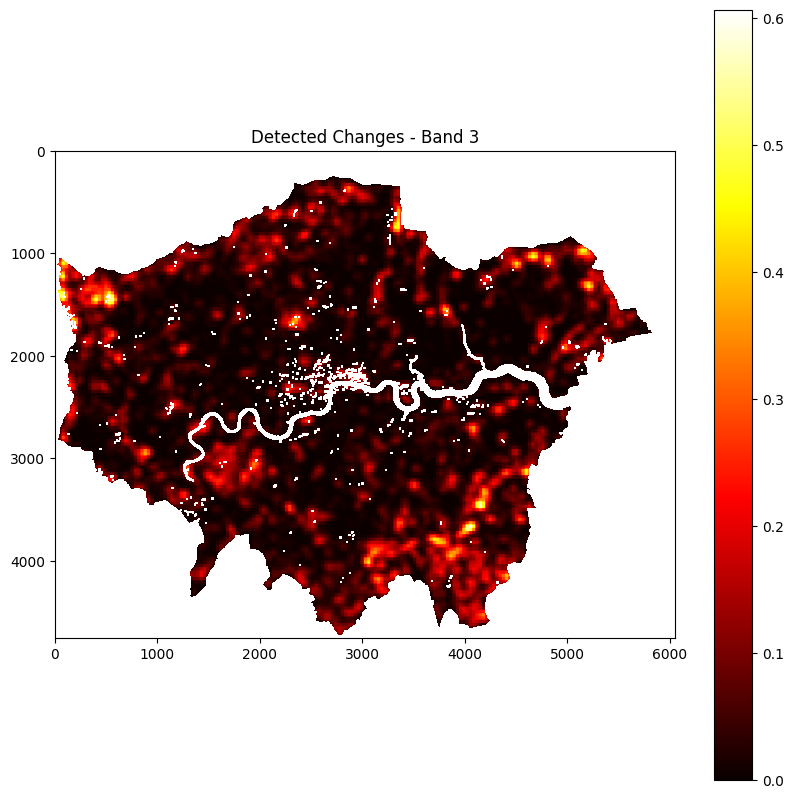

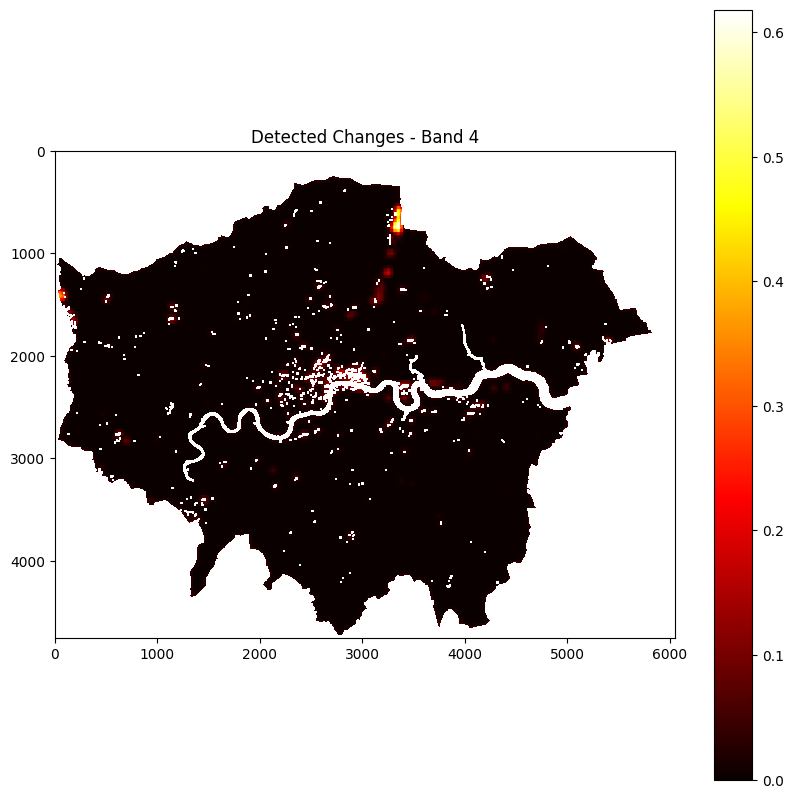

...

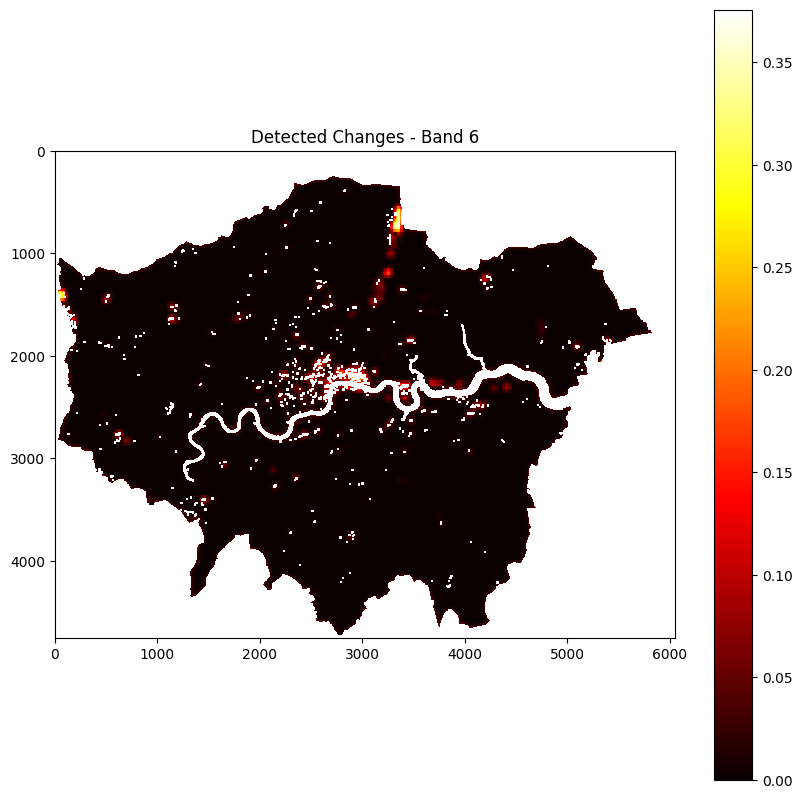

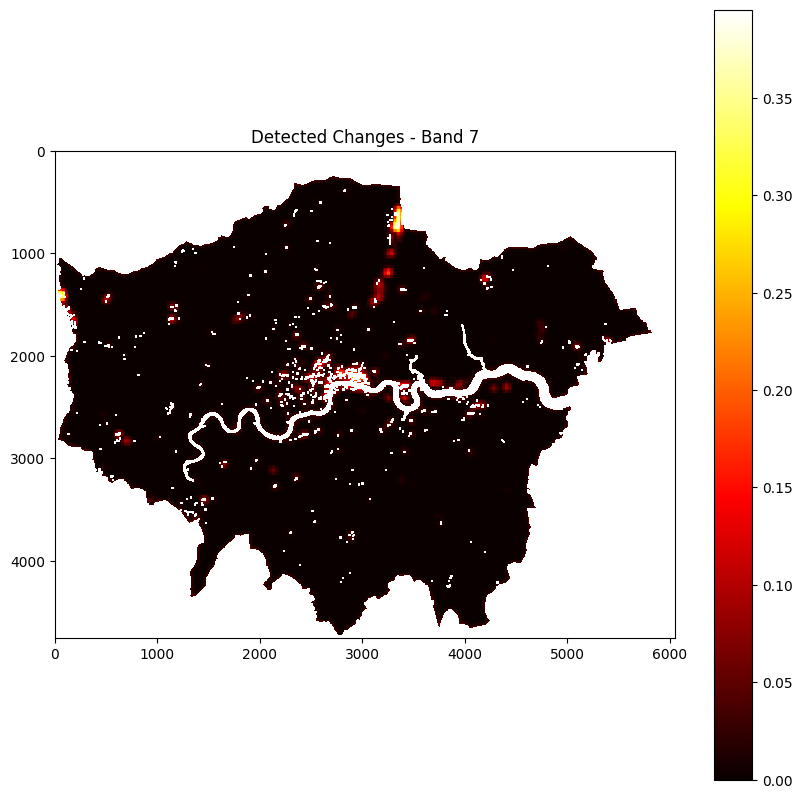

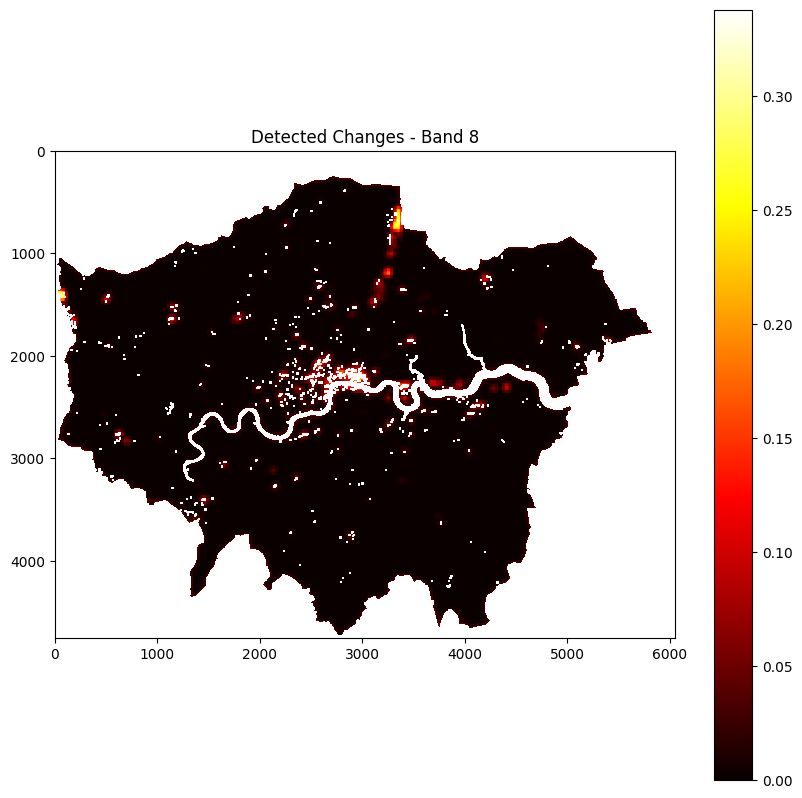

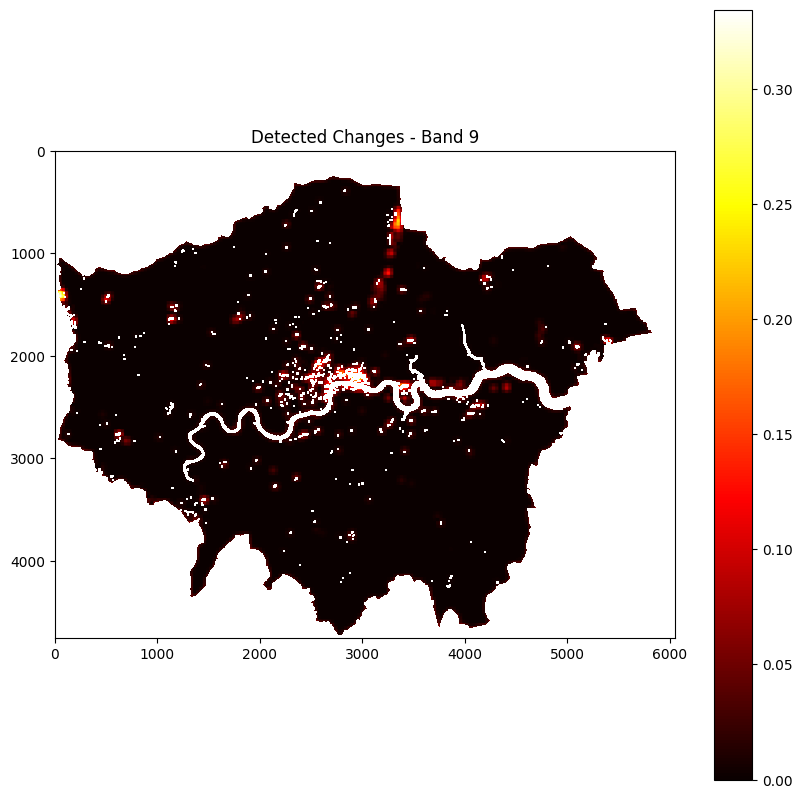

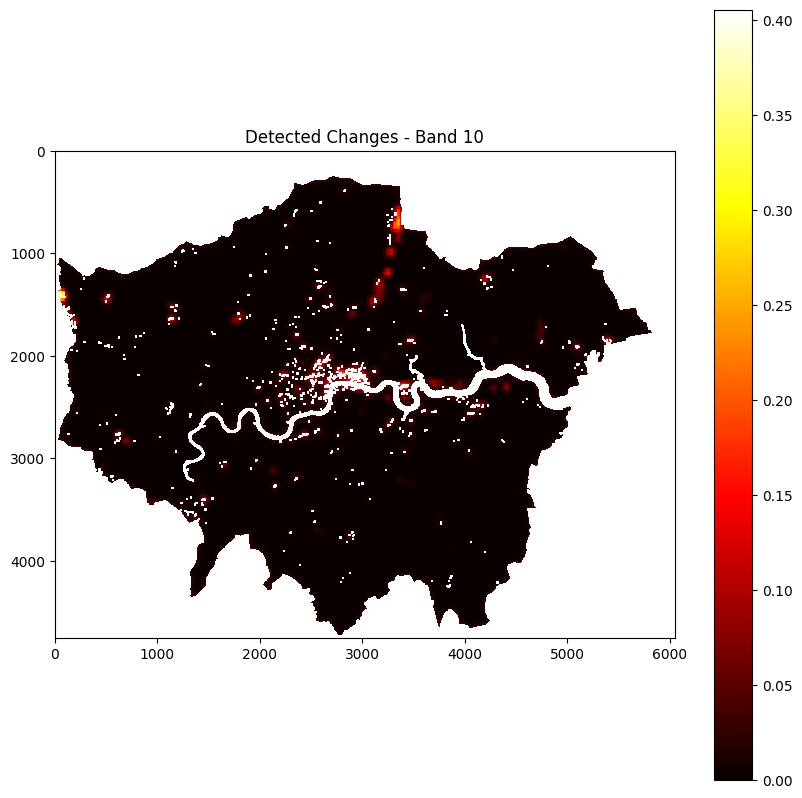

In [ ]:
for band in range(len(all_features)):

  # Visualize the change map
  plt.figure(figsize=(10, 10))
  plt.imshow(all_features[band], cmap='hot')
  plt.colorbar()
  plt.title(f'Detected Changes - Band {band}')
  plt.show()


In [ ]:

all_features[0]

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

In [ ]:

for band, change_map in enumerate(all_features, start=1):
  print(change_map.shape)

(4754, 6050)
(4754, 6050)
(4754, 6050)
(4754, 6050)
(4754, 6050)
(4754, 6050)
(4754, 6050)
(4754, 6050)
(4754, 6050)
(4754, 6050)
(4754, 6050)


In [ ]:
import os


def save_features(change_maps, model_name, image_path, output_dir):
  for band, change_map in enumerate(change_maps, start=1):
    # change_map = apply_thresholding_strategy(
    #     change_map,
    #     strategy='multiotsu',
    #     min_size=4
    # )

    # change_map = change_map.astype(np.uint8).squeeze()
    change_map = change_map.astype(np.uint8)
    print(change_map)

    # Define raster metadata
    with rasterio.open(image_path) as src2:
        transform2 = src2.transform
        crs2 = src2.crs

    raster_meta = {
        "driver": "GTiff",
        "height": change_map.shape[0],
        "width": change_map.shape[1],
        "count": 1,
        "dtype": change_map.dtype,
        "crs": crs2,
        "transform": transform2,
    }

    output_path = os.path.join(output_dir, f"features_band_{band}_{model_name}.tiff")
    with rasterio.open(output_path, 'w', **raster_meta) as dst:
        dst.write(change_map, 1)

    print(f"Change map features for band {band} saved to {output_path}")


# Define paths and bands to process
model_name = "rcf"
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
output_dir = f"drive/MyDrive/dissertation/features_{model_name}/"
model_dir = "drive/MyDrive/dissertation/models/"
bands = list(range(1, 12))

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

# Loop through each band and train the model
save_features(all_features, model_name, image2_path, output_dir)

<ipython-input-72-c9ced3e03216>:13: RuntimeWarning: invalid value encountered in cast
  change_map = change_map.astype(np.uint8)


Change map features for band 1 saved to drive/MyDrive/dissertation/features_rcf/features_band_1_rcf.tiff
Change map features for band 2 saved to drive/MyDrive/dissertation/features_rcf/features_band_2_rcf.tiff
Change map features for band 3 saved to drive/MyDrive/dissertation/features_rcf/features_band_3_rcf.tiff
Change map features for band 4 saved to drive/MyDrive/dissertation/features_rcf/features_band_4_rcf.tiff
Change map features for band 5 saved to drive/MyDrive/dissertation/features_rcf/features_band_5_rcf.tiff
Change map features for band 6 saved to drive/MyDrive/dissertation/features_rcf/features_band_6_rcf.tiff
Change map features for band 7 saved to drive/MyDrive/dissertation/features_rcf/features_band_7_rcf.tiff
Change map features for band 8 saved to drive/MyDrive/dissertation/features_rcf/features_band_8_rcf.tiff
Change map features for band 9 saved to drive/MyDrive/dissertation/features_rcf/features_band_9_rcf.tiff
Change map features for band 10 saved to drive/MyDrive/

In [ ]:
sum(all_features[0] > 0)

array([ 0,  4, 10, ...,  0,  0,  0])

Absolute difference shape: (1, 4754, 6050)
Normalized change map shape: (4754, 6050)


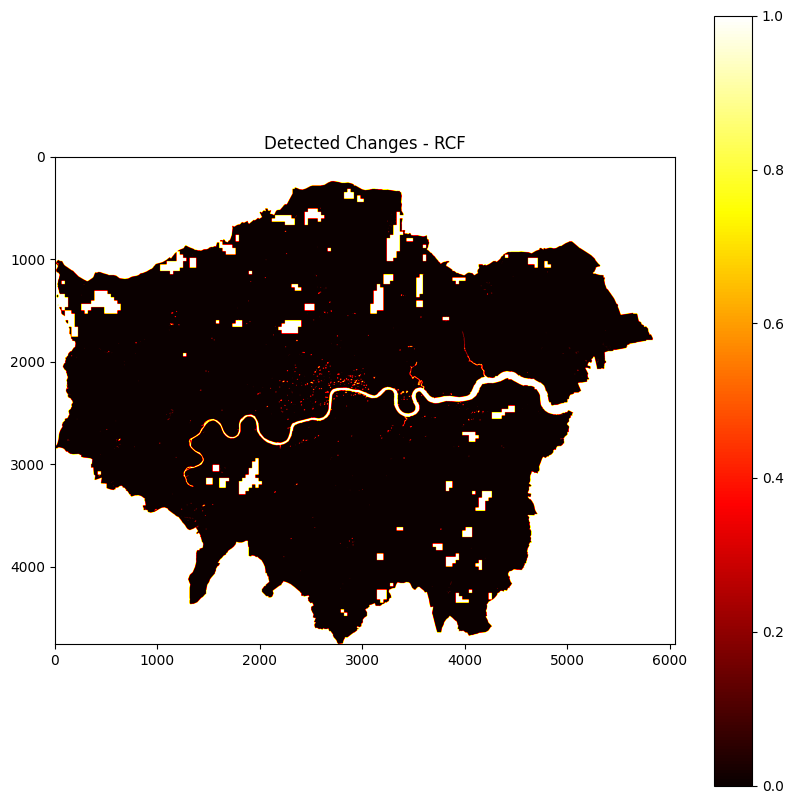

In [ ]:
# Compute absolute difference
absolute_difference = np.abs(features1 - features2)
print(f'Absolute difference shape: {absolute_difference.shape}')

# Normalize the change map
detected_change_map = np.linalg.norm(absolute_difference, axis=0)
detected_change_map_normalized = (detected_change_map - np.nanmin(detected_change_map)) / (np.nanmax(detected_change_map) - np.nanmin(detected_change_map))
print(f'Normalized change map shape: {detected_change_map_normalized.shape}')

# Apply no-data mask to the normalized change map
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))
detected_change_map_normalized[no_data_mask] = np.nan

# Replace NaN values with zero before thresholding
detected_change_map_normalized = np.nan_to_num(detected_change_map_normalized, nan=0.0)

# Apply thresholding strategy
cd_map = apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='multiotsu',
    min_size=64,
    segment=False,
    segment_min_size=16
    )

# Apply no-data mask to the final change map
cd_map[no_data_mask] = np.nan

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - RCF')
plt.show()


In [ ]:
import os
import numpy as np
import rasterio

# Define the paths
data_path = "drive/MyDrive/dissertation/"
image2_path = os.path.join(data_path, "clipped_merged_2021.tiff")

# Read the metadata from one of the input images
with rasterio.open(image2_path) as src2:
    transform2 = src2.transform
    crs2 = src2.crs

# Get the change map from the model
# change_map = model(im1_tensor).detach().cpu().numpy()
# change_map = cd_map.astype(np.uint8)

# Assuming the change map is in the first channel, reshape it to 2D
# change_map = change_map[0, 0, :, :]  # Adjust this indexing if necessary

# Create the raster metadata
raster_meta = {
    "driver": "GTiff",
    "height": change_map.shape[0],
    "width": change_map.shape[1],
    "count": 1,
    "dtype": change_map.dtype,
    "crs": crs2,
    "transform": transform2,
}

# Define the output path
output_path = os.path.join(data_path, "change_map_rcf.tiff")

# Write the change map to the raster file
with rasterio.open(
    output_path,
    'w',
    **raster_meta
) as dst:
    dst.write(change_map, 1)

print(f"Change map saved to {output_path}")


Change map saved to drive/MyDrive/dissertation/change_map_rcf.tiff


In [ ]:
test = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=2,
    segment=False,
    segment_min_size=10
    )

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(test, cmap='hot')
plt.colorbar()
plt.title('Detected Changes - RCF')
plt.show()

ValueError: autodetected range of [nan, nan] is not finite

In [ ]:
# Apply no-data mask to features
features1[:, no_data_mask] = 0
features2[:, no_data_mask] = 0

# Normalize features
normalized_features1 = (features1 - np.mean(features1)) / np.std(features1)
normalized_features2 = (features2 - np.mean(features2)) / np.std(features2)

# Aggregate features across channels
aggregated_features1 = np.mean(normalized_features1, axis=0, keepdims=True)
aggregated_features2 = np.mean(normalized_features2, axis=0, keepdims=True)

# Compute absolute difference
absolute_difference = np.abs(aggregated_features1 - aggregated_features2)

# Calculate the change map using the norm of the differences
detected_change_map = np.linalg.norm(absolute_difference, axis=0)

# Normalize the change map
numerator = (detected_change_map - np.amin(detected_change_map))
denominator = (np.amax(detected_change_map) - np.amin(detected_change_map))
detected_change_map_normalized = numerator / denominator

change_map = apply_thresholding_strategy(
    detected_change_map,
    strategy='multiotsu',
    min_size=8,
    segment=False,
    segment_min_size=10
    )

change_map = change_map.astype(np.uint8)

ValueError: autodetected range of [nan, nan] is not finite

In [4]:
from skimage import filters, morphology
from skimage.measure import label, regionprops

# Apply thresholding strategy
def segment_image(binary_image, min_size=10):
    labeled_image = label(binary_image)
    for region in regionprops(labeled_image):
        if region.area < min_size:  # Remove small regions
            for coordinates in region.coords:
                labeled_image[coordinates[0], coordinates[1]] = 0
    return labeled_image

def apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='otsu',
    min_size=128,
    otsu_scaling_factor=1.0,
    segment=False,
    segment_min_size=10
    ):
    cd_map = np.zeros(detected_change_map_normalized.shape, dtype=bool)

    if strategy == 'adaptive':
        for sigma in range(101, 202, 50):
            adaptive_threshold = 2 * filters.gaussian(detected_change_map_normalized, sigma)
            cd_map_temp = detected_change_map_normalized > adaptive_threshold
            cd_map_temp = morphology.remove_small_objects(cd_map_temp, min_size=min_size)
            cd_map = cd_map | cd_map_temp

    elif strategy == 'otsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'multiotsu':
        otsu_threshold = filters.threshold_multiotsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold[1]
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'scaledOtsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > (otsu_scaling_factor * otsu_threshold)
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    else:
        raise ValueError('Unknown thresholding strategy')

    if segment:
        cd_map = segment_image(cd_map, segment_min_size)

    return cd_map

# Workflow

In [ ]:
# %pip install --quiet torchgeo

In [ ]:
%pip install --quiet rasterio earthpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 29.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 26.7 MB/s eta 0:00:00


In [3]:
import torch
import numpy as np
import cv2
import rasterio

# Load images function
def load_image(image_path, bands=None):
    with rasterio.open(image_path) as src:
        if bands is not None:
            image = src.read(bands)
        else:
            image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

# Resize image to match target size
def resize_image(image, target_shape):
    resized_image = np.zeros((image.shape[0], target_shape[0], target_shape[1]))
    for i in range(image.shape[0]):
        resized_image[i] = cv2.resize(image[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_image


# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands = [4]
# bands = list(range(1,12))
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Convert to tensors
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

print(f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}')


Using device: cuda
Images shape: torch.Size([1, 1, 4754, 6050]), torch.Size([1, 1, 4754, 6050])


In [ ]:
# import torch.nn.functional as F


# def pad_to_multiple(tensor, multiple):
#     height, width = tensor.shape[2], tensor.shape[3]
#     pad_height = (multiple - height % multiple) % multiple
#     pad_width = (multiple - width % multiple) % multiple
#     padding = (0, pad_width, 0, pad_height)
#     return F.pad(tensor, padding, mode='reflect')

# # Pad images
# im1_tensor = pad_to_multiple(im1_tensor, 32)
# im2_tensor = pad_to_multiple(im2_tensor, 32)

# print(f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}')

## TinyCD

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

from typing import List, Optional
from torch import Tensor, reshape, stack
from torch.nn import (Conv2d, InstanceNorm2d, Module, PReLU, Sequential, Upsample)


class PixelwiseLinear(Module):
    def __init__(
        self,
        fin: List[int],
        fout: List[int],
        last_activation: Module = None,
    ) -> None:
        assert len(fout) == len(fin)
        super().__init__()

        n = len(fin)
        self._linears = Sequential(
            *[
                Sequential(
                    Conv2d(fin[i], fout[i], kernel_size=1, bias=True),
                    PReLU()
                    if i < n - 1 or last_activation is None
                    else last_activation,
                )
                for i in range(n)
            ]
        )

    def forward(self, x: Tensor) -> Tensor:
        # Processing the tensor:
        return self._linears(x)


class MixingBlock(Module):
    def __init__(self, ch_in: int, ch_out: int):
        super(MixingBlock, self).__init__()
        self.convmix = nn.Sequential(
            nn.Conv2d(ch_in, ch_out, kernel_size=3, padding=1),
            nn.PReLU(),
            nn.InstanceNorm2d(ch_out),
        )

    def forward(self, x: Tensor, y: Tensor) -> Tensor:
        mixed = torch.cat((x, y), dim=1)
        # mixed = torch.reshape(mixed, (x.shape[0], -1, x.shape[2], x.shape[3]))
        return self.convmix(mixed)


class MixingMaskAttentionBlock(Module):
    """use the grouped convolution to make a sort of attention"""

    def __init__(
        self,
        ch_in: int,
        ch_out: int,
        fin: List[int],
        fout: List[int],
        generate_masked: bool = False,
    ):
        super().__init__()
        self._mixing = MixingBlock(ch_in, ch_out)
        self._linear = PixelwiseLinear(fin, fout)
        self._final_normalization = InstanceNorm2d(ch_out) if generate_masked else None
        self._mixing_out = MixingBlock(ch_in, ch_out) if generate_masked else None

    def forward(self, x: Tensor, y: Tensor) -> Tensor:
        z_mix = self._mixing(x, y)
        z = self._linear(z_mix)
        z_mix_out = 0 if self._mixing_out is None else self._mixing_out(x, y)

        return (
            z
            if self._final_normalization is None
            else self._final_normalization(z_mix_out * z)
        )


class UpMask(Module):
    def __init__(
        self,
        scale_factor: float,
        nin: int,
        nout: int,
    ):
        super().__init__()
        self._upsample = Upsample(
            scale_factor=scale_factor, mode="bilinear", align_corners=True
        )
        self._convolution = Sequential(
            Conv2d(nin, nin, kernel_size=3, padding=1, groups=nin, bias=False),
            PReLU(),
            InstanceNorm2d(nin),
            Conv2d(nin, nout, kernel_size=1, stride=1),
            PReLU(),
            InstanceNorm2d(nout),
        )

    def forward(self, x: Tensor, y: Optional[Tensor] = None) -> Tensor:
        x = self._upsample(x)
        if y is not None:
            y = F.interpolate(y, size=x.shape[2:], mode='bilinear', align_corners=False)
            x = x * y
        return self._convolution(x)



import torchvision.models as tv_models


def modify_efficientnet_for_single_channel(model):
    # Locate and replace the first convolutional layer
    for name, module in model.named_children():
        if isinstance(module, nn.Conv2d) and module.in_channels == 3:
            new_conv = nn.Conv2d(
                1,
                module.out_channels,
                kernel_size=module.kernel_size,
                stride=module.stride,
                padding=module.padding,
                bias=module.bias
                )
            model._modules[name] = new_conv
            break
        elif isinstance(module, nn.Sequential):
            for seq_name, seq_module in module.named_children():
                if isinstance(seq_module, nn.Conv2d) and seq_module.in_channels == 3:
                    new_conv = nn.Conv2d(
                        1,
                        seq_module.out_channels,
                        kernel_size=seq_module.kernel_size,
                        stride=seq_module.stride,
                        padding=seq_module.padding,
                        bias=seq_module.bias
                        )
                    module._modules[seq_name] = new_conv
                    break
    return model


def _get_backbone(
    bkbn_name, weights, output_layer_bkbn, freeze_backbone
) -> nn.ModuleList:
    # The whole model:
    entire_model = getattr(tv_models, bkbn_name)(
        weights=weights
    ).features

    # Modify the first layer to accept single-channel input
    entire_model = modify_efficientnet_for_single_channel(entire_model)

    # Slicing it:
    derived_model = nn.ModuleList([])
    for name, layer in entire_model.named_children():
        derived_model.append(layer)
        if name == output_layer_bkbn:
            break

    # Freezing the backbone weights:
    if freeze_backbone:
        for param in derived_model.parameters():
            param.requires_grad = False
    return derived_model



class TinyCD(Module):
    def __init__(
        self,
        bkbn_name="efficientnet_b0",
        weights='DEFAULT',
        output_layer_bkbn="3",
        freeze_backbone=False,
        bkbn_out_channels=None
    ):
        super().__init__()

        # Load the pretrained backbone according to parameters:
        self._backbone = _get_backbone(
            bkbn_name, weights, output_layer_bkbn, freeze_backbone
        )

        # Initialize mixing blocks:
        backbone_out_channels = {
            "efficientnet_b0": bkbn_out_channels, # [32, 32, 32, 64]
            "efficientnet_b4": bkbn_out_channels # [48, 64, 112, 1792],
            # Add more backbones and their corresponding output channels if needed
        }[bkbn_name]

        self._first_mix = MixingMaskAttentionBlock(2, backbone_out_channels[0], [backbone_out_channels[0]], [backbone_out_channels[0]])
        self._mixing_mask = nn.ModuleList(
            [
                MixingMaskAttentionBlock(
                    backbone_out_channels[0],
                    backbone_out_channels[1],
                     [backbone_out_channels[1]],
                      [backbone_out_channels[1]]
                    ),
                MixingMaskAttentionBlock(
                    backbone_out_channels[1],
                    backbone_out_channels[2],
                     [backbone_out_channels[2]],
                      [backbone_out_channels[2]]
                    ),
                MixingBlock(backbone_out_channels[2] * 2, backbone_out_channels[3]),
            ]
        )

        # Initialize Upsampling blocks:
        self._up = nn.ModuleList(
            [
                UpMask(2, backbone_out_channels[3], backbone_out_channels[2]),
                UpMask(2, backbone_out_channels[2], backbone_out_channels[1]),
                UpMask(2, backbone_out_channels[1], backbone_out_channels[0]),
            ]
        )

        # Final classification layer:
        self._classify = PixelwiseLinear(
            [backbone_out_channels[0],
             int(backbone_out_channels[0] / 2),
             int(backbone_out_channels[0] / 4)],
              [int(backbone_out_channels[0] / 2),
               int(backbone_out_channels[0] / 4), 1],
            nn.Identity()
            )

    def forward(self, ref: Tensor, test: Tensor) -> Tensor:
        features = self._encode(ref, test)
        latents = self._decode(features)
        return self._classify(latents)

    def _encode(self, ref, test) -> List[Tensor]:
        features = [self._first_mix(ref, test)]
        for num, layer in enumerate(self._backbone):
            ref, test = layer(ref), layer(test)
            if num != 0:
                features.append(self._mixing_mask[num - 1](ref, test))
        return features

    def _decode(self, features):
        # Add a check to handle cases where 'features' might be shorter than expected
        num_up_layers = len(self._up)
        num_features = len(features)

        upping = self._up[-1](features[-1])  # Start with the last feature map

        for i in range(1, min(num_up_layers, num_features)):
            upping = self._up[-i-1](upping, features[-i-1])  # Iterate backwards, matching layers to features
        return upping

    def configure_optimizers(self, max_epochs, lr):
        def lambda_rule(epoch):
            lr_l = 1.0 - epoch / float(max_epochs + 1)
            return lr_l

        optimizer = optim.SGD(
            self.parameters(), lr=lr, momentum=0.9, weight_decay=5e-4
        )
        scheduler = LambdaLR(optimizer, lr_lambda=lambda_rule)
        return optimizer, scheduler

def resize_to_match(target: Tensor, reference: Tensor) -> Tensor:
    return F.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)


In [ ]:
class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

# Function to extract patches from the image
def extract_patches(image, patch_size, stride):
    patches = []
    _, height, width = image.shape[-3:]  # Update to handle correct shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            patches.append(patch)
    return patches

# Function to reconstruct image from patches
def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

In [ ]:
import torch
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
# from utils import extract_patches, reconstruct_image, ClearCache  # Assume these utilities are available

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define the model
num_channels = im1_tensor.shape[1] # bands
bkbn_out_channels = [32, 32, 32, 1]
# bkbn_out_channels = [48, 64, 32, 1792]
model = None
model = TinyCD(
    bkbn_name="efficientnet_b0",
    weights='DEFAULT',
    output_layer_bkbn="1",
    freeze_backbone=False,
    bkbn_out_channels=bkbn_out_channels
    ).to(device)
# model = CGNet(weights='DEFAULT').to(device)
# model = SiamUnet_diff(input_nbr=1, label_nbr=1).to(device)
# model = BiDateNet(n_channels=1, n_classes=1).to(device)

# Define loss and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
# optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9, weight_decay=5e-4)
scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(50 + 1))

# Patch size and stride
patch_size = 128
stride = patch_size // 2
batch_size = 16

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)

# Ensure the tensors are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.squeeze(1)
im2_patches = im2_patches.squeeze(1)

dataset = TensorDataset(im1_patches, im2_patches)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)

# Training loop
num_epochs = 1
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    with ClearCache():
      for im1_patch_batch, im2_patch_batch in dataloader:
          im1_patch_batch, im2_patch_batch = im1_patch_batch.to(device), im2_patch_batch.to(device)
          output = model(im1_patch_batch, im2_patch_batch)
          resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
          loss = criterion(resized_output, im2_patch_batch)
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
    scheduler.step()
    print(f'Epoch {epoch + 1}, Loss: {loss.item():.4f}')

# Save the trained model
torch.save(model.state_dict(), 'tinycd.pth')


Epoch 1, Loss: 0.0127


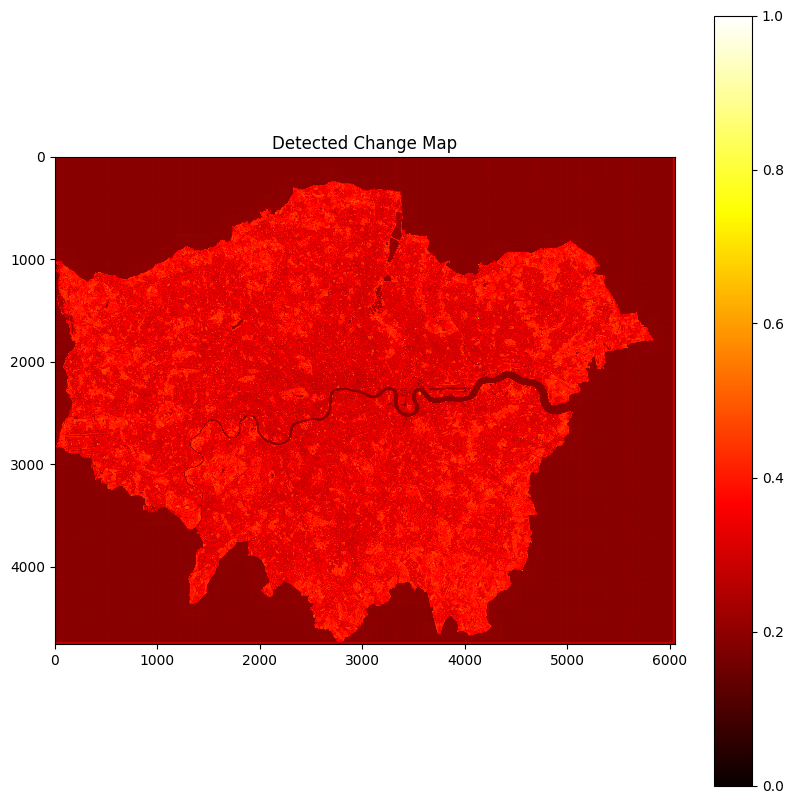

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Model initialization
# model = SiamUnet_diff(input_nbr=1, label_nbr=1).to(device)
# model.load_state_dict(torch.load('siam_unet_diff.pth'))
model.eval()

# Function to generate change map
def generate_change_map(model, im1_patches, im2_patches, patch_size, stride, image_shape):
    model.eval()
    change_patches = []

    with torch.no_grad():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = im1_patch.unsqueeze(0).to(device)  # Add batch dimension
            im2_patch = im2_patch.unsqueeze(0).to(device)  # Add batch dimension
            output = model(im1_patch, im2_patch)
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy().squeeze())

    change_patches = np.array(change_patches)
    change_map = reconstruct_image(change_patches, image_shape, patch_size, stride)

    # Normalize the change map to the range [0, 1]
    change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

    return change_map

def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

def visualize_change_map(change_map):
    plt.figure(figsize=(10, 10))
    plt.imshow(change_map, cmap='hot', interpolation='nearest')
    plt.colorbar()
    plt.title('Detected Change Map')
    plt.show()

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches])
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches])

# Ensure patches are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.view(-1, 1, patch_size, patch_size)
im2_patches = im2_patches.view(-1, 1, patch_size, patch_size)

# Generate and visualize the change map
change_map = generate_change_map(model, im1_patches, im2_patches, patch_size, stride, im1_tensor.shape)

if change_map.ndim == 3:
    change_map = np.squeeze(change_map)

visualize_change_map(change_map)


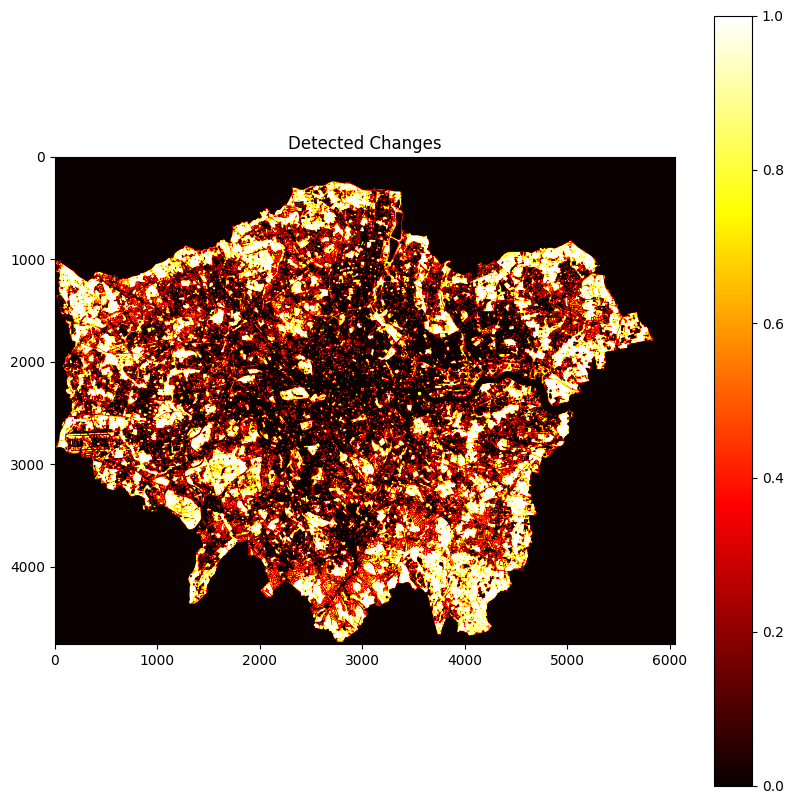

In [ ]:
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=16
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title(f'Detected Changes')
plt.show()

In [ ]:
import os
import numpy as np
import rasterio

# Load metadata from the original image to use in the new TIFF
with rasterio.open(image1_path) as src:
    metadata = src.meta.copy()

# Update metadata to reflect the number of layers and data type
metadata.update(dtype=rasterio.uint8, count=1)

# Save the binary mask to a new TIFF file
model_name = "tinycd"
data_path = "drive/MyDrive/dissertation/"
output_path = os.path.join(data_path, f"change_map_{model_name}.tiff")
with rasterio.open(output_path, 'w', **metadata) as dst:
    dst.write(cd_map, 1)

print(f"Change map saved to {output_path}")


Change map saved to drive/MyDrive/dissertation/change_map_tinycd.tiff


In [ ]:
# len(im2_patches), im2_patches[0].shape
# (1656, torch.Size([1, 256, 256]))

(1656, torch.Size([1, 256, 256]))

## FCSiamDiff

In [ ]:
import torch
from torchgeo.models import FCSiamDiff
import torch.nn.functional as F
import cv2
import matplotlib.pyplot as plt
import numpy as np

class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

def resize_to_match(target: torch.Tensor, reference: torch.Tensor) -> torch.Tensor:
    return F.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)

# Define the FCSiamDiff model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = None
model = FCSiamDiff(
    encoder_name='resnet34',
    encoder_depth=5,
    encoder_weights='imagenet',
    decoder_use_batchnorm=True,
    decoder_channels=(256, 128, 64, 32, 16),
    decoder_attention_type=None,
    in_channels=3,  # Adjusted to 4 channels for the input images
    classes=1,
    activation=None
).to(device)


Change map shape: torch.Size([1, 1, 4768, 6080])
Raw change map value range: -3.9707016944885254 to 1.7806411981582642
Resized change map value range: -3.9707016944885254 to 1.7806411981582642
Masked change map value range: -3.9707016944885254 to 1.7806411981582642
Normalized change map value range: 0.0 to 1.0


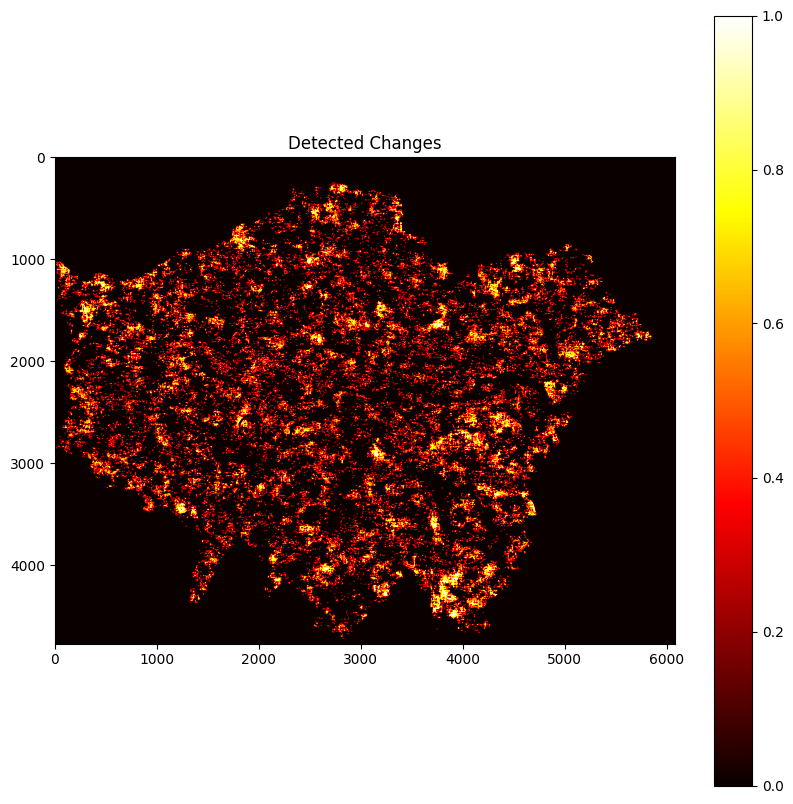

In [ ]:
# Set the model to evaluation mode
model.eval()

# Prepare input tensors (batch size, time steps, channels, height, width)
input_tensor = torch.stack([im1_tensor, im2_tensor], dim=1).to(device)  # Shape: (B, T, C, H, W)

# Extract features and create change map
with torch.no_grad():
    with ClearCache():
        change_map = model(input_tensor)

# Print the shape and raw values of the output
print(f"Change map shape: {change_map.shape}")
change_map_np = change_map.squeeze().cpu().numpy()
print(f"Raw change map value range: {np.min(change_map_np)} to {np.max(change_map_np)}")

# Apply no-data mask to change map
change_map_resized = resize_to_match(change_map, im1_tensor)
change_map_resized = change_map_resized.squeeze().cpu().numpy()

# Print the range of values in the resized change map
print(f"Resized change map value range: {np.min(change_map_resized)} to {np.max(change_map_resized)}")

# Ensure the no-data mask is the correct shape
no_data_mask_resized = cv2.resize(no_data_mask.astype(np.float32), (change_map_resized.shape[1], change_map_resized.shape[0]), interpolation=cv2.INTER_NEAREST).astype(bool)

# Apply the no-data mask correctly
change_map_resized[no_data_mask_resized] = np.nan

# Check values after applying the mask
print(f"Masked change map value range: {np.nanmin(change_map_resized)} to {np.nanmax(change_map_resized)}")

# Replace NaN values with 0 for normalization
change_map_for_normalization = np.nan_to_num(change_map_resized, nan=0.0)

# Normalize the change map to the range [0, 1]
change_map_min = np.min(change_map_for_normalization)
change_map_max = np.max(change_map_for_normalization)
change_map_normalized = (change_map_for_normalization - change_map_min) / (change_map_max - change_map_min)

# Check the normalized values
print(f"Normalized change map value range: {np.min(change_map_normalized)} to {np.max(change_map_normalized)}")

# Apply thresholding strategy
cd_map = apply_thresholding_strategy(
    change_map_normalized,
    strategy='multiotsu',
    min_size=32,
    segment=False,
    segment_min_size=128
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()


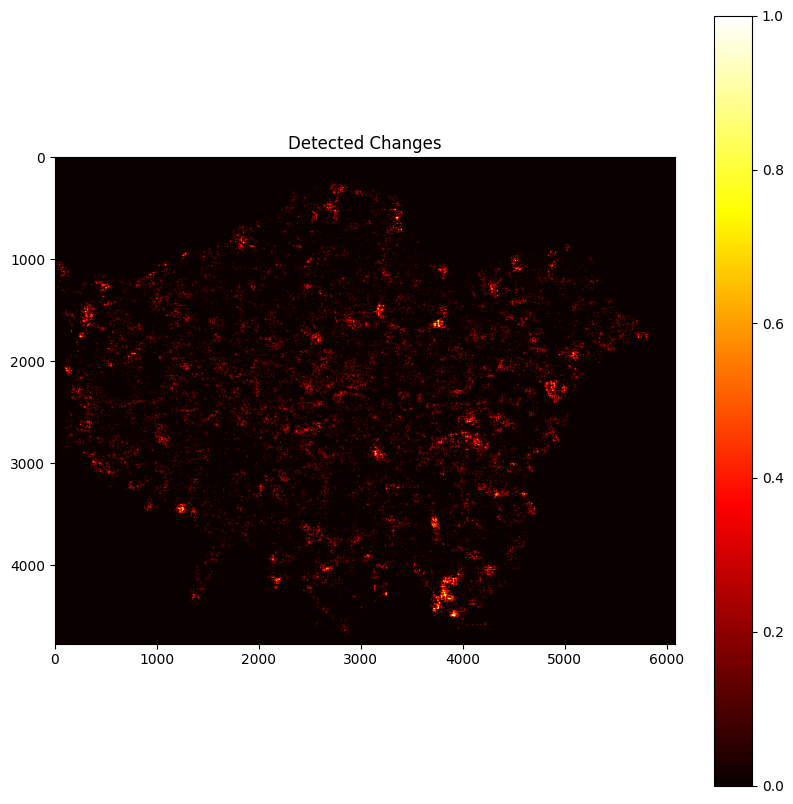

In [ ]:
# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(change_map_resized>.25, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()

In [ ]:
import os
import numpy as np
import rasterio

# Define the paths
data_path = "drive/MyDrive/dissertation/"
image2_path = os.path.join(data_path, "clipped_merged_2021.tiff")

# Read the metadata from one of the input images
with rasterio.open(image2_path) as src2:
    transform2 = src2.transform
    crs2 = src2.crs

# Get the change map from the model
# change_map = model(im1_tensor).detach().cpu().numpy()
change_map = cd_map.astype(np.uint8)

# Assuming the change map is in the first channel, reshape it to 2D
# change_map = change_map[0, 0, :, :]  # Adjust this indexing if necessary

# Create the raster metadata
raster_meta = {
    "driver": "GTiff",
    "height": change_map.shape[0],
    "width": change_map.shape[1],
    "count": 1,
    "dtype": change_map.dtype,
    "crs": crs2,
    "transform": transform2,
}

# Define the output path
output_path = os.path.join(data_path, "change_map_fcsd.tiff")

# Write the change map to the raster file
with rasterio.open(
    output_path,
    'w',
    **raster_meta
) as dst:
    dst.write(change_map, 1)

print(f"Change map saved to {output_path}")


Change map saved to drive/MyDrive/dissertation/change_map_fcsd.tiff


## CGNet

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models

class BasicConv2d(nn.Module):
    def __init__(self, in_planes, out_planes, kernel_size, stride=1, padding=0, dilation=1):
        super().__init__()
        self.conv = nn.Conv2d(
            in_planes, out_planes,
            kernel_size=kernel_size, stride=stride,
            padding=padding, dilation=dilation, bias=False)
        self.bn = nn.BatchNorm2d(out_planes)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        x = self.relu(x)
        return x

class ChangeGuideModule(nn.Module):
    def __init__(self, in_dim):
        super().__init__()
        self.chanel_in = in_dim
        self.query_conv = nn.Conv2d(in_channels=in_dim, out_channels=in_dim//8, kernel_size=1)
        self.key_conv = nn.Conv2d(in_channels=in_dim, out_channels=in_dim//8, kernel_size=1)
        self.value_conv = nn.Conv2d(in_channels=in_dim, out_channels=in_dim, kernel_size=1)

        self.gamma = nn.Parameter(torch.zeros(1))
        self.softmax = nn.Softmax(dim=-1)

    def forward(self, x, guiding_map0):
        m_batchsize, C, height, width = x.size()
        guiding_map0 = F.interpolate(guiding_map0, x.size()[2:], mode='bilinear', align_corners=True)
        guiding_map = torch.sigmoid(guiding_map0)

        query = self.query_conv(x) * (1 + guiding_map)
        proj_query = query.view(m_batchsize, -1, width*height).permute(0, 2, 1)
        key = self.key_conv(x) * (1 + guiding_map)
        proj_key = key.view(m_batchsize, -1, width*height)

        energy = torch.bmm(proj_query, proj_key)
        attention = self.softmax(energy)
        self.energy = energy
        self.attention = attention

        value = self.value_conv(x) * (1 + guiding_map)
        proj_value = value.view(m_batchsize, -1, width*height)

        out = torch.bmm(proj_value, attention.permute(0, 2, 1))
        out = out.view(m_batchsize, C, height, width)
        out = self.gamma * out + x

        return out

class CGNet(nn.Module):
    def __init__(self, weights='DEFAULT'):
        super().__init__()
        vgg16_bn = models.vgg16_bn(weights=weights)
        # Modify the first layer to accept a single channel
        vgg16_bn.features[0] = nn.Conv2d(1, 64, kernel_size=3, stride=1, padding=1, bias=False)
        self.inc = vgg16_bn.features[:5]  # 64
        self.down1 = vgg16_bn.features[5:12]  # 128
        self.down2 = vgg16_bn.features[12:22]  # 256
        self.down3 = vgg16_bn.features[22:32]  # 512
        self.down4 = vgg16_bn.features[32:42]  # 512

        self.conv_reduce_1 = BasicConv2d(128*2, 128, 3, 1, 1)
        self.conv_reduce_2 = BasicConv2d(256*2, 256, 3, 1, 1)
        self.conv_reduce_3 = BasicConv2d(512*2, 512, 3, 1, 1)
        self.conv_reduce_4 = BasicConv2d(512*2, 512, 3, 1, 1)

        self.up_layer4 = BasicConv2d(512, 512, 3, 1, 1)
        self.up_layer3 = BasicConv2d(512, 512, 3, 1, 1)
        self.up_layer2 = BasicConv2d(256, 256, 3, 1, 1)

        self.decoder = nn.Sequential(
            BasicConv2d(512, 64, 3, 1, 1),
            nn.Conv2d(64, 1, 3, 1, 1))

        self.decoder_final = nn.Sequential(
            BasicConv2d(128, 64, 3, 1, 1),
            nn.Conv2d(64, 1, 1))

        self.cgm_2 = ChangeGuideModule(256)
        self.cgm_3 = ChangeGuideModule(512)
        self.cgm_4 = ChangeGuideModule(512)

        self.upsample2x = nn.UpsamplingBilinear2d(scale_factor=2)
        self.decoder_module4 = BasicConv2d(1024, 512, 3, 1, 1)
        self.decoder_module3 = BasicConv2d(768, 256, 3, 1, 1)
        self.decoder_module2 = BasicConv2d(384, 128, 3, 1, 1)

    def forward(self, x1, x2):
        size = x1.size()[2:]
        layer1_pre = self.inc(x1)
        layer1_A = self.down1(layer1_pre)
        layer2_A = self.down2(layer1_A)
        layer3_A = self.down3(layer2_A)
        layer4_A = self.down4(layer3_A)

        layer1_pre = self.inc(x2)
        layer1_B = self.down1(layer1_pre)
        layer2_B = self.down2(layer1_B)
        layer3_B = self.down3(layer2_B)
        layer4_B = self.down4(layer3_B)

        layer1 = torch.cat((layer1_B,layer1_A),dim=1)
        layer2 = torch.cat((layer2_B,layer2_A),dim=1)
        layer3 = torch.cat((layer3_B,layer3_A),dim=1)
        layer4 = torch.cat((layer4_B,layer4_A),dim=1)

        layer1 = self.conv_reduce_1(layer1)
        layer2 = self.conv_reduce_2(layer2)
        layer3 = self.conv_reduce_3(layer3)
        layer4 = self.conv_reduce_4(layer4)

        layer4_1 = F.interpolate(layer4, layer1.size()[2:], mode='bilinear', align_corners=True)
        feature_fuse = layer4_1

        change_map = self.decoder(feature_fuse)

        layer4 = self.cgm_4(layer4, change_map)
        feature4 = self.decoder_module4(torch.cat([self.upsample2x(layer4),layer3],1))
        layer3 = self.cgm_3(feature4, change_map)
        feature3 = self.decoder_module3(torch.cat([self.upsample2x(layer3),layer2],1))
        layer2 = self.cgm_2(feature3, change_map)
        layer1 = self.decoder_module2(torch.cat([self.upsample2x(layer2), layer1], 1))

        change_map = F.interpolate(change_map, size, mode='bilinear', align_corners=True)

        final_map = self.decoder_final(layer1)
        final_map = F.interpolate(final_map, size, mode='bilinear', align_corners=True)

        # return (change_map, final_map)
        return final_map




In [ ]:
class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()


# Function to extract patches from the image
def extract_patches(image, patch_size, stride):
    patches = []
    _, height, width = image.shape[-3:]  # Update to handle correct shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            patches.append(patch)
    return patches

# Function to reconstruct image from patches
def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

In [ ]:
import torch
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
# from utils import extract_patches, reconstruct_image, ClearCache  # Assume these utilities are available

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define the model
model = False
model = CGNet(weights='DEFAULT').to(device)
# model = SiamUnet_diff(input_nbr=1, label_nbr=1).to(device)
# model = BiDateNet(n_channels=1, n_classes=1).to(device)

# Define loss and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(50 + 1))

# Patch size and stride
patch_size = 256
stride = patch_size // 2
batch_size = 8

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)

# Ensure the tensors are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.squeeze(1)
im2_patches = im2_patches.squeeze(1)

dataset = TensorDataset(im1_patches, im2_patches)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)

# Training loop
num_epochs = 1
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    with ClearCache():
      for im1_patch_batch, im2_patch_batch in dataloader:
          im1_patch_batch, im2_patch_batch = im1_patch_batch.to(device), im2_patch_batch.to(device)
          # output, final_map = model(im1_patch_batch, im2_patch_batch)
          output = model(im1_patch_batch, im2_patch_batch)
          resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
          loss = criterion(resized_output, im1_patch_batch)
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
    scheduler.step()
    print(f'Epoch {epoch + 1}, Loss: {loss.item():.4f}')

# Save the trained model
torch.save(model.state_dict(), 'cgnet.pth')


Epoch 1, Loss: 0.1218


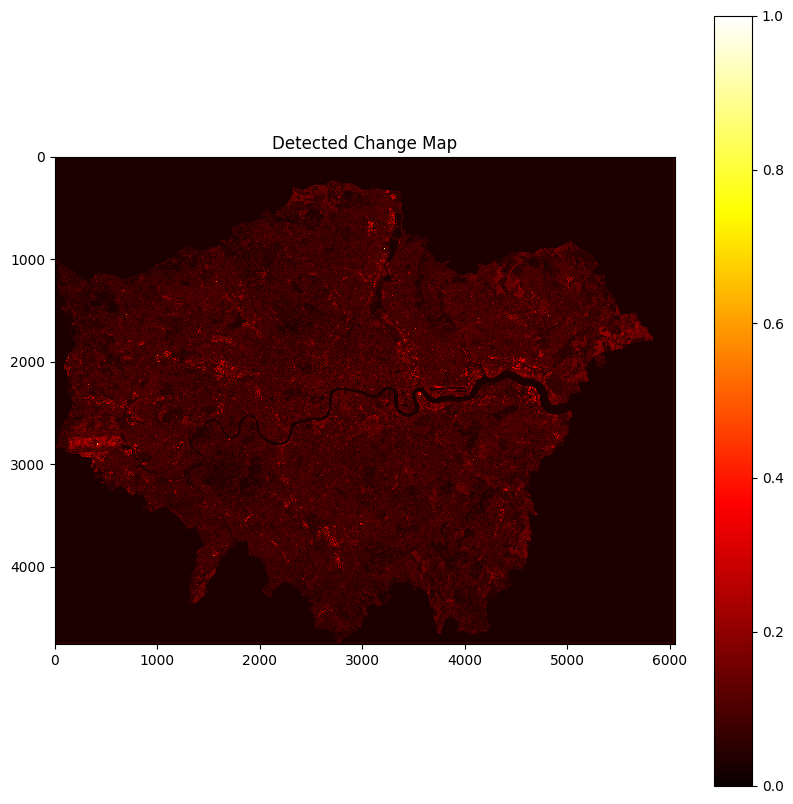

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Model initialization
# model = SiamUnet_diff(input_nbr=1, label_nbr=1).to(device)
# model.load_state_dict(torch.load('siam_unet_diff.pth'))
model.eval()

# Function to generate change map
def generate_change_map(model, im1_patches, im2_patches, patch_size, stride, image_shape):
    model.eval()
    change_patches = []

    with torch.no_grad():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = im1_patch.unsqueeze(0).to(device)  # Add batch dimension
            im2_patch = im2_patch.unsqueeze(0).to(device)  # Add batch dimension
            # output, final_map = model(im1_patch, im2_patch)
            output = model(im1_patch, im2_patch)
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy().squeeze())

    change_patches = np.array(change_patches)
    change_map = reconstruct_image(change_patches, image_shape, patch_size, stride)

    # Normalize the change map to the range [0, 1]
    change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

    return change_map #, final_map

def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

def visualize_change_map(change_map):
    plt.figure(figsize=(10, 10))
    plt.imshow(change_map, cmap='hot', interpolation='nearest')
    plt.colorbar()
    plt.title('Detected Change Map')
    plt.show()

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches])
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches])

# Ensure patches are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.view(-1, 1, patch_size, patch_size)
im2_patches = im2_patches.view(-1, 1, patch_size, patch_size)

# Generate and visualize the change map
# change_map, final_map = generate_change_map(model, im1_patches, im2_patches, patch_size, stride, im1_tensor.shape)
change_map = generate_change_map(model, im1_patches, im2_patches, patch_size, stride, im1_tensor.shape)

if change_map.ndim == 3:
    change_map = np.squeeze(change_map)

visualize_change_map(change_map)


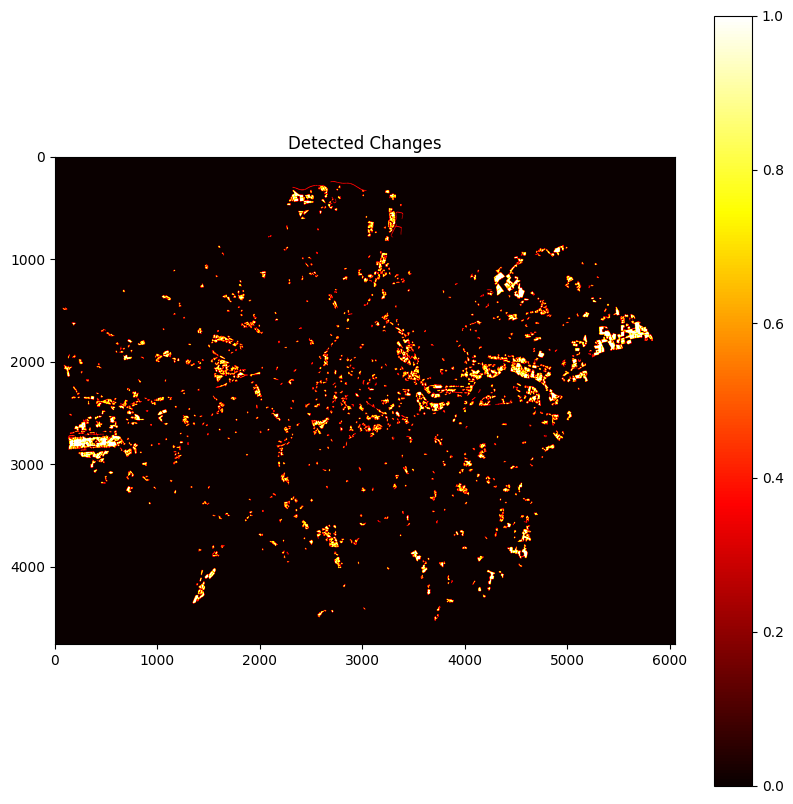

In [ ]:
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=128
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title(f'Detected Changes')
plt.show()

## BiDateNet

https://github.com/granularai/fabric

In [ ]:
# sub-parts of the U-Net model

import torch
import torch.nn as nn
import torch.nn.functional as F


class double_conv(nn.Module):
    '''(conv => BN => ReLU) * 2'''
    def __init__(self, in_ch, out_ch):
        super(double_conv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.conv(x)
        return x


class inconv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(inconv, self).__init__()
        self.conv = double_conv(in_ch, out_ch)

    def forward(self, x):
        x = self.conv(x)
        return x


class down(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(down, self).__init__()
        self.mpconv = nn.Sequential(
            nn.MaxPool2d(2),
            double_conv(in_ch, out_ch)
        )

    def forward(self, x):
        x = self.mpconv(x)
        return x


class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=True):
        super(up, self).__init__()

        #  would be a nice idea if the upsampling could be learned too,
        #  but my machine do not have enough memory to handle all those weights
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch//2, in_ch//2, 2, stride=2)

        self.conv = double_conv(in_ch, out_ch)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        # input is CHW
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, (diffX // 2, diffX - diffX//2, diffY // 2, diffY - diffY//2))

        # for padding issues, see
        # https://github.com/HaiyongJiang/U-Net-Pytorch-Unstructured-Buggy/commit/0e854509c2cea854e247a9c615f175f76fbb2e3a
        # https://github.com/xiaopeng-liao/Pytorch-UNet/commit/8ebac70e633bac59fc22bb5195e513d5832fb3bd

        x = torch.cat([x2, x1], dim=1)
        x = self.conv(x)
        return x


class outconv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(outconv, self).__init__()
        self.conv = nn.Conv2d(in_ch, out_ch, 1)

    def forward(self, x):
        x = self.conv(x)
        return x



#### model
class BiDateNet(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(BiDateNet, self).__init__()
        self.inc = inconv(n_channels, 64)
        self.down1 = down(64, 128)
        self.down2 = down(128, 256)
        self.down3 = down(256, 512)
        self.down4 = down(512, 512)

        self.up1 = up(1024, 256)
        self.up2 = up(512, 128)
        self.up3 = up(256, 64)
        self.up4 = up(128, 64)
        self.outc = outconv(64, n_classes)

    def forward(self, x_d1, x_d2):
        x1_d1 = self.inc(x_d1)
        x2_d1 = self.down1(x1_d1)
        x3_d1 = self.down2(x2_d1)
        x4_d1 = self.down3(x3_d1)
        x5_d1 = self.down4(x4_d1)

        x1_d2 = self.inc(x_d2)
        x2_d2 = self.down1(x1_d2)
        x3_d2 = self.down2(x2_d2)
        x4_d2 = self.down3(x3_d2)
        x5_d2 = self.down4(x4_d2)

        x = self.up1(torch.relu(x5_d2 * x5_d1), torch.relu(x4_d2 * x4_d1))
        x = self.up2(x, torch.relu(x3_d2 * x3_d1))
        x = self.up3(x, torch.relu(x2_d2 * x2_d1))
        x = self.up4(x, torch.relu(x1_d2 * x1_d1))
        x = self.outc(x)
        return x

In [ ]:
from torchvision import transforms

data_transforms = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(90)
])


class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()


# Function to extract patches from the image
def extract_patches(image, patch_size, stride, transform=None):
    patches = []
    _, height, width = image.shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            if transform:
                patch = transform(patch)
            patches.append(patch)
    return patches

# Function to reconstruct image from patches
def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

In [ ]:
import torch
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
# from utils import extract_patches, reconstruct_image, ClearCache  # Assume these utilities are available

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define the model
model = False
model = BiDateNet(n_channels=1, n_classes=1).to(device)

# Define loss and optimizer
criterion = nn.MSELoss()
# criterion = nn.CosineEmbeddingLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(50 + 1))

# Patch size and stride
patch_size = 256
stride = patch_size // 2
batch_size = 8

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)

# Ensure the tensors are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.squeeze(1)
im2_patches = im2_patches.squeeze(1)

dataset = TensorDataset(im1_patches, im2_patches)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)

# Training loop
num_epochs = 1
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    with ClearCache():
      for im1_patch_batch, im2_patch_batch in dataloader:
          im1_patch_batch, im2_patch_batch = im1_patch_batch.to(device), im2_patch_batch.to(device)
          output = model(im1_patch_batch, im2_patch_batch)
          resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
          loss = criterion(resized_output, im1_patch_batch)
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
    scheduler.step()
    print(f'Epoch {epoch + 1}, Loss: {loss.item():.4f}')

# Save the trained model
torch.save(model.state_dict(), 'bdnet.pth')


Epoch 1, Loss: 0.0161


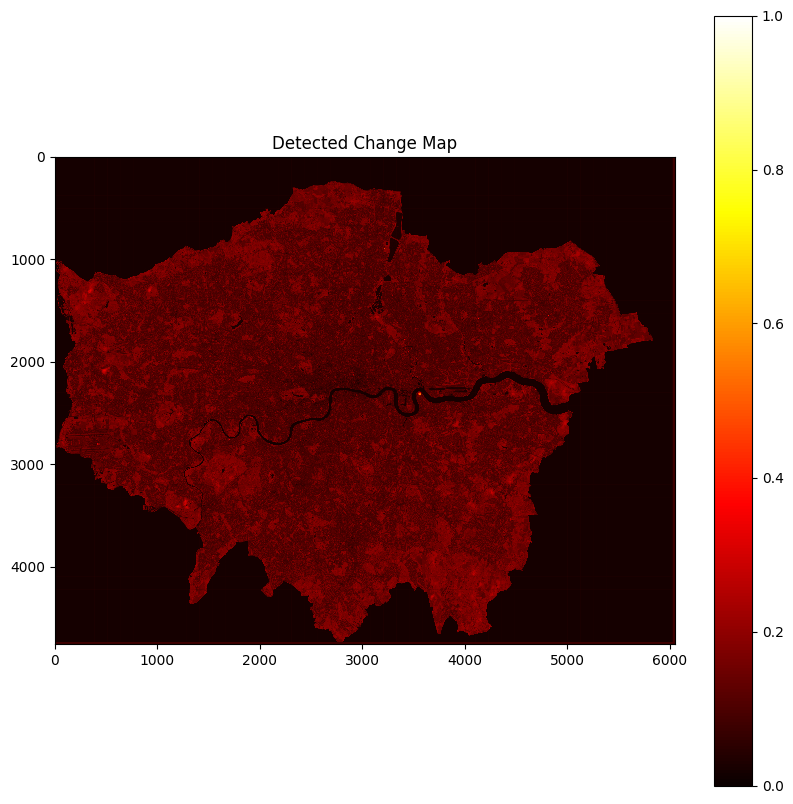

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Model initialization
# model.load_state_dict(torch.load('bdnet.pth'))
model.eval()

# Function to generate change map
def generate_change_map(model, im1_patches, im2_patches, patch_size, stride, image_shape):
    model.eval()
    change_patches = []

    with torch.no_grad():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = im1_patch.unsqueeze(0).to(device)  # Add batch dimension
            im2_patch = im2_patch.unsqueeze(0).to(device)  # Add batch dimension
            output = model(im1_patch, im2_patch)
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy().squeeze())

    change_patches = np.array(change_patches)
    change_map = reconstruct_image(change_patches, image_shape, patch_size, stride)

    # Normalize the change map to the range [0, 1]
    change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

    return change_map

def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

def visualize_change_map(change_map):
    plt.figure(figsize=(10, 10))
    plt.imshow(change_map, cmap='hot', interpolation='nearest')
    plt.colorbar()
    plt.title('Detected Change Map')
    plt.show()

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches])
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches])

# Ensure patches are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.view(-1, 1, patch_size, patch_size)
im2_patches = im2_patches.view(-1, 1, patch_size, patch_size)

# Generate and visualize the change map
change_map = generate_change_map(model, im1_patches, im2_patches, patch_size, stride, im1_tensor.shape)

if change_map.ndim == 3:
    change_map = np.squeeze(change_map)

visualize_change_map(change_map)


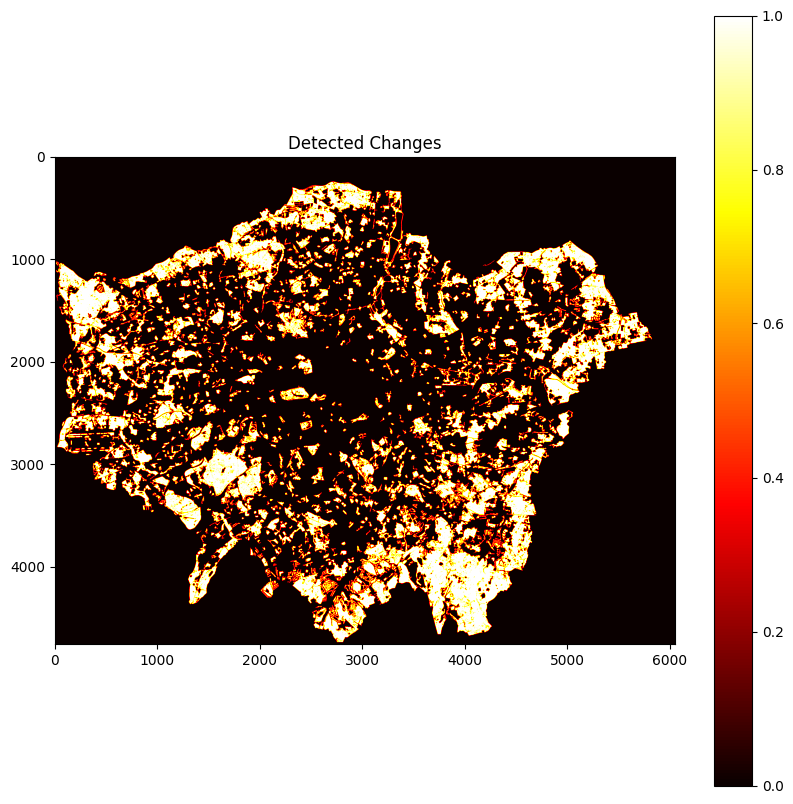

In [ ]:
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=256
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title(f'Detected Changes')
plt.show()

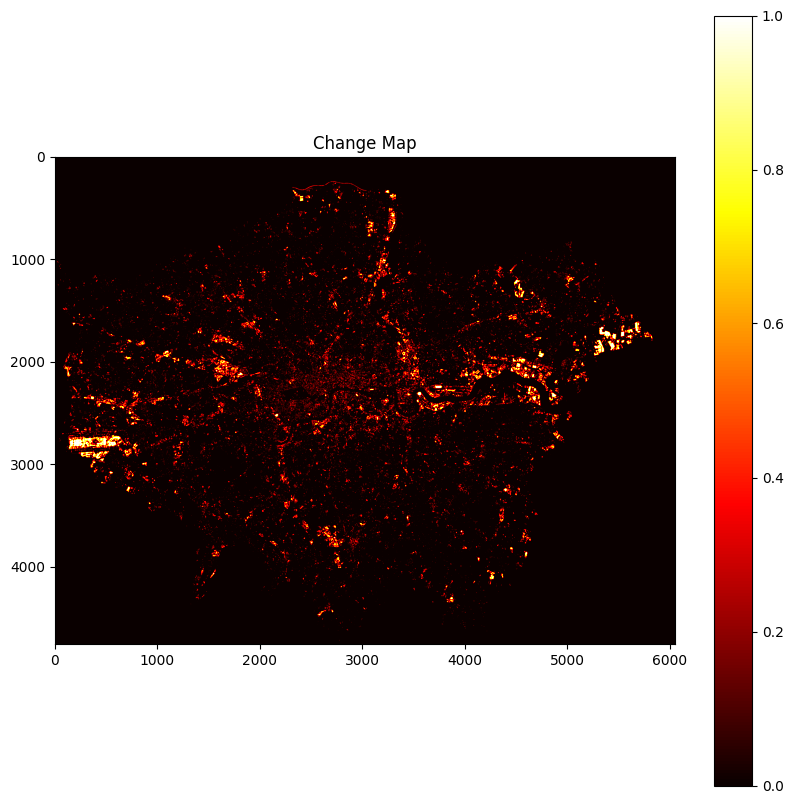

In [ ]:
plt.figure(figsize=(10, 10))
plt.title('Change Map')
plt.imshow(change_map > np.percentile(change_map, 98), cmap='hot')
plt.colorbar()
plt.show()

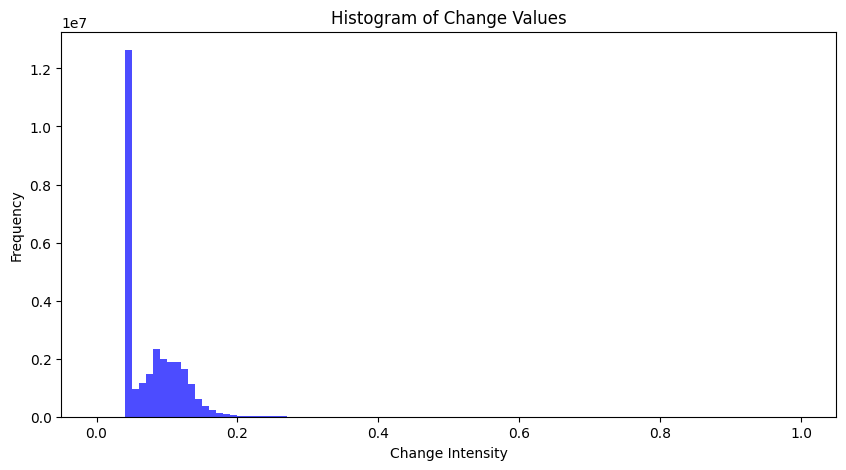

In [ ]:
# Plot histogram of change values
plt.figure(figsize=(10, 5))
plt.hist(change_map.flatten(), bins=100, color='blue', alpha=0.7)
plt.title('Histogram of Change Values')
plt.xlabel('Change Intensity')
plt.ylabel('Frequency')
plt.show()

In [ ]:
import os
import numpy as np
import rasterio

# Calculate the 97.5 percentile
percentile_975 = np.percentile(change_map, 98)

# Create a binary mask for values higher than the 97.5 percentile
binary_mask = (change_map > percentile_975).astype(np.uint8)

# Load metadata from the original image to use in the new TIFF
with rasterio.open(image1_path) as src:
    metadata = src.meta.copy()

# Update metadata to reflect the number of layers and data type
metadata.update(dtype=rasterio.uint8, count=1)

# Save the binary mask to a new TIFF file
model_name = "bdnet"
data_path = "drive/MyDrive/dissertation/"
output_path = os.path.join(data_path, f"change_map_{model_name}.tiff")
with rasterio.open(output_path, 'w', **metadata) as dst:
    dst.write(binary_mask, 1)

print(f"Binary mask saved to {output_path}")


Binary mask saved to drive/MyDrive/dissertation/change_map_bdnet.tiff


In [ ]:
# Define paths and bands to process
model_name = "bdnet"
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
output_dir = f"drive/MyDrive/dissertation/features_{model_name}/"
model_dir = "drive/MyDrive/dissertation/models/"

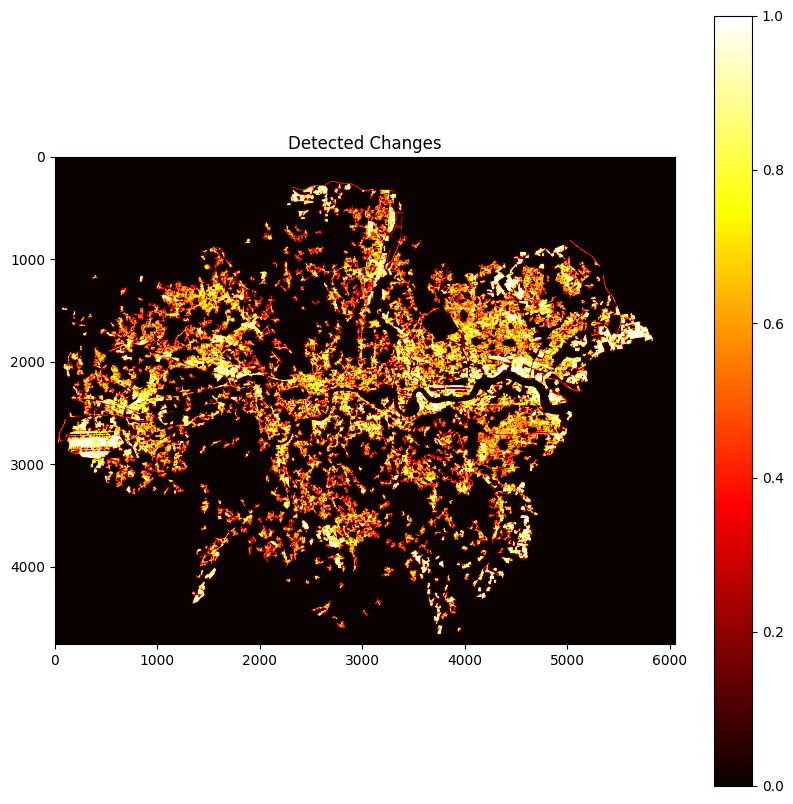

In [ ]:
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=512
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title(f'Detected Changes')
plt.show()


In [ ]:
import os
import torch
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt


# Function to train model for each band and save change maps
def extract_features_for_band(band, im1_tensor, im2_tensor, no_data_mask, model_dir):
    print(f"Extracting features for band {band}")
    # Select the specific band
    im1_band = im1_tensor[:, band-1, :, :].unsqueeze(1).to(device)
    im2_band = im2_tensor[:, band-1, :, :].unsqueeze(1).to(device)

    # Generate pseudo labels using mean-based difference
    pseudo_labels = (im1_band != im2_band).float().mean(dim=1, keepdim=True).to(device)

    # Model initialization
    model = BiDateNet(n_channels=1, n_classes=1).to(device)

    # Define loss and optimizer
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(50 + 1))

    # Patch size and stride
    patch_size = 256
    stride = patch_size // 2

    # Extract patches from input images
    im1_patches = extract_patches(im1_band.squeeze(1), patch_size, stride, data_transforms)
    im2_patches = extract_patches(im2_band.squeeze(1), patch_size, stride, data_transforms)
    # pseudo_label_patches = extract_patches(pseudo_labels.squeeze(1), patch_size, stride)

    # Convert patches to tensor
    im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
    im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)
    # pseudo_label_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in pseudo_label_patches]).to(device)

    # Training loop
    num_epochs = 1
    for epoch in range(num_epochs):
        model.train()
        optimizer.zero_grad()
        for i in range(im1_patches.size(0)):
            output = model(im1_patches[i], im2_patches[i])
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            loss = criterion(resized_output, im1_patches[i])
            loss.backward()
            optimizer.step()
        scheduler.step()
        print(f'Epoch {epoch + 1}, Loss: {loss.item():.4f}')

    # Save the trained model
    model_path = os.path.join(model_dir, f"{model_name}_band_{band}.pth")
    torch.save(model.state_dict(), model_path)

    # Generate change map
    change_patches = []
    model.eval()
    with torch.no_grad():
        for i in range(im1_patches.size(0)):
            output = model(im1_patches[i], im2_patches[i])
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy().squeeze())

    change_patches = np.array(change_patches)
    change_map = reconstruct_image(change_patches, im1_band.shape, patch_size, stride)
    # change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

    if change_map.shape[0] == 1:
        change_map = change_map.squeeze()

    change_map[no_data_mask] = 0

    return change_map


### load data
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
bands = list(range(1, 12))  # Ensure this matches the number of bands in the images
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

print(f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}')

model_name = "bidatenet"
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
output_dir = f"drive/MyDrive/dissertation/features_{model_name}/"
model_dir = "drive/MyDrive/dissertation/models/"

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

all_features = []
for band in bands:
    features = extract_features_for_band(band, im1_tensor, im2_tensor, no_data_mask, model_dir)
    all_features.append(features)
    print(f"Processed band {band} and extracted features.")


Images shape: torch.Size([1, 11, 4754, 6050]), torch.Size([1, 11, 4754, 6050])
Extracting features for band 1
Epoch 1, Loss: 0.1412
Processed band 1 and extracted features.
Extracting features for band 2
Epoch 1, Loss: 0.2206
Processed band 2 and extracted features.
Extracting features for band 3
Epoch 1, Loss: 0.3835
Processed band 3 and extracted features.
Extracting features for band 4
Epoch 1, Loss: 0.1295
Processed band 4 and extracted features.
Extracting features for band 5
Epoch 1, Loss: 0.1126
Processed band 5 and extracted features.
Extracting features for band 6
Epoch 1, Loss: 0.2332
Processed band 6 and extracted features.
Extracting features for band 7
Epoch 1, Loss: 0.5994
Processed band 7 and extracted features.
Extracting features for band 8
Epoch 1, Loss: 4.7432
Processed band 8 and extracted features.
Extracting features for band 9
Epoch 1, Loss: 0.4307
Processed band 9 and extracted features.
Extracting features for band 10
Epoch 1, Loss: 1.0777
Processed band 10 and

In [ ]:
from skimage import filters, morphology
from skimage.measure import label, regionprops

# Apply thresholding strategy
def segment_image(binary_image, min_size=10):
    labeled_image = label(binary_image)
    for region in regionprops(labeled_image):
        if region.area < min_size:  # Remove small regions
            for coordinates in region.coords:
                labeled_image[coordinates[0], coordinates[1]] = 0
    return labeled_image

def apply_thresholding_strategy(
    detected_change_map_normalized,
    strategy='otsu',
    min_size=128,
    otsu_scaling_factor=1.0,
    segment=False,
    segment_min_size=10
    ):
    cd_map = np.zeros(detected_change_map_normalized.shape, dtype=bool)

    if strategy == 'adaptive':
        for sigma in range(101, 202, 50):
            adaptive_threshold = 2 * filters.gaussian(detected_change_map_normalized, sigma)
            cd_map_temp = detected_change_map_normalized > adaptive_threshold
            cd_map_temp = morphology.remove_small_objects(cd_map_temp, min_size=min_size)
            cd_map = cd_map | cd_map_temp

    elif strategy == 'otsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'multiotsu':
        otsu_threshold = filters.threshold_multiotsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > otsu_threshold[1]
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    elif strategy == 'scaledOtsu':
        otsu_threshold = filters.threshold_otsu(detected_change_map_normalized)
        cd_map = detected_change_map_normalized > (otsu_scaling_factor * otsu_threshold)
        cd_map = morphology.remove_small_objects(cd_map, min_size=min_size)

    else:
        raise ValueError('Unknown thresholding strategy')

    if segment:
        cd_map = segment_image(cd_map, segment_min_size)

    return cd_map

In [ ]:
# normalized_change_maps = [
#     (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))
#     for change_map in all_features
#     ]


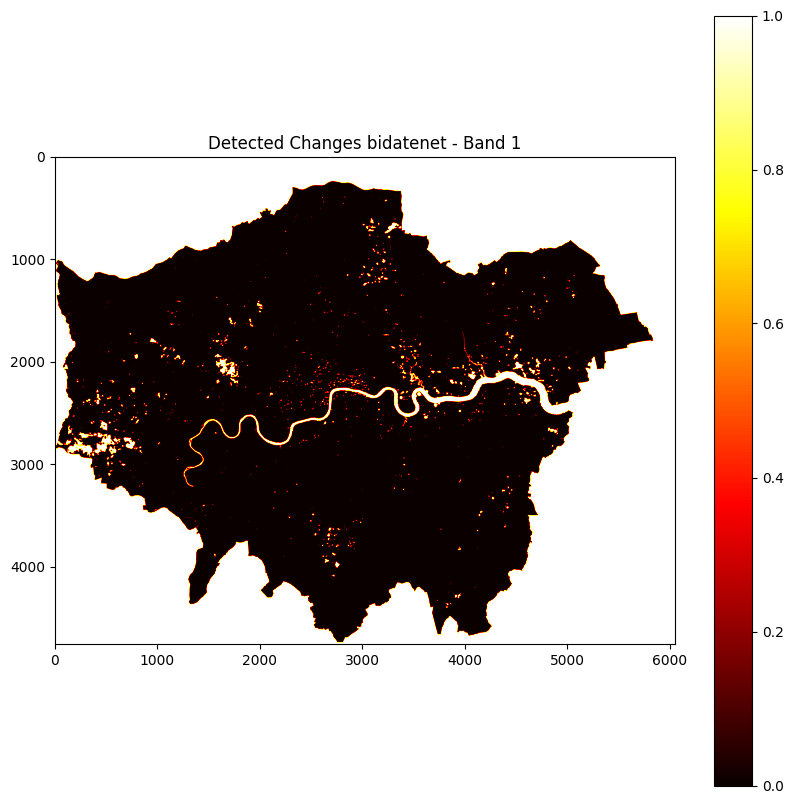

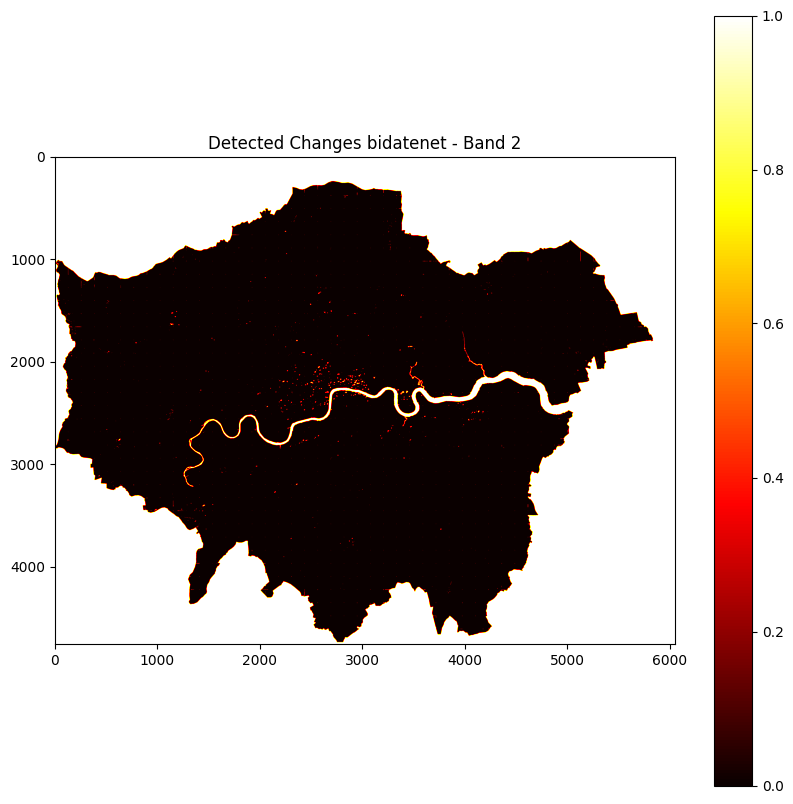

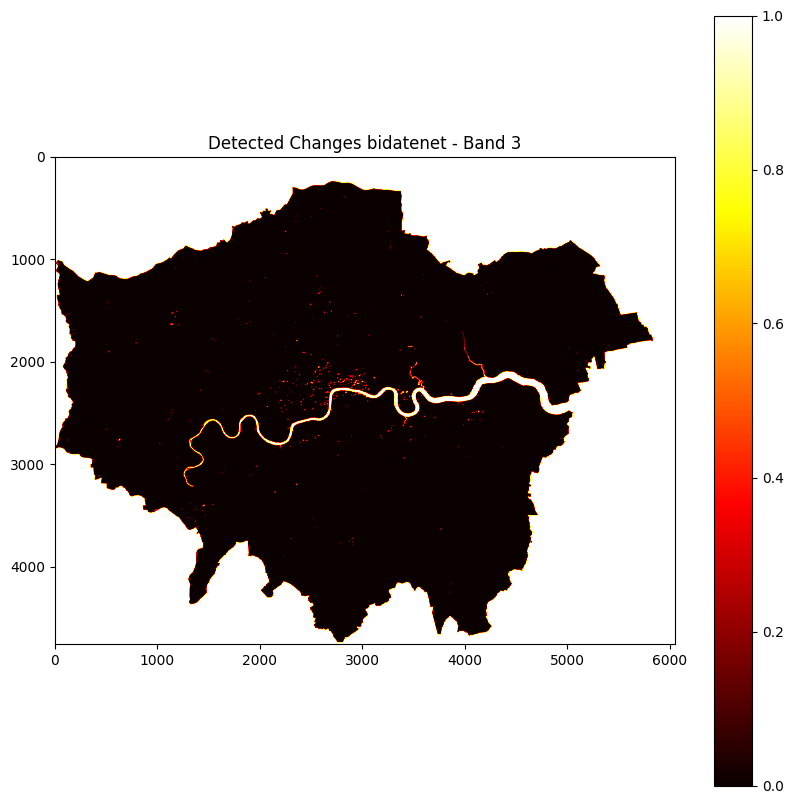

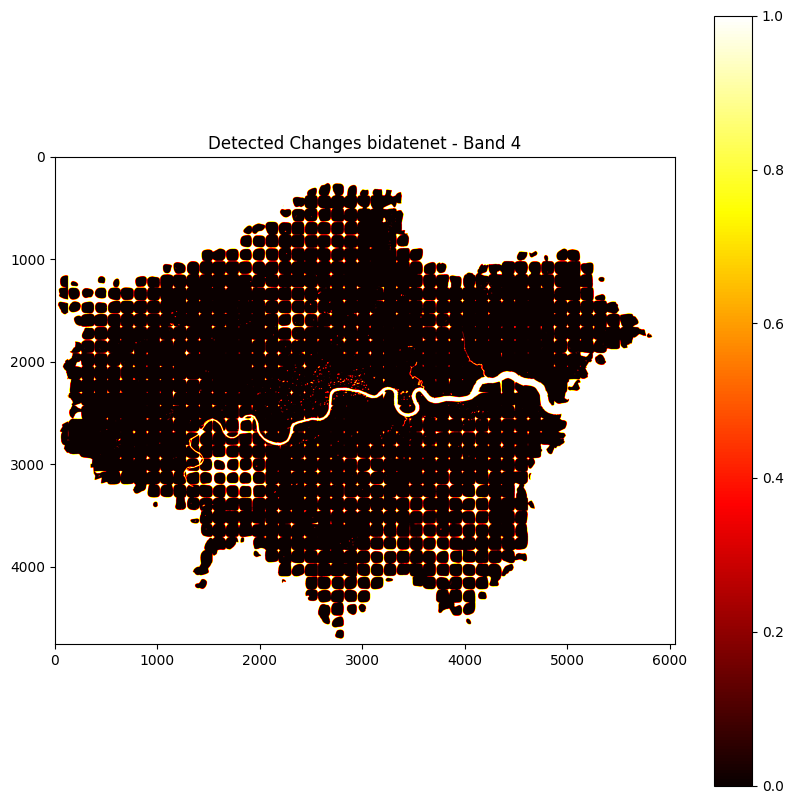

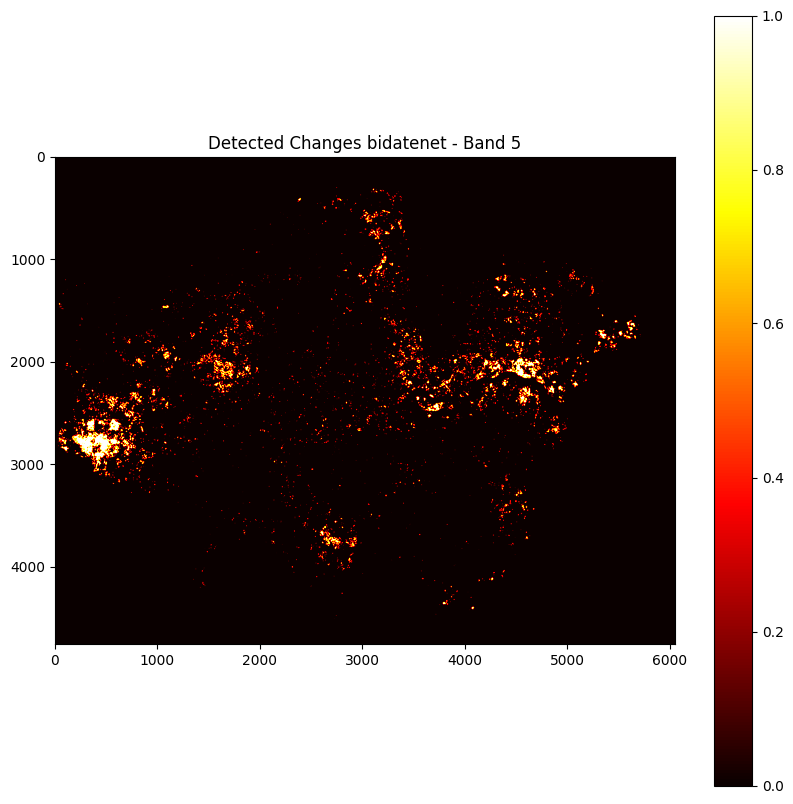

...

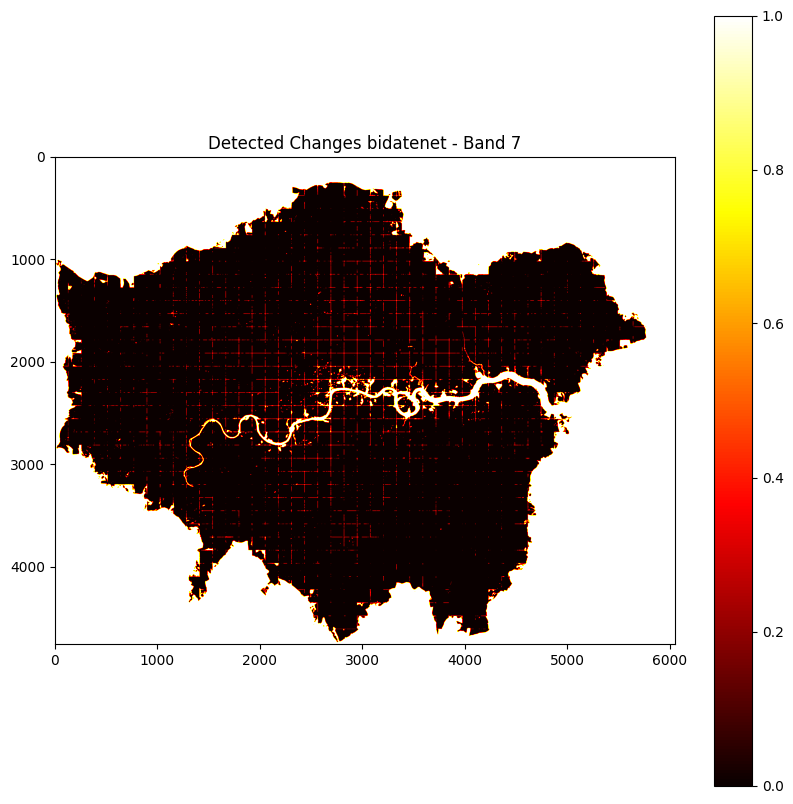

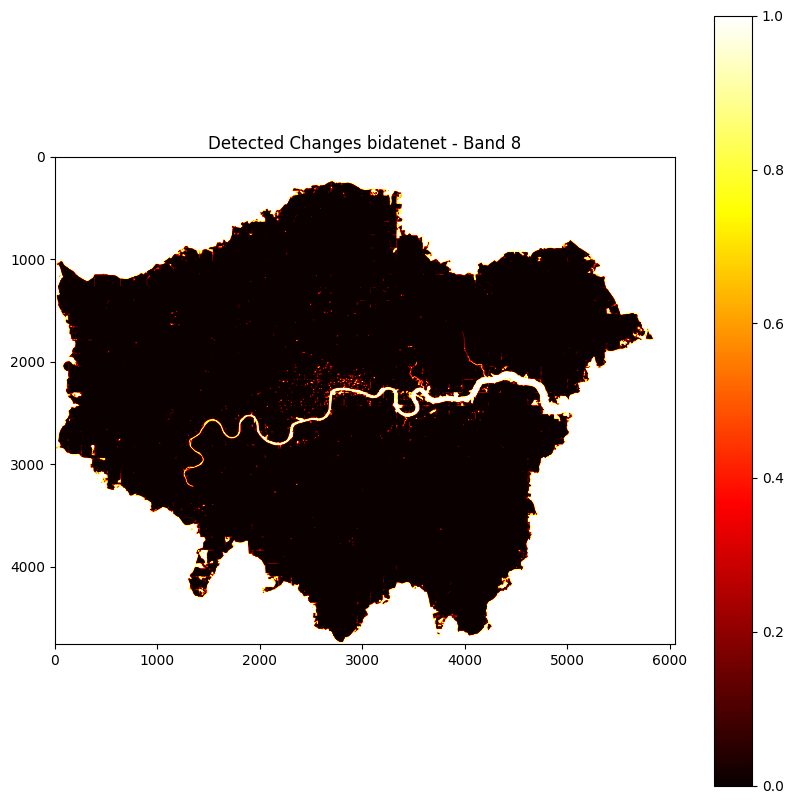

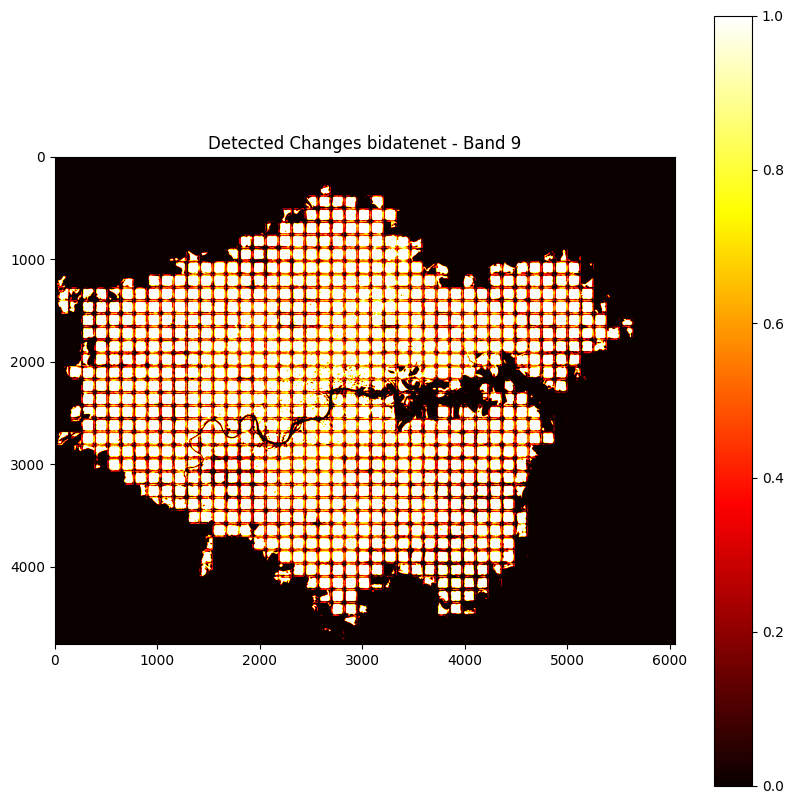

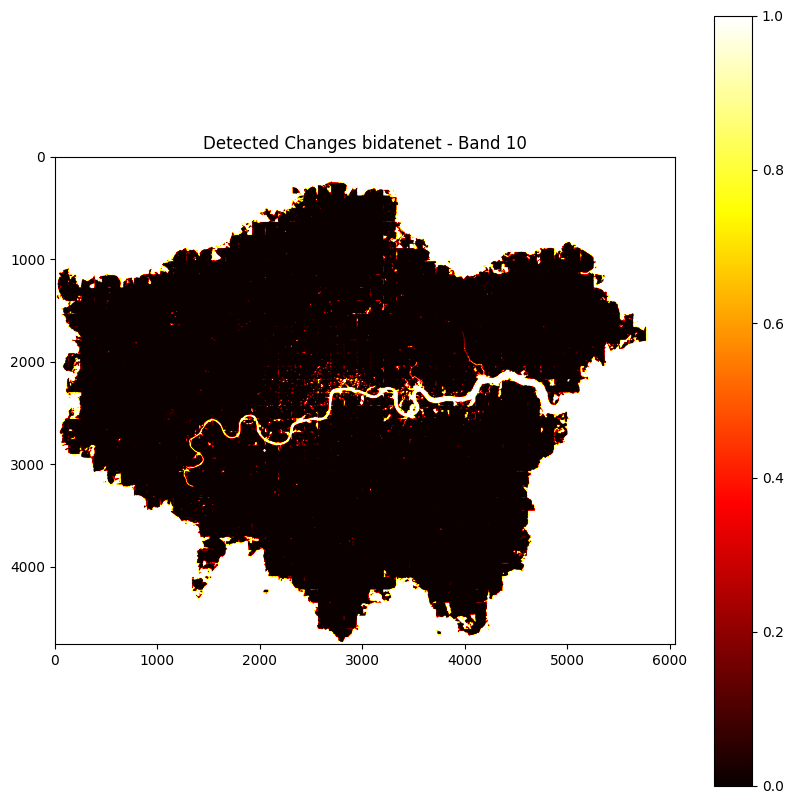

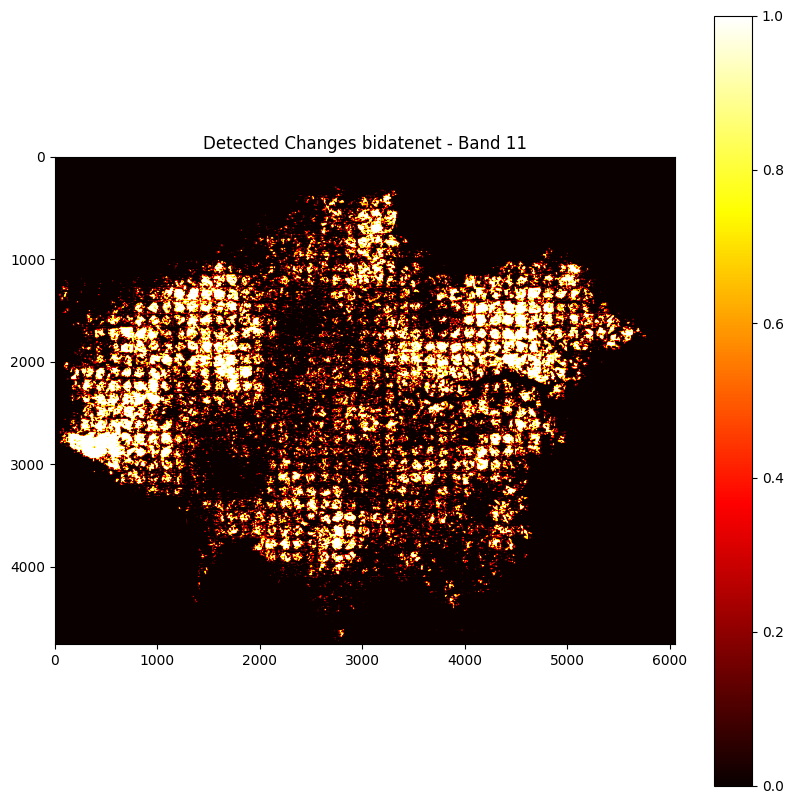

In [ ]:
# Apply thresholding strategy (example: Otsu or multiotsu)
thresholded_maps = []
for band, change_map in enumerate(all_features, start=1):
    cd_map = apply_thresholding_strategy(change_map, strategy='multiotsu', min_size=2)
    thresholded_maps.append(cd_map)

    plt.figure(figsize=(10, 10))
    plt.imshow(cd_map, cmap='hot')
    plt.colorbar()
    plt.title(f'Detected Changes bidatenet - Band {band}')
    plt.show()

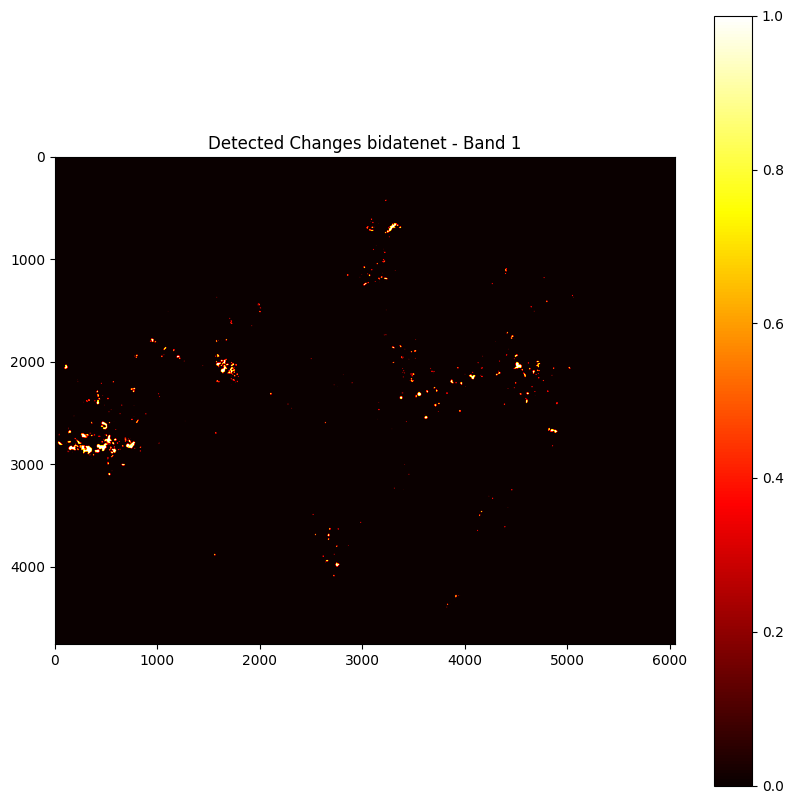

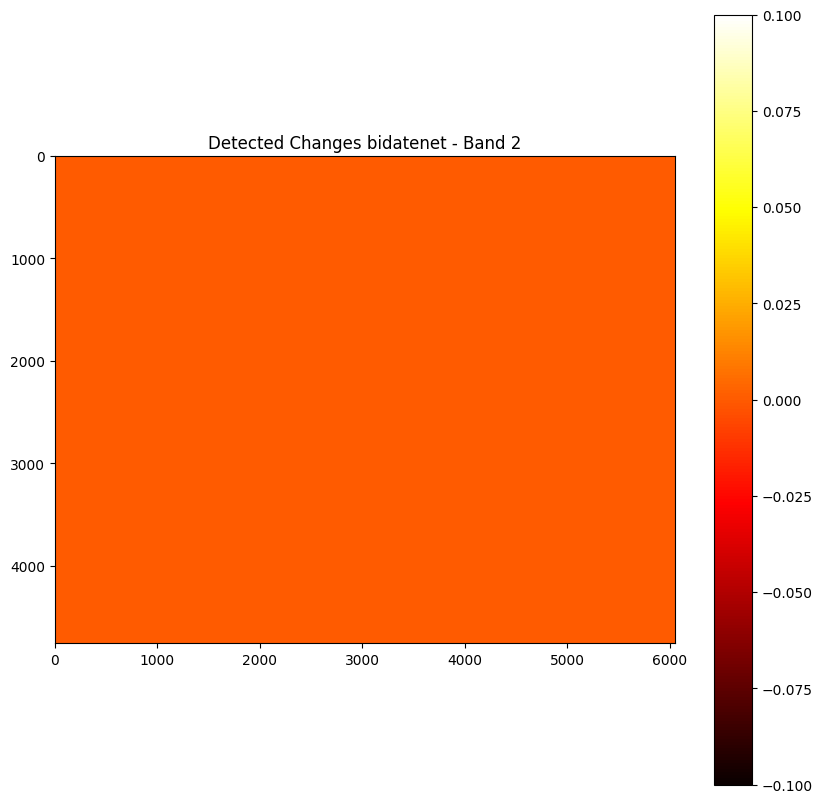

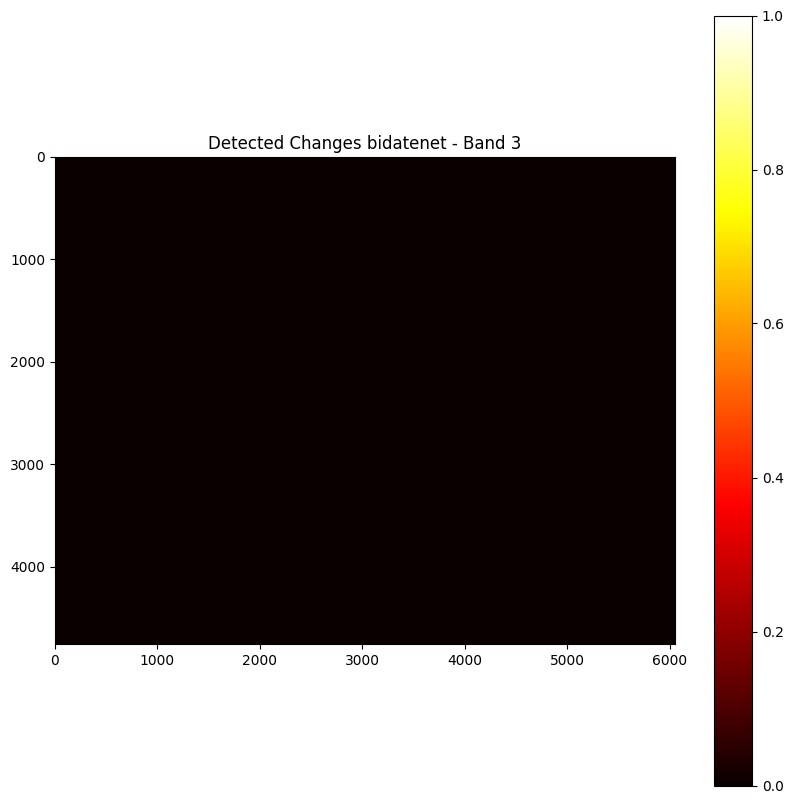

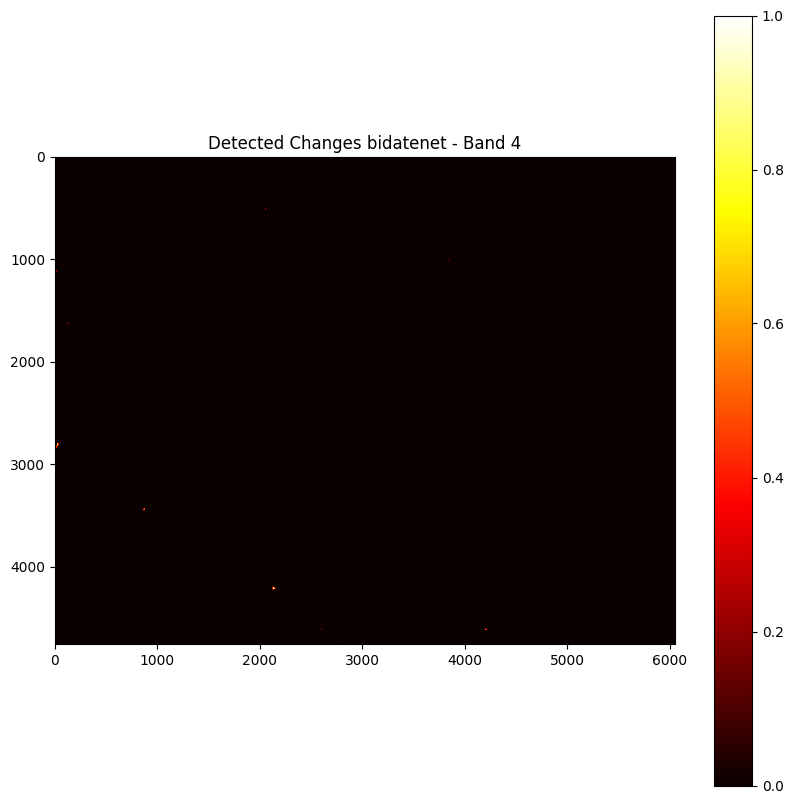

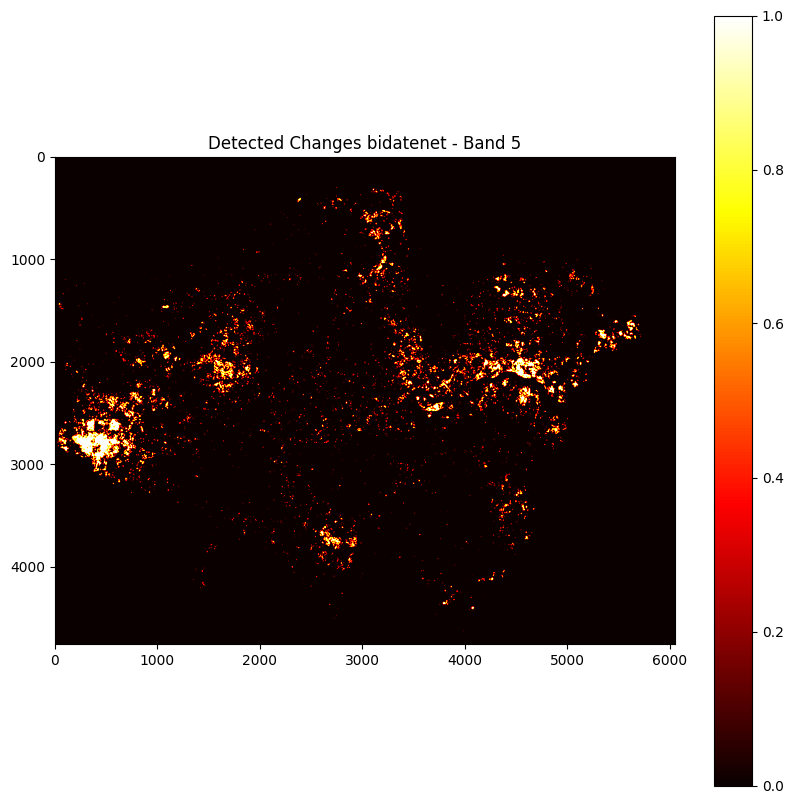

...

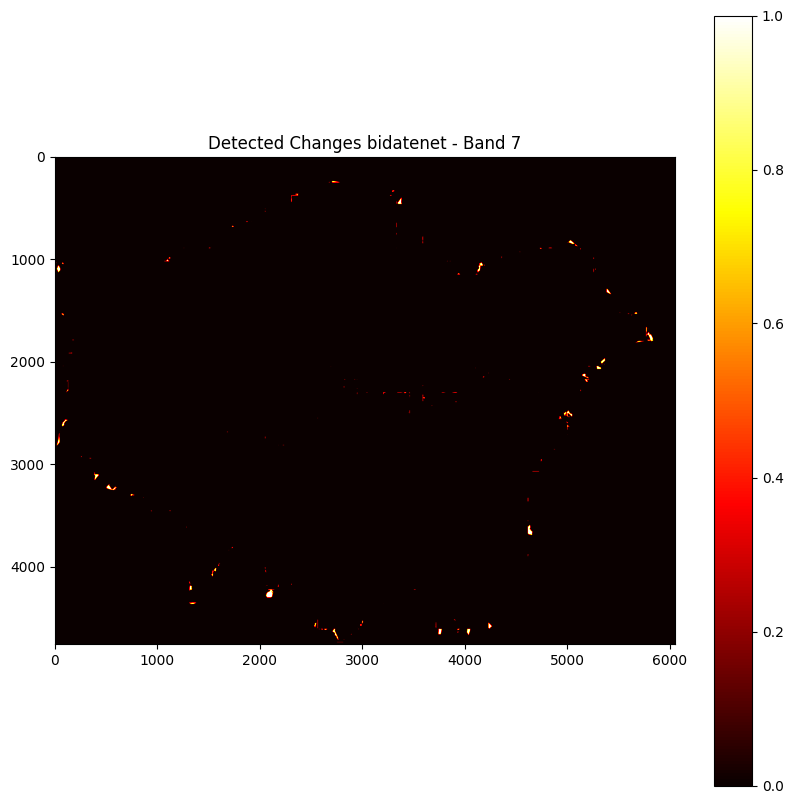

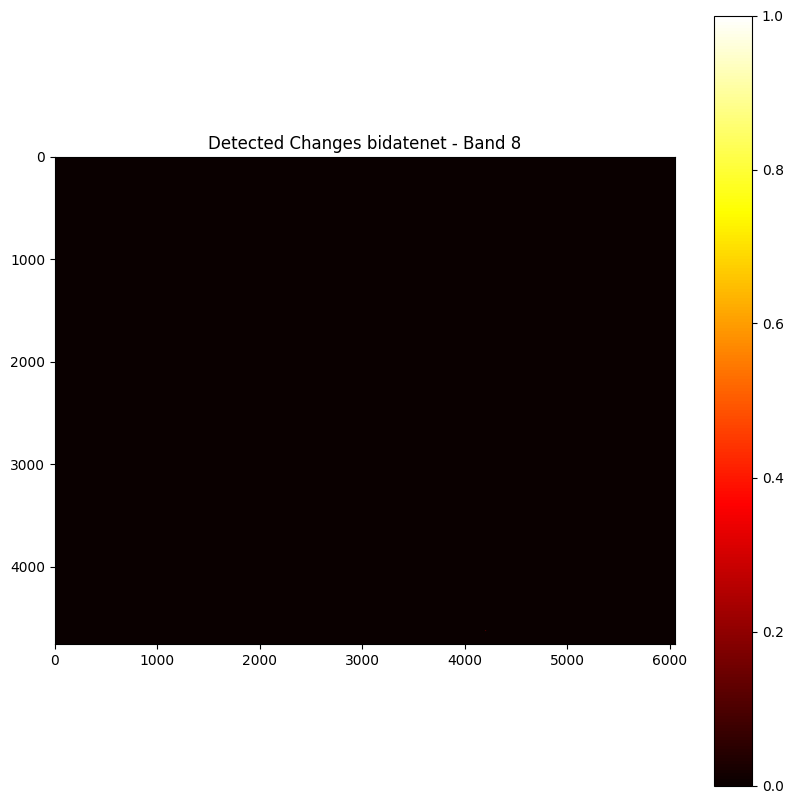

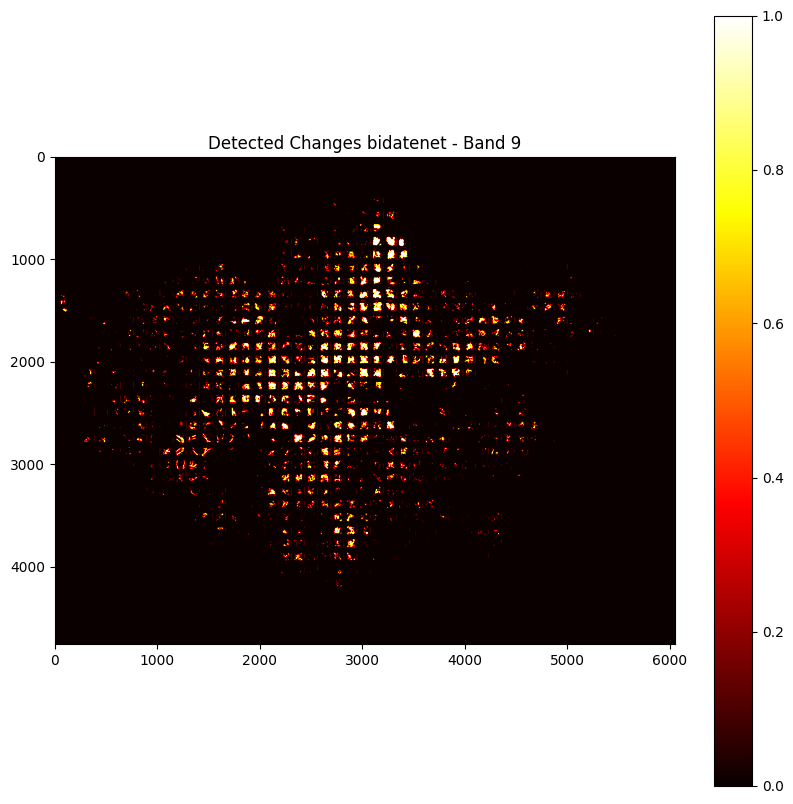

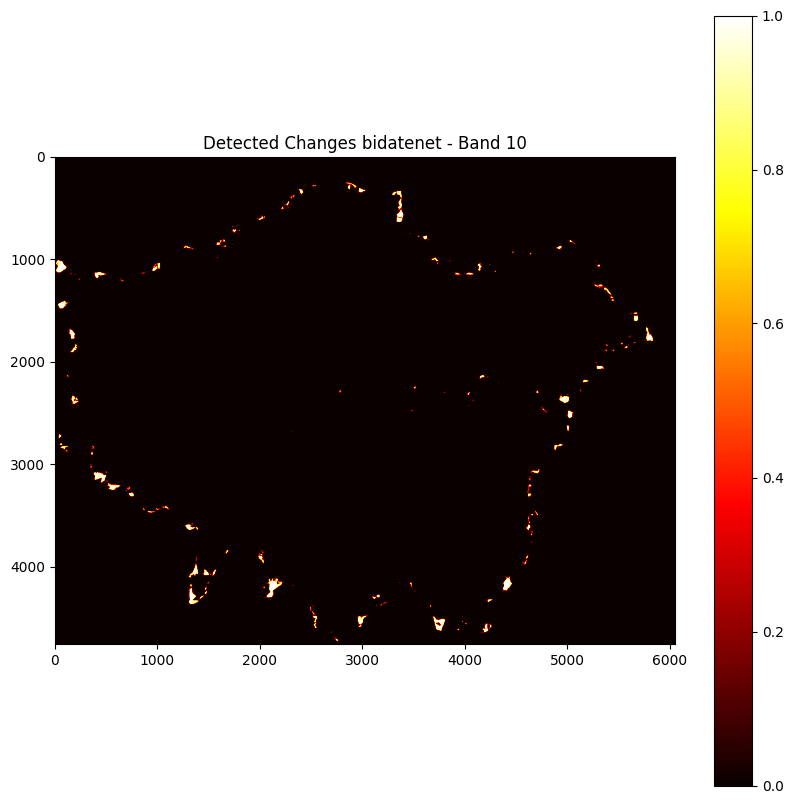

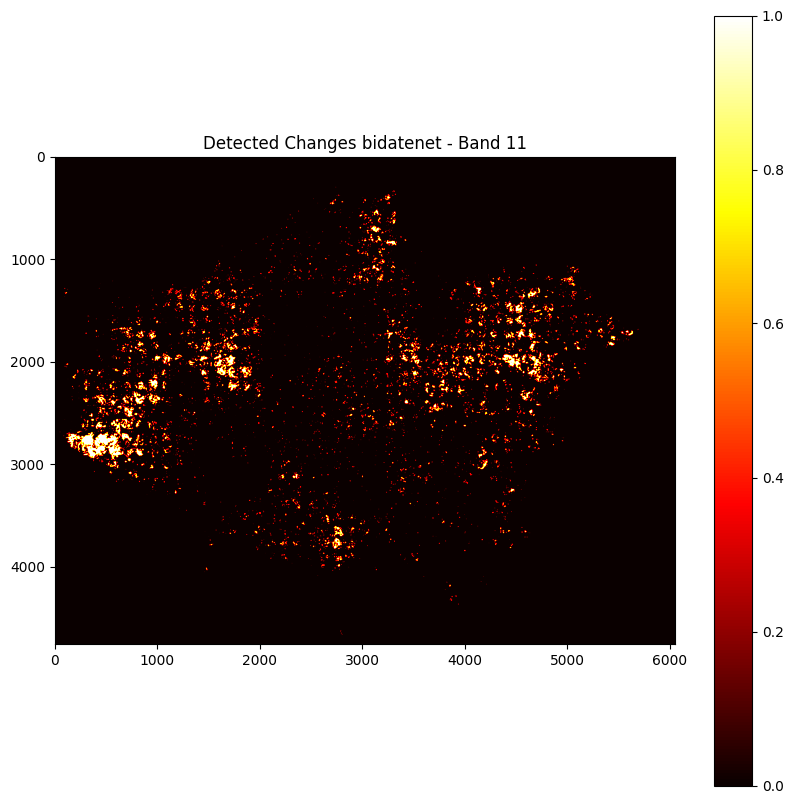

In [ ]:
# Apply thresholding strategy (example: Otsu or multiotsu)
percentile_maps = []
for band, change_map in enumerate(all_features, start=1):
    temp = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))
    percentile_thresh = np.percentile(temp, 98)
    cd_map = (temp > percentile_thresh).astype(np.uint8)
    percentile_maps.append(cd_map)

    plt.figure(figsize=(10, 10))
    plt.imshow(cd_map, cmap='hot')
    plt.colorbar()
    plt.title(f'Detected Changes bidatenet - Band {band}')
    plt.show()

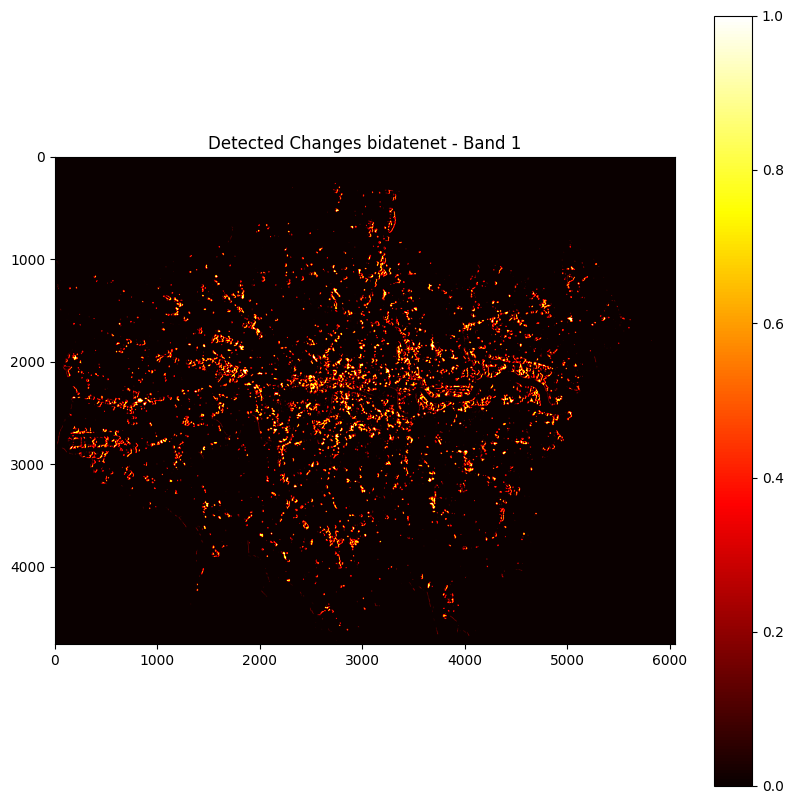

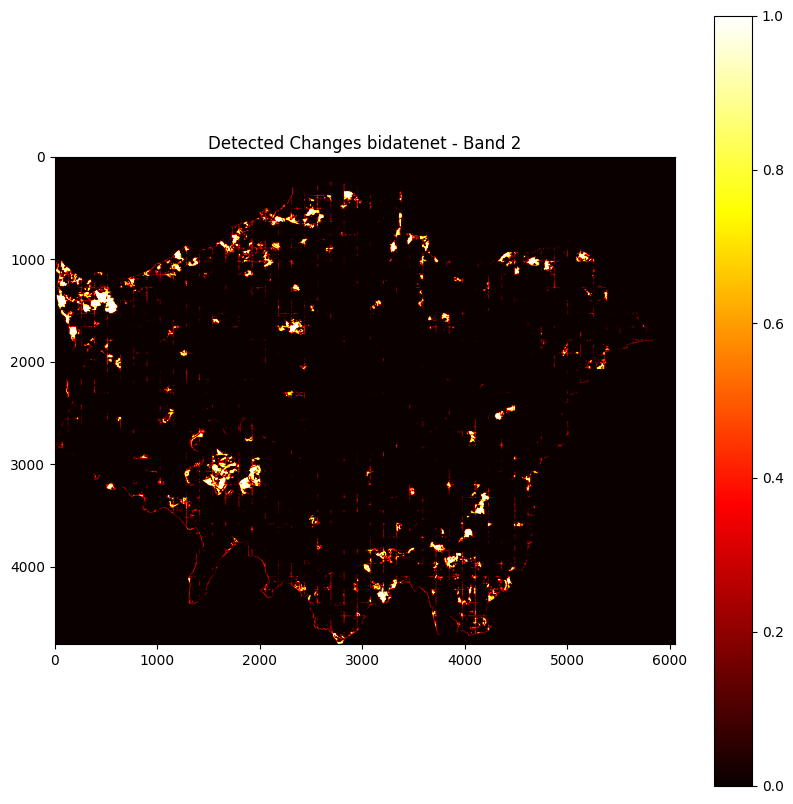

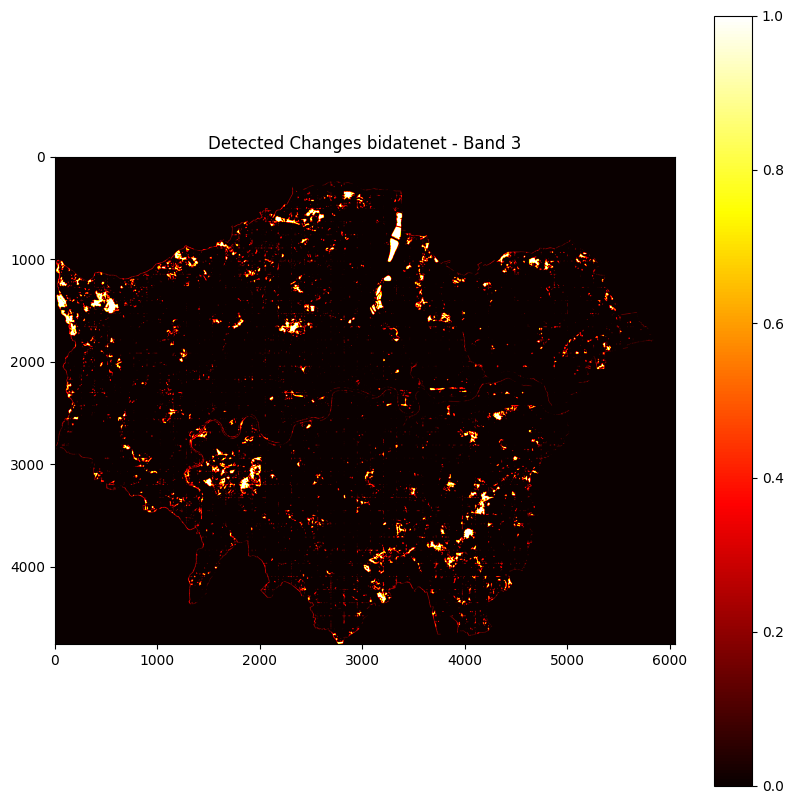

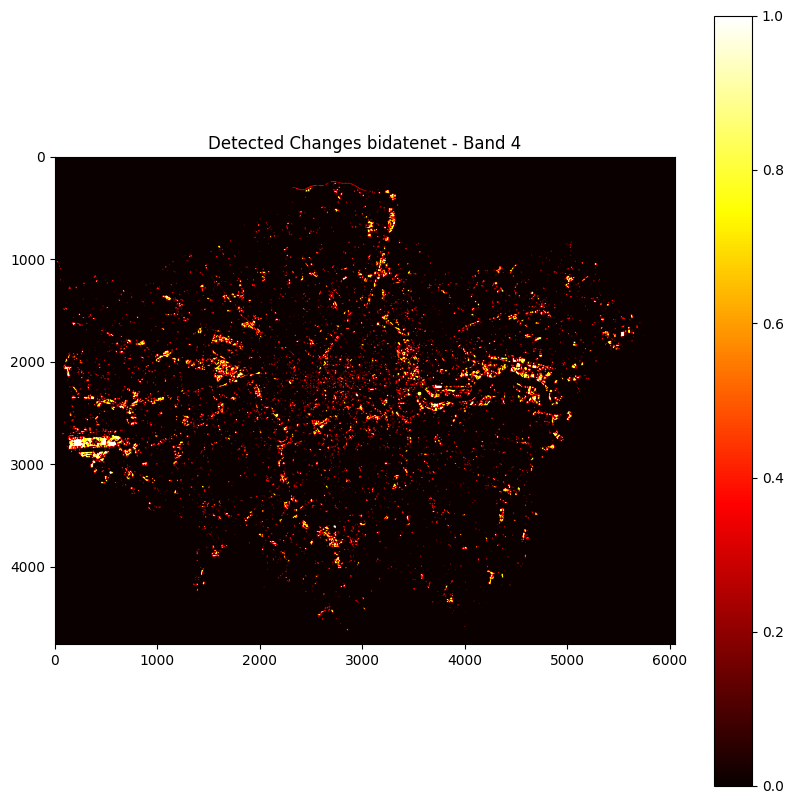

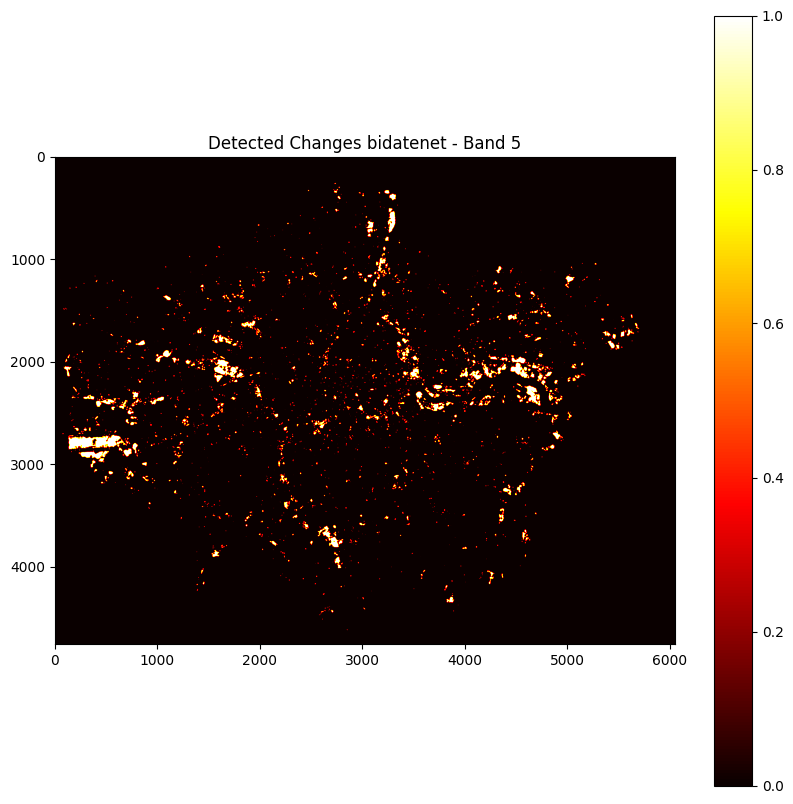

...

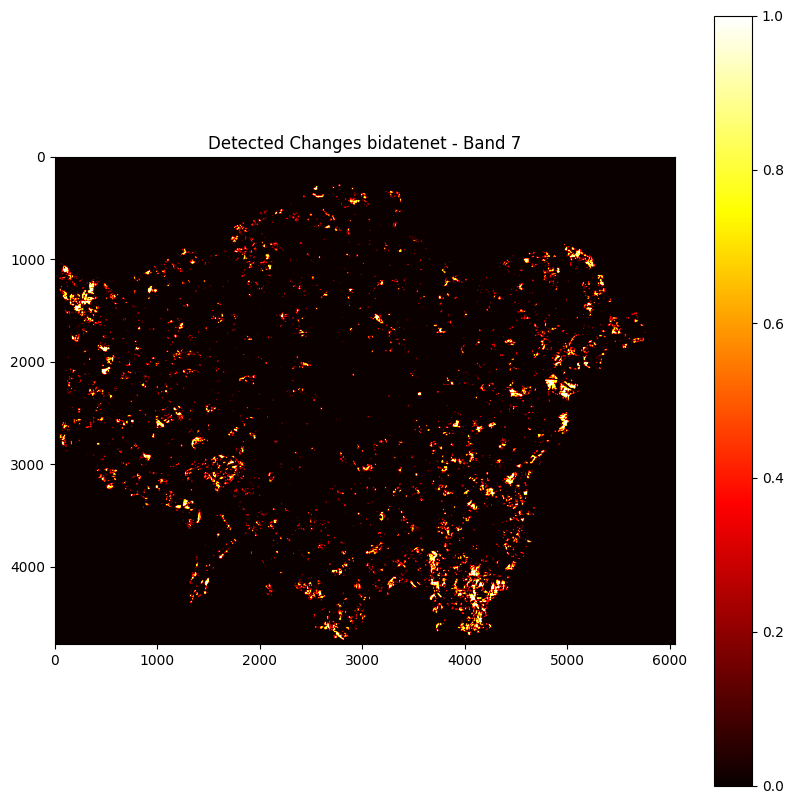

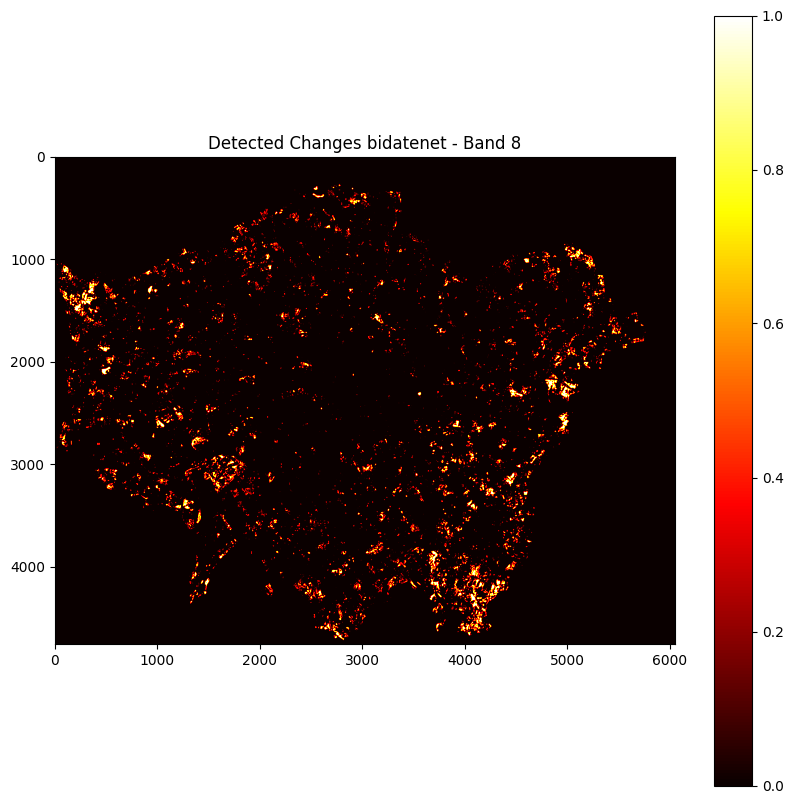

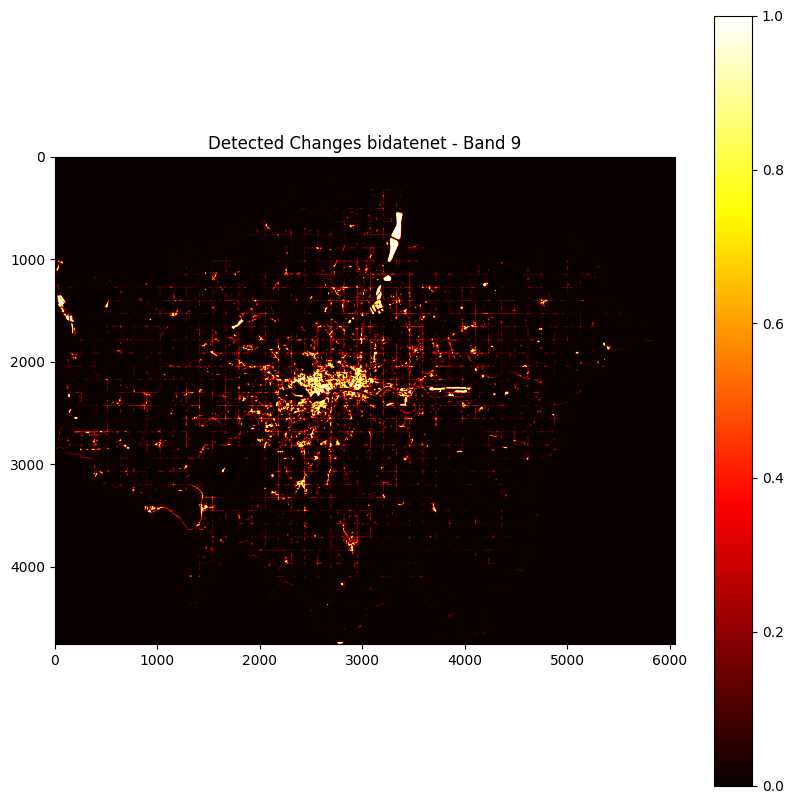

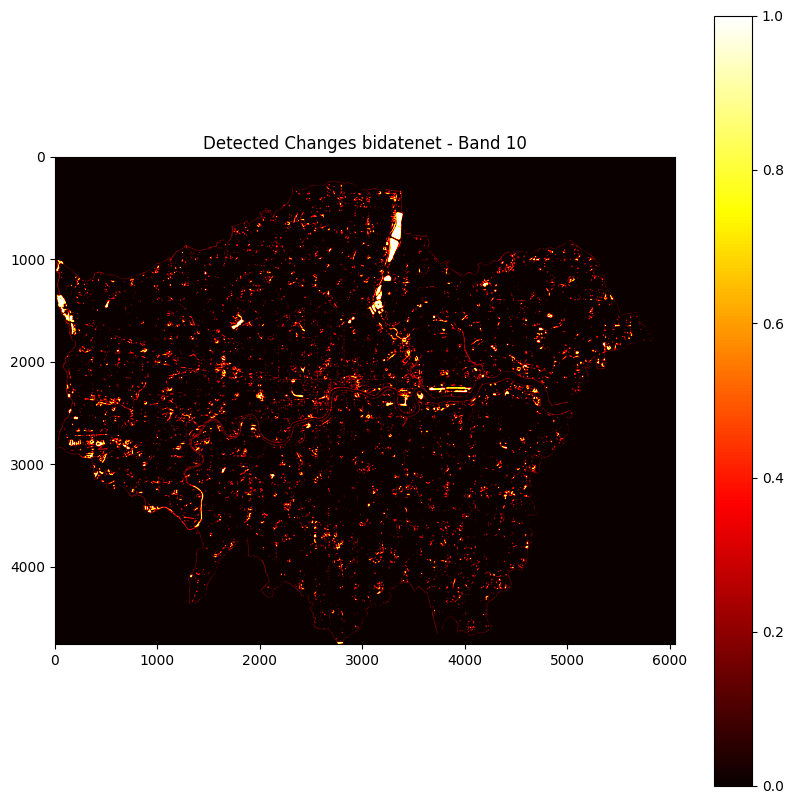

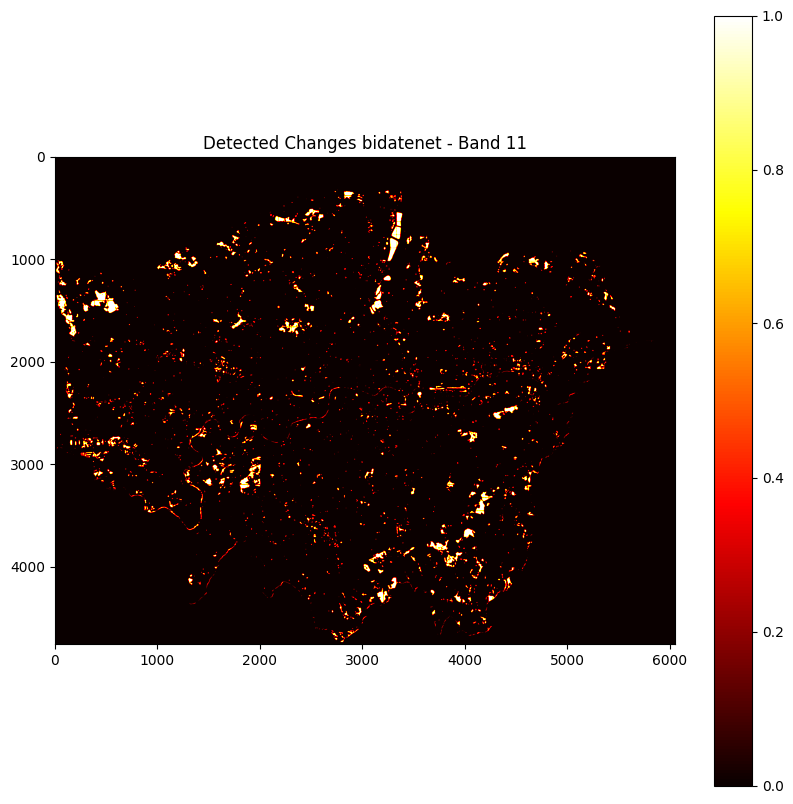

In [ ]:
for band, change_map in enumerate(all_features, start=1):

  perc = True
  if perc:
    percentile_thresh = np.percentile(change_map, 98)
    cd_map = (change_map > percentile_thresh).astype(np.uint8)

  otsu = False
  if otsu:
    cd_map = apply_thresholding_strategy(
        change_map,
        strategy='multiotsu',
        min_size=2
    )

  plt.figure(figsize=(10, 10))
  plt.imshow(cd_map, cmap='hot')
  plt.colorbar()
  plt.title(f'Detected Changes {model_name} - Band {band}')
  plt.show()


In [ ]:
import os
import rasterio
import numpy as np

def save_features(change_maps, model_name, image_path, output_dir):
    # Load metadata from the original image to use in the new TIFF
    with rasterio.open(image_path) as src:
        metadata = src.meta.copy()

    # Update metadata to reflect the number of layers and data type
    metadata.update(dtype=rasterio.uint8, count=1)

    for band, change_map in enumerate(change_maps, start=1):
        # Apply thresholding if needed
        change_map = apply_thresholding_strategy(
            change_map,
            strategy='multiotsu',
            min_size=2
        )

        change_map = change_map.astype(np.uint8)

        output_path = os.path.join(output_dir, f"features_band_{band}_{model_name}.tiff")
        with rasterio.open(output_path, 'w', **metadata) as dst:
            dst.write(change_map, 1)

        print(f"Change map features for band {band} saved to {output_path}")


# Define paths and bands to process
model_name = "bidatenet"
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
output_dir = f"drive/MyDrive/dissertation/features_{model_name}/"
model_dir = "drive/MyDrive/dissertation/models/"
bands = list(range(1, 12))

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

# Loop through each band and train the model
save_features(all_features, model_name, image2_path, output_dir)


Change map features for band 1 saved to drive/MyDrive/dissertation/features_bidatenet/features_band_1_bidatenet.tiff
Change map features for band 2 saved to drive/MyDrive/dissertation/features_bidatenet/features_band_2_bidatenet.tiff
Change map features for band 3 saved to drive/MyDrive/dissertation/features_bidatenet/features_band_3_bidatenet.tiff
Change map features for band 4 saved to drive/MyDrive/dissertation/features_bidatenet/features_band_4_bidatenet.tiff
Change map features for band 5 saved to drive/MyDrive/dissertation/features_bidatenet/features_band_5_bidatenet.tiff
Change map features for band 6 saved to drive/MyDrive/dissertation/features_bidatenet/features_band_6_bidatenet.tiff
Change map features for band 7 saved to drive/MyDrive/dissertation/features_bidatenet/features_band_7_bidatenet.tiff
Change map features for band 8 saved to drive/MyDrive/dissertation/features_bidatenet/features_band_8_bidatenet.tiff
Change map features for band 9 saved to drive/MyDrive/dissertati

## UnetSiamDiff

In [ ]:
# Rodrigo Caye Daudt
# https://rcdaudt.github.io/
# Daudt, R. C., Le Saux, B., & Boulch, A. "Fully convolutional siamese networks for change detection". In 2018 25th IEEE International Conference on Image Processing (ICIP) (pp. 4063-4067). IEEE.

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn.modules.padding import ReplicationPad2d

class SiamUnet_diff(nn.Module):
    """SiamUnet_diff segmentation network."""

    def __init__(self, input_nbr, label_nbr):
        super(SiamUnet_diff, self).__init__()

        self.input_nbr = input_nbr

        self.conv11 = nn.Conv2d(input_nbr, 16, kernel_size=3, padding=1)
        self.bn11 = nn.BatchNorm2d(16)
        self.do11 = nn.Dropout2d(p=0.2)
        self.conv12 = nn.Conv2d(16, 16, kernel_size=3, padding=1)
        self.bn12 = nn.BatchNorm2d(16)
        self.do12 = nn.Dropout2d(p=0.2)

        self.conv21 = nn.Conv2d(16, 32, kernel_size=3, padding=1)
        self.bn21 = nn.BatchNorm2d(32)
        self.do21 = nn.Dropout2d(p=0.2)
        self.conv22 = nn.Conv2d(32, 32, kernel_size=3, padding=1)
        self.bn22 = nn.BatchNorm2d(32)
        self.do22 = nn.Dropout2d(p=0.2)

        self.conv31 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.bn31 = nn.BatchNorm2d(64)
        self.do31 = nn.Dropout2d(p=0.2)
        self.conv32 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn32 = nn.BatchNorm2d(64)
        self.do32 = nn.Dropout2d(p=0.2)
        self.conv33 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn33 = nn.BatchNorm2d(64)
        self.do33 = nn.Dropout2d(p=0.2)

        self.conv41 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.bn41 = nn.BatchNorm2d(128)
        self.do41 = nn.Dropout2d(p=0.2)
        self.conv42 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn42 = nn.BatchNorm2d(128)
        self.do42 = nn.Dropout2d(p=0.2)
        self.conv43 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn43 = nn.BatchNorm2d(128)
        self.do43 = nn.Dropout2d(p=0.2)

        self.upconv4 = nn.ConvTranspose2d(128, 128, kernel_size=3, padding=1, stride=2, output_padding=1)

        self.conv43d = nn.ConvTranspose2d(256, 128, kernel_size=3, padding=1)
        self.bn43d = nn.BatchNorm2d(128)
        self.do43d = nn.Dropout2d(p=0.2)
        self.conv42d = nn.ConvTranspose2d(128, 128, kernel_size=3, padding=1)
        self.bn42d = nn.BatchNorm2d(128)
        self.do42d = nn.Dropout2d(p=0.2)
        self.conv41d = nn.ConvTranspose2d(128, 64, kernel_size=3, padding=1)
        self.bn41d = nn.BatchNorm2d(64)
        self.do41d = nn.Dropout2d(p=0.2)

        self.upconv3 = nn.ConvTranspose2d(64, 64, kernel_size=3, padding=1, stride=2, output_padding=1)

        self.conv33d = nn.ConvTranspose2d(128, 64, kernel_size=3, padding=1)
        self.bn33d = nn.BatchNorm2d(64)
        self.do33d = nn.Dropout2d(p=0.2)
        self.conv32d = nn.ConvTranspose2d(64, 64, kernel_size=3, padding=1)
        self.bn32d = nn.BatchNorm2d(64)
        self.do32d = nn.Dropout2d(p=0.2)
        self.conv31d = nn.ConvTranspose2d(64, 32, kernel_size=3, padding=1)
        self.bn31d = nn.BatchNorm2d(32)
        self.do31d = nn.Dropout2d(p=0.2)

        self.upconv2 = nn.ConvTranspose2d(32, 32, kernel_size=3, padding=1, stride=2, output_padding=1)

        self.conv22d = nn.ConvTranspose2d(64, 32, kernel_size=3, padding=1)
        self.bn22d = nn.BatchNorm2d(32)
        self.do22d = nn.Dropout2d(p=0.2)
        self.conv21d = nn.ConvTranspose2d(32, 16, kernel_size=3, padding=1)
        self.bn21d = nn.BatchNorm2d(16)
        self.do21d = nn.Dropout2d(p=0.2)

        self.upconv1 = nn.ConvTranspose2d(16, 16, kernel_size=3, padding=1, stride=2, output_padding=1)

        self.conv12d = nn.ConvTranspose2d(32, 16, kernel_size=3, padding=1)
        self.bn12d = nn.BatchNorm2d(16)
        self.do12d = nn.Dropout2d(p=0.2)
        self.conv11d = nn.ConvTranspose2d(16, label_nbr, kernel_size=3, padding=1)

        # self.sm = nn.LogSoftmax(dim=1)
        self.sm = nn.Sigmoid()

    def forward(self, x1, x2):


        """Forward method."""
        # Stage 1
        x11 = self.do11(F.relu(self.bn11(self.conv11(x1))))
        x12_1 = self.do12(F.relu(self.bn12(self.conv12(x11))))
        x1p = F.max_pool2d(x12_1, kernel_size=2, stride=2)


        # Stage 2
        x21 = self.do21(F.relu(self.bn21(self.conv21(x1p))))
        x22_1 = self.do22(F.relu(self.bn22(self.conv22(x21))))
        x2p = F.max_pool2d(x22_1, kernel_size=2, stride=2)

        # Stage 3
        x31 = self.do31(F.relu(self.bn31(self.conv31(x2p))))
        x32 = self.do32(F.relu(self.bn32(self.conv32(x31))))
        x33_1 = self.do33(F.relu(self.bn33(self.conv33(x32))))
        x3p = F.max_pool2d(x33_1, kernel_size=2, stride=2)

        # Stage 4
        x41 = self.do41(F.relu(self.bn41(self.conv41(x3p))))
        x42 = self.do42(F.relu(self.bn42(self.conv42(x41))))
        x43_1 = self.do43(F.relu(self.bn43(self.conv43(x42))))
        x4p = F.max_pool2d(x43_1, kernel_size=2, stride=2)

        ####################################################
        # Stage 1
        x11 = self.do11(F.relu(self.bn11(self.conv11(x2))))
        x12_2 = self.do12(F.relu(self.bn12(self.conv12(x11))))
        x1p = F.max_pool2d(x12_2, kernel_size=2, stride=2)


        # Stage 2
        x21 = self.do21(F.relu(self.bn21(self.conv21(x1p))))
        x22_2 = self.do22(F.relu(self.bn22(self.conv22(x21))))
        x2p = F.max_pool2d(x22_2, kernel_size=2, stride=2)

        # Stage 3
        x31 = self.do31(F.relu(self.bn31(self.conv31(x2p))))
        x32 = self.do32(F.relu(self.bn32(self.conv32(x31))))
        x33_2 = self.do33(F.relu(self.bn33(self.conv33(x32))))
        x3p = F.max_pool2d(x33_2, kernel_size=2, stride=2)

        # Stage 4
        x41 = self.do41(F.relu(self.bn41(self.conv41(x3p))))
        x42 = self.do42(F.relu(self.bn42(self.conv42(x41))))
        x43_2 = self.do43(F.relu(self.bn43(self.conv43(x42))))
        x4p = F.max_pool2d(x43_2, kernel_size=2, stride=2)



        # Stage 4d
        x4d = self.upconv4(x4p)
        pad4 = ReplicationPad2d((0, x43_1.size(3) - x4d.size(3), 0, x43_1.size(2) - x4d.size(2)))
        x4d = torch.cat((pad4(x4d), torch.abs(x43_1 - x43_2)), 1)
        x43d = self.do43d(F.relu(self.bn43d(self.conv43d(x4d))))
        x42d = self.do42d(F.relu(self.bn42d(self.conv42d(x43d))))
        x41d = self.do41d(F.relu(self.bn41d(self.conv41d(x42d))))

        # Stage 3d
        x3d = self.upconv3(x41d)
        pad3 = ReplicationPad2d((0, x33_1.size(3) - x3d.size(3), 0, x33_1.size(2) - x3d.size(2)))
        x3d = torch.cat((pad3(x3d), torch.abs(x33_1 - x33_2)), 1)
        x33d = self.do33d(F.relu(self.bn33d(self.conv33d(x3d))))
        x32d = self.do32d(F.relu(self.bn32d(self.conv32d(x33d))))
        x31d = self.do31d(F.relu(self.bn31d(self.conv31d(x32d))))

        # Stage 2d
        x2d = self.upconv2(x31d)
        pad2 = ReplicationPad2d((0, x22_1.size(3) - x2d.size(3), 0, x22_1.size(2) - x2d.size(2)))
        x2d = torch.cat((pad2(x2d), torch.abs(x22_1 - x22_2)), 1)
        x22d = self.do22d(F.relu(self.bn22d(self.conv22d(x2d))))
        x21d = self.do21d(F.relu(self.bn21d(self.conv21d(x22d))))

        # Stage 1d
        x1d = self.upconv1(x21d)
        pad1 = ReplicationPad2d((0, x12_1.size(3) - x1d.size(3), 0, x12_1.size(2) - x1d.size(2)))
        x1d = torch.cat((pad1(x1d), torch.abs(x12_1 - x12_2)), 1)
        x12d = self.do12d(F.relu(self.bn12d(self.conv12d(x1d))))
        x11d = self.conv11d(x12d)

        return self.sm(x11d)



In [ ]:
class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

# Function to extract patches from the image
def extract_patches(image, patch_size, stride):
    patches = []
    _, height, width = image.shape[-3:]  # Update to handle correct shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            patches.append(patch)
    return patches

# Function to reconstruct image from patches
def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

In [ ]:
import torch
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
# from utils import extract_patches, reconstruct_image, ClearCache  # Assume these utilities are available

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Model initialization
model = False
model = SiamUnet_diff(input_nbr=1, label_nbr=1).to(device)
# model = BiDateNet(n_channels=1, n_classes=1).to(device)

# Define loss and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(50 + 1))

# Patch size and stride
patch_size = 256
stride = patch_size // 2
batch_size = 8

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)

# Ensure the tensors are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.squeeze(1)
im2_patches = im2_patches.squeeze(1)

dataset = TensorDataset(im1_patches, im2_patches)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)

# Training loop
num_epochs = 1
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    with ClearCache():
      for im1_patch_batch, im2_patch_batch in dataloader:
          im1_patch_batch, im2_patch_batch = im1_patch_batch.to(device), im2_patch_batch.to(device)
          output = model(im1_patch_batch, im2_patch_batch)
          resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
          loss = criterion(resized_output, im1_patch_batch)
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
    scheduler.step()
    print(f'Epoch {epoch + 1}, Loss: {loss.item():.4f}')

# Save the trained model
torch.save(model.state_dict(), 'siam_unet_diff.pth')


Epoch 1, Loss: 0.5497


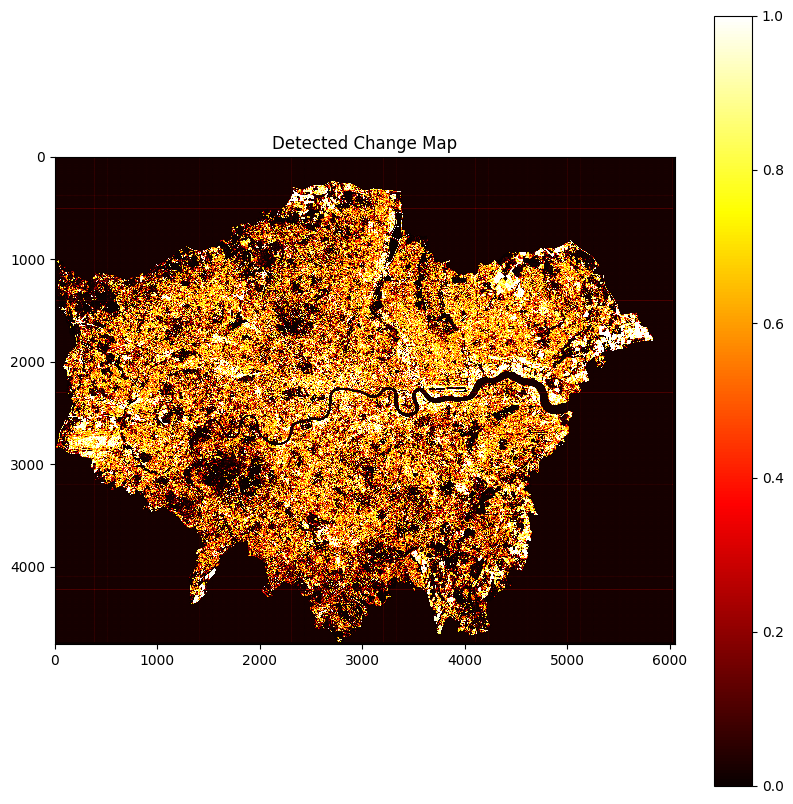

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Model initialization
# model.load_state_dict(torch.load('siam_unet_diff.pth'))
model.eval()

# Function to generate change map
def generate_change_map(model, im1_patches, im2_patches, patch_size, stride, image_shape):
    model.eval()
    change_patches = []

    with torch.no_grad():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = im1_patch.unsqueeze(0).to(device)  # Add batch dimension
            im2_patch = im2_patch.unsqueeze(0).to(device)  # Add batch dimension
            output = model(im1_patch, im2_patch)
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy().squeeze())

    change_patches = np.array(change_patches)
    change_map = reconstruct_image(change_patches, image_shape, patch_size, stride)

    # Normalize the change map to the range [0, 1]
    change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

    return change_map

def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

def visualize_change_map(change_map):
    plt.figure(figsize=(10, 10))
    plt.imshow(change_map, cmap='hot', interpolation='nearest')
    plt.colorbar()
    plt.title('Detected Change Map')
    plt.show()

# Extract patches from input images
im1_patches = extract_patches(im1_tensor.squeeze(0), patch_size, stride)
im2_patches = extract_patches(im2_tensor.squeeze(0), patch_size, stride)

# Convert patches to tensor and ensure they are 4D
im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches])
im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches])

# Ensure patches are of shape [batch_size, channels, height, width]
im1_patches = im1_patches.view(-1, 1, patch_size, patch_size)
im2_patches = im2_patches.view(-1, 1, patch_size, patch_size)

# Generate and visualize the change map
change_map = generate_change_map(model, im1_patches, im2_patches, patch_size, stride, im1_tensor.shape)

if change_map.ndim == 3:
    change_map = np.squeeze(change_map)

visualize_change_map(change_map)


In [ ]:
np.nanpercentile(change_map, 75)

0.49831139855086803

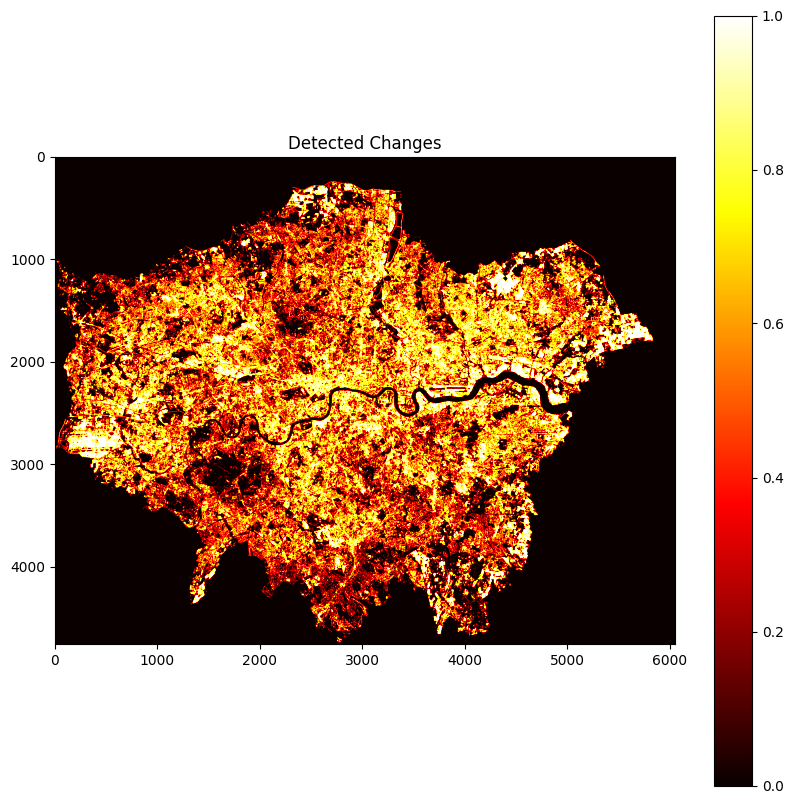

In [ ]:
thresh = np.nanpercentile(change_map, 75)
# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(change_map>thresh, cmap='hot')
plt.colorbar()
plt.title('Detected Changes')
plt.show()

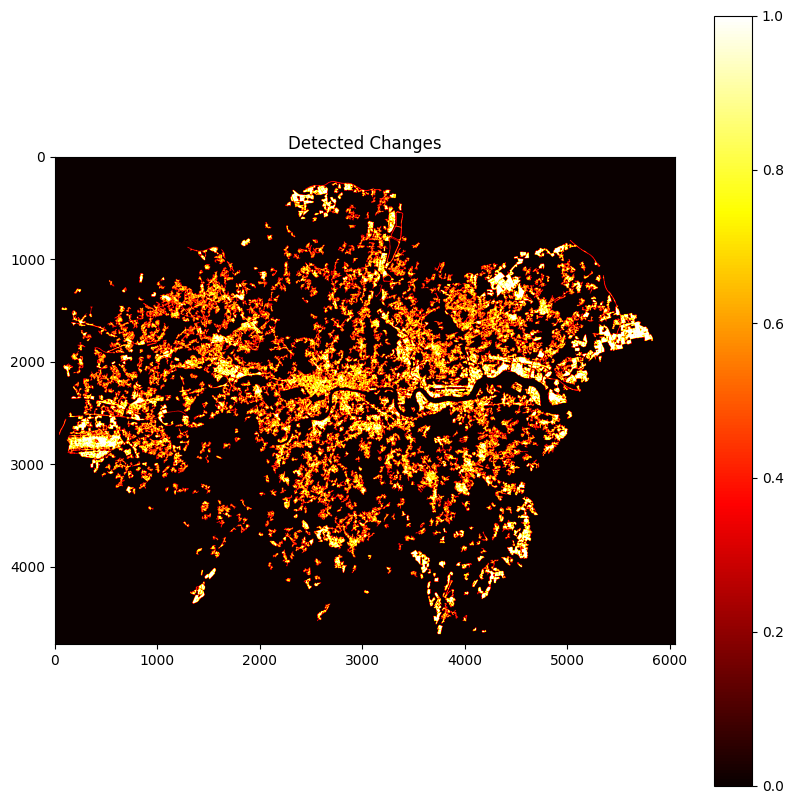

In [ ]:
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=512
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title(f'Detected Changes')
plt.show()

In [ ]:
import os
import numpy as np
import rasterio

# Load metadata from the original image to use in the new TIFF
with rasterio.open(image1_path) as src:
    metadata = src.meta.copy()

# Update metadata to reflect the number of layers and data type
metadata.update(dtype=rasterio.uint8, count=1)

# Save the binary mask to a new TIFF file
model_name = "sunetd"
data_path = "drive/MyDrive/dissertation/"
output_path = os.path.join(data_path, f"change_map_{model_name}.tiff")
with rasterio.open(output_path, 'w', **metadata) as dst:
    dst.write(cd_map, 1)

print(f"Change map saved to {output_path}")


Change map saved to drive/MyDrive/dissertation/change_map_sunetd.tiff


## Siamese network and NestedUNet (SNUNet)

In [94]:
class ChannelAttention(nn.Module):
    def __init__(self, in_channels, ratio=16):
        super(ChannelAttention, self).__init__()
        reduced_channels = max(in_channels // ratio, 1)  # Ensure at least 1 channel
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        self.fc1 = nn.Conv2d(in_channels, reduced_channels, 1, bias=False)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Conv2d(reduced_channels, in_channels, 1, bias=False)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = self.fc2(self.relu1(self.fc1(self.avg_pool(x))))
        max_out = self.fc2(self.relu1(self.fc1(self.max_pool(x))))
        out = avg_out + max_out
        return self.sigmoid(out)


class SNUNet_ECAM(nn.Module):
    def __init__(self, in_channels=1, base_channel=32):
        super(SNUNet_ECAM, self).__init__()
        n1 = base_channel
        filters = [n1, n1 * 2, n1 * 4]

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv0_0 = conv_block_nested(in_channels, filters[0], filters[0])
        self.conv1_0 = conv_block_nested(filters[0], filters[1], filters[1])
        self.Up1_0 = up(filters[1])
        self.conv2_0 = conv_block_nested(filters[1], filters[2], filters[2])
        self.Up2_0 = up(filters[2])

        self.conv0_1 = conv_block_nested(filters[0] * 2, filters[0], filters[0])
        self.conv1_1 = conv_block_nested(filters[1] * 2, filters[1], filters[1])

        self.conv0_2 = conv_block_nested(filters[0] * 3, filters[0], filters[0])

        self.ca = ChannelAttention(filters[0] * 2, ratio=8)  # Adjust ratio as needed
        self.ca1 = ChannelAttention(filters[0], ratio=8 // 4)

        self.conv_final = nn.Conv2d(filters[0] * 2, 1, kernel_size=1)

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, xA, xB):
        '''xA'''
        x0_0A = self.conv0_0(xA)
        x1_0A = self.conv1_0(self.pool(x0_0A))
        x2_0A = self.conv2_0(self.pool(x1_0A))

        '''xB'''
        x0_0B = self.conv0_0(xB)
        x1_0B = self.conv1_0(self.pool(x0_0B))
        x2_0B = self.conv2_0(self.pool(x1_0B))

        # Concatenating features from different resolutions
        x0_1 = self.conv0_1(torch.cat([x0_0A, x0_0B], 1))
        x1_1 = self.conv1_1(torch.cat([x1_0A, x1_0B], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0A, x0_0B, x0_1], 1))

        # Apply channel attention
        ca = self.ca(torch.cat([x0_1, x0_2], 1))
        ca1 = self.ca1(x0_0A + x0_0B)

        # Final output with attention
        out = self.conv_final(ca * (torch.cat([x0_1, x0_2], 1) + ca1))

        return out


In [145]:
class SNUNet_ECAM(nn.Module):
    def __init__(self, in_channels=1, base_channel=32):
        super(SNUNet_ECAM, self).__init__()
        n1 = base_channel
        filters = [n1, n1 * 2, n1 * 4, n1 * 8, n1 * 16]

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv0_0 = conv_block_nested(in_channels, filters[0], filters[0])
        self.conv1_0 = conv_block_nested(filters[0], filters[1], filters[1])
        self.Up1_0 = up(filters[1])
        self.conv2_0 = conv_block_nested(filters[1], filters[2], filters[2])
        self.Up2_0 = up(filters[2])
        self.conv3_0 = conv_block_nested(filters[2], filters[3], filters[3])
        self.Up3_0 = up(filters[3])
        self.conv4_0 = conv_block_nested(filters[3], filters[4], filters[4])

        self.conv0_1 = conv_block_nested(filters[0] * 2, filters[0], filters[0])
        self.conv1_1 = conv_block_nested(filters[1] * 2, filters[1], filters[1])
        self.conv2_1 = conv_block_nested(filters[2] * 2, filters[2], filters[2])
        self.conv3_1 = conv_block_nested(filters[3] * 2, filters[3], filters[3])
        self.conv0_2 = conv_block_nested(filters[0] * 3, filters[0], filters[0])
        self.conv1_2 = conv_block_nested(filters[1] * 3, filters[1], filters[1])

        self.ca = ChannelAttention(filters[0] * 2, ratio=8)
        self.ca1 = ChannelAttention(filters[0], ratio=8 // 4)

        self.conv_final = nn.Conv2d(filters[0] * 2, 1, kernel_size=1)

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, xA, xB):
        '''xA'''
        x0_0A = self.conv0_0(xA)
        x1_0A = self.conv1_0(self.pool(x0_0A))
        x2_0A = self.conv2_0(self.pool(x1_0A))
        x3_0A = self.conv3_0(self.pool(x2_0A))
        x4_0A = self.conv4_0(self.pool(x3_0A))

        '''xB'''
        x0_0B = self.conv0_0(xB)
        x1_0B = self.conv1_0(self.pool(x0_0B))
        x2_0B = self.conv2_0(self.pool(x1_0B))
        x3_0B = self.conv3_0(self.pool(x2_0B))
        x4_0B = self.conv4_0(self.pool(x3_0B))

        # Concatenating features from different resolutions
        x0_1 = self.conv0_1(torch.cat([x0_0A, x0_0B], 1))
        x1_1 = self.conv1_1(torch.cat([x1_0A, x1_0B], 1))
        x2_1 = self.conv2_1(torch.cat([x2_0A, x2_0B], 1))
        x3_1 = self.conv3_1(torch.cat([x3_0A, x3_0B], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0A, x0_0B, x0_1], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0A, x1_0B, x1_1], 1))

        # Apply channel attention
        ca = self.ca(torch.cat([x0_1, x0_2], 1))
        ca1 = self.ca1(x0_0A + x0_0B)

        # Final output with attention
        out = self.conv_final(ca * (torch.cat([x0_1, x0_2], 1) + ca1))

        return out


In [165]:
import torch
import torch.nn as nn

class conv_block_nested(nn.Module):
    def __init__(self, in_ch, mid_ch, out_ch):
        super(conv_block_nested, self).__init__()
        self.activation = nn.ReLU(inplace=True)
        self.conv1 = nn.Conv2d(in_ch, mid_ch, kernel_size=3, padding=1, bias=True)
        self.bn1 = nn.BatchNorm2d(mid_ch)
        self.conv2 = nn.Conv2d(mid_ch, out_ch, kernel_size=3, padding=1, bias=True)
        self.bn2 = nn.BatchNorm2d(out_ch)

    def forward(self, x):
        x = self.conv1(x)
        identity = x
        x = self.bn1(x)
        x = self.activation(x)

        x = self.conv2(x)
        x = self.bn2(x)
        output = self.activation(x + identity)
        return output


class up(nn.Module):
    def __init__(self, in_ch, bilinear=False):
        super(up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch, in_ch, 2, stride=2)

    def forward(self, x):
        x = self.up(x)
        return x


class ChannelAttention(nn.Module):
    def __init__(self, in_channels, ratio=16):
        super(ChannelAttention, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        reduced_channels = max(in_channels // ratio, 1)
        self.fc1 = nn.Conv2d(in_channels, reduced_channels, 1, bias=False)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Conv2d(reduced_channels, in_channels, 1, bias=False)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = self.fc2(self.relu1(self.fc1(self.avg_pool(x))))
        max_out = self.fc2(self.relu1(self.fc1(self.max_pool(x))))
        out = avg_out + max_out
        return self.sigmoid(out)


class SNUNet_ECAM(nn.Module):
    # SNUNet-CD with ECAM
    def __init__(self, in_channels=1, base_channel=32):
        super(SNUNet_ECAM, self).__init__()
        torch.nn.Module.dump_patches = True
        n1 = base_channel
        filters = [n1, n1 * 2, n1 * 2, n1 * 4, n1 * 16]

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv0_0 = conv_block_nested(in_channels, filters[0], filters[0])
        self.conv1_0 = conv_block_nested(filters[0], filters[1], filters[1])
        self.Up1_0 = up(filters[1])
        self.conv2_0 = conv_block_nested(filters[1], filters[2], filters[2])
        self.Up2_0 = up(filters[2])
        self.conv3_0 = conv_block_nested(filters[2], filters[3], filters[3])
        self.Up3_0 = up(filters[3])
        self.conv4_0 = conv_block_nested(filters[3], filters[4], filters[4])

        self.conv0_1 = conv_block_nested(filters[0] * 2, filters[0], filters[0])
        self.conv1_1 = conv_block_nested(filters[1] * 3, filters[1], filters[1])
        self.conv2_1 = conv_block_nested(filters[2] * 2, filters[2], filters[2])
        self.conv3_1 = conv_block_nested(filters[3] * 2, filters[3], filters[3])
        self.conv0_2 = conv_block_nested(filters[0] * 3, filters[0], filters[0])
        self.conv1_2 = conv_block_nested(filters[1] * 3, filters[1], filters[1])

        self.ca = ChannelAttention(filters[0] * 2, ratio=16)
        self.ca1 = ChannelAttention(filters[0], ratio=4)

        self.conv_final = nn.Conv2d(filters[0] * 2, 1, kernel_size=1)

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, xA, xB):
        '''xA'''
        x0_0A = self.conv0_0(xA)
        x1_0A = self.conv1_0(self.pool(x0_0A))
        x2_0A = self.conv2_0(self.pool(x1_0A))
        x3_0A = self.conv3_0(self.pool(x2_0A))
        x4_0A = self.conv4_0(self.pool(x3_0A))

        '''xB'''
        x0_0B = self.conv0_0(xB)
        x1_0B = self.conv1_0(self.pool(x0_0B))
        x2_0B = self.conv2_0(self.pool(x1_0B))
        x3_0B = self.conv3_0(self.pool(x2_0B))
        x4_0B = self.conv4_0(self.pool(x3_0B))

        # Concatenating features from different resolutions
        # x0_1 = self.conv0_1(torch.cat([x0_0A, x0_0B, self.Up1_0(x1_0B)], 1))
        x0_1 = self.conv0_1(torch.cat([x0_0A, x0_0B], 1))
        x1_1 = self.conv1_1(torch.cat([x1_0A, x1_0B, self.Up2_0(x2_0B)], 1))
        x2_1 = self.conv2_1(torch.cat([x2_0A, x2_0B, self.Up3_0(x3_0B)], 1))
        x3_1 = self.conv3_1(torch.cat([x3_0A, x3_0B], 1))

        x0_2 = self.conv0_2(torch.cat([x0_0A, x0_0B, x0_1, self.Up1_1(x1_1)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0A, x1_0B, x1_1, self.Up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0A, x0_0B, x0_1, x0_2, self.Up1_2(x1_2)], 1))

        # Channel attention mechanisms
        x3_1 = self.conv3_1(torch.cat([x3_0A, x3_0B, self.Up4_0(x4_0B)], 1))
        ca1 = self.ca1(x0_0A + x0_0B)
        x0_4 = self.conv0_4(torch.cat([x0_0A, x0_0B, x0_1, x0_2, x0_3, self.Up1_3(x1_3)], 1))

        out = torch.cat([x0_1, x0_2, x0_3, x0_4], 1)
        out = self.ca(out) * (out + ca1.repeat(1, 2, 1, 1))
        out = self.conv_final(out)

        return out


In [6]:
class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

# Function to extract patches from the image
def extract_patches(image, patch_size, stride):
    patches = []
    _, height, width = image.shape[-3:]  # Update to handle correct shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            patches.append(patch)
    return patches

# Function to reconstruct image from patches
def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

In [25]:

im1_patches[0].shape

torch.Size([1, 256, 256])

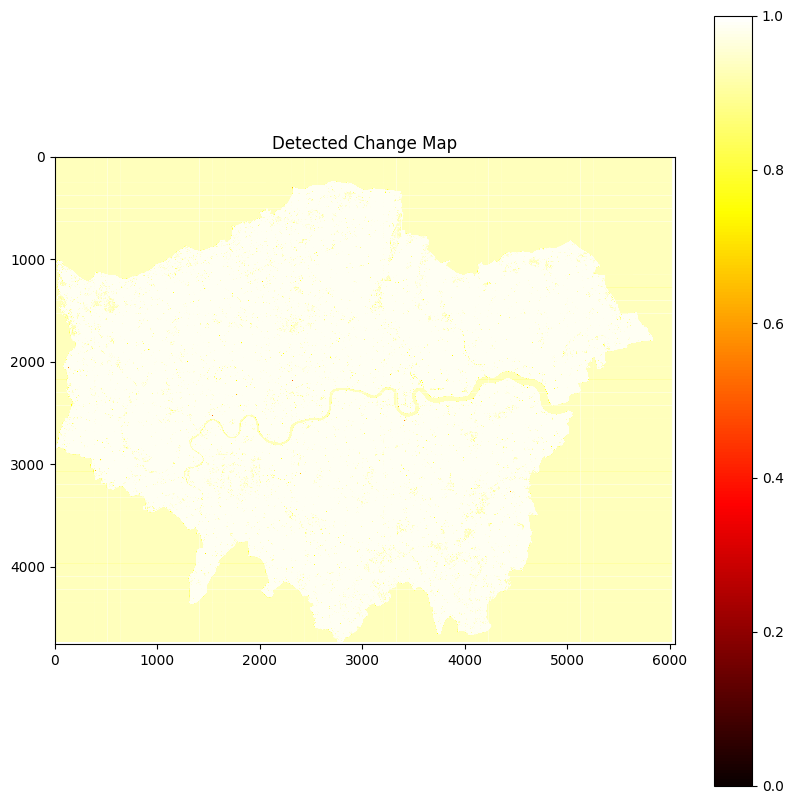

In [107]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Model initialization
model.eval()

# Function to generate change map
def generate_change_map(model, im1_patches, im2_patches, patch_size, stride, image_shape):
    model.eval()
    change_patches = []

    with torch.no_grad():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = im1_patch.unsqueeze(0).to(device)  # Add batch dimension
            im2_patch = im2_patch.unsqueeze(0).to(device)  # Add batch dimension
            output = model(im1_patch, im2_patch)
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy().squeeze())

    change_patches = np.array(change_patches)
    change_map = reconstruct_image(change_patches, image_shape, patch_size, stride)

    # Normalize the change map to the range [0, 1]
    change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

    return change_map

def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patches[patch_idx]
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    return reconstructed_image

def visualize_change_map(change_map):
    plt.figure(figsize=(10, 10))
    plt.imshow(change_map, cmap='hot', interpolation='nearest')
    plt.colorbar()
    plt.title('Detected Change Map')
    plt.show()

# Generate and visualize the change map
change_map = generate_change_map(model, im1_patches, im2_patches, patch_size, stride, im1_tensor.shape)

if change_map.ndim == 3:
    change_map = np.squeeze(change_map)

visualize_change_map(change_map)


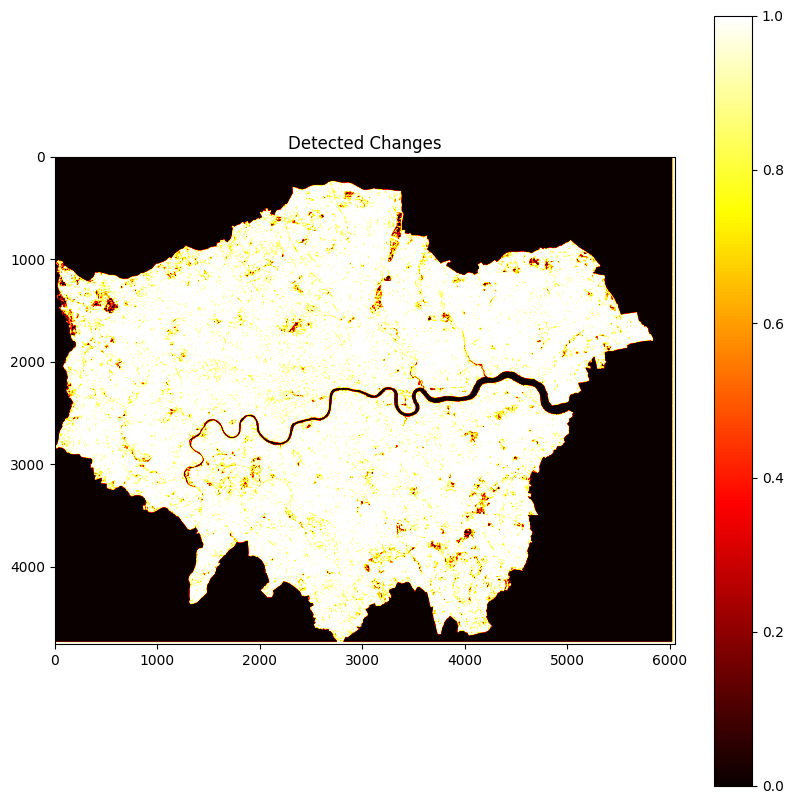

In [141]:
cd_map = apply_thresholding_strategy(
    change_map,
    strategy='multiotsu',
    min_size=16
)

# Visualize the change map
plt.figure(figsize=(10, 10))
plt.imshow(cd_map, cmap='hot')
plt.colorbar()
plt.title(f'Detected Changes')
plt.show()

## Validation

In [ ]:
%pip install --quiet rasterio earthpy

/usr/local/lib/python3.10/dist-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


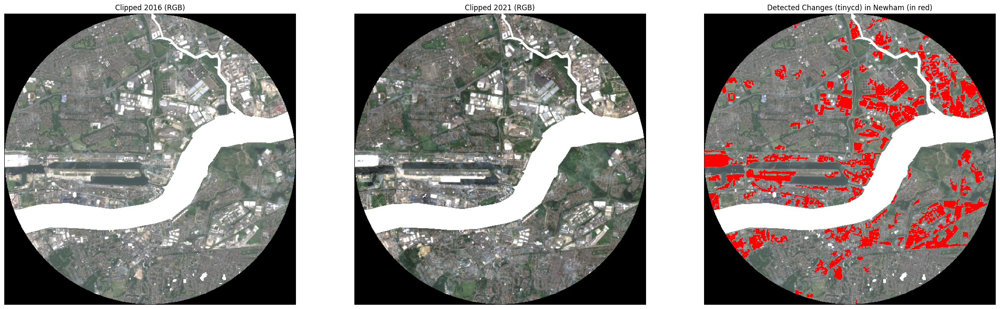

/usr/local/lib/python3.10/dist-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


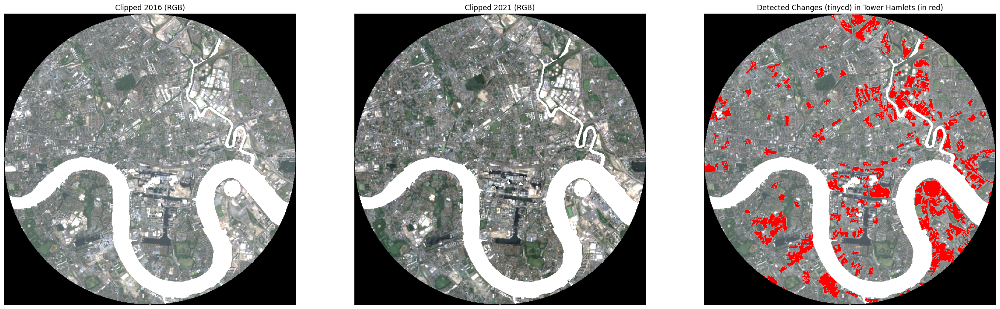

/usr/local/lib/python3.10/dist-packages/earthpy/spatial.py:561: RuntimeWarning: invalid value encountered in cast
  return (bytedata.clip(low, high) + 0.5).astype("uint8")


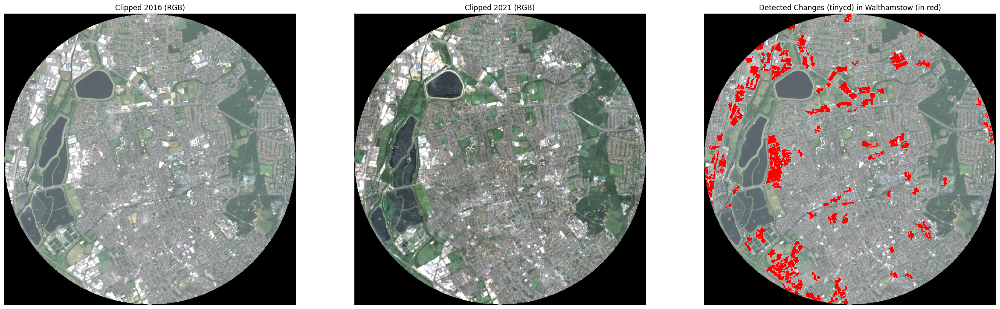

In [ ]:
import os
import numpy as np
import geopandas as gpd
from shapely.geometry import Point
import rasterio
from rasterio.mask import mask
import matplotlib.pyplot as plt
import earthpy.plot as ep


def create_buffer(latitude, longitude, buffer_radius_meters, raster_crs):
    point = Point(longitude, latitude)
    gdf = gpd.GeoDataFrame(geometry=[point], crs="EPSG:4326")
    gdf = gdf.to_crs(raster_crs)
    buffer = gdf.buffer(buffer_radius_meters)
    return buffer.geometry[0]

def clip_raster_by_geometry(raster_path, geometry, output_path):
    with rasterio.open(raster_path) as src:
        out_image, out_transform = mask(src, [geometry], crop=True)
        out_meta = src.meta.copy()
        out_meta.update(
            {
                "driver": "GTiff",
                "height": out_image.shape[1],
                "width": out_image.shape[2],
                "transform": out_transform,
                "nodata": 0
            }
        )
        with rasterio.open(output_path, "w", **out_meta) as dest:
            dest.write(out_image)
            dest.nodata = 0
    return output_path

def visualize_clipped_rasters_with_changes(image1_path, image2_path, changes_path, title, output_image_path, save=False):
    with rasterio.open(image1_path) as src1:
        image1 = src1.read()
    with rasterio.open(image2_path) as src2:
        image2 = src2.read()
    with rasterio.open(changes_path) as src_changes:
        changes = src_changes.read(1)

    height, width = changes.shape
    rgba_image = np.zeros((height, width, 4), dtype=np.float32)
    mask = changes > 0
    rgba_image[mask] = [1, 0, 0, 1]

    fig, axes = plt.subplots(1, 3, figsize=(30, 10))
    ep.plot_rgb(image1, rgb=(3, 2, 1), ax=axes[0], title="Clipped 2016 (RGB)", stretch=True, str_clip=2)
    ep.plot_rgb(image2, rgb=(3, 2, 1), ax=axes[1], title="Clipped 2021 (RGB)", stretch=True, str_clip=2)
    ep.plot_rgb(image1, rgb=(3, 2, 1), ax=axes[2], title=title, stretch=True, str_clip=2)
    axes[2].imshow(rgba_image, interpolation="none")

    for ax in axes:
      ax.set_aspect('equal')
      ax.axis('off')

    if save:
        plt.savefig(output_image_path, bbox_inches="tight", transparent=True, dpi=1000)
    plt.show()

locations = {
    "Newham": (51.5074, 0.0708),
    "Tower Hamlets": (51.509, -0.0208),
    "Walthamstow": (51.5908, -0.0195)
}

model_name = "tinycd"
buffer_radius_meters = 3000
data_path = "drive/MyDrive/dissertation/"
output_path = "drive/MyDrive/dissertation/"
image1_path = os.path.join(data_path, "clipped_merged_2016.tiff")
image2_path = os.path.join(data_path, "clipped_merged_2021.tiff")
output_change_path = os.path.join(data_path, f"change_map_{model_name}.tiff")

with rasterio.open(image1_path) as src:
    raster_crs = src.crs

for location_name, (latitude, longitude) in locations.items():
    buffer = create_buffer(latitude, longitude, buffer_radius_meters, raster_crs)

    output_image1_path = os.path.join(output_path, f"clipped_buffer_2016_{location_name}.tiff")
    output_image2_path = os.path.join(output_path, f"clipped_buffer_2021_{location_name}.tiff")
    output_changes_path = os.path.join(output_path, f"clipped_buffer_changes_2016_2021_{location_name}.tiff")
    output_image_path = os.path.join(output_path, f"changes_visualization_{location_name}.png")

    clipped_image1_path = clip_raster_by_geometry(image1_path, buffer, output_image1_path)
    clipped_image2_path = clip_raster_by_geometry(image2_path, buffer, output_image2_path)
    clipped_changes_path = clip_raster_by_geometry(output_change_path, buffer, output_changes_path)

    visualize_clipped_rasters_with_changes(
        clipped_image1_path,
        clipped_image2_path,
        clipped_changes_path,
        f"Detected Changes ({model_name}) in {location_name} (in red)",
        output_image_path,
        save=False
    )


Change map saved to drive/MyDrive/dissertation/change_map_fcsd.tiff


## Single Band (Final)

In [ ]:
%pip install --quiet rasterio earthpy

In [ ]:
import os
import cv2
import rasterio
import numpy as np
import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import LambdaLR
from torch.utils.data import TensorDataset, DataLoader
import matplotlib.pyplot as plt
from torchvision import transforms



data_transforms = transforms.Compose([
    # transforms.RandomHorizontalFlip(),
    # transforms.RandomVerticalFlip(),
    # transforms.RandomRotation(90),
    transforms.RandomErasing(p=0.3)
])

class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

def load_image(image_path, bands=None):
    with rasterio.open(image_path) as src:
        if bands is not None:
            image = src.read(bands)
        else:
            image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

def extract_patches(image, patch_size, stride, transform=None):
    patches = []
    _, height, width = image.shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            if transform:
                patch = transform(patch)
            patches.append(patch)
    return patches

def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = patches[patch_idx]
            if patch.shape != (channels, patch_size, patch_size):
                raise ValueError(f"Patch shape mismatch: expected {(channels, patch_size, patch_size)}, got {patch.shape}")
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patch
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    if reconstructed_image.ndim != 3:
        raise ValueError(f"Reconstructed image has unexpected dimensions: {reconstructed_image.shape}")
    return reconstructed_image

def generate_change_map(model, im1_patches, im2_patches, patch_size, stride, image_shape):
    model.eval()
    change_patches = []

    with torch.no_grad():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = im1_patch.unsqueeze(0).to(device)  # Add batch dimension
            im2_patch = im2_patch.unsqueeze(0).to(device)  # Add batch dimension
            output = model(im1_patch, im2_patch)
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy())

    change_patches = np.array(change_patches)
    change_patches = change_patches.squeeze(1) # Remove batch dimension, keep channel
    change_map = reconstruct_image(change_patches, image_shape, patch_size, stride)

    # Normalize the change map to the range [0, 1]
    # change_map = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))

    if change_map.ndim == 3:
        change_map = np.squeeze(change_map)

    return change_map

def visualize_change_map(change_map):
    plt.figure(figsize=(10, 10))
    plt.imshow(change_map, cmap='hot', interpolation='nearest')
    plt.colorbar()
    plt.title('Detected Change Map')
    plt.show()

def initialize_model(model_name, device):

    if model_name == "unetsd":
        model = SiamUnet_diff(input_nbr=1, label_nbr=1).to(device)
    elif model_name == "cgnet":
        model = CGNet(weights='DEFAULT').to(device)
    elif model_name == "bdnet":
        model = BiDateNet(n_channels=1, n_classes=1).to(device)
    elif model_name == "tinycd":
        model = TinyCD(
            bkbn_name="efficientnet_b0",
            weights='DEFAULT',
            output_layer_bkbn="1",
            freeze_backbone=False,
            bkbn_out_channels=[32, 32, 32, 1]
        ).to(device)
    else:
        raise ValueError(f"Unknown model name: {model_name}")

    return model

def process_band(band, im1_tensor, im2_tensor, model_config, no_data_mask):
    print(f"Extracting features for band {band}")

    # Extract parameters from model_config
    model_name = model_config["name"]
    device = model_config["device"]
    patch_size = model_config["patch_size"]
    stride = model_config["stride"]
    batch_size = model_config["batch_size"]
    num_epochs = model_config["num_epochs"]
    learning_rate = model_config["learning_rate"]
    model_dir = model_config["model_dir"]

    # Ensure device is set
    model = False
    model = initialize_model(model_name, device)

    # Define loss and optimizer
    criterion = nn.L1Loss()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    # optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum=0.9, weight_decay=5e-4)
    scheduler = LambdaLR(optimizer, lr_lambda=lambda epoch: 1.0 - epoch / float(50 + 1))

    # Select the specific band
    im1_band_tensor = im1_tensor[:, band - 1, :, :].unsqueeze(1)
    im2_band_tensor = im2_tensor[:, band - 1, :, :].unsqueeze(1)

    # Extract patches from input images
    im1_patches = extract_patches(im1_band_tensor.squeeze(0), patch_size, stride)
    im2_patches = extract_patches(im2_band_tensor.squeeze(0), patch_size, stride)

    # Convert patches to tensor and ensure they are 4D
    im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
    im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)

    # Ensure the tensors are of shape [batch_size, channels, height, width]
    im1_patches = im1_patches.squeeze(1)
    im2_patches = im2_patches.squeeze(1)

    dataset = TensorDataset(im1_patches, im2_patches)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)

    # Training loop
    for epoch in range(num_epochs):
        model.train()
        optimizer.zero_grad()
        with ClearCache():
            for im1_patch_batch, im2_patch_batch in dataloader:
                im1_patch_batch, im2_patch_batch = im1_patch_batch.to(device), im2_patch_batch.to(device)
                output = model(im1_patch_batch, im2_patch_batch)
                resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
                loss = criterion(resized_output, im1_patch_batch)
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
        scheduler.step()
        print(f'Epoch {epoch + 1}, Loss: {loss.item():.4f}')

    # Save the trained model
    model_path = os.path.join(model_dir, f"{model_name}_band_{band}.pth")
    torch.save(model.state_dict(), model_path)

    # Generate change map
    change_map = generate_change_map(model, im1_patches, im2_patches, patch_size, stride, im1_band_tensor.shape)

    change_map[no_data_mask] = 0

    return change_map


# Ensure device is set
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load data
bands = list(range(1, 12))
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)
print(f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}')

model_dir = "drive/MyDrive/dissertation/models/"
model_config = {
    "name": "tinycd",
    "device": device,
    "patch_size": 256,
    "stride": 128,
    "batch_size": 8,
    "num_epochs": 1,
    "learning_rate": 0.001,
    "model_dir": model_dir
    }

# Define model parameters
model_name = model_config["name"]
output_dir = f"drive/MyDrive/dissertation/features_{model_name}/"

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

change_maps = []
for band in bands:
    change_map = process_band(band, im1_tensor, im2_tensor, model_config, no_data_mask)
    change_maps.append(change_map)

# Visualize the first change map for example
# visualize_change_map(change_maps[0])


Using device: cuda
Images shape: torch.Size([1, 11, 4754, 6050]), torch.Size([1, 11, 4754, 6050])
Extracting features for band 1
Epoch 1, Loss: 0.0393
Extracting features for band 2
Epoch 1, Loss: 0.0528
Extracting features for band 3
Epoch 1, Loss: 0.0453
Extracting features for band 4
Epoch 1, Loss: 0.0334
Extracting features for band 5
Epoch 1, Loss: 0.0719
Extracting features for band 6
Epoch 1, Loss: 0.1327
Extracting features for band 7
Epoch 1, Loss: 0.2374
Extracting features for band 8
Epoch 1, Loss: 0.3086
Extracting features for band 9
Epoch 1, Loss: 0.2931
Extracting features for band 10
Epoch 1, Loss: 0.1574
Extracting features for band 11
Epoch 1, Loss: 0.0852


In [ ]:
len(change_maps)

11

In [ ]:
import os
import torch
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from torchvision import transforms


data_transforms = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(90)
])

class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

def load_image(image_path, bands=None):
    with rasterio.open(image_path) as src:
        if bands is not None:
            image = src.read(bands)
        else:
            image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

def extract_patches(image, patch_size, stride, transform=None):
    patches = []
    _, height, width = image.shape
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = image[:, i:i+patch_size, j:j+patch_size]
            if transform:
                patch = transform(patch)
            patches.append(patch)
    return patches

def reconstruct_image(patches, image_shape, patch_size, stride):
    channels, height, width = image_shape[1:]
    reconstructed_image = np.zeros((channels, height, width))
    count_matrix = np.zeros((height, width))
    patch_idx = 0
    for i in range(0, height - patch_size + 1, stride):
        for j in range(0, width - patch_size + 1, stride):
            patch = patches[patch_idx]
            if patch.shape != (channels, patch_size, patch_size):
                raise ValueError(f"Patch shape mismatch: expected {(channels, patch_size, patch_size)}, got {patch.shape}")
            reconstructed_image[:, i:i+patch_size, j:j+patch_size] += patch
            count_matrix[i:i+patch_size, j:j+patch_size] += 1
            patch_idx += 1
    count_matrix[count_matrix == 0] = 1  # Avoid division by zero
    reconstructed_image /= count_matrix
    if reconstructed_image.ndim != 3:
        raise ValueError(f"Reconstructed image has unexpected dimensions: {reconstructed_image.shape}")
    return reconstructed_image

def initialize_model(model_name, device):

    if model_name == "unetsd":
        model = SiamUnet_diff(input_nbr=1, label_nbr=1).to(device)
    elif model_name == "cgnet":
        model = CGNet(weights='DEFAULT').to(device)
    elif model_name == "bdnet":
        model = BiDateNet(n_channels=1, n_classes=1).to(device)
    elif model_name == "tinycd":
        model = TinyCD(
            bkbn_name="efficientnet_b0",
            weights='DEFAULT',
            output_layer_bkbn="1",
            freeze_backbone=False,
            bkbn_out_channels=[32, 32, 32, 1]
        ).to(device)
    else:
        raise ValueError(f"Unknown model name: {model_name}")

    return model

def load_model(model_name, model_path, device):
    model = initialize_model(model_name, device)
    model.load_state_dict(torch.load(model_path))
    model.eval()
    return model

def generate_change_map_from_saved_model(band, model, model_config, im1_tensor, im2_tensor):
    # Extract parameters from model_config
    patch_size = model_config["patch_size"]
    stride = model_config["stride"]
    device = model_config["device"]

    # Select the specific band
    im1_band_tensor = im1_tensor[:, band - 1, :, :].unsqueeze(1)
    im2_band_tensor = im2_tensor[:, band - 1, :, :].unsqueeze(1)

    # Extract patches from input images
    im1_patches = extract_patches(im1_band_tensor.squeeze(0), patch_size, stride)
    im2_patches = extract_patches(im2_band_tensor.squeeze(0), patch_size, stride)

    # Convert patches to tensor and ensure they are 4D
    im1_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im1_patches]).to(device)
    im2_patches = torch.stack([patch.clone().detach().unsqueeze(0) for patch in im2_patches]).to(device)

    # Ensure the tensors are of shape [batch_size, channels, height, width]
    im1_patches = im1_patches.squeeze(1)
    im2_patches = im2_patches.squeeze(1)

    change_patches = []
    with torch.no_grad():
        for im1_patch, im2_patch in zip(im1_patches, im2_patches):
            im1_patch = im1_patch.unsqueeze(0).to(device)  # Add batch dimension
            im2_patch = im2_patch.unsqueeze(0).to(device)  # Add batch dimension
            output = model(im1_patch, im2_patch)
            resized_output = F.interpolate(output, size=(patch_size, patch_size), mode='bilinear', align_corners=False)
            change_patches.append(resized_output.cpu().numpy())

    change_patches = np.array(change_patches)
    change_patches = change_patches.squeeze(1)  # Remove batch dimension, keep channel
    change_map = reconstruct_image(change_patches, im1_band_tensor.shape, patch_size, stride)

    if change_map.ndim == 3:
        change_map = np.squeeze(change_map)

    return change_map


# Assuming model configuration and paths
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model_dir = "drive/MyDrive/dissertation/models/"
model_config = {
    "name": "bdnet",
    "device": device,
    "patch_size": 256,
    "stride": 128,
    "batch_size": 8,
    "num_epochs": 1,
    "learning_rate": 0.001,
    "model_dir": model_dir
    }

# Define model parameters
model_name = model_config["name"]
bands = list(range(1, 12))

# Load data
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))
im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)
print(f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}')

# Create output directory if it does not exist
output_dir = f"drive/MyDrive/dissertation/recreated_change_maps_{model_name}/"
os.makedirs(output_dir, exist_ok=True)

# Generate change maps using the saved models
change_maps = []
for band in bands:
    model_path = os.path.join(model_dir, f"{model_name}_band_{band}.pth")
    model = load_model(model_name, model_path, device)
    change_map = generate_change_map_from_saved_model(
        band, model, model_config, im1_tensor, im2_tensor
        )
    change_map[no_data_mask] = 0
    change_maps.append(change_map)

    # # Save or visualize the change map
    # visualize_change_map(change_map)
    # change_map_path = os.path.join(output_dir, f"change_map_band_{band}.npy")
    # np.save(change_map_path, change_map)

    print(f"Recreated {model_name} change map for band {band} successfully.")


Images shape: torch.Size([1, 11, 4754, 6050]), torch.Size([1, 11, 4754, 6050])


KeyboardInterrupt: 

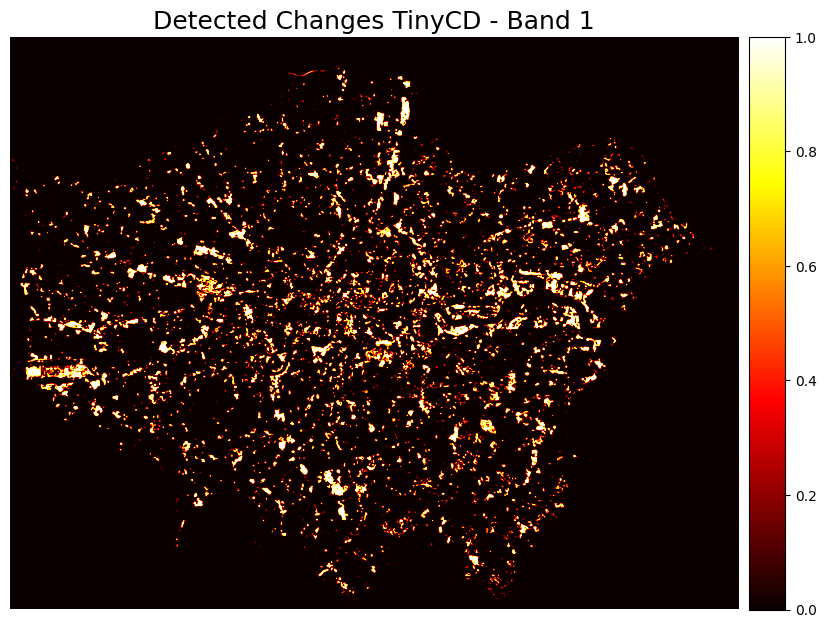

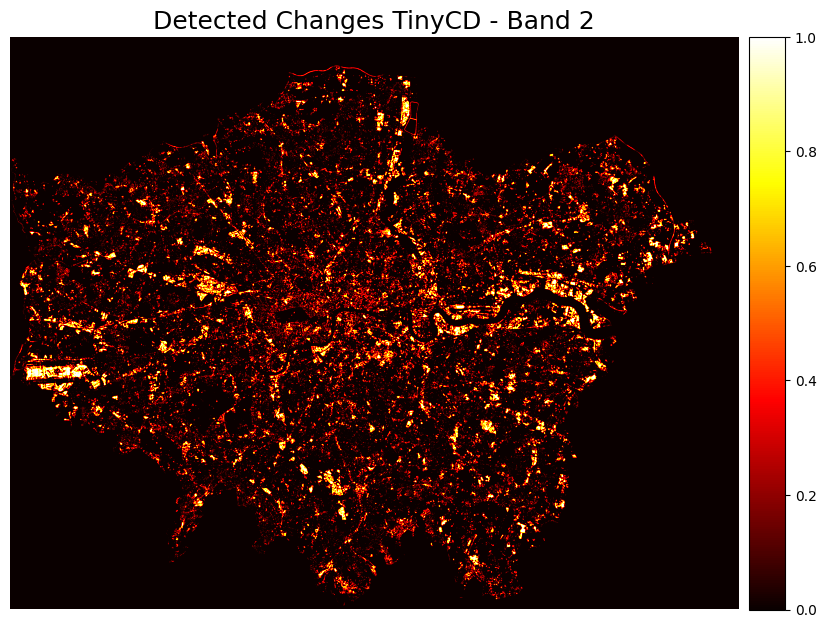

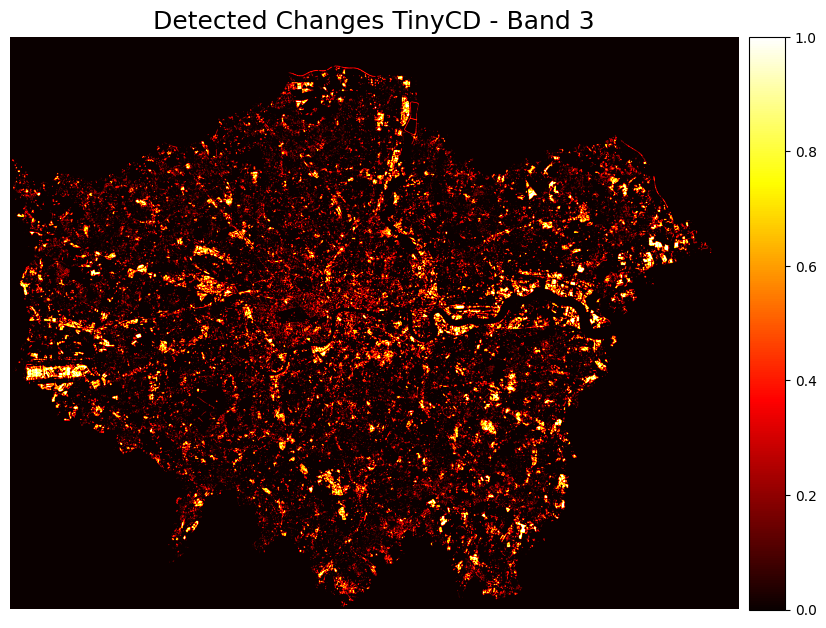

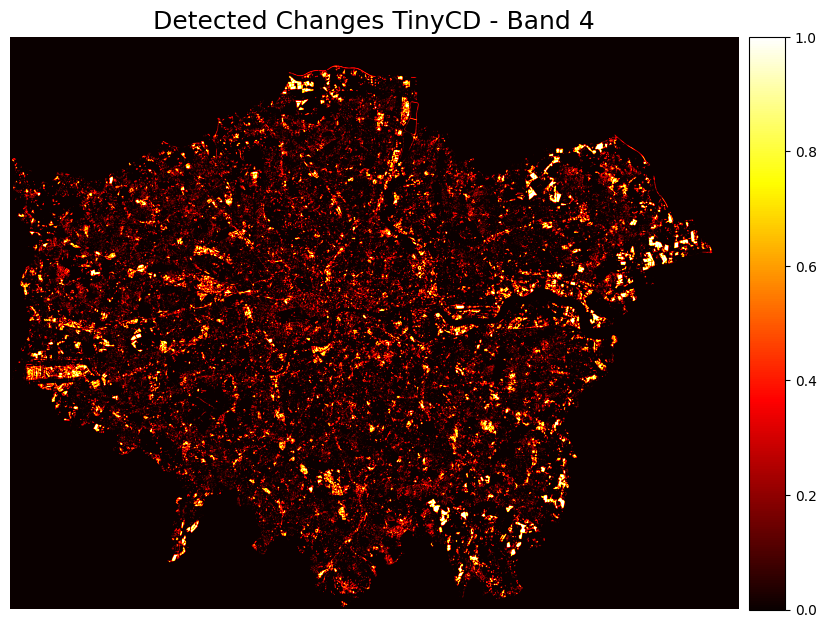

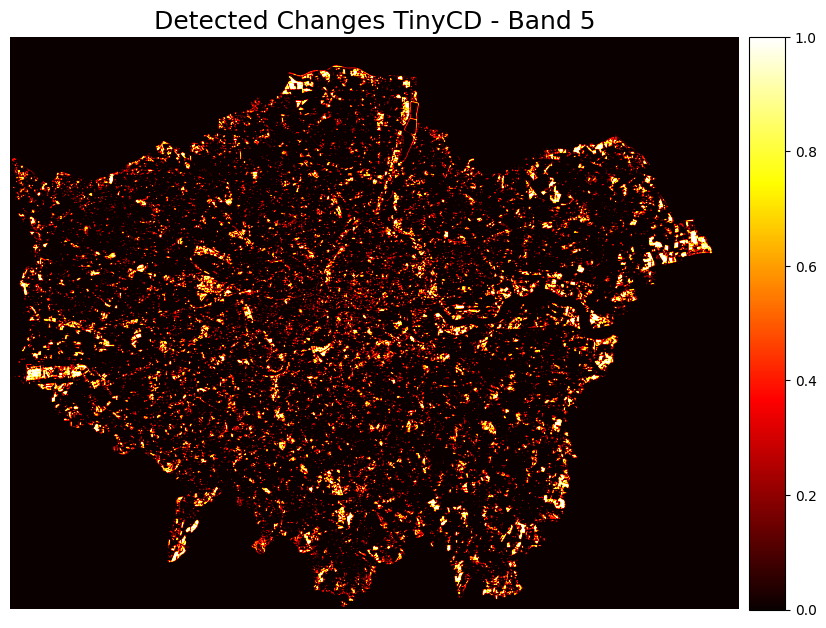

...

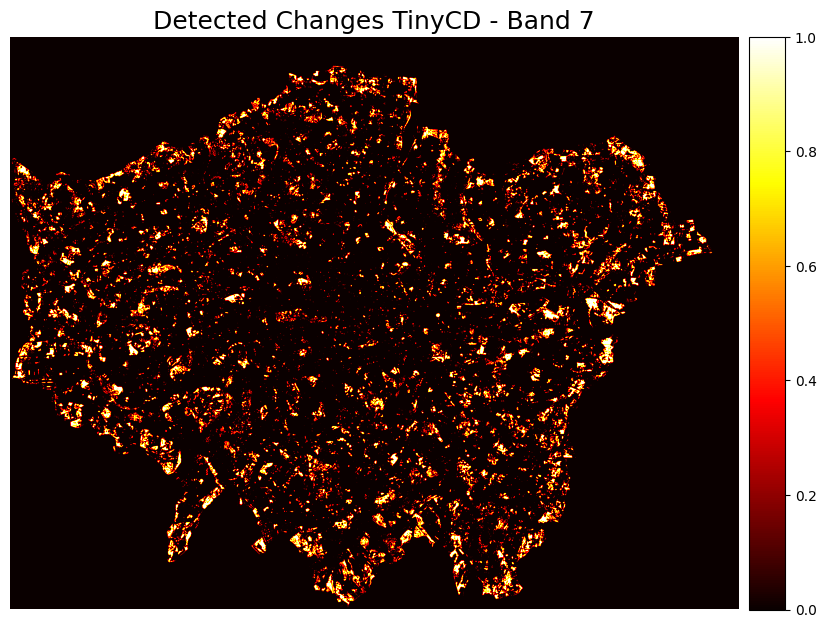

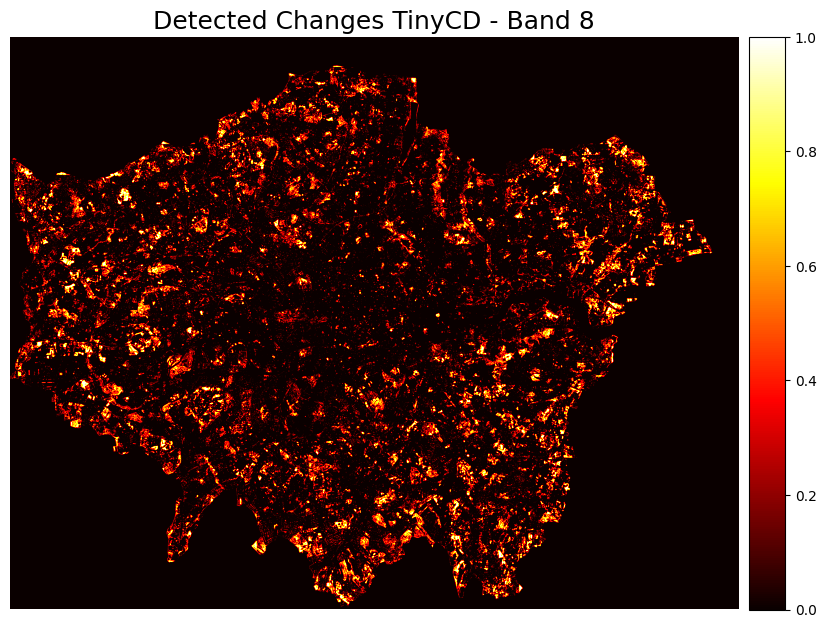

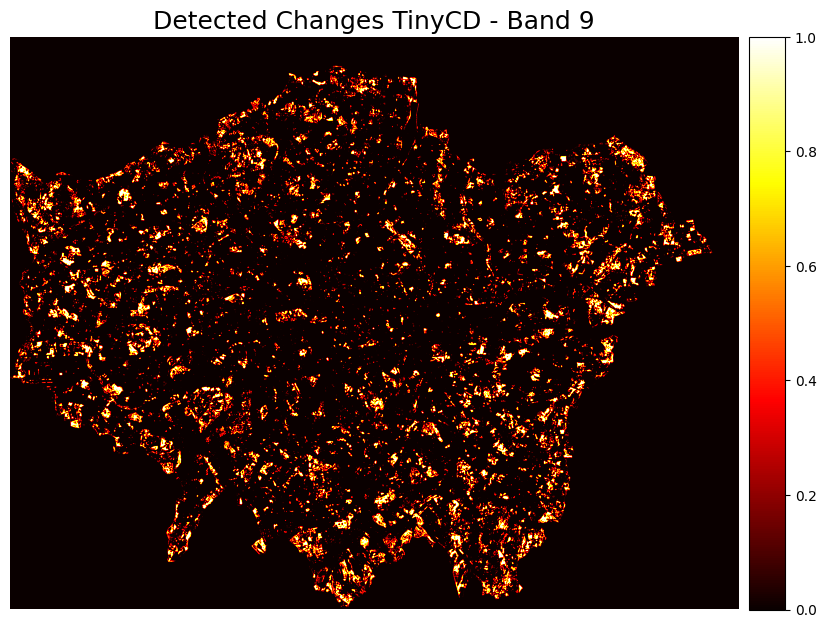

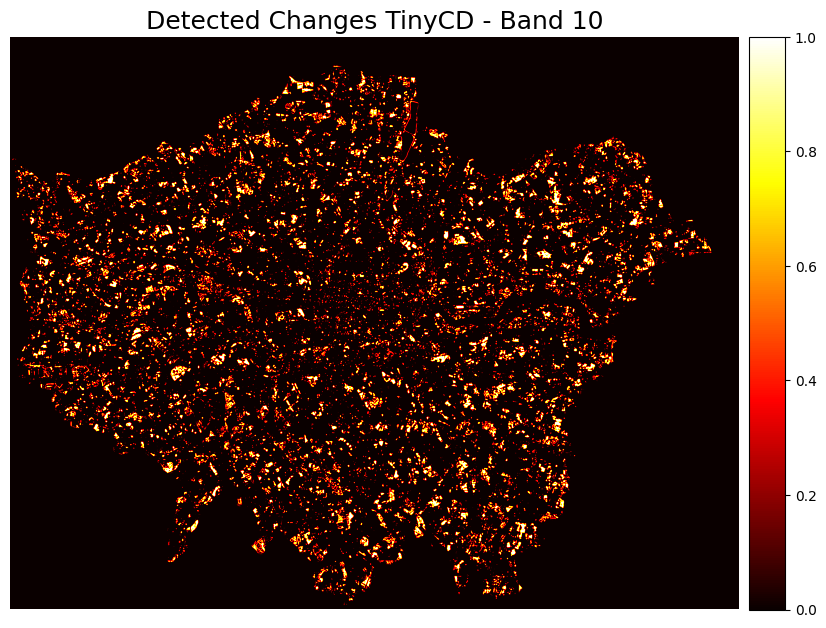

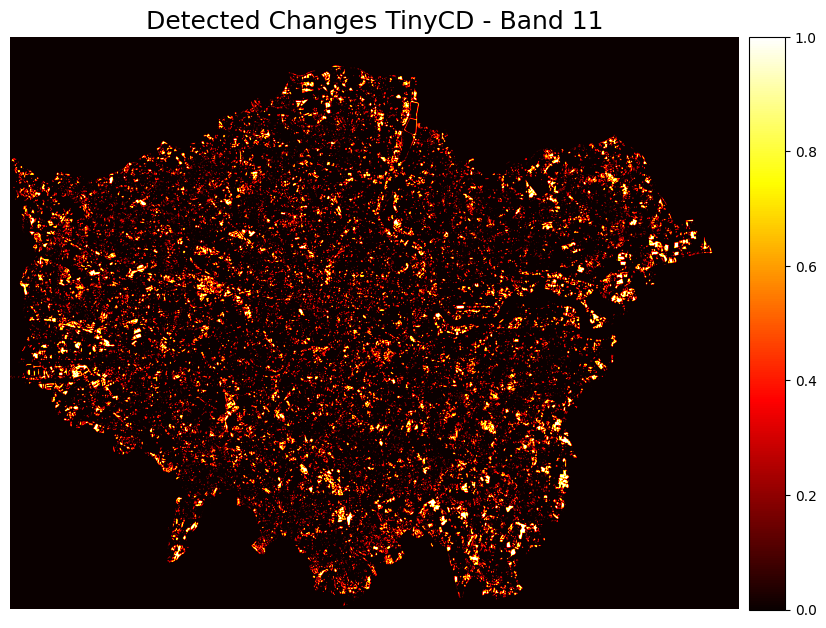

In [ ]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.cm import ScalarMappable


names = {
    "unetsd": "UNet-SiamDiff",
    "cgnet": "CGNet",
    "bdnet": "BiDateNet",
    "tinycd": "TinyCD"
}


output_image_path = "drive/MyDrive/dissertation/plots/"
os.makedirs(output_image_path, exist_ok=True)

def visualize_change_maps(change_maps, model_name, output_dir, thresh_type="pct", save=False):
    if thresh_type not in ["pct", "otsu"]:
        print("Invalid thresh_type. Choose either 'pct' or 'otsu'.")
        return

    for band, change_map in enumerate(change_maps, start=1):
        temp = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))
        if thresh_type == "pct":
            percentile_thresh = np.percentile(temp, 95)
            cd_map = (temp > percentile_thresh).astype(np.uint8)
        elif thresh_type == "otsu":
            cd_map = apply_thresholding_strategy(
                temp,
                strategy='multiotsu',
                min_size=16
            )

        fig, ax = plt.subplots(1, figsize=(10, 10))
        ax.axis("off")
        ax.set_title(
            f'Detected Changes {names[model_name]} - Band {band}',
            fontdict={"fontsize": "18", "fontweight": "3"},
        )
        plt.imshow(cd_map, cmap='hot')
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.1)

        vmin, vmax = np.min(cd_map), np.max(cd_map)
        mappable = ScalarMappable(cmap="hot", norm=plt.Normalize(vmin=vmin, vmax=vmax))
        mappable._A = ([])
        cbar = fig.colorbar(mappable, cax=cax)
        if save:
            output_path = os.path.join(output_dir, f"features_band_{band}_{model_name}.png")
            plt.savefig(output_path, bbox_inches='tight', transparent=True, dpi=500)
            print(f"Change map features for band {band} saved to {output_path}")
        plt.show()


visualize_change_maps(
    change_maps,
    model_config['name'],
    output_image_path,
    thresh_type='pct',
    save=False
    )


In [ ]:
import os
import rasterio
import numpy as np

def save_features(change_maps, model_name, image_path, output_dir, thresh_type="pct"):
    # Load metadata from the original image to use in the new TIFF
    with rasterio.open(image_path) as src:
        metadata = src.meta.copy()

    # Update metadata to reflect the number of layers and data type
    metadata.update(dtype=rasterio.uint8, count=1)

    if thresh_type not in ["pct", "otsu"]:
        print("Invalid thresh_type. Choose either 'pct' or 'otsu'.")
        return

    for band, change_map in enumerate(change_maps, start=1):
        temp = (change_map - np.min(change_map)) / (np.max(change_map) - np.min(change_map))
        if thresh_type == "pct":
            percentile_thresh = np.percentile(temp, 95)
            cd_map = (temp > percentile_thresh).astype(np.uint8)
        elif thresh_type == "otsu":
            cd_map = apply_thresholding_strategy(
                temp,
                strategy='multiotsu',
                min_size=16
            )

        output_path = os.path.join(output_dir, f"features_band_{band}_{model_name}.tiff")
        with rasterio.open(output_path, 'w', **metadata) as dst:
            dst.write(cd_map, 1)

        print(f"Change map features for band {band} saved to {output_path}")


# Define paths and bands to process
model_name = model_config["name"]
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
output_dir = f"drive/MyDrive/dissertation/features_{model_name}/"
model_dir = "drive/MyDrive/dissertation/models/"
bands = list(range(1, 12))

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

# Loop through each band and train the model
save_features(change_maps, model_name, image2_path, output_dir, "otsu")


Change map features for band 1 saved to drive/MyDrive/dissertation/features_tinycd/features_band_1_tinycd.tiff
Change map features for band 2 saved to drive/MyDrive/dissertation/features_tinycd/features_band_2_tinycd.tiff
Change map features for band 3 saved to drive/MyDrive/dissertation/features_tinycd/features_band_3_tinycd.tiff
Change map features for band 4 saved to drive/MyDrive/dissertation/features_tinycd/features_band_4_tinycd.tiff
Change map features for band 5 saved to drive/MyDrive/dissertation/features_tinycd/features_band_5_tinycd.tiff
Change map features for band 6 saved to drive/MyDrive/dissertation/features_tinycd/features_band_6_tinycd.tiff
Change map features for band 7 saved to drive/MyDrive/dissertation/features_tinycd/features_band_7_tinycd.tiff
Change map features for band 8 saved to drive/MyDrive/dissertation/features_tinycd/features_band_8_tinycd.tiff
Change map features for band 9 saved to drive/MyDrive/dissertation/features_tinycd/features_band_9_tinycd.tiff
C

Using device: cuda


Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 122MB/s]


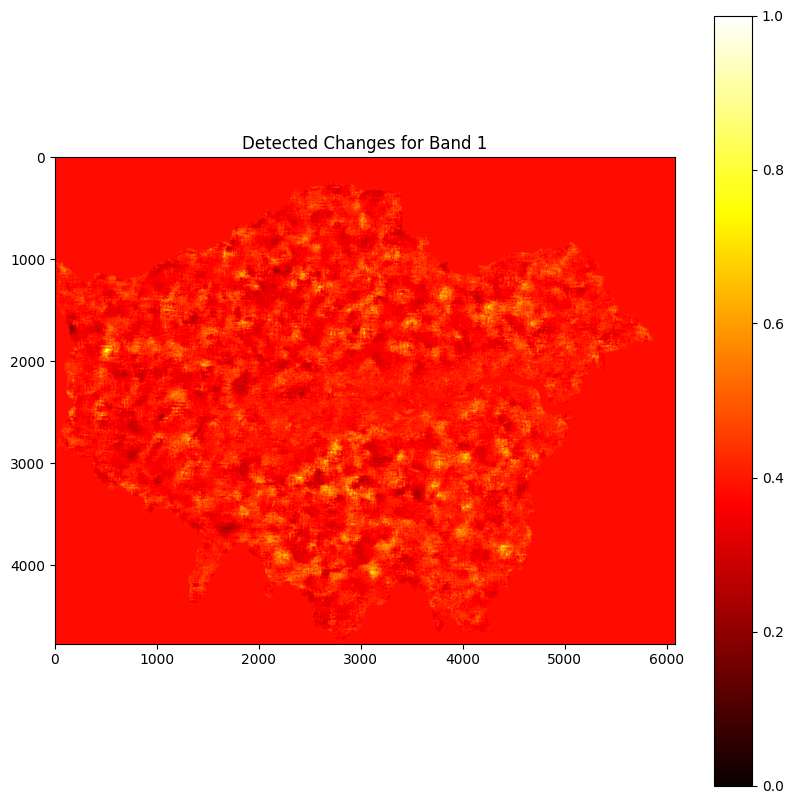

In [ ]:
import torch
from torchgeo.models import FCSiamDiff
import torch.nn.functional as F
import cv2
import numpy as np
import matplotlib.pyplot as plt
import rasterio

class ClearCache:
    def __enter__(self):
        torch.cuda.empty_cache()

    def __exit__(self, exc_type, exc_val, exc_tb):
        torch.cuda.empty_cache()

def resize_mask(mask, target):
    return cv2.resize(
        mask.astype(np.float32),
         (target.shape[1], target.shape[0]),
        interpolation=cv2.INTER_NEAREST).astype(bool)

def resize_to_match(target: torch.Tensor, reference: torch.Tensor) -> torch.Tensor:
    return F.interpolate(target, size=reference.shape[2:], mode='bilinear', align_corners=False)

def pad_to_multiple(tensor, multiple):
    height, width = tensor.shape[2], tensor.shape[3]
    pad_height = (multiple - height % multiple) % multiple
    pad_width = (multiple - width % multiple) % multiple
    padding = (0, pad_width, 0, pad_height)
    return F.pad(tensor, padding, mode='reflect')

def extract_features_for_band(band, im1, im2, no_data_mask, model):
    # Convert to tensors and select the specific band
    im1_band = torch.tensor(im1[band-1, :, :], dtype=torch.float32).unsqueeze(0).unsqueeze(0).to(device)
    im2_band = torch.tensor(im2[band-1, :, :], dtype=torch.float32).unsqueeze(0).unsqueeze(0).to(device)

    # Pad images
    im1_band = pad_to_multiple(im1_band, 32)
    im2_band = pad_to_multiple(im2_band, 32)

    # Prepare input tensors (batch size, time steps, channels, height, width)
    input_tensor = torch.stack([im1_band, im2_band], dim=1).to(device)  # Shape: (B, T, C, H, W)

    # Extract features and create change map
    with torch.no_grad():
        with ClearCache():
            change_map = model(input_tensor)

    # Resize the change map
    change_map_resized = resize_to_match(change_map, im1_band)
    change_map_resized = change_map_resized.squeeze().cpu().numpy()

    # Apply the no-data mask
    no_data_mask_resized = resize_mask(no_data_mask, change_map_resized)
    change_map_resized[no_data_mask_resized] = np.nan

    # Normalize the change map
    change_map_for_normalization = np.nan_to_num(change_map_resized, nan=0.0)
    change_map_min = np.min(change_map_for_normalization)
    change_map_max = np.max(change_map_for_normalization)
    change_map_normalized = (change_map_for_normalization - change_map_min) / (change_map_max - change_map_min)

    return change_map_normalized

# Load images function
def load_image(image_path, bands=None):
    with rasterio.open(image_path) as src:
        if bands is not None:
            image = src.read(bands)
        else:
            image = src.read()
        image = np.nan_to_num(image, nan=np.nanmin(image))
        image = (image - np.mean(image)) / np.std(image)
    return image

# Resize image to match target size
def resize_image(image, target_shape):
    resized_image = np.zeros((image.shape[0], target_shape[0], target_shape[1]))
    for i in range(image.shape[0]):
        resized_image[i] = cv2.resize(image[i], (target_shape[1], target_shape[0]), interpolation=cv2.INTER_LINEAR)
    return resized_image

# Load dataset function
def load_dataset(image1_path, image2_path, bands):
    im1 = load_image(image1_path, bands)
    im2 = load_image(image2_path, bands)
    return im1, im2

# Check for CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

# Load images
bands = list(range(1, 12))  # Adjust as necessary here
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
im1, im2 = load_dataset(image1_path, image2_path, bands=bands)

# Create no-data mask
no_data_mask = np.isnan(im1[0]) | (im1[0] == np.nanmin(im1[0]))

# Convert to tensors
# im1_tensor = torch.tensor(im1, dtype=torch.float32).unsqueeze(0).to(device)
# im2_tensor = torch.tensor(im2, dtype=torch.float32).unsqueeze(0).to(device)

# print(f'Images shape: {im1_tensor.shape}, {im2_tensor.shape}')

# Define the FCSiamDiff model
model = None
model = FCSiamDiff(
    encoder_name='resnet34',
    encoder_depth=5,
    encoder_weights='imagenet',
    decoder_use_batchnorm=True,
    decoder_channels=(256, 128, 64, 32, 16),
    decoder_attention_type=None,
    in_channels=1,  # Adjusted to 1 channel for single-band input
    classes=1,
    activation=None
).to(device)

# Set the model to evaluation mode
model.eval()

# Loop through each band and extract features
all_features = []
for band in bands:
    features = extract_features_for_band(band, im1, im2, no_data_mask, model)
    all_features.append(features)

# Now, all_features contains the extracted features for each band
# You can further process or visualize these features as needed

# Example: Visualize features for the first band
plt.figure(figsize=(10, 10))
plt.imshow(all_features[0], cmap='hot')
plt.colorbar()
plt.title(f'Detected Changes for Band {bands[0]}')
plt.show()


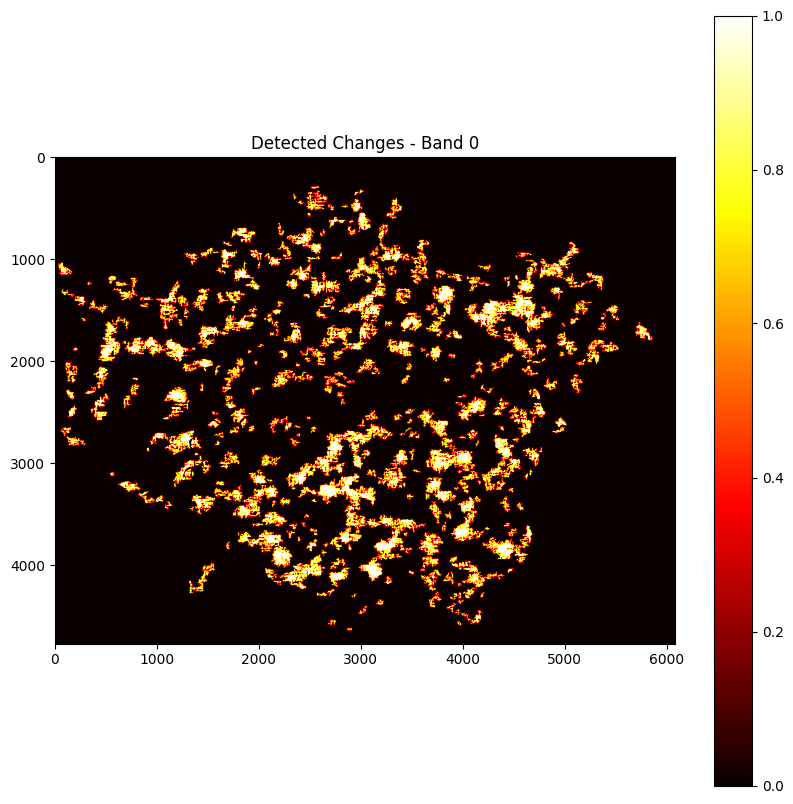

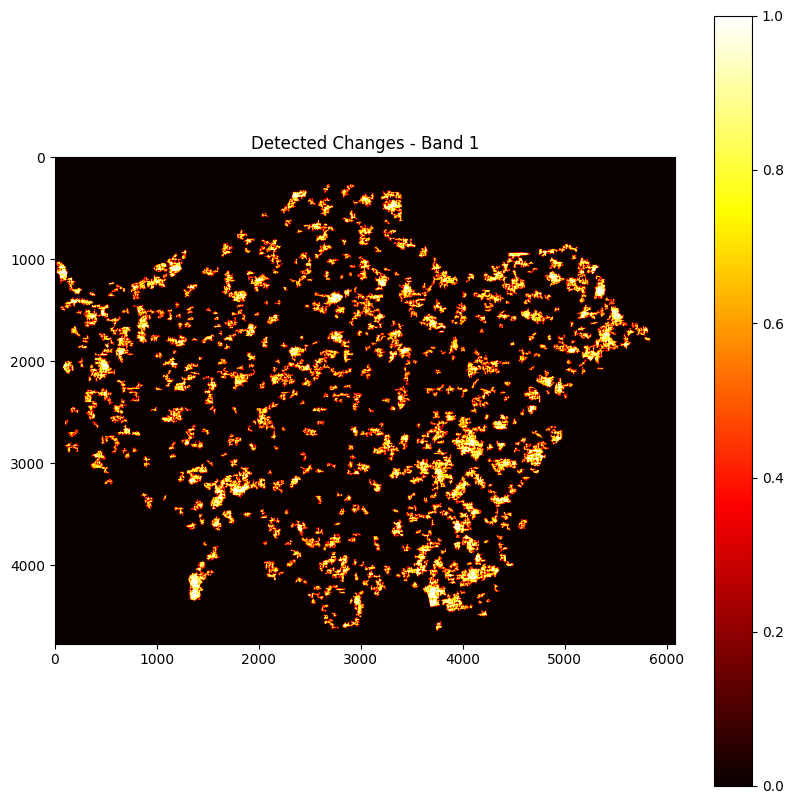

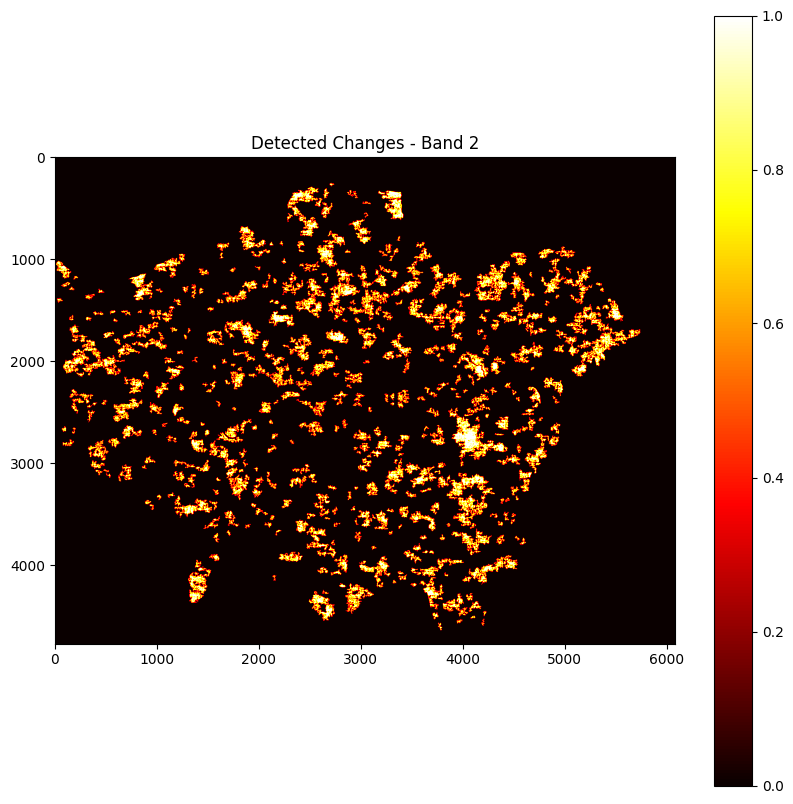

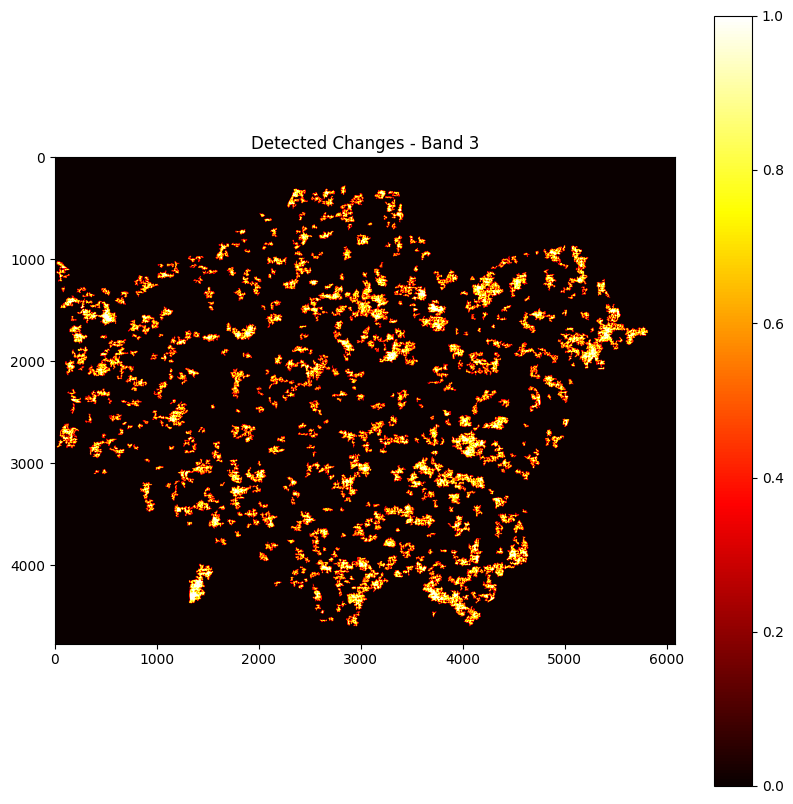

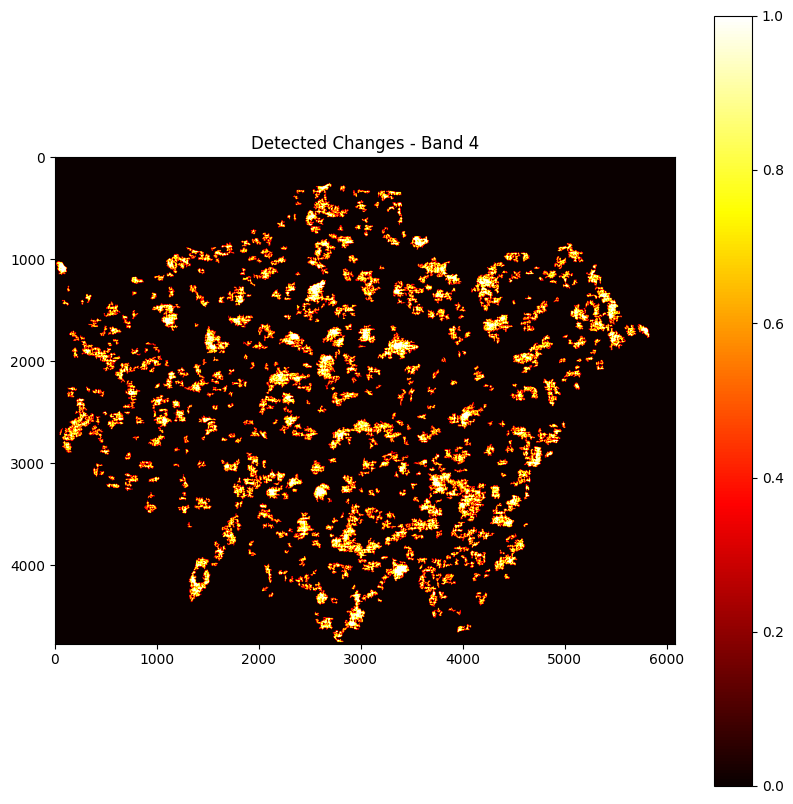

...

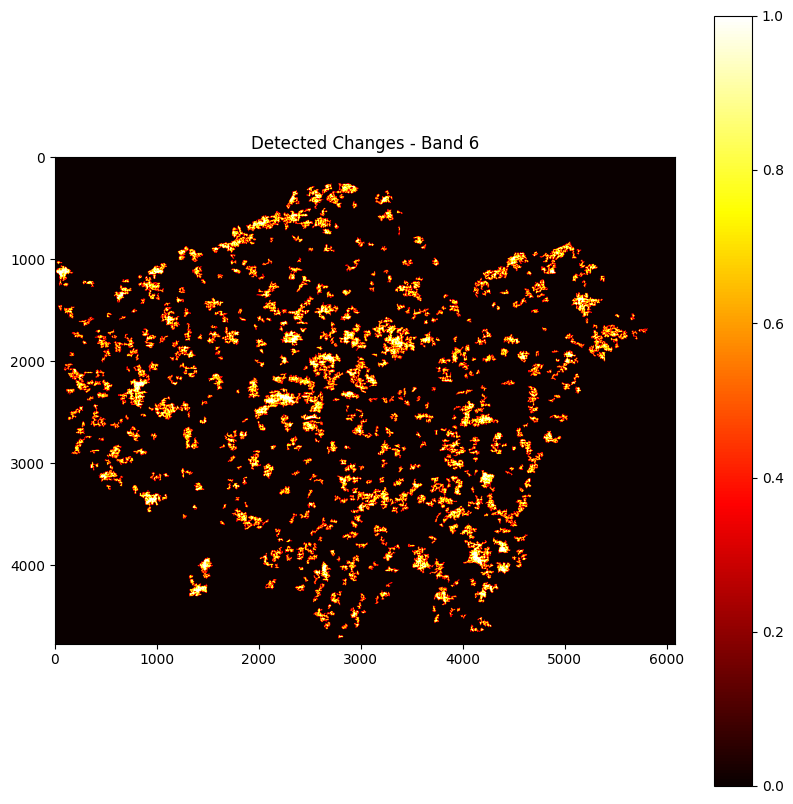

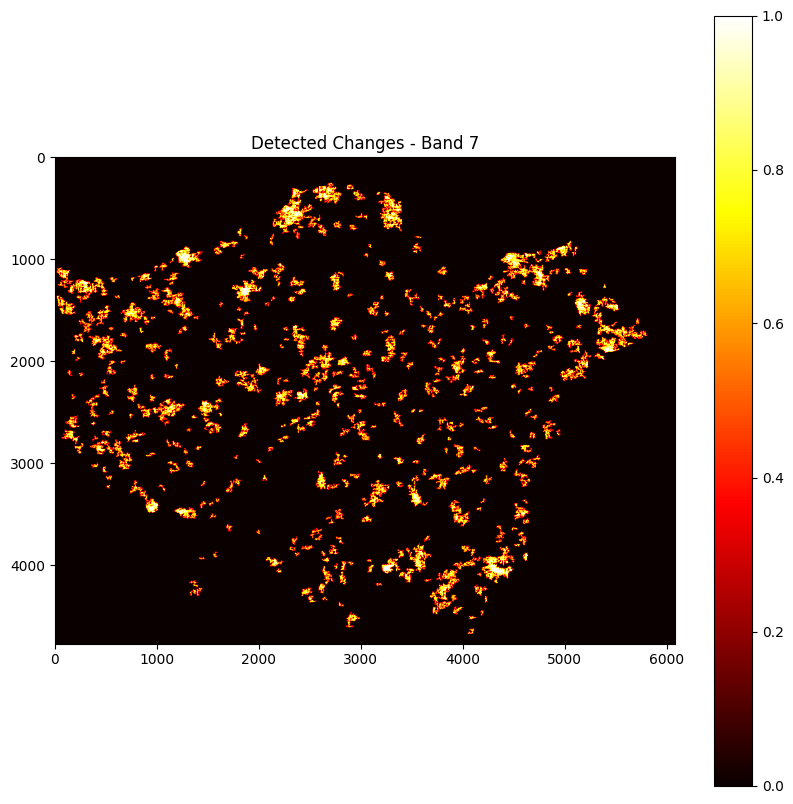

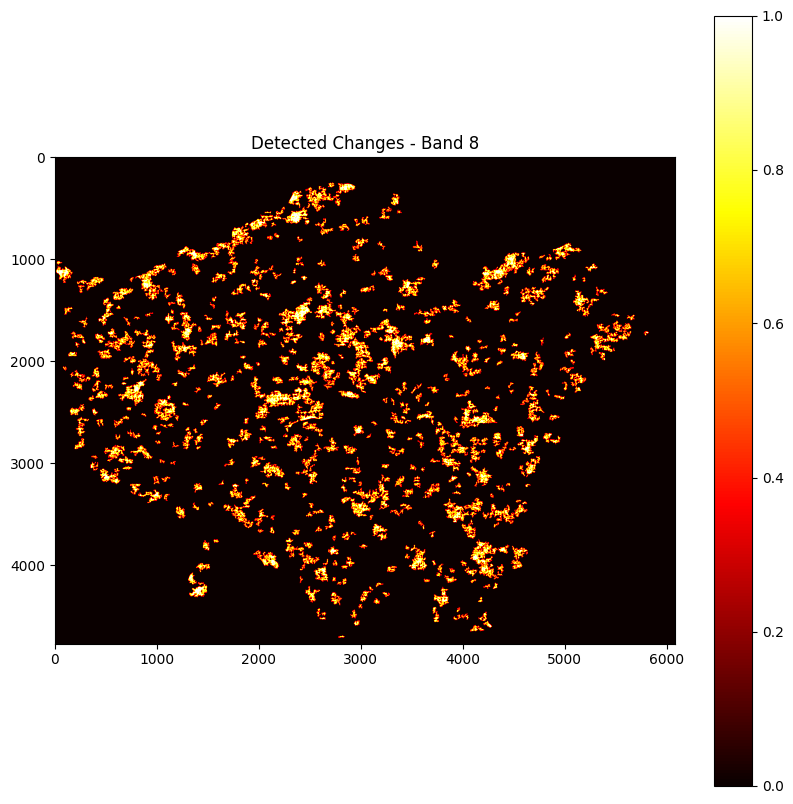

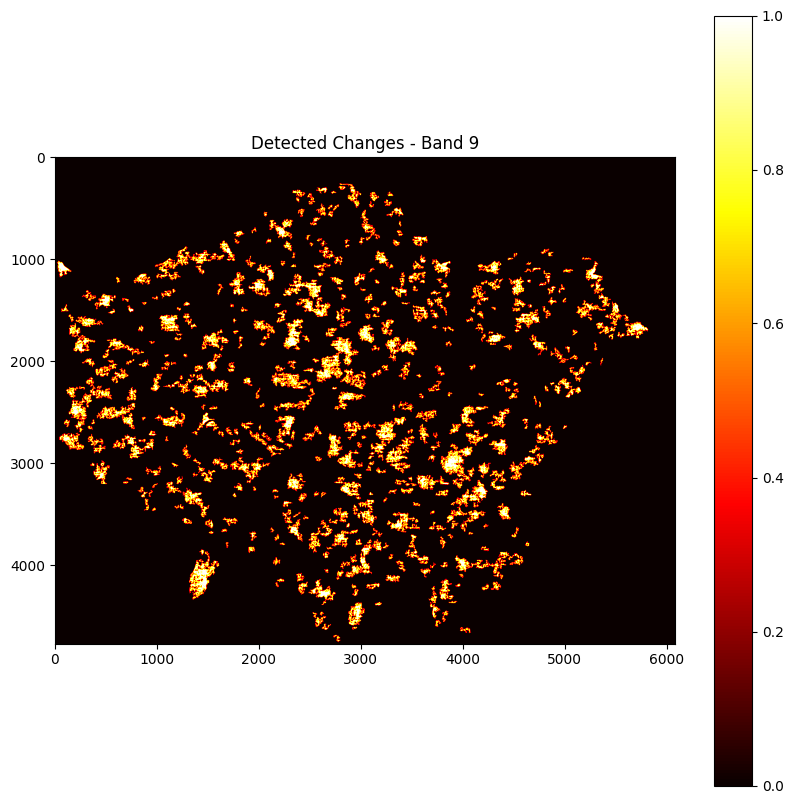

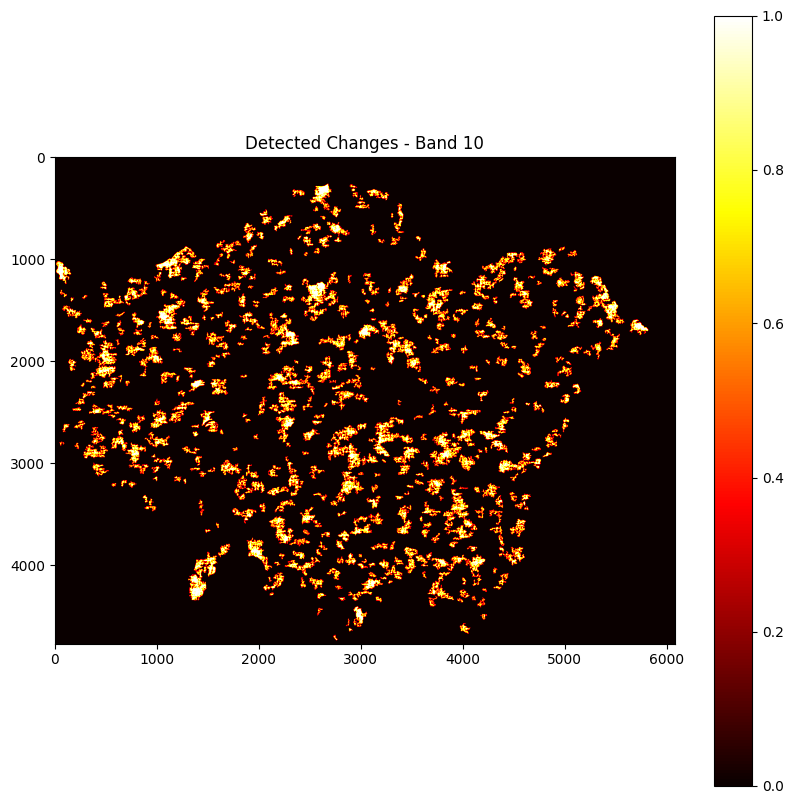

In [ ]:
for band in range(len(all_features)):
  # Apply thresholding strategy
  cd_map = apply_thresholding_strategy(
      all_features[band],
      strategy='multiotsu',
      min_size=512
  )

  # Visualize the change map
  plt.figure(figsize=(10, 10))
  plt.imshow(cd_map, cmap='hot')
  plt.colorbar()
  plt.title(f'Detected Changes - Band {band}')
  plt.show()


In [ ]:
len(all_features)

11

In [ ]:
import os


def save_features(change_maps, model_name, image_path, output_dir):
  for band, change_map in enumerate(change_maps, start=1):
    change_map = apply_thresholding_strategy(
        change_map,
        strategy='multiotsu',
        min_size=8
    )

    change_map = change_map.astype(np.uint8)

    # Define raster metadata
    with rasterio.open(image_path) as src2:
        transform2 = src2.transform
        crs2 = src2.crs

    raster_meta = {
        "driver": "GTiff",
        "height": change_map.shape[0],
        "width": change_map.shape[1],
        "count": 1,
        "dtype": change_map.dtype,
        "crs": crs2,
        "transform": transform2,
    }

    output_path = os.path.join(output_dir, f"features_band_{band}_{model_name}.tiff")
    with rasterio.open(output_path, 'w', **raster_meta) as dst:
        dst.write(change_map, 1)

    print(f"Change map features for band {band} saved to {output_path}")


# Define paths and bands to process
model_name = "fcsd"
image1_path = "drive/MyDrive/dissertation/clipped_merged_2016.tiff"
image2_path = "drive/MyDrive/dissertation/clipped_merged_2021.tiff"
output_dir = f"drive/MyDrive/dissertation/features_{model_name}/"
model_dir = "drive/MyDrive/dissertation/models/"
bands = list(range(1, 12))

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

# Loop through each band and train the model
save_features(all_features, model_name, image2_path, output_dir)

Change map features for band 0 saved to drive/MyDrive/dissertation/features_fcsd/features_band_0_fcsd.tiff
Change map features for band 1 saved to drive/MyDrive/dissertation/features_fcsd/features_band_1_fcsd.tiff
Change map features for band 2 saved to drive/MyDrive/dissertation/features_fcsd/features_band_2_fcsd.tiff
Change map features for band 3 saved to drive/MyDrive/dissertation/features_fcsd/features_band_3_fcsd.tiff
Change map features for band 4 saved to drive/MyDrive/dissertation/features_fcsd/features_band_4_fcsd.tiff
Change map features for band 5 saved to drive/MyDrive/dissertation/features_fcsd/features_band_5_fcsd.tiff
Change map features for band 6 saved to drive/MyDrive/dissertation/features_fcsd/features_band_6_fcsd.tiff
Change map features for band 7 saved to drive/MyDrive/dissertation/features_fcsd/features_band_7_fcsd.tiff
Change map features for band 8 saved to drive/MyDrive/dissertation/features_fcsd/features_band_8_fcsd.tiff
Change map features for band 9 saved 

In [ ]:
for idx, band in enumerate(all_features):
  print(idx+1, len(all_features[idx]))

1 4768
2 4768
3 4768
4 4768
5 4768
6 4768
7 4768
8 4768
9 4768
10 4768
11 4768


In [ ]:
for band, map in enumerate(all_features, start=1):
  print(band)

1
2
3
4
5
6
7
8
9
10
11
